In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [4]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [5]:
date="05-30-2024"
run="e1f"
sim="exp"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
#dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
#root_file=dir+"/analysis_full_e16_geo_fid.root"


species="ele"
detector="ec"
cut="pid"

root_file=dir+"/"+sim+"_"+run+"_clas6_fid_geo_"+detector+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
side = ["left","coinc","right","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all



In [6]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

In [7]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/4)

In [8]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [9]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_


In [10]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 1
y_merge = 1


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]



In [11]:
xdim = len(xvals)
ydim = len(yvals)

xres = xvals[1]-xvals[0]
yres = yvals[1]-yvals[0]

def shift_idx(x_shift_):
    return round(x_shift_/xres)

In [12]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]


In [13]:
def Linear(x_, a_, b_):
    return a_ + b_*x_

def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

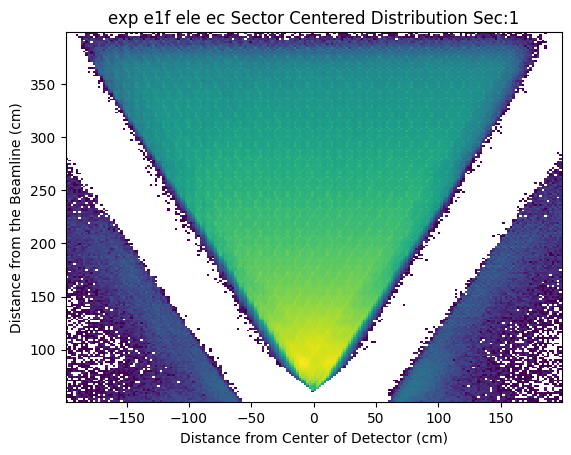

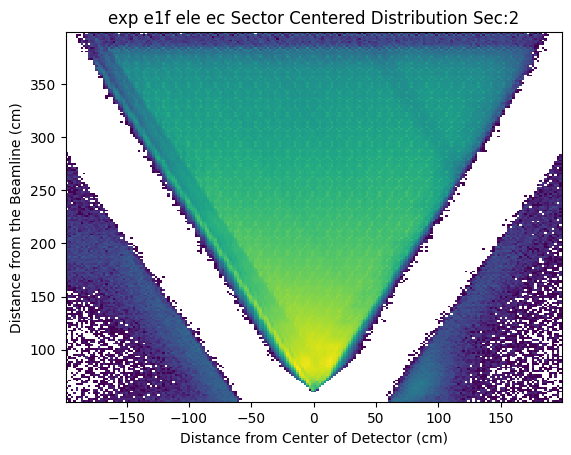

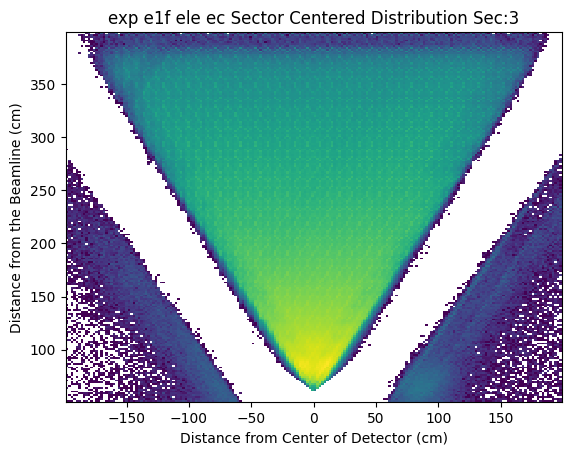

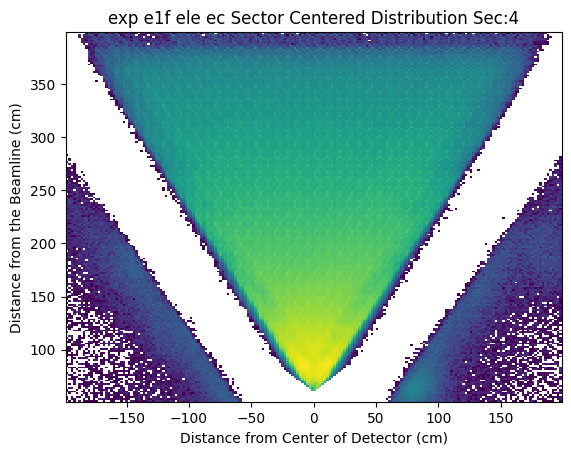

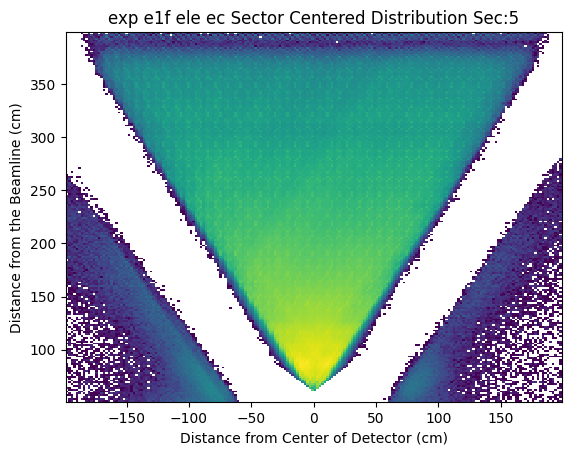

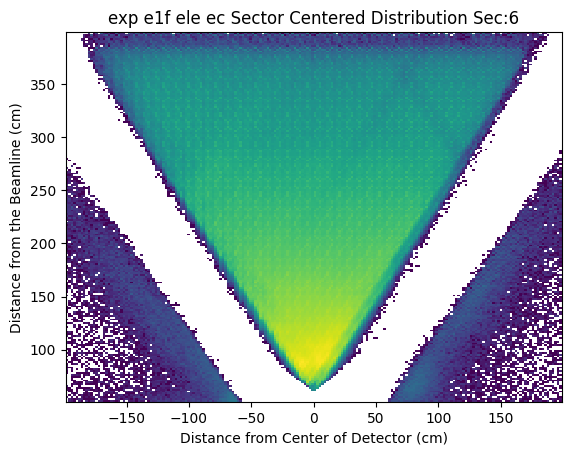

In [14]:
for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(sim+" "+run+" "+species+" "+detector+" Sector Centered Distribution Sec:{}".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [15]:
print(yvals[27])
print(yvals[160])

98.125
330.875


In [16]:
idx1 = 27
idx2=160
fit_len = idx2-idx1
yidx = [idx1+i for i in range(fit_len)]

xrange = [[-50-i*(yvals[idx2]-yvals[idx1])/(fit_len),50+i*(yvals[idx2]-yvals[idx1])/(fit_len)] for i in range(fit_len)]

#x_points = np.zeros()

right_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]
left_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]


[1.06829857e+05 1.01682066e+00 1.63845244e+01 1.75892936e+01]


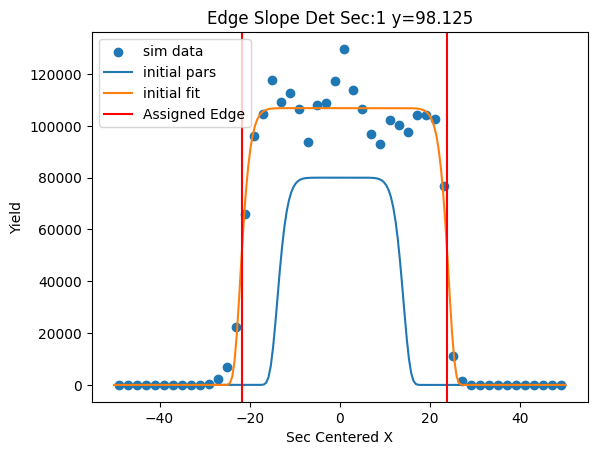

[1.07529869e+05 1.15848211e+00 1.70123881e+01 1.37124141e+01]


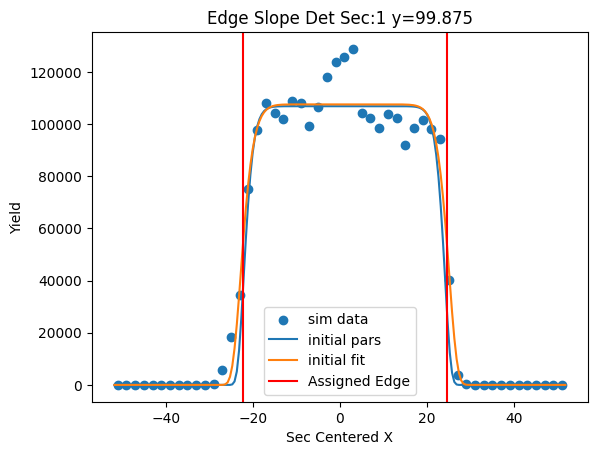

[1.08138583e+05 1.23823375e+00 1.78133534e+01 1.01234658e+01]


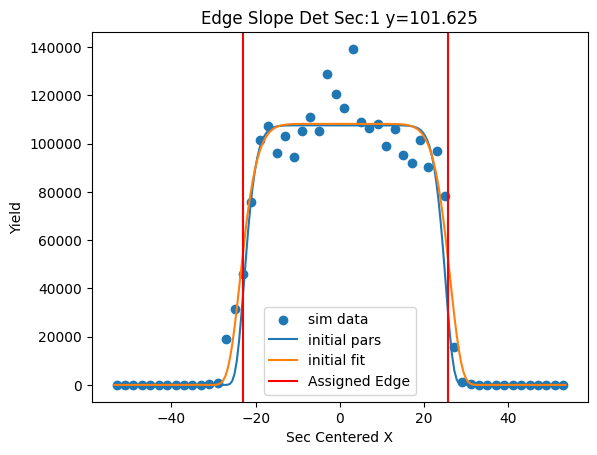

[1.05854253e+05 9.77867926e-01 1.86953995e+01 8.27163505e+00]


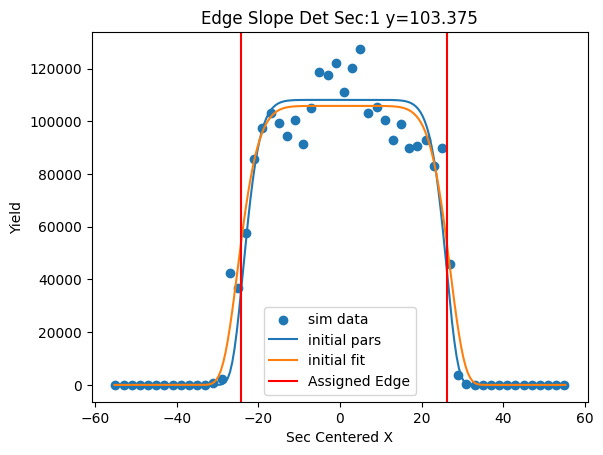

[9.79688997e+04 7.94178130e-01 1.93208206e+01 8.73992939e+00]


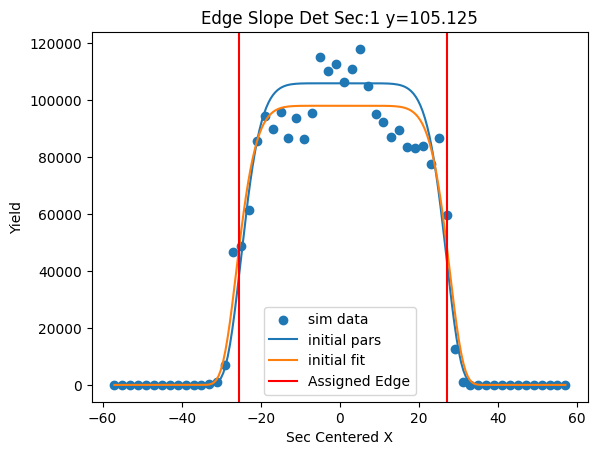

[9.19216492e+04 7.06299803e-01 1.98866637e+01 8.03040106e+00]


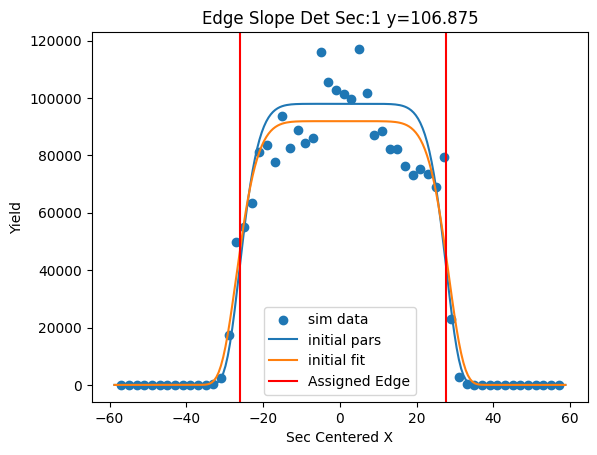

[8.92184801e+04 5.15788327e-01 2.03614350e+01 5.96453780e+00]


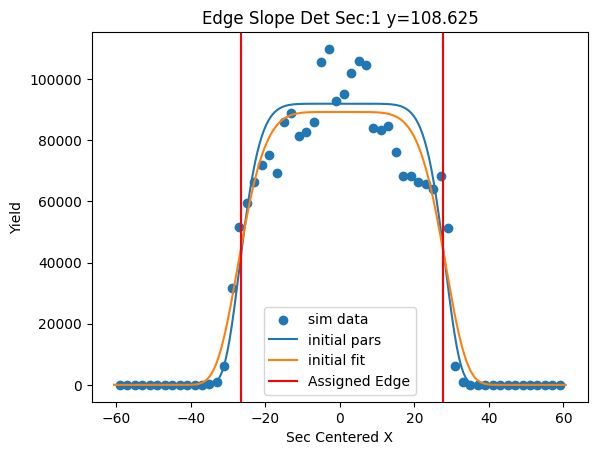

[8.65801501e+04 2.70343468e-01 2.06716313e+01 4.73024926e+00]


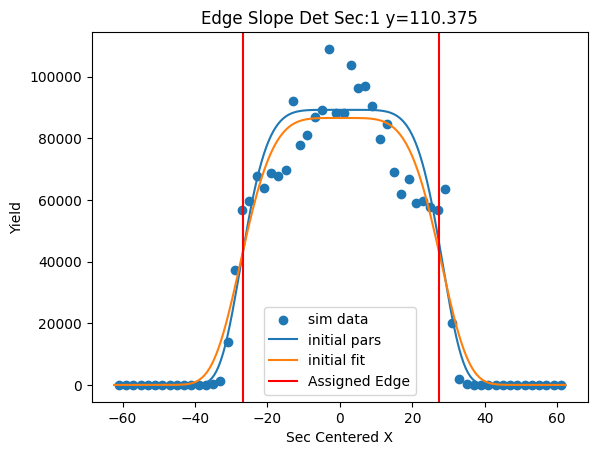

[8.08915863e+04 2.25646938e-01 2.11687308e+01 4.36725194e+00]


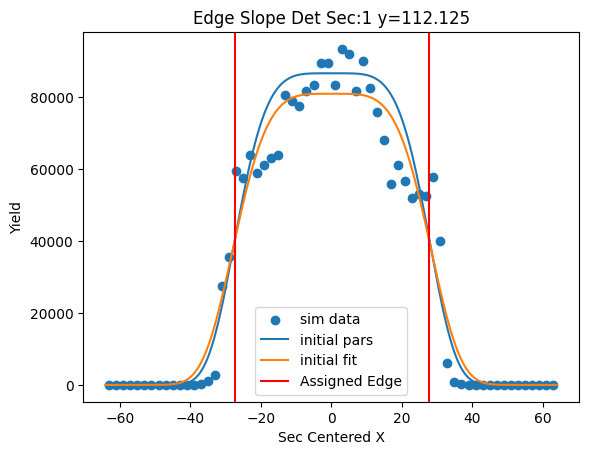

[7.42854275e+04 4.30062595e-01 2.23956746e+01 5.67638073e+00]


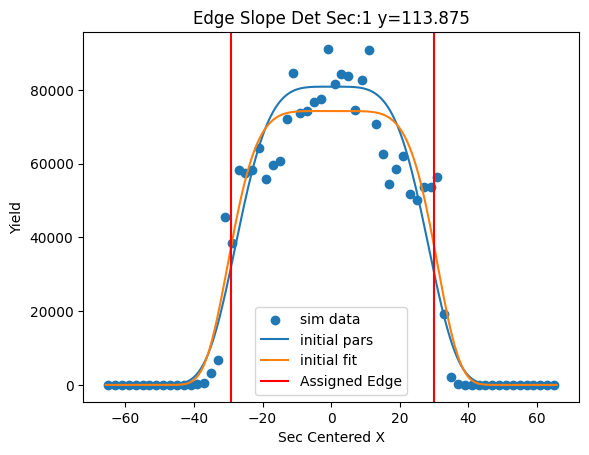

[6.86447820e+04 5.77446645e-01 2.34600464e+01 9.19356151e+00]


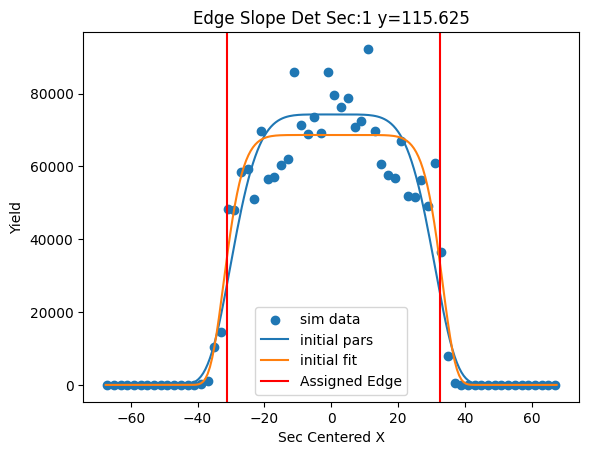

[6.60544876e+04 4.46984190e-01 2.41493567e+01 9.04842065e+00]


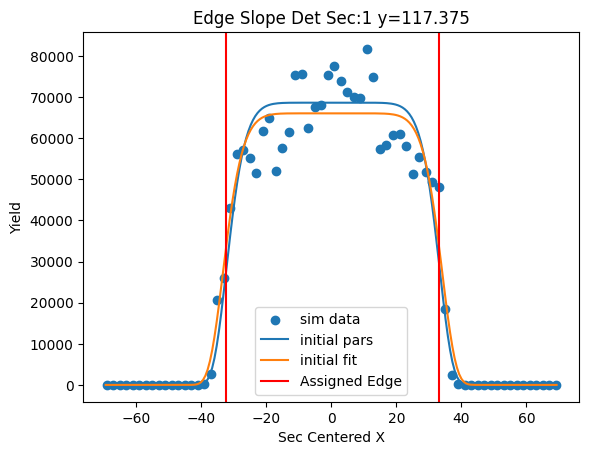

[6.31591460e+04 2.83678454e-01 2.47110184e+01 8.47555175e+00]


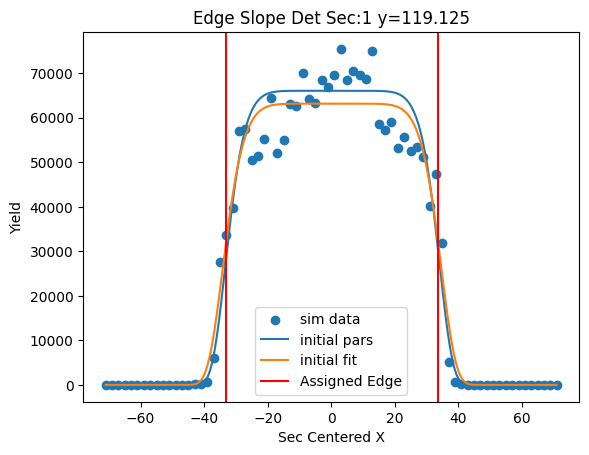

[6.02632634e+04 1.84702731e-01 2.54575619e+01 8.43712593e+00]


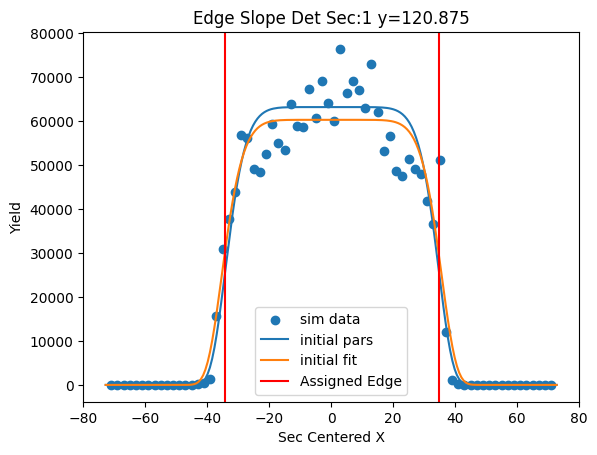

[ 5.66741997e+04 -1.29244169e-01  2.61576653e+01  7.47045792e+00]


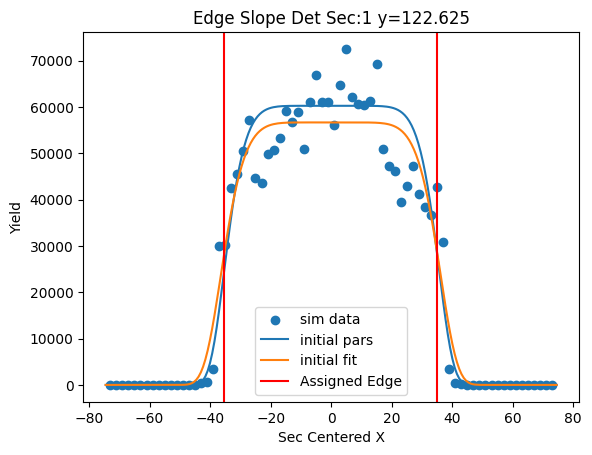

[ 5.29759136e+04 -3.81636027e-01  2.63548732e+01  5.42803936e+00]


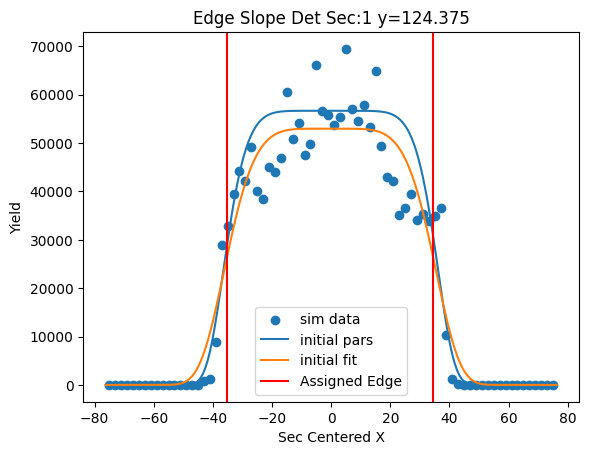

[ 5.07276530e+04 -1.13440866e-01  2.61142596e+01  4.04084882e+00]


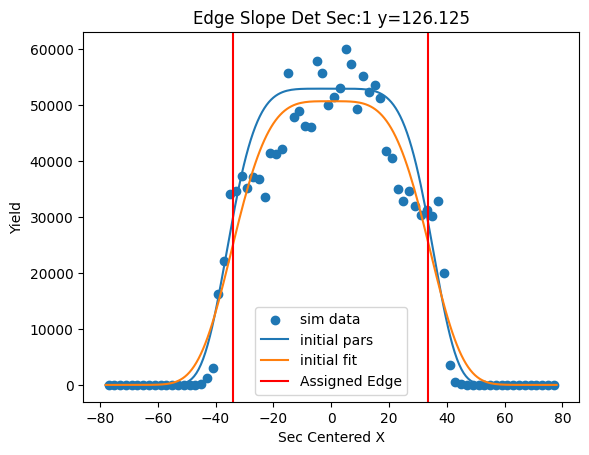

[5.05580558e+04 2.46100466e-01 2.67108679e+01 3.96225728e+00]


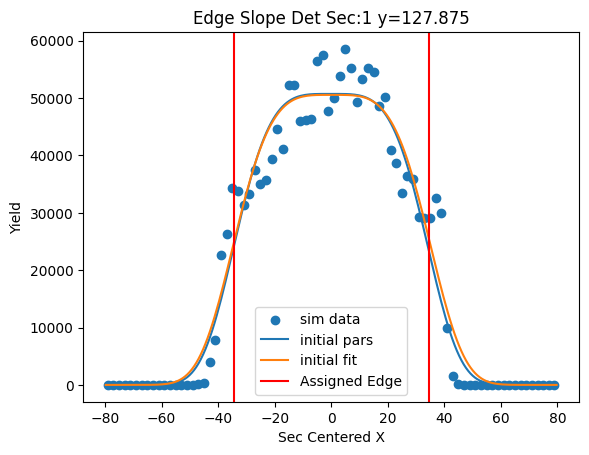

[4.85977772e+04 3.46547329e-01 2.77436921e+01 4.29308035e+00]


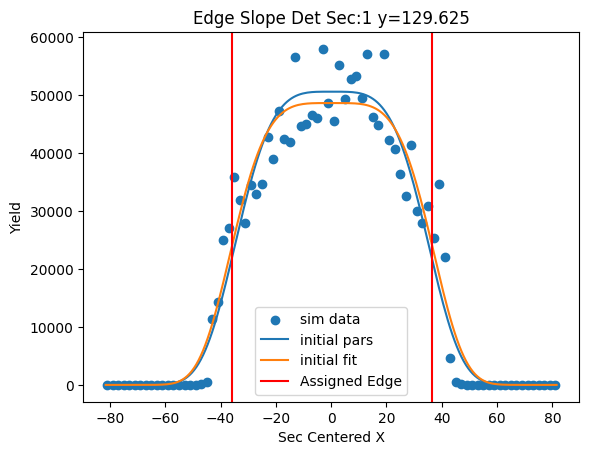

[4.48799297e+04 1.48858178e-01 2.87820280e+01 4.55615229e+00]


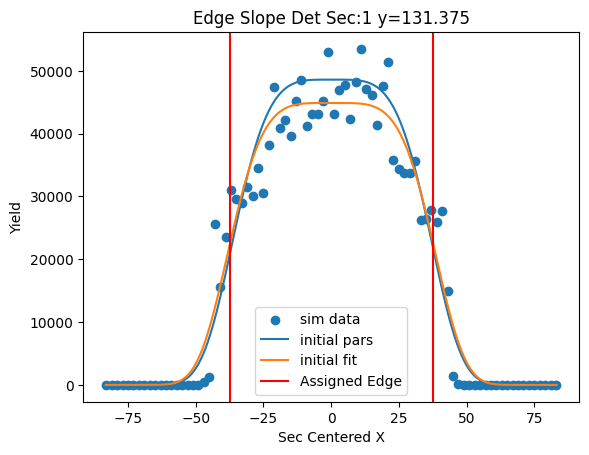

[4.05384161e+04 2.14276652e-01 2.93658696e+01 4.76845290e+00]


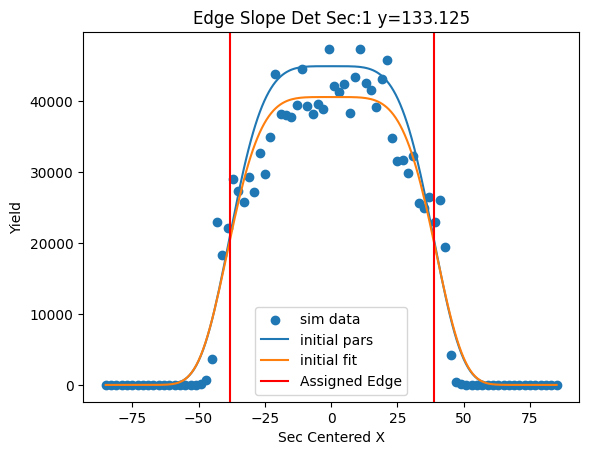

[3.97329060e+04 2.54460473e-01 2.98956759e+01 4.82405131e+00]


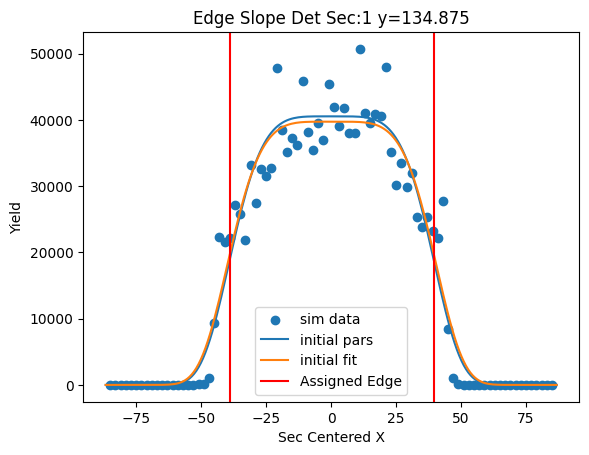

[3.91506680e+04 7.46950065e-03 3.01830236e+01 4.51460330e+00]


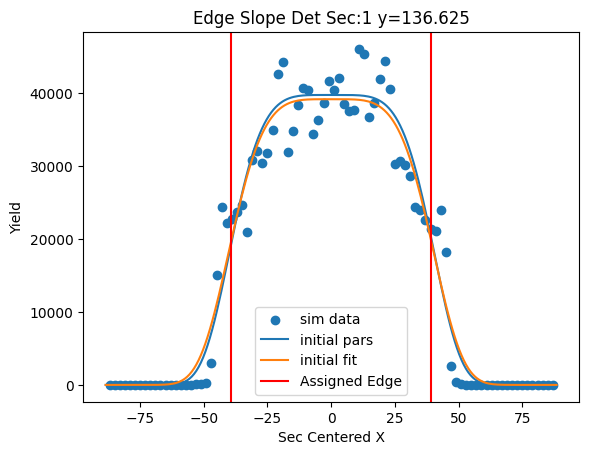

[ 3.67958366e+04 -2.55668390e-01  3.03023020e+01  4.24291973e+00]


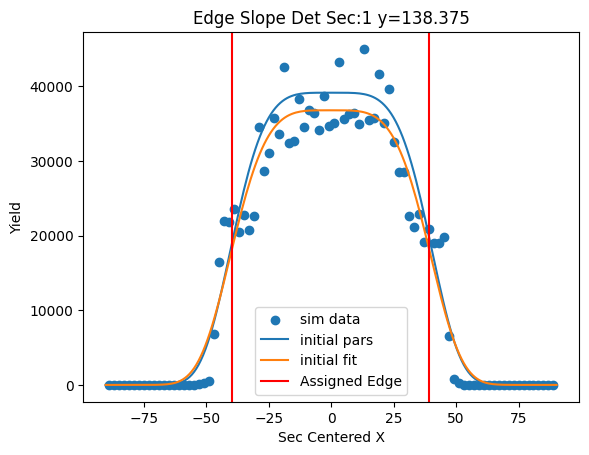

[ 3.41067017e+04 -3.85311340e-01  3.04667314e+01  4.05282840e+00]


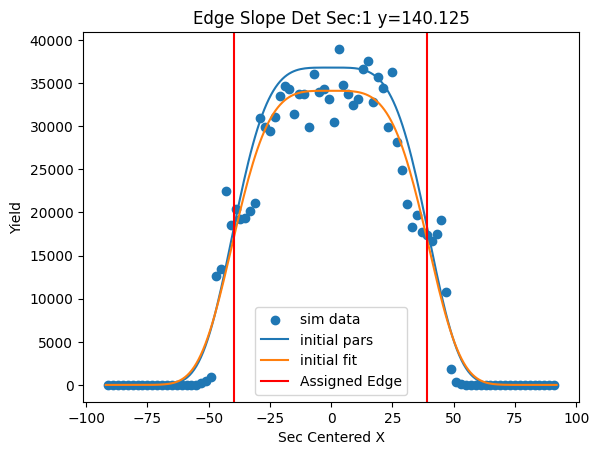

[ 3.25649135e+04 -6.07916736e-01  3.14428952e+01  4.23822010e+00]


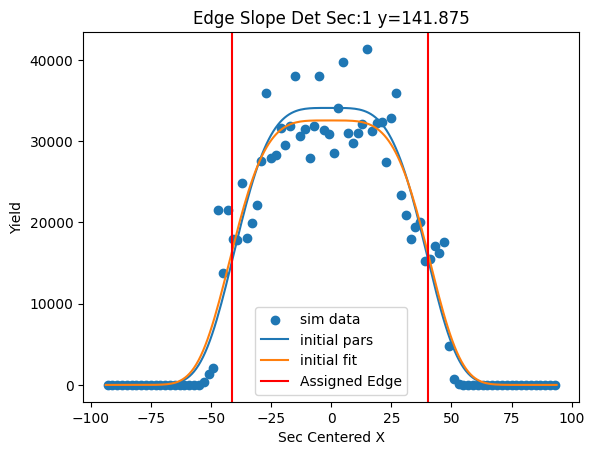

[ 3.08850774e+04 -6.29926709e-01  3.22383691e+01  4.42620709e+00]


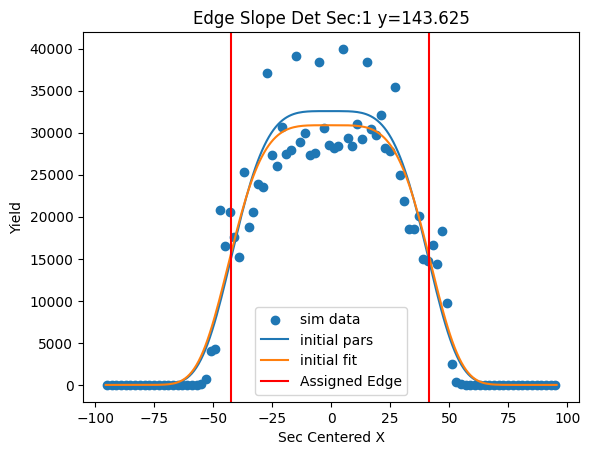

[ 2.91144364e+04 -4.45807951e-01  3.29633465e+01  4.59535212e+00]


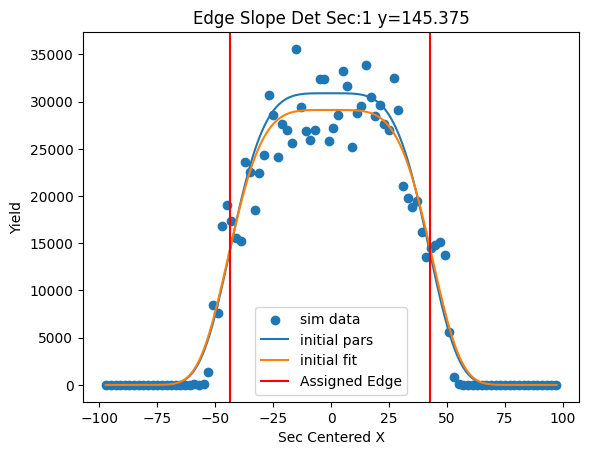

[ 2.74231813e+04 -3.83458653e-01  3.35946710e+01  4.68157617e+00]


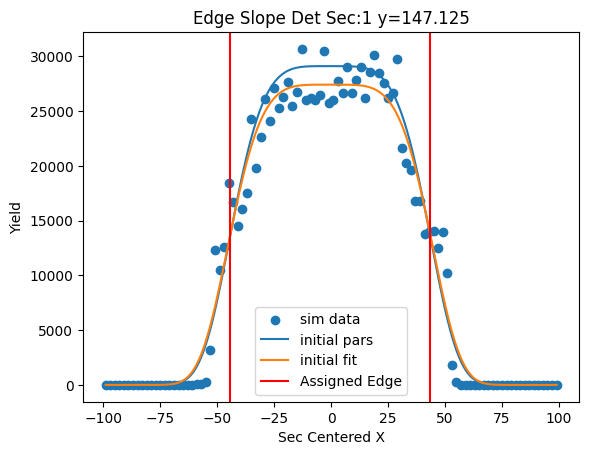

[ 2.69685935e+04 -7.79408583e-01  3.45235554e+01  4.97160669e+00]


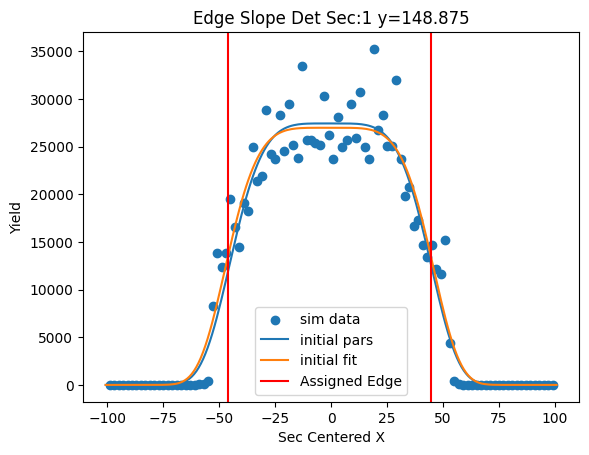

[ 2.53100774e+04 -1.29870798e+00  3.52886237e+01  5.11383627e+00]


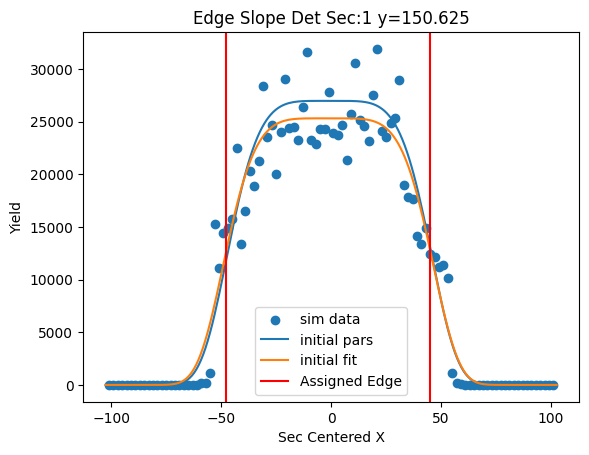

[ 2.31347223e+04 -1.21877981e+00  3.52354616e+01  4.83872514e+00]


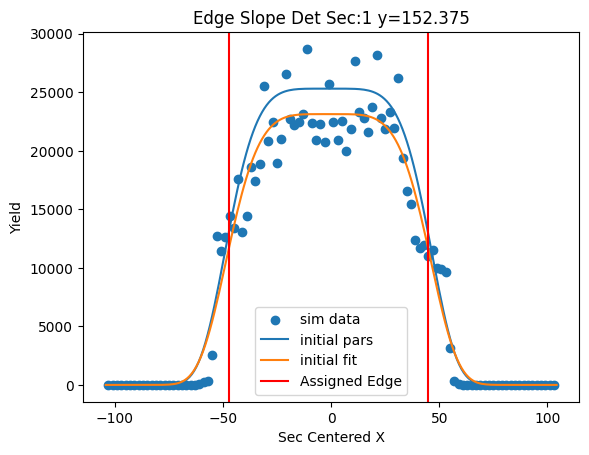

[ 2.23125264e+04 -8.55540966e-01  3.51884131e+01  4.63290248e+00]


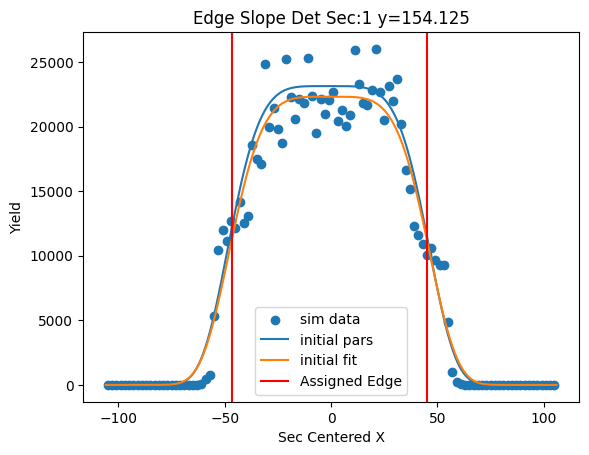

[ 2.25968876e+04 -9.07936737e-01  3.58754070e+01  4.77825926e+00]


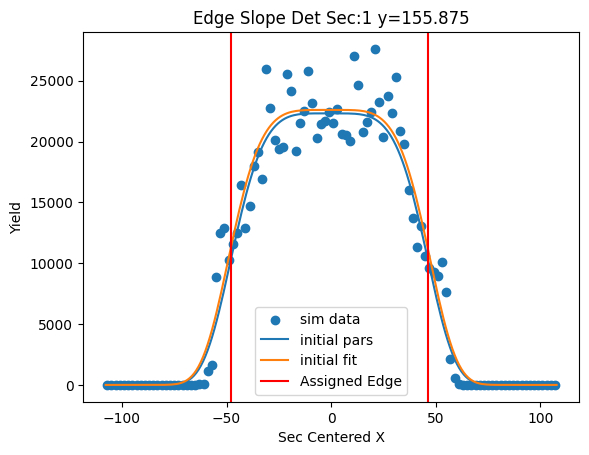

[ 2.18171377e+04 -7.75168196e-01  3.65369848e+01  4.92999408e+00]


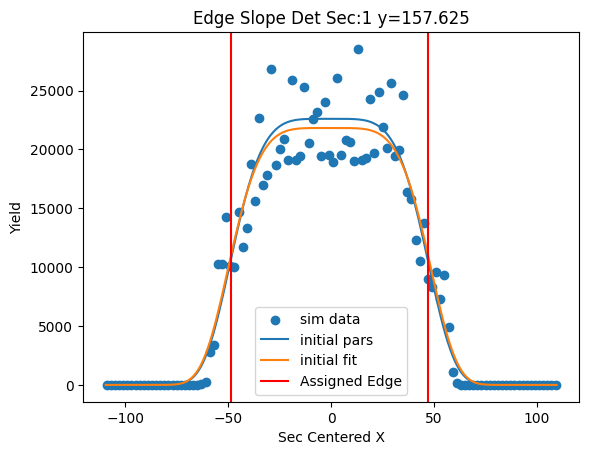

[ 2.02375746e+04 -8.94215573e-01  3.76085369e+01  5.20503355e+00]


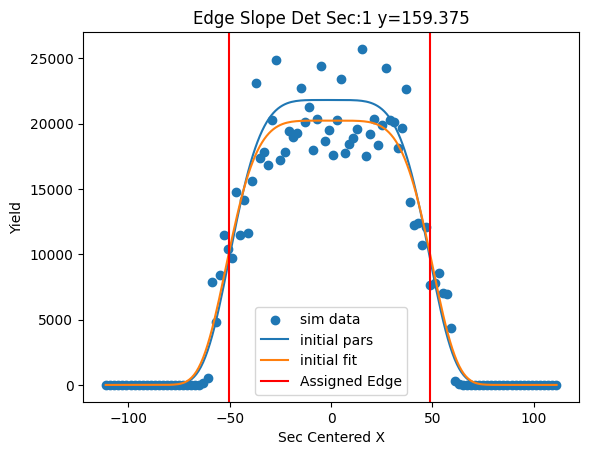

[ 1.81374233e+04 -4.68504910e-01  3.83574186e+01  5.42547178e+00]


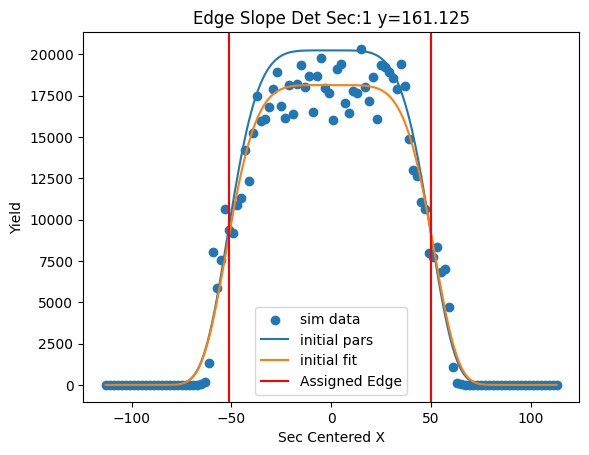

[ 1.81778029e+04 -8.56833348e-01  3.93802524e+01  6.06897278e+00]


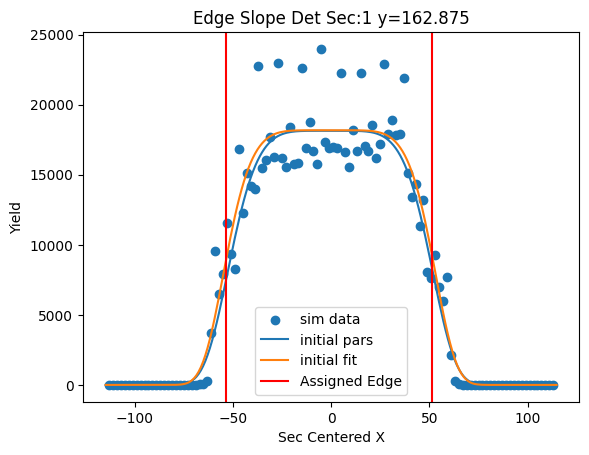

[ 1.78023746e+04 -1.12419109e+00  4.01673681e+01  6.51607761e+00]


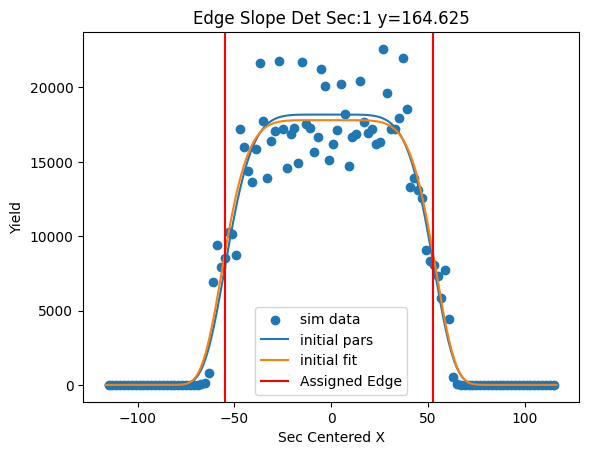

[ 1.68917710e+04 -1.08290734e+00  4.04735913e+01  6.65481125e+00]


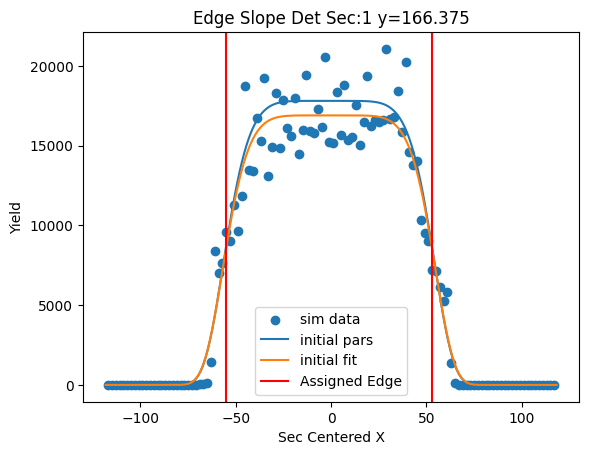

[ 1.62330870e+04 -1.15064509e+00  4.08425379e+01  6.85938730e+00]


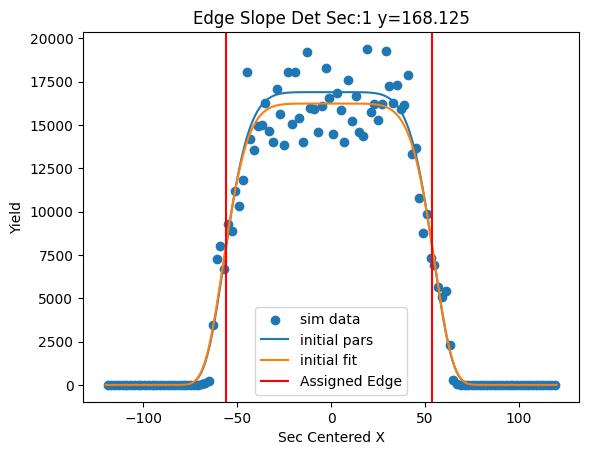

[ 1.60431039e+04 -1.57557133e+00  4.14840459e+01  7.19599614e+00]


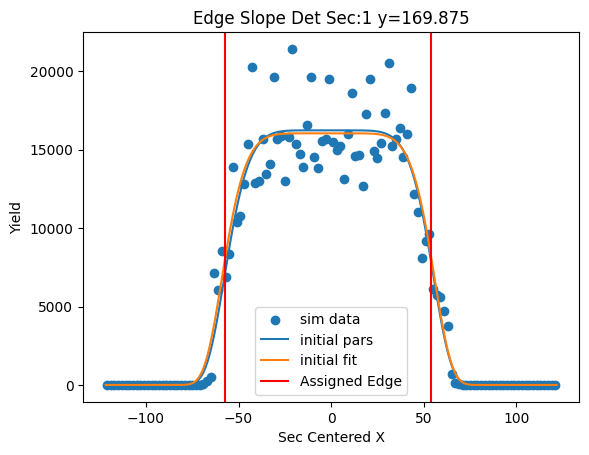

[ 1.52844953e+04 -1.44761470e+00  4.22237380e+01  7.63022934e+00]


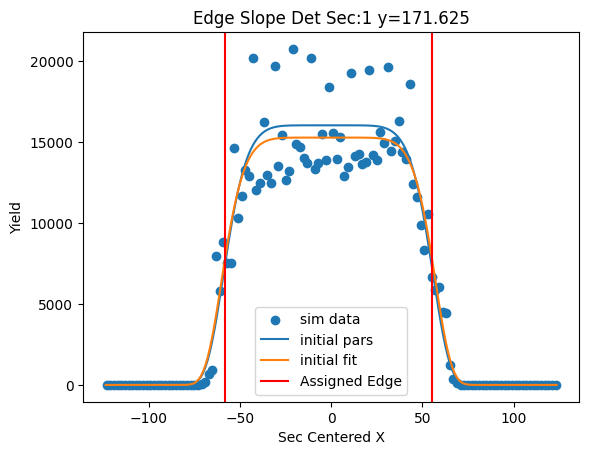

[ 1.47345372e+04 -1.17303299e+00  4.29939323e+01  7.90303858e+00]


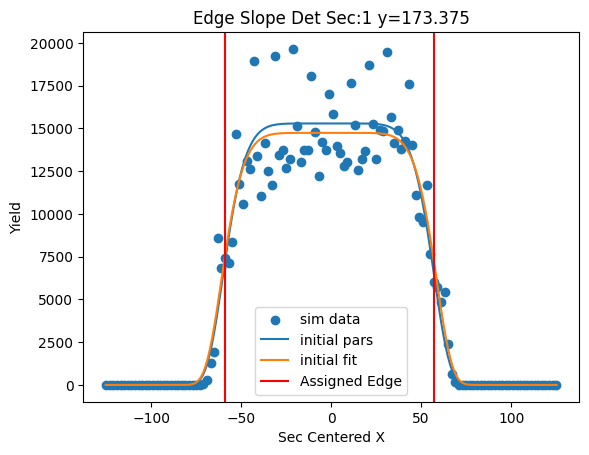

[ 1.38014736e+04 -8.28596615e-01  4.34404598e+01  8.32418080e+00]


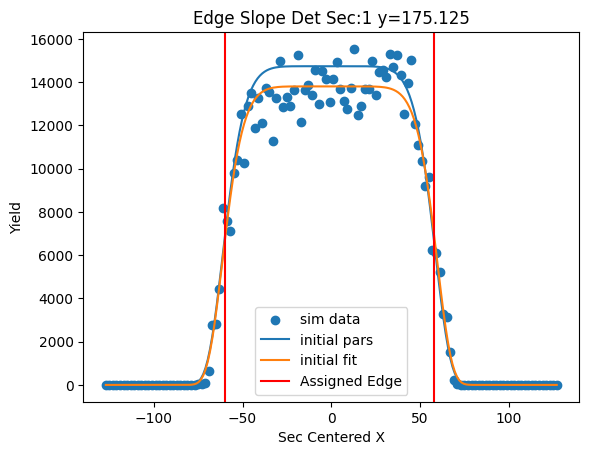

[ 1.42905951e+04 -1.24169389e+00  4.44171811e+01  8.90570171e+00]


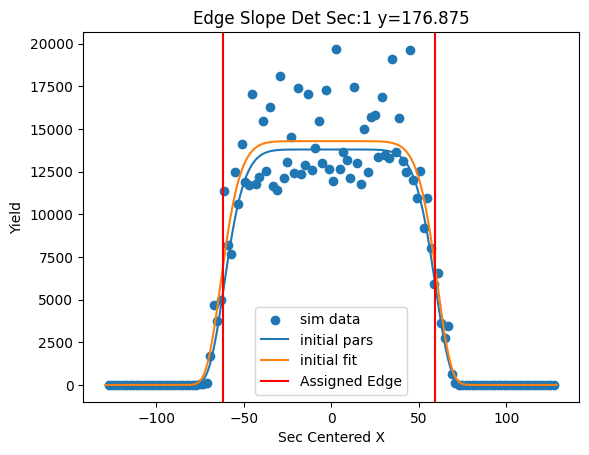

[ 1.36895865e+04 -1.64680704e+00  4.52238976e+01  9.42077197e+00]


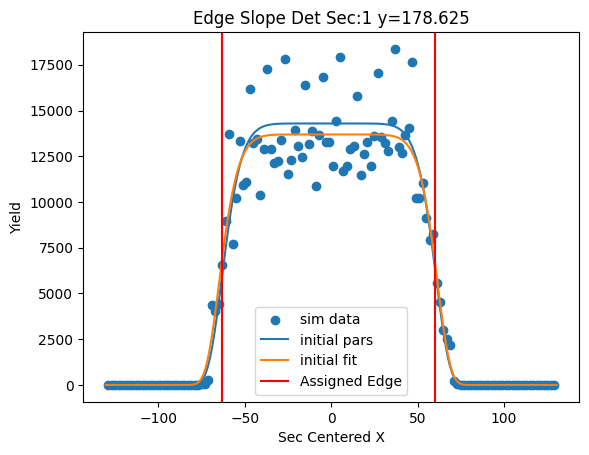

[ 1.22432431e+04 -1.42634888e+00  4.56239380e+01  9.56576899e+00]


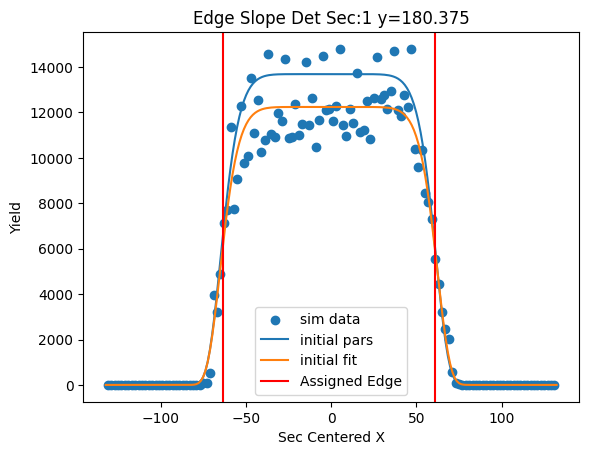

[ 1.20759250e+04 -1.06090428e+00  4.60201673e+01  9.48091625e+00]


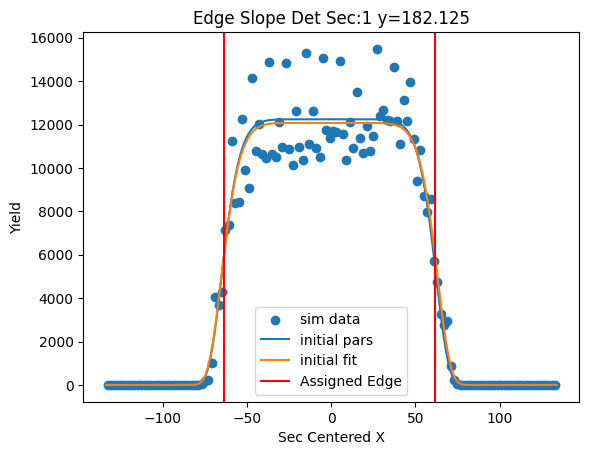

[ 1.25240846e+04 -1.15452326e+00  4.69505554e+01  9.80119113e+00]


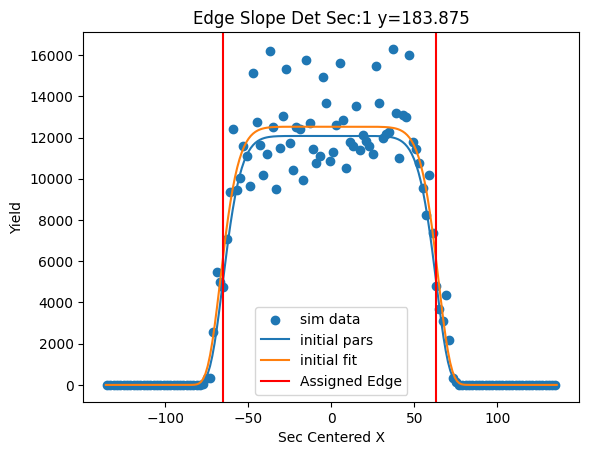

[ 1.20964238e+04 -8.22392253e-01  4.76131575e+01  9.68638580e+00]


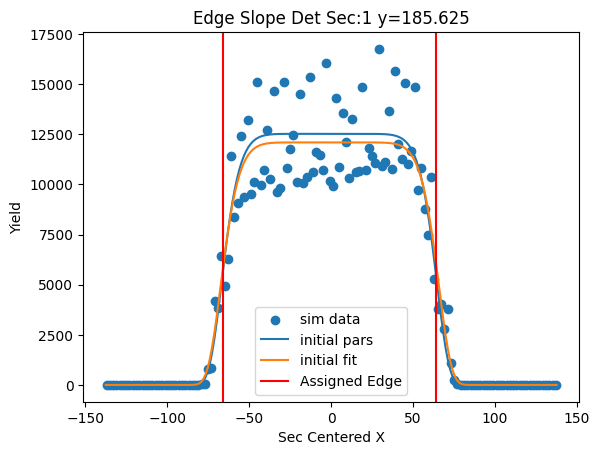

[ 1.07619036e+04 -8.21809259e-01  4.82115156e+01  9.59754548e+00]


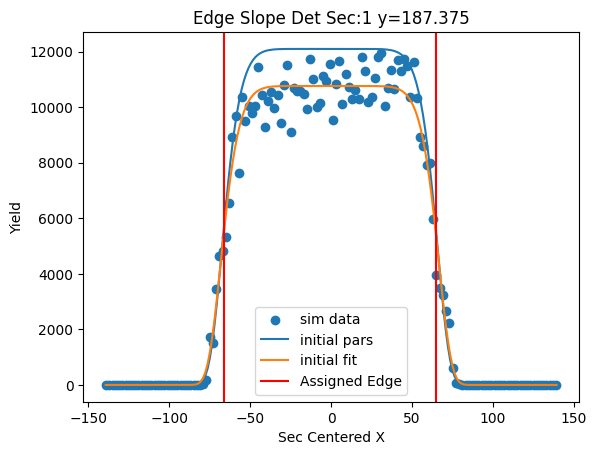

[ 1.08660148e+04 -9.95954729e-01  4.93601305e+01  9.43618842e+00]


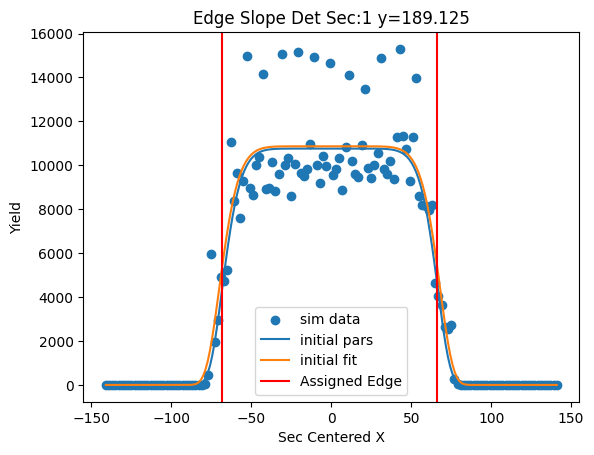

[ 1.06241517e+04 -1.02404647e+00  5.05267054e+01  9.40315224e+00]


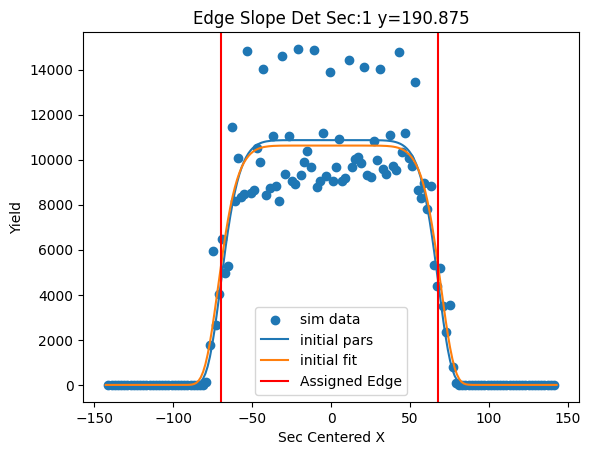

[ 1.03296535e+04 -1.11378410e+00  5.17296943e+01  9.64334328e+00]


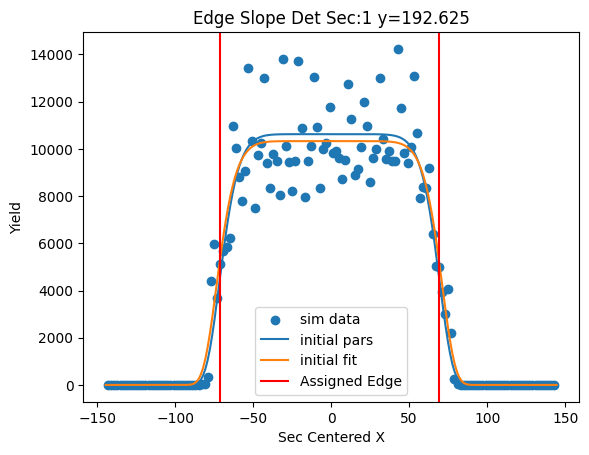

[ 9.43990764e+03 -1.03912485e+00  5.20981200e+01  9.86231431e+00]


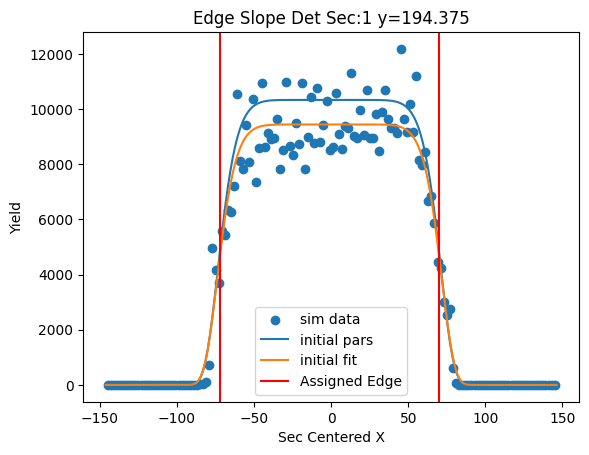

[ 9.25821376e+03 -1.25993045e+00  5.26339536e+01  9.96305522e+00]


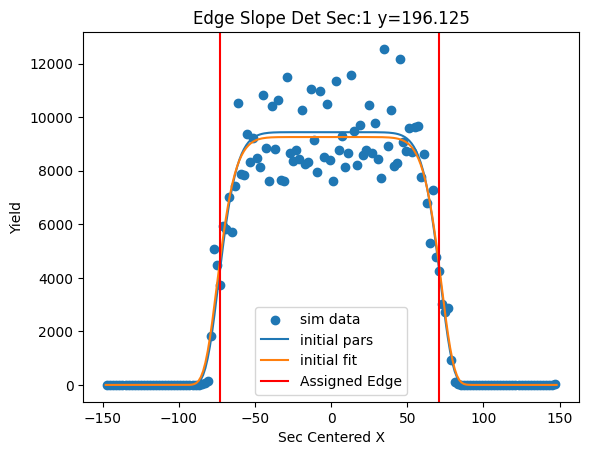

[ 9.25522369e+03 -1.71009890e+00  5.34387788e+01  1.04536701e+01]


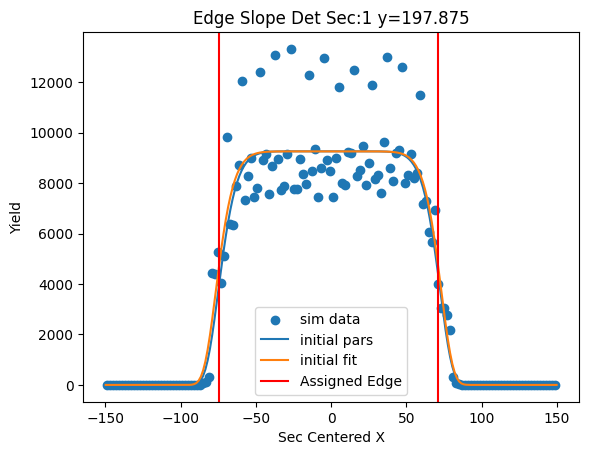

[ 8.49896460e+03 -1.56209008e+00  5.39298182e+01  1.02825662e+01]


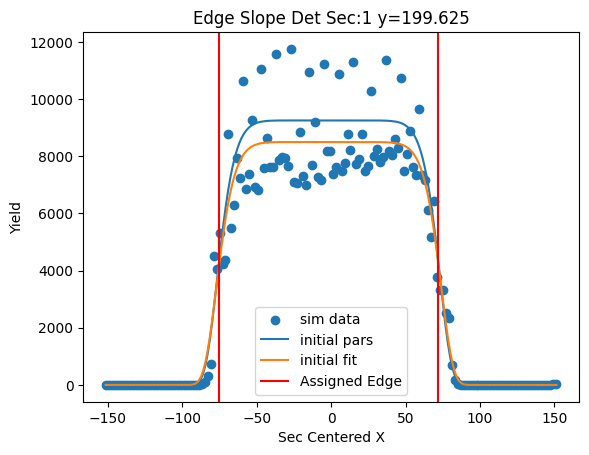

[ 7.70753094e+03 -1.02590438e+00  5.42494333e+01  1.01759225e+01]


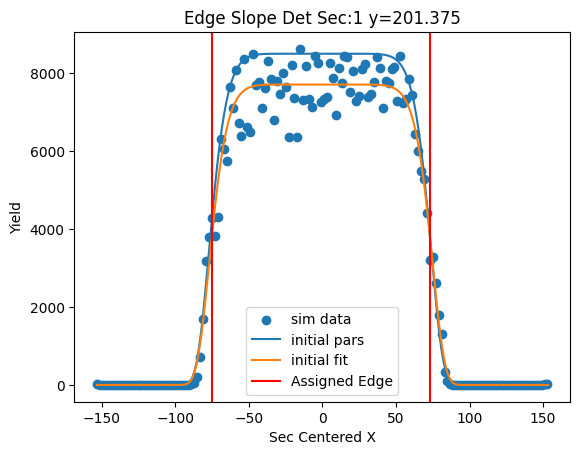

[ 8.36578721e+03 -1.09083544e+00  5.54049416e+01  1.05225595e+01]


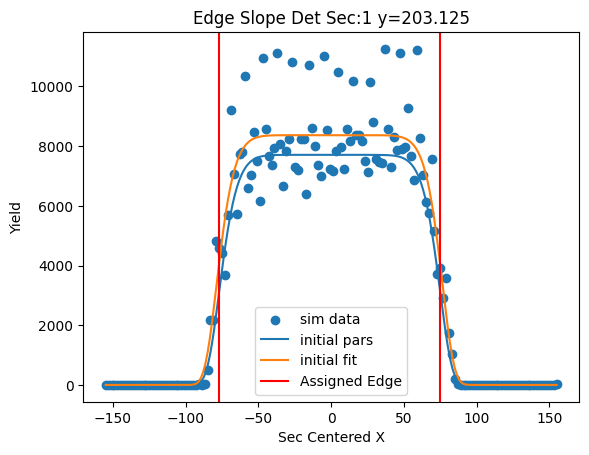

[ 8.27701286e+03 -9.46222517e-01  5.63785724e+01  1.10911953e+01]


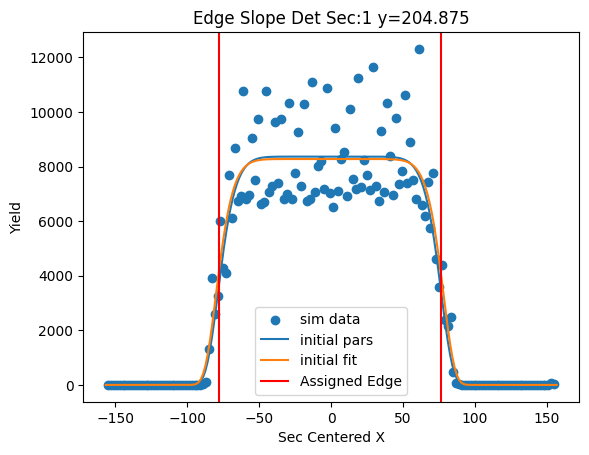

[ 7.88870581e+03 -1.66380195e+00  5.73662797e+01  1.09431031e+01]


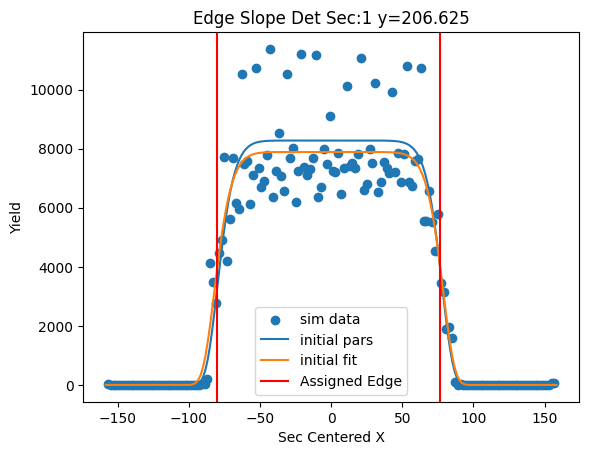

[ 6.82496992e+03 -1.47657921e+00  5.78692098e+01  1.10386306e+01]


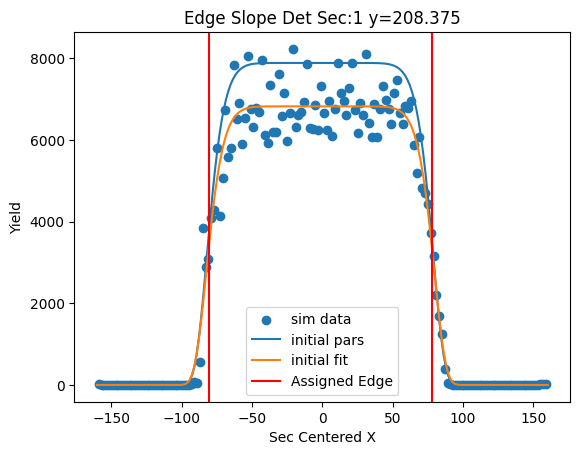

[ 6.86214540e+03 -1.51323986e+00  5.87812402e+01  1.18725636e+01]


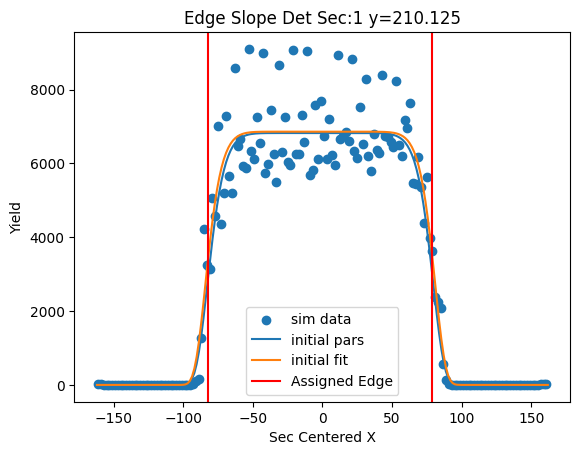

[ 7.19956947e+03 -1.80086389e+00  5.97573021e+01  1.28455104e+01]


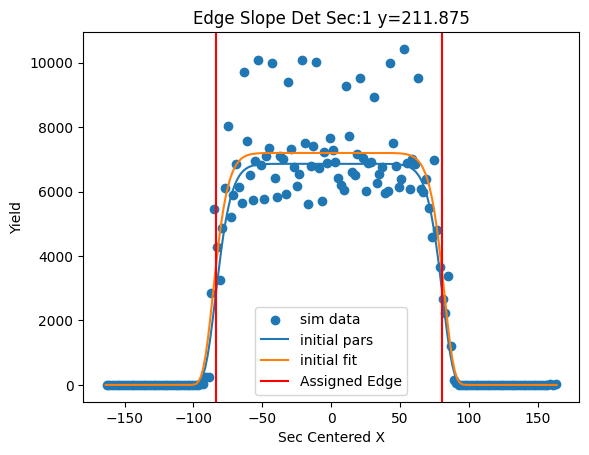

[ 6.74167220e+03 -1.85447372e+00  6.03366836e+01  1.31071943e+01]


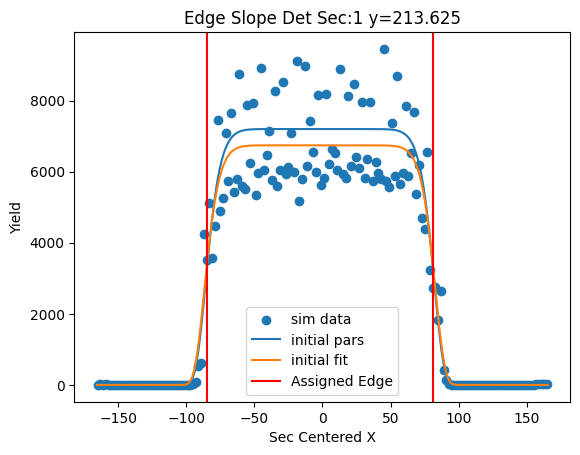

[ 5.97078352e+03 -1.62971285e+00  6.08199060e+01  1.31558058e+01]


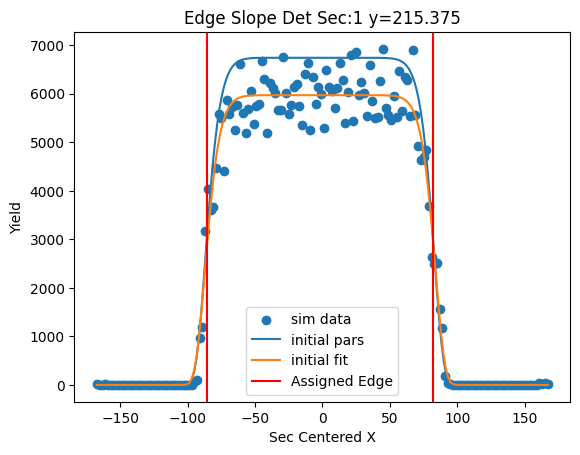

[ 6.33838630e+03 -2.15015927e+00  6.16895485e+01  1.28270639e+01]


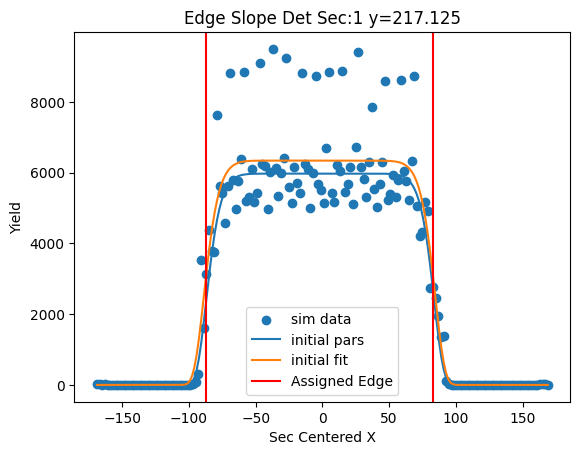

[ 6.26310892e+03 -2.50000622e+00  6.27560593e+01  1.31953356e+01]


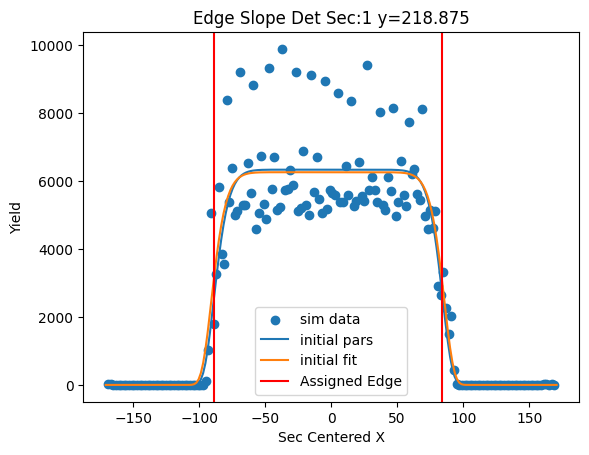

[ 6.11266088e+03 -2.66205641e+00  6.34807535e+01  1.24125340e+01]


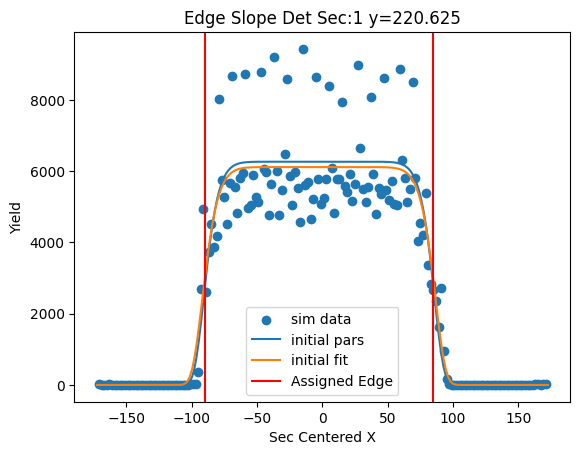

[ 5.48400717e+03 -2.28972957e+00  6.38927506e+01  1.18530242e+01]


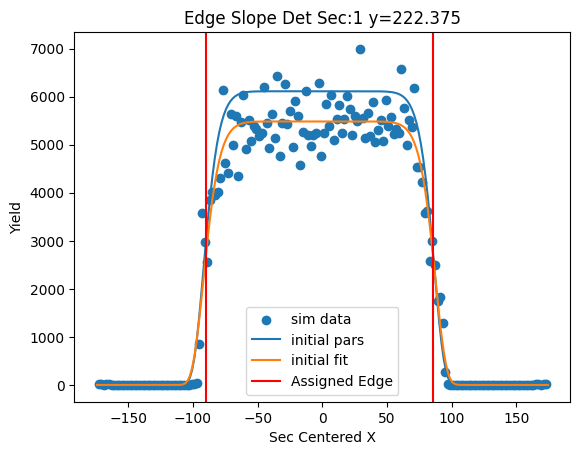

[ 5.78496957e+03 -2.76723519e+00  6.45684152e+01  1.17090146e+01]


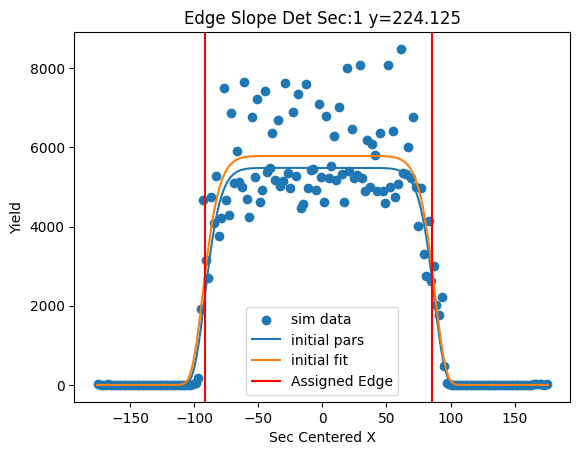

[ 5.99535030e+03 -3.18294470e+00  6.53267893e+01  1.14629629e+01]


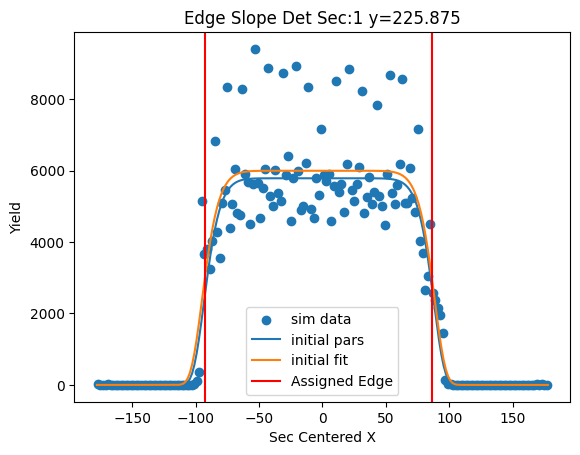

[ 5.38833134e+03 -3.06498544e+00  6.58634090e+01  1.10667046e+01]


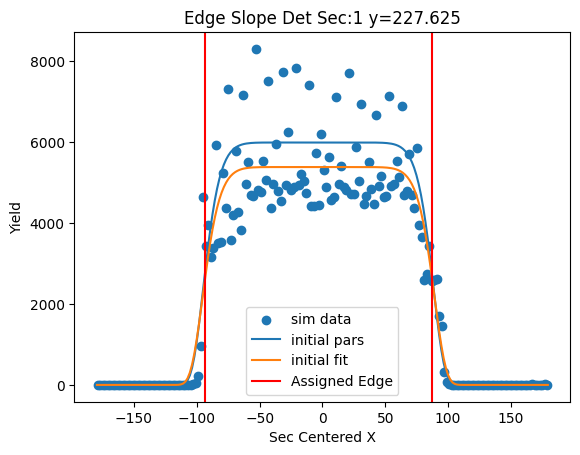

[ 4.91193730e+03 -2.56252706e+00  6.60272241e+01  1.04643330e+01]


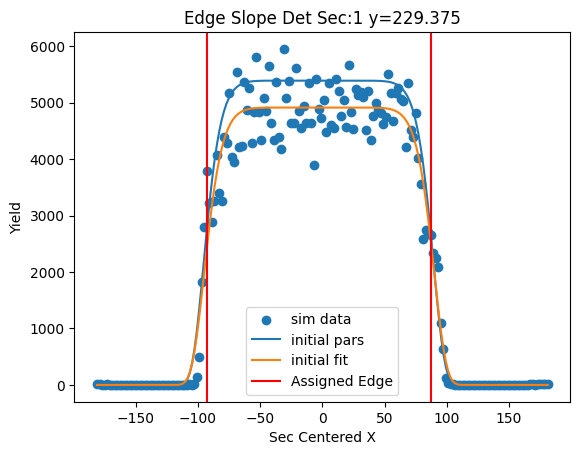

[ 5.53387841e+03 -2.32315437e+00  6.64837396e+01  1.03851092e+01]


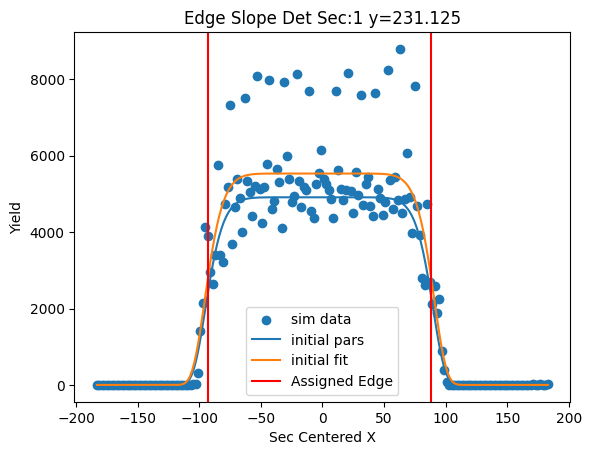

[ 5.49434884e+03 -2.03279073e+00  6.68321825e+01  9.98508159e+00]


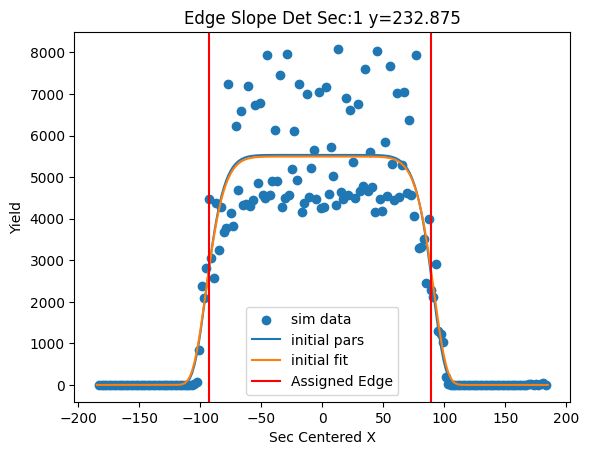

[ 5.16246885e+03 -2.53221332e+00  6.76817308e+01  9.95819608e+00]


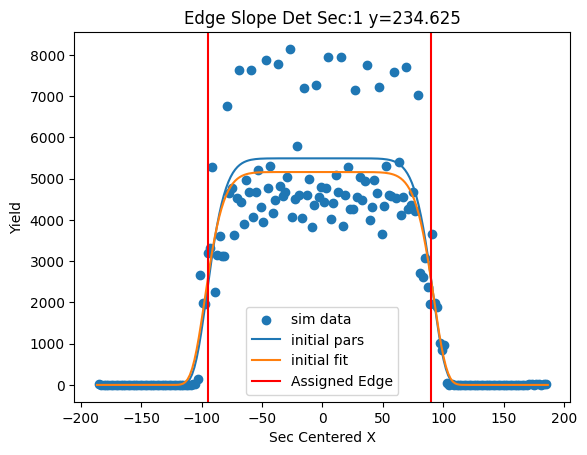

[ 4.29031291e+03 -1.82696016e+00  6.80039578e+01  9.88985297e+00]


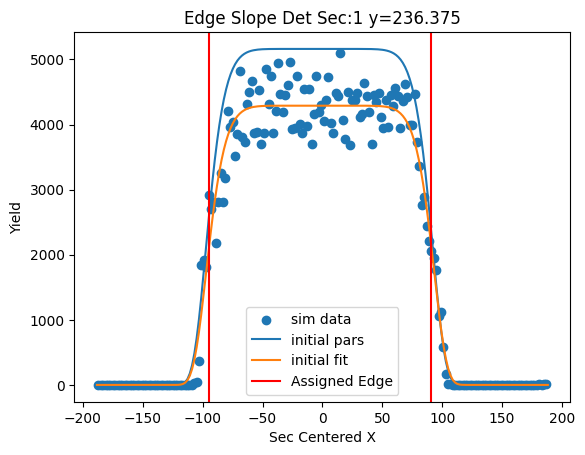

[ 4.56203078e+03 -1.87748722e+00  6.90369544e+01  1.01075346e+01]


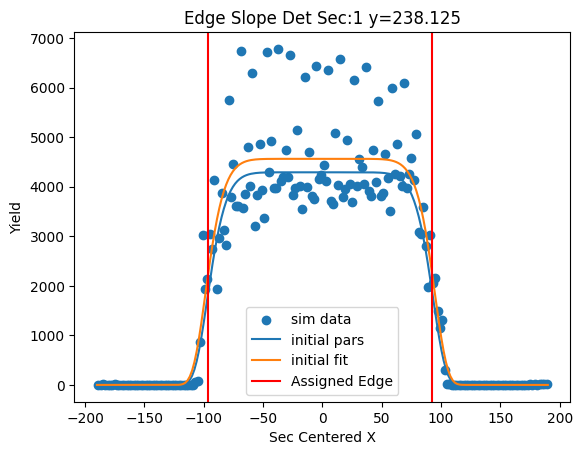

[ 4.74215750e+03 -1.80612983e+00  7.02002024e+01  1.04961631e+01]


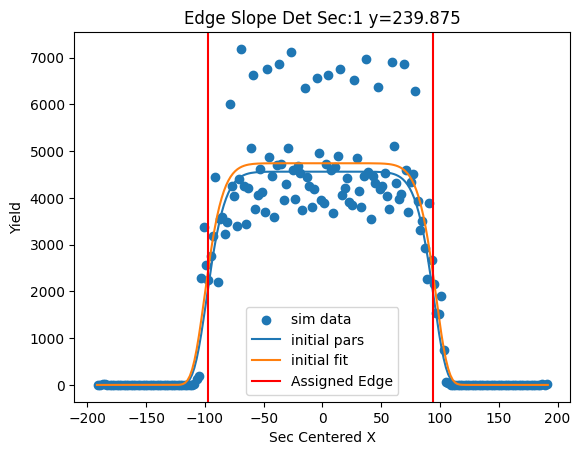

[ 4.22558117e+03 -1.70336219e+00  7.09497616e+01  1.16810181e+01]


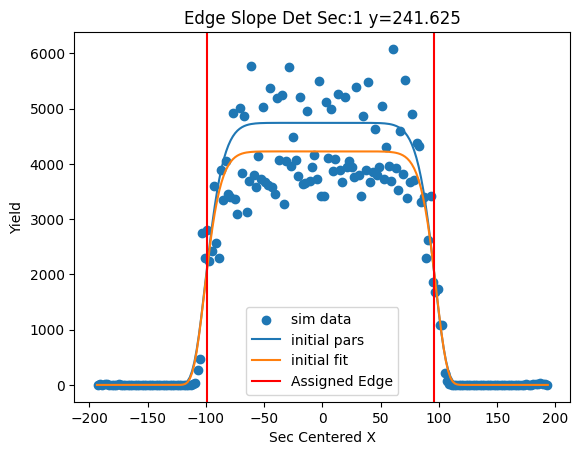

[ 3.85282705e+03 -1.70179528e+00  7.12943137e+01  1.19382246e+01]


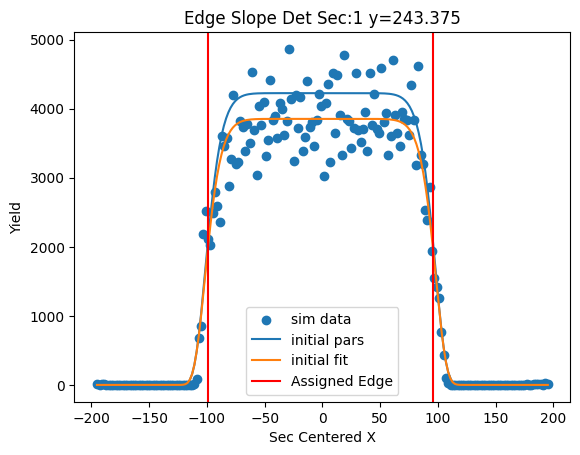

[ 4.19158339e+03 -1.89280575e+00  7.17476070e+01  1.18344515e+01]


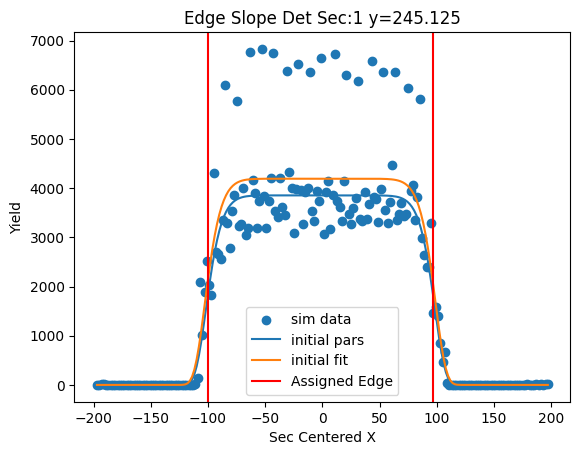

[ 3.96358008e+03 -1.95560995e+00  7.22621045e+01  1.16901701e+01]


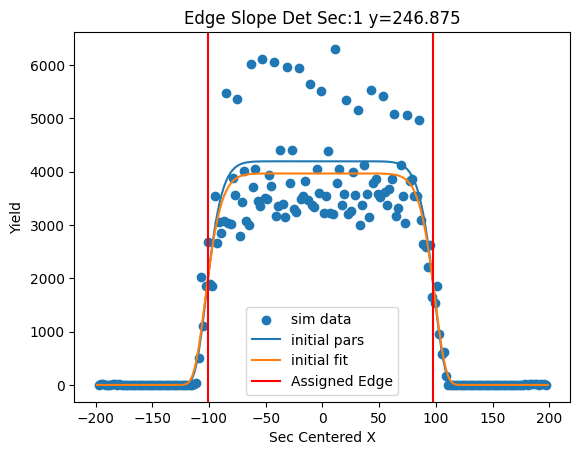

[ 3.84450296e+03 -1.59025342e+00  7.25186457e+01  1.13923272e+01]


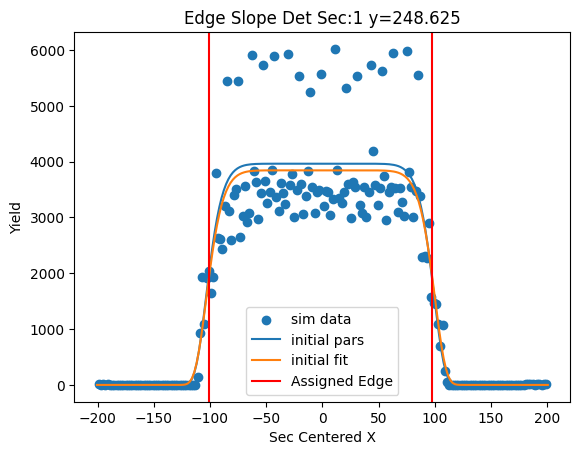

[ 3.34750113e+03 -1.27815256e+00  7.26480741e+01  1.09633535e+01]


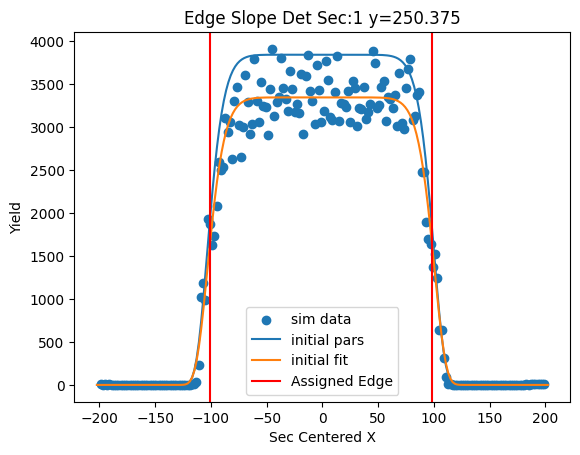

[ 3.66958180e+03 -1.20830291e+00  7.29962211e+01  1.09106371e+01]


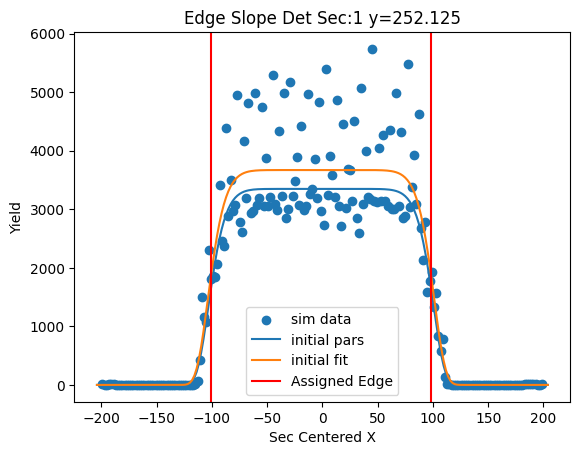

[ 3.75813844e+03 -1.52710627e+00  7.40673152e+01  1.07524416e+01]


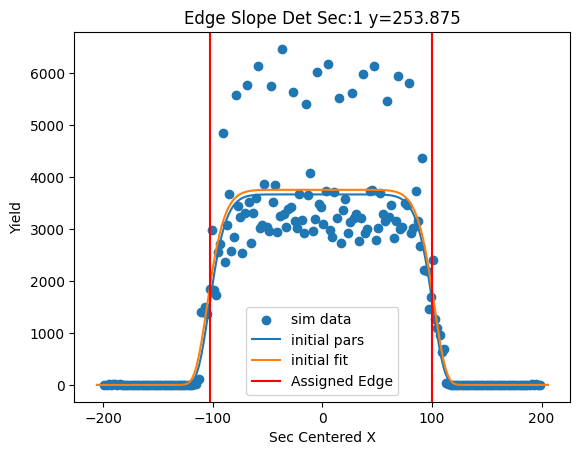

[ 3.19913516e+03 -1.64298919e+00  7.46547968e+01  1.05925974e+01]


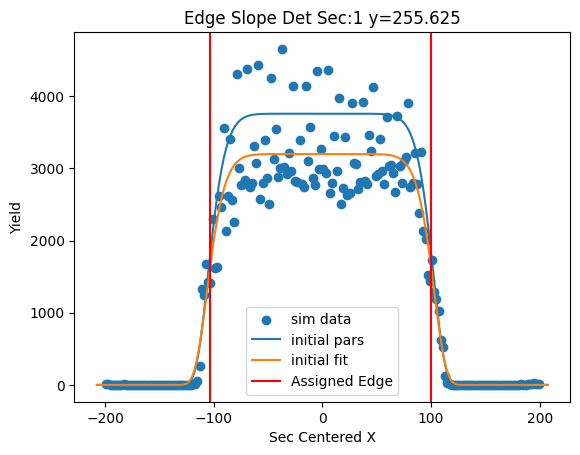

[ 2.98255923e+03 -1.52523613e+00  7.50600549e+01  1.02965967e+01]


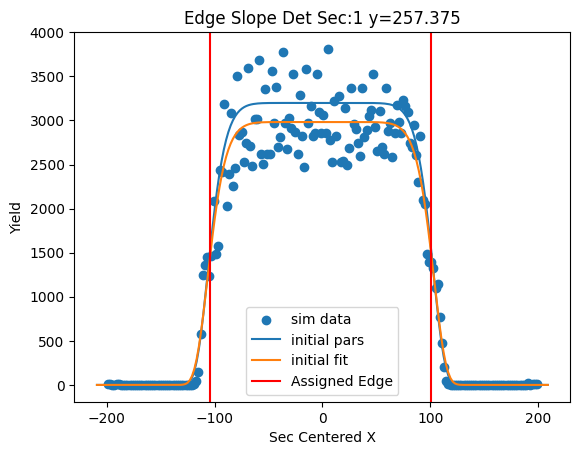

[ 3.45645070e+03 -1.68505151e+00  7.56887624e+01  1.02198778e+01]


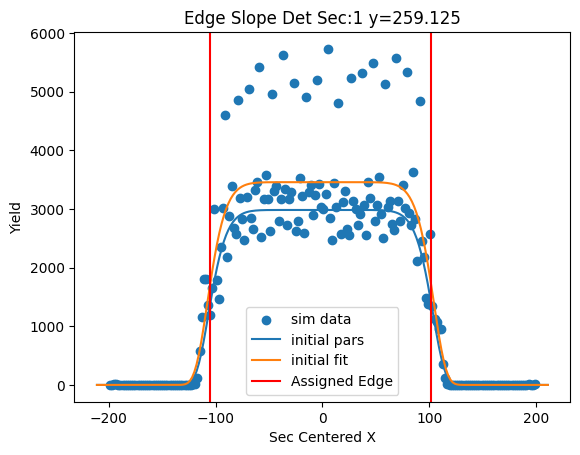

[ 3.35955431e+03 -1.54561171e+00  7.58870161e+01  9.70603789e+00]


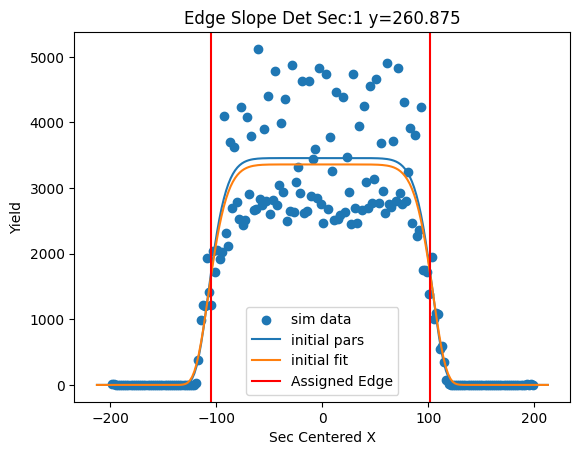

[ 3.23215278e+03 -1.97463312e+00  7.61829835e+01  9.37123125e+00]


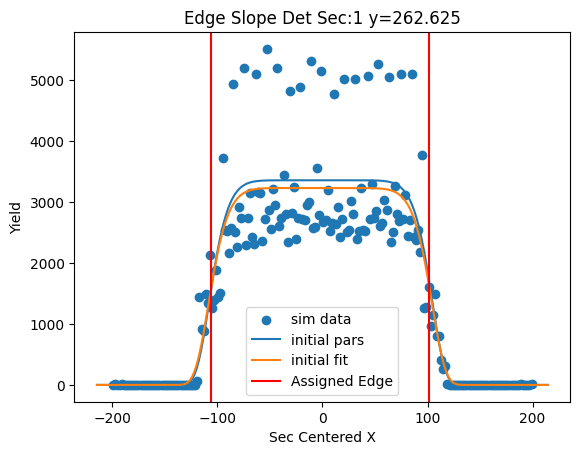

[ 2.63876879e+03 -1.89739847e+00  7.62172380e+01  8.66474929e+00]


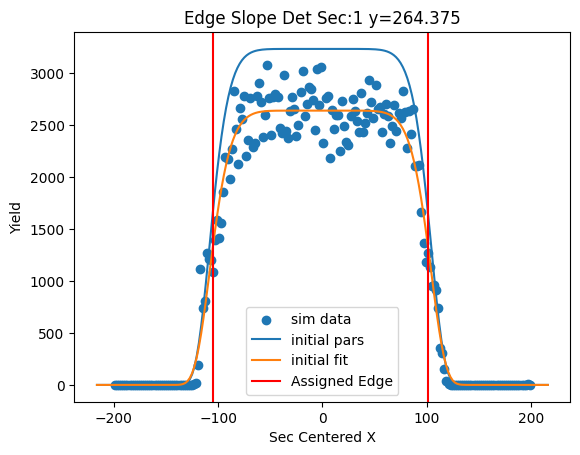

[ 2.96426110e+03 -2.08573989e+00  7.65218719e+01  8.51374093e+00]


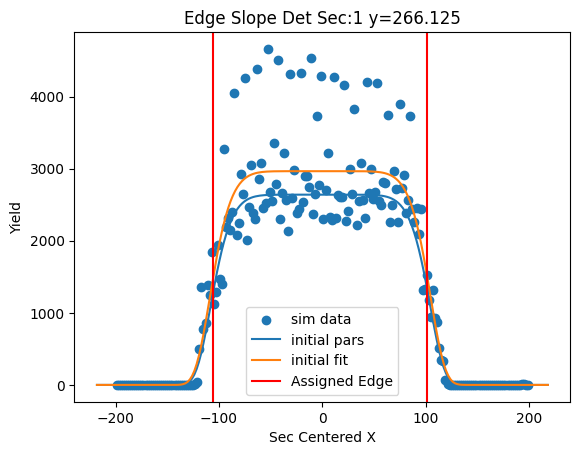

[ 3.07434058e+03 -1.43823137e+00  7.71122352e+01  8.94446056e+00]


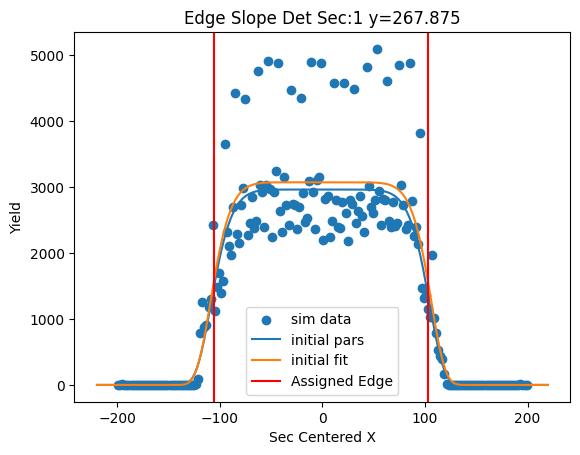

[ 2.64812101e+03 -1.24864871e+00  7.69821317e+01  8.82176182e+00]


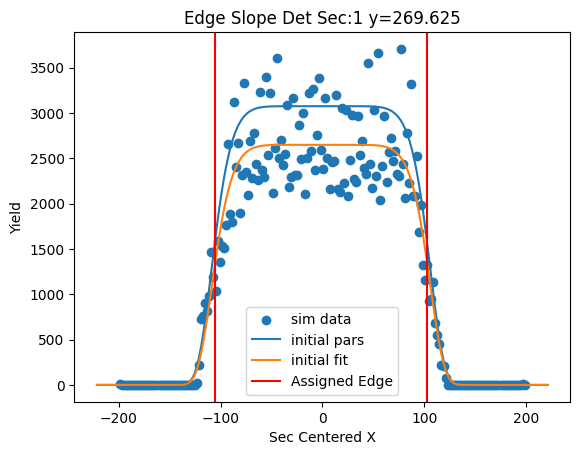

[ 2.57871109e+03 -1.04071370e+00  7.70450670e+01  8.84461050e+00]


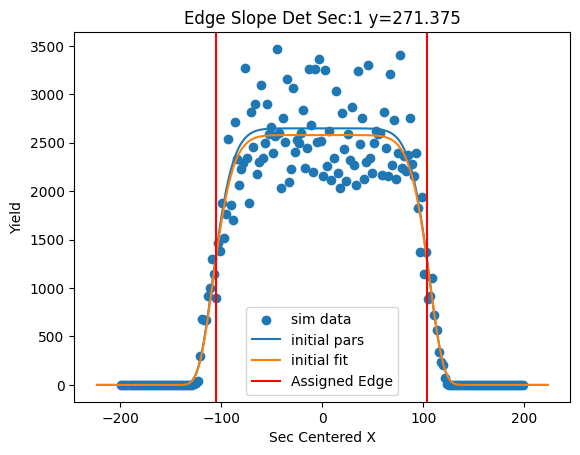

[ 2.85968231e+03 -1.12959271e+00  7.79916420e+01  9.43335021e+00]


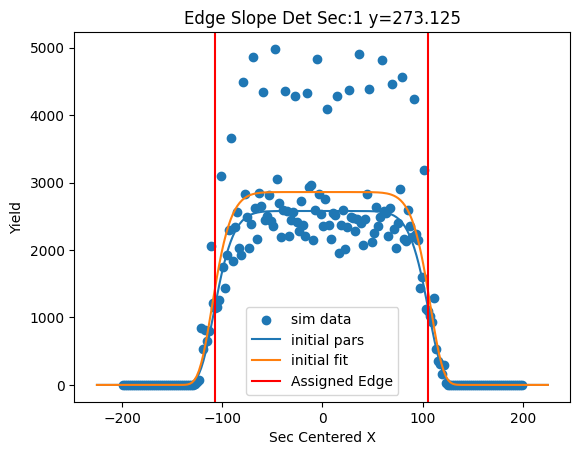

[ 2.63420959e+03 -1.51499062e+00  7.87676573e+01  9.15691753e+00]


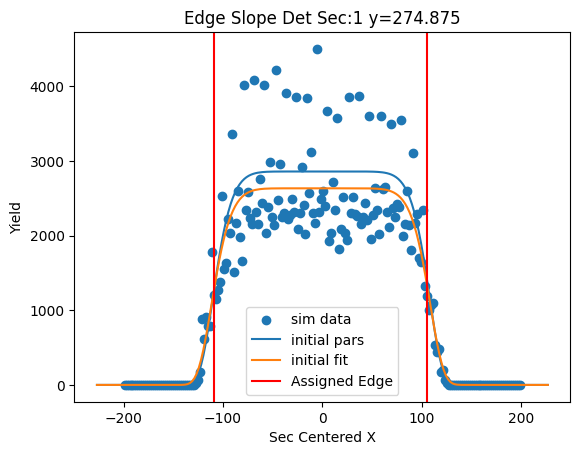

[ 2.20924285e+03 -1.10770503e+00  7.91824411e+01  9.08935880e+00]


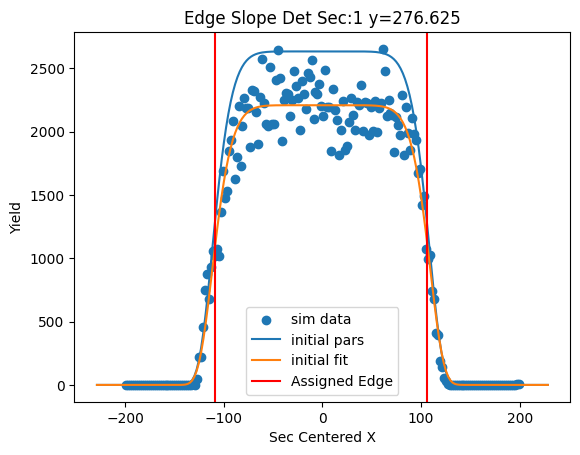

[ 2.56800268e+03 -1.06733734e+00  8.05958910e+01  1.01977775e+01]


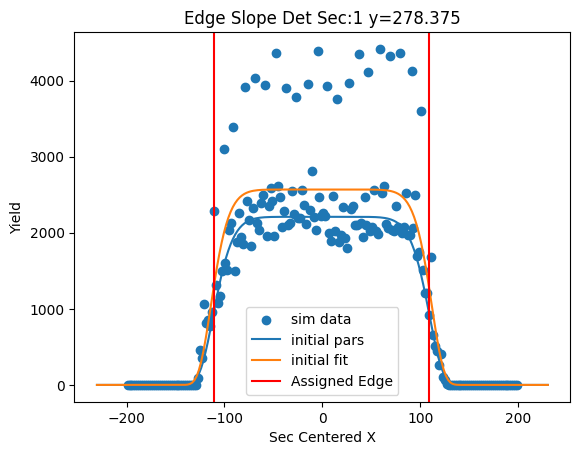

[ 2.57594839e+03 -8.61872200e-01  8.13704599e+01  1.00551616e+01]


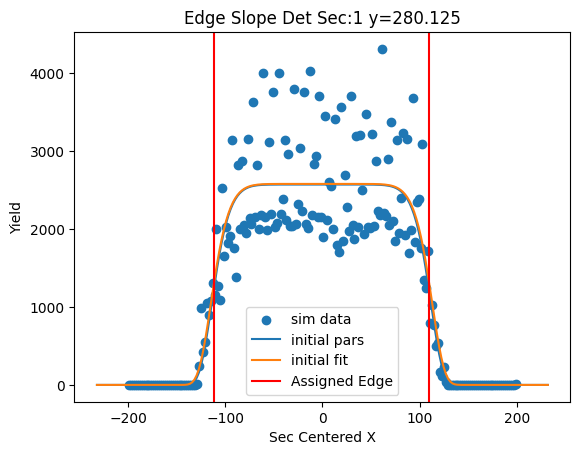

[ 2.54168069e+03 -1.90791230e+00  8.27098274e+01  1.04377259e+01]


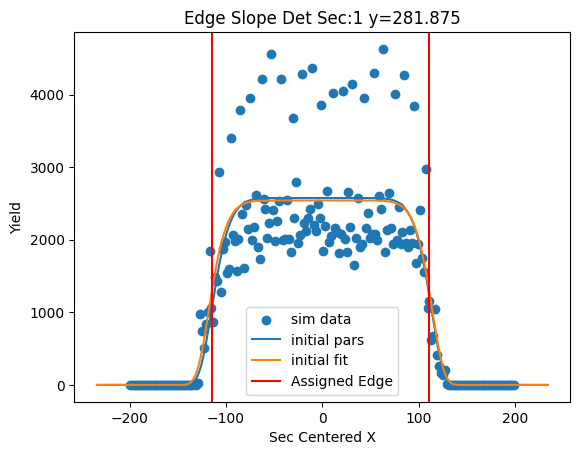

[ 2.04366826e+03 -1.93631900e+00  8.29544810e+01  9.96707616e+00]


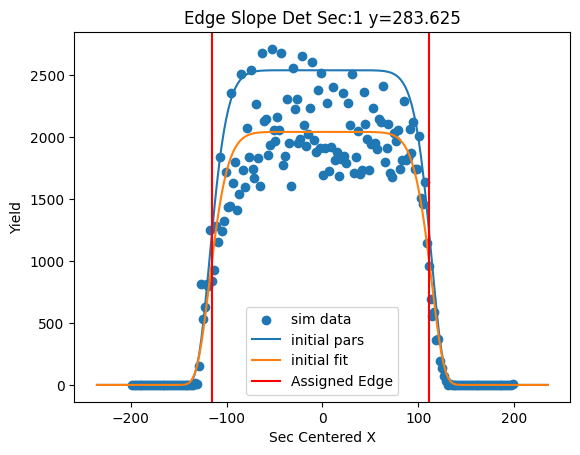

[ 2.04389412e+03 -1.73356938e+00  8.35750131e+01  1.02735831e+01]


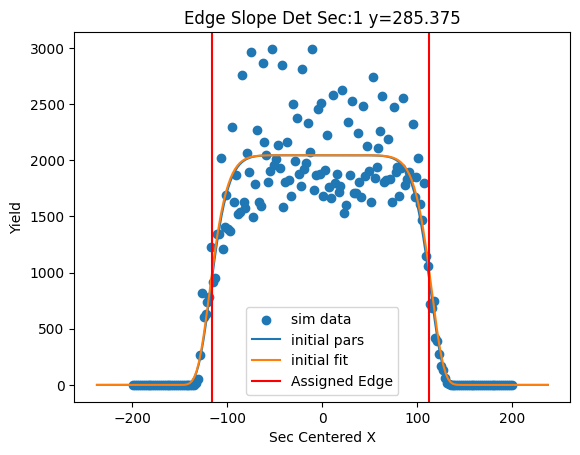

[ 2.32760586e+03 -1.26004124e+00  8.46239758e+01  1.03115004e+01]


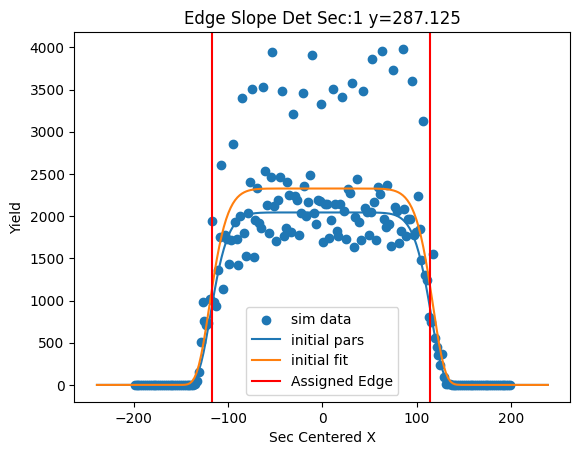

[ 2.16463035e+03 -9.58114662e-01  8.47614418e+01  1.00358428e+01]


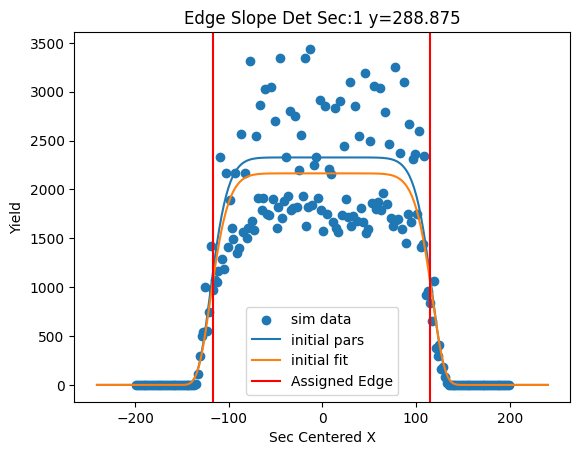

[ 1.75279055e+03 -1.20383449e+00  8.54487264e+01  1.00414305e+01]


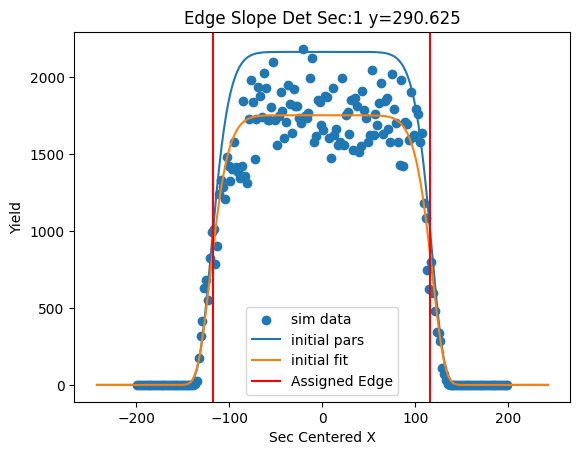

[ 1.96188216e+03 -1.18321120e+00  8.63304444e+01  1.04801328e+01]


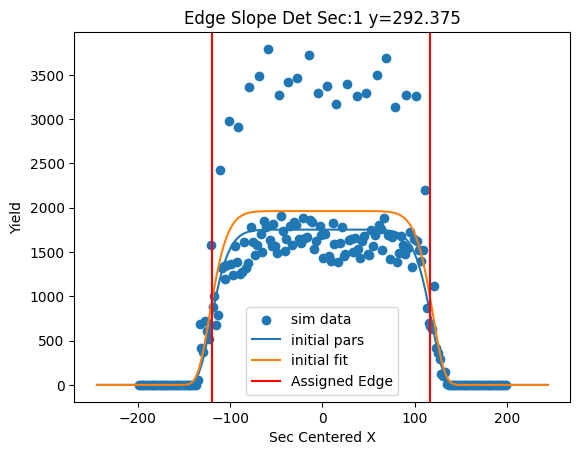

[ 1.84382413e+03 -1.67055483e+00  8.71998319e+01  9.64104074e+00]


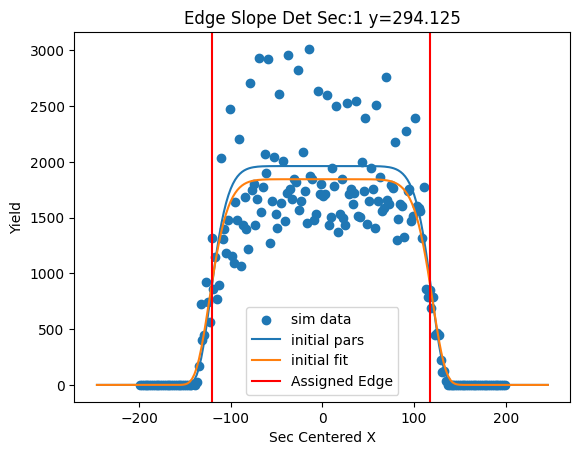

[ 1.83763882e+03 -1.66127773e+00  8.84637671e+01  1.02135711e+01]


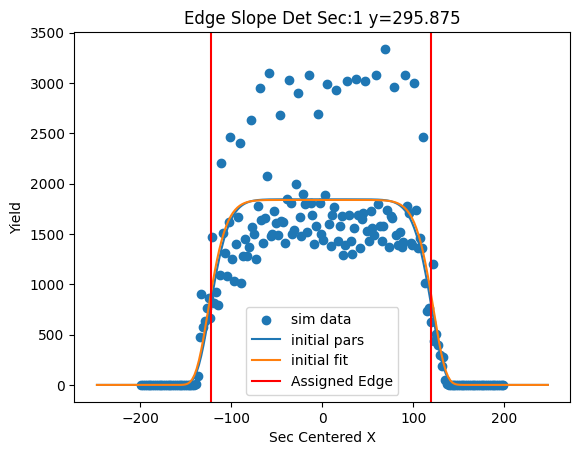

[ 1.55457849e+03 -1.37998845e+00  8.89230864e+01  1.01616434e+01]


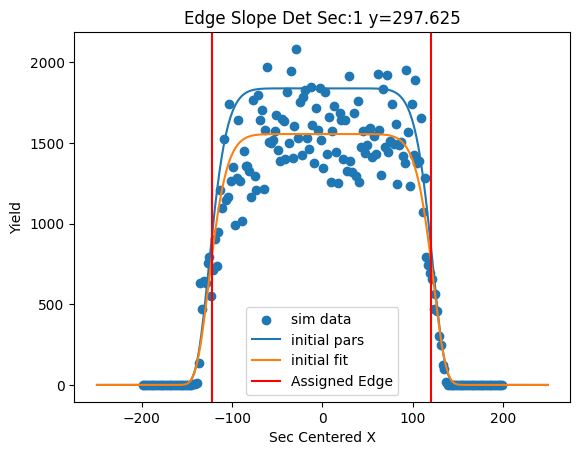

[ 1.58797364e+03 -1.49872264e+00  8.96169789e+01  1.00144254e+01]


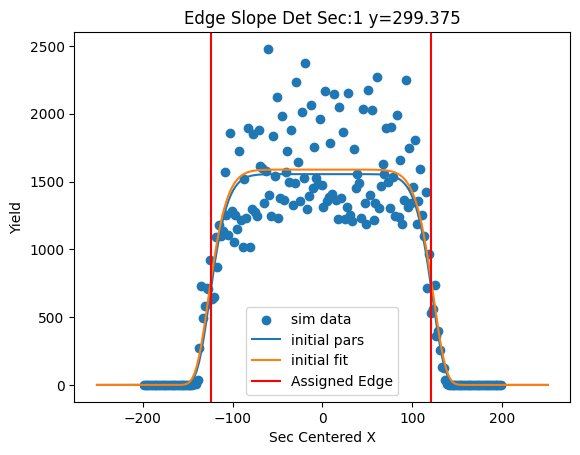

[1726.01478945   -2.03269022   90.39105629    9.55666004]


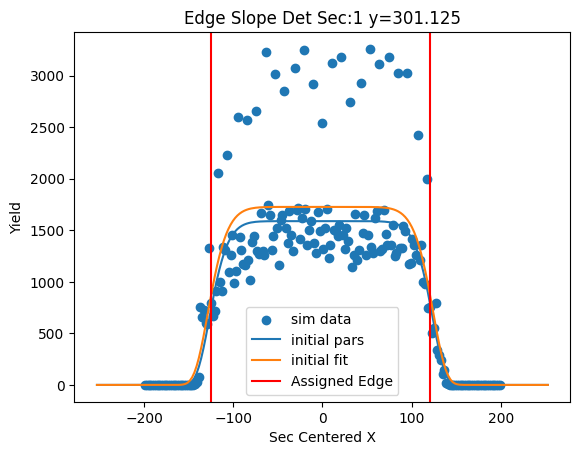

[1503.55018618   -2.57313203   90.97329462    9.17135193]


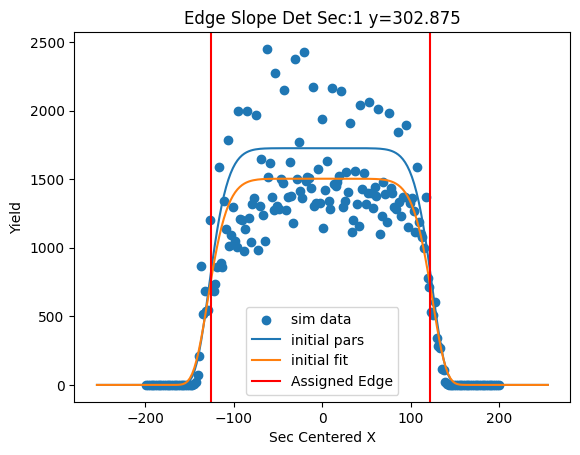

[1279.78568422   -2.36766539   91.4190051    10.05281756]


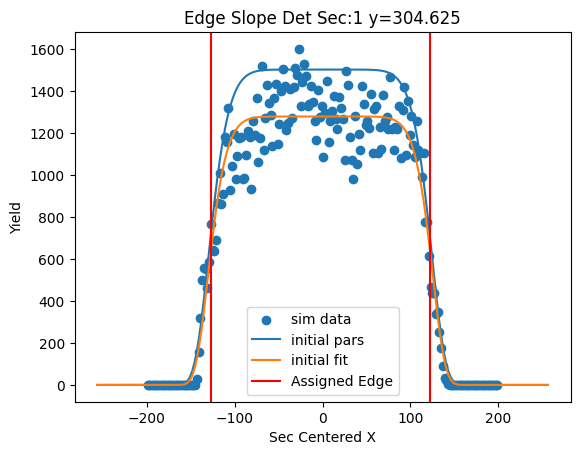

[ 1.57111036e+03 -1.19569630e+00  9.14595808e+01  9.85668951e+00]


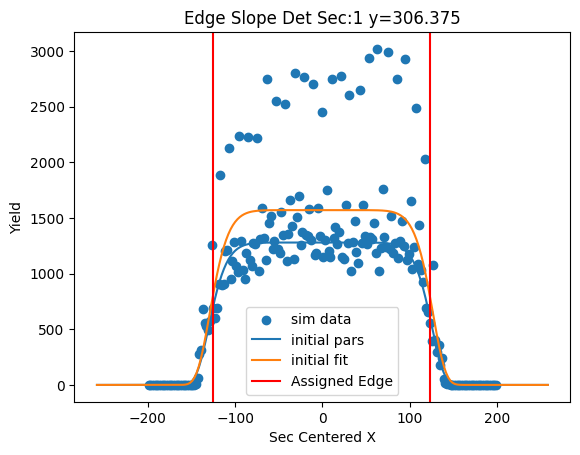

[ 1.57800629e+03 -1.07185873e+00  9.14851872e+01  9.44721179e+00]


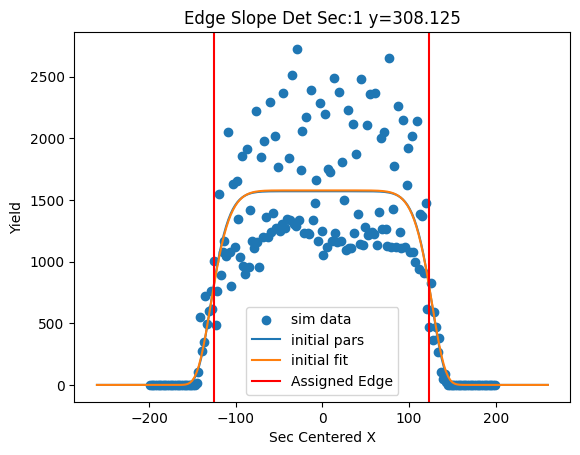

[1548.39561714   -1.70834524   92.47285643   10.10313356]


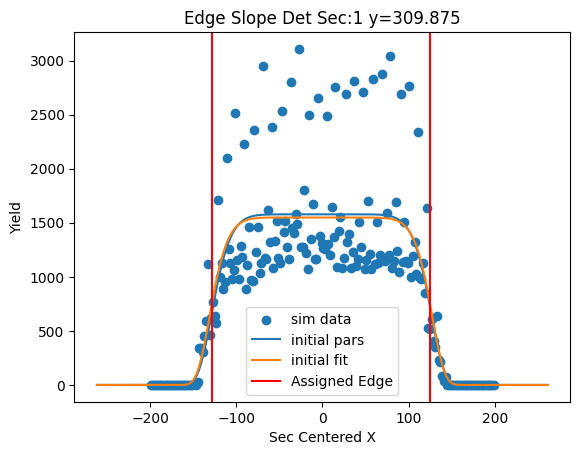

[1185.4311688    -2.05299993   93.09618007    9.74400952]


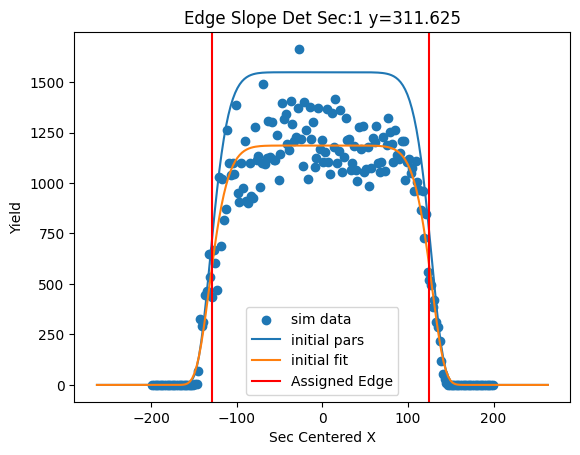

[1237.75057905   -1.65523168   93.6869646     9.54525506]


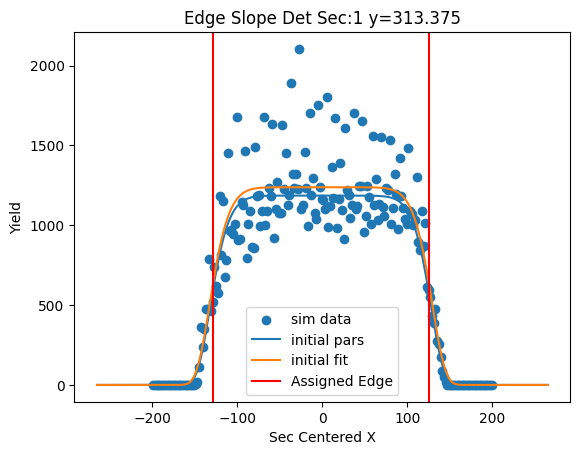

[1412.33660985   -2.0157372    95.07604818   10.28150369]


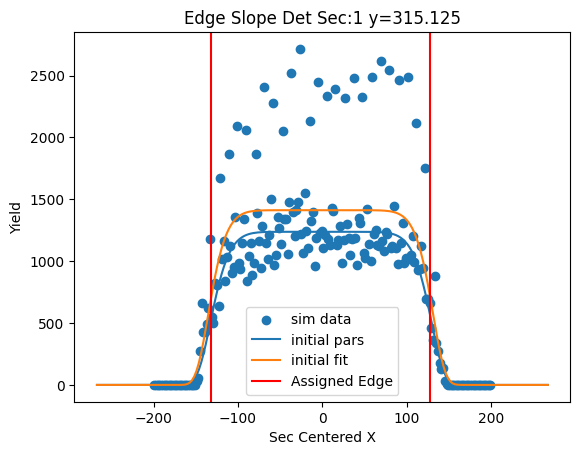

[1287.78726959   -1.61928046   95.74879678   10.09369141]


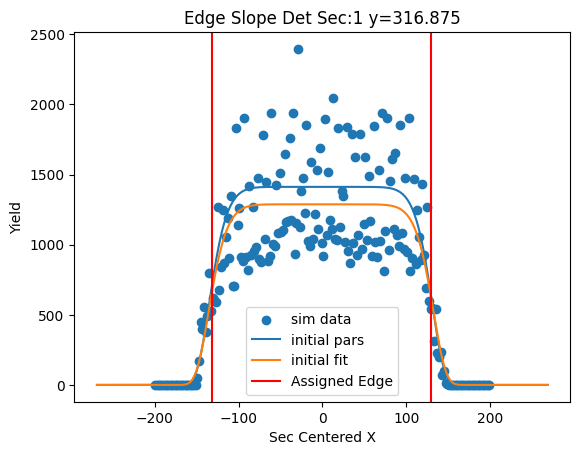

[1069.50933278   -1.07235023   96.41767202   10.83111322]


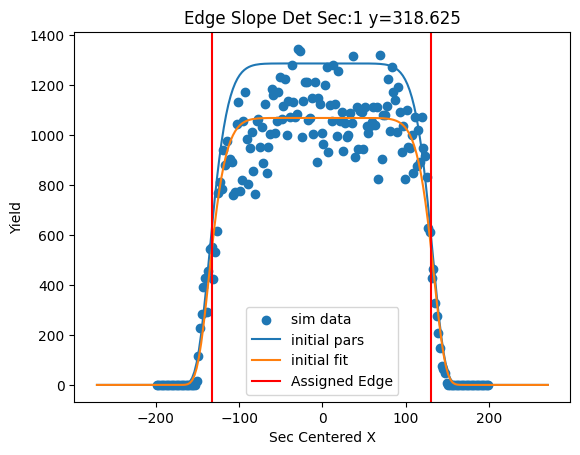

[1235.11126749   -2.07153013   96.98642312   11.15052933]


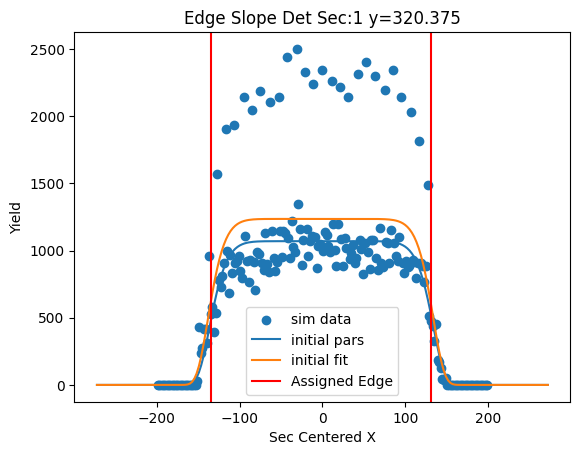

[1163.76961657   -3.38689722   97.89054117   10.27346391]


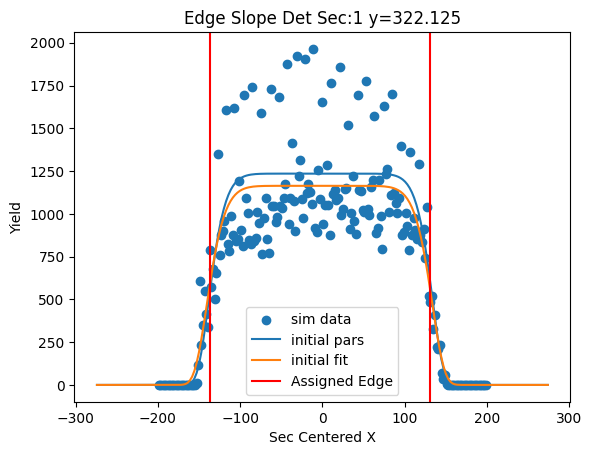

[1181.44145807   -2.83301783   98.93801752   11.32508713]


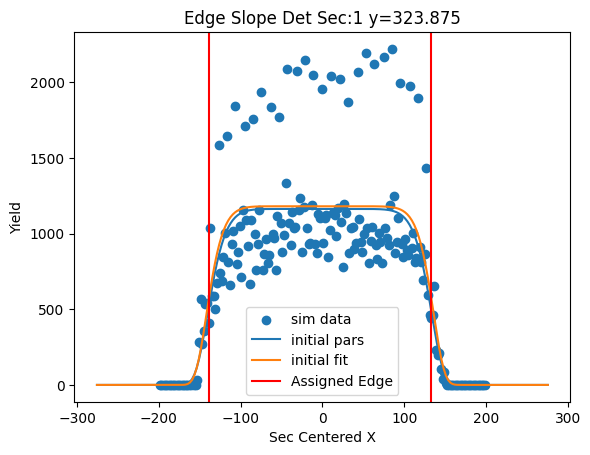

[963.2964296   -1.82656061  98.83630118  11.44739437]


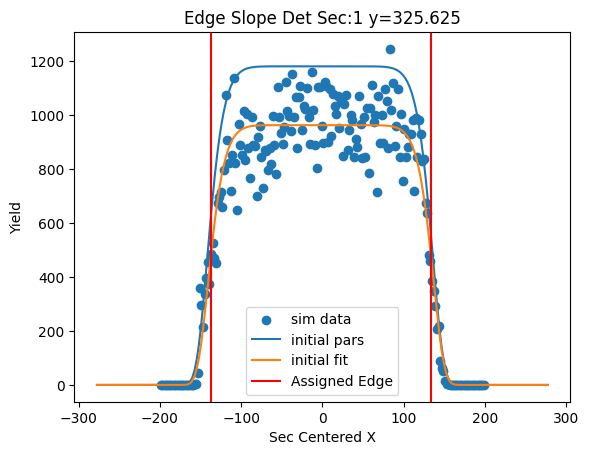

[1090.06569904   -2.28020544   98.71453729   11.01487483]


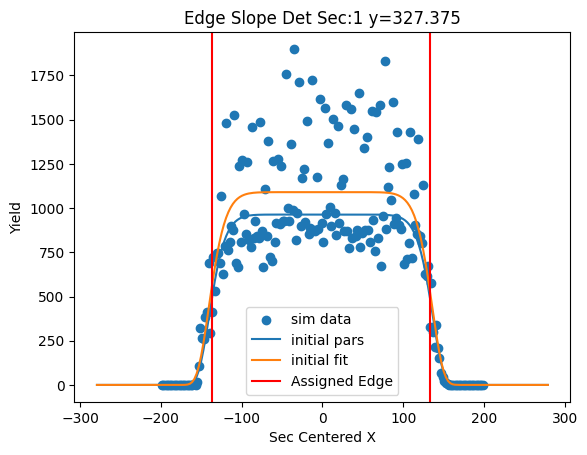

[1177.37818314   -2.68351271   99.62027789   11.48879772]


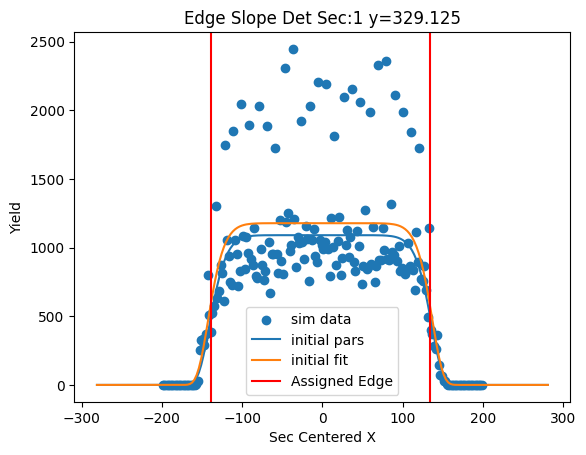

[ 1.06532237e+05 -9.21250482e-02  1.70290510e+01  1.75198254e+01]


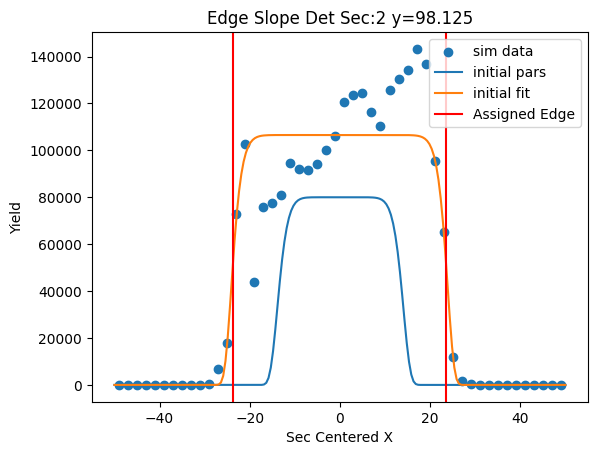

[ 1.08802460e+05 -7.26163375e-02  1.77889962e+01  1.35302806e+01]


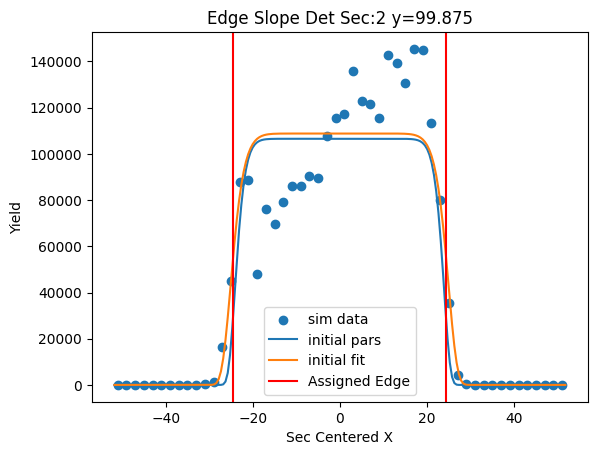

[1.09899251e+05 2.54812261e-01 1.86538667e+01 9.16791021e+00]


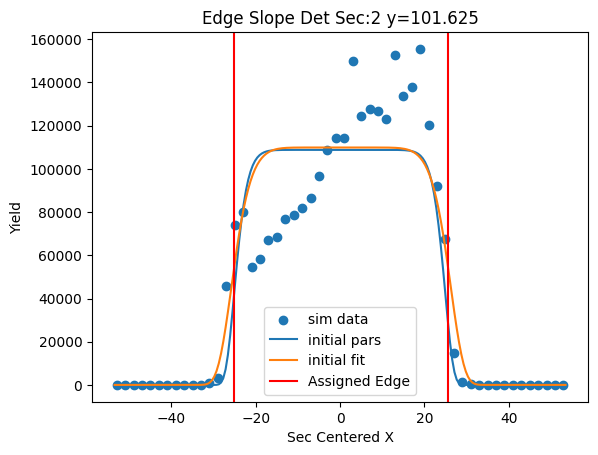

[1.21158937e+05 3.39151254e+00 1.78709615e+01 3.39200508e+00]


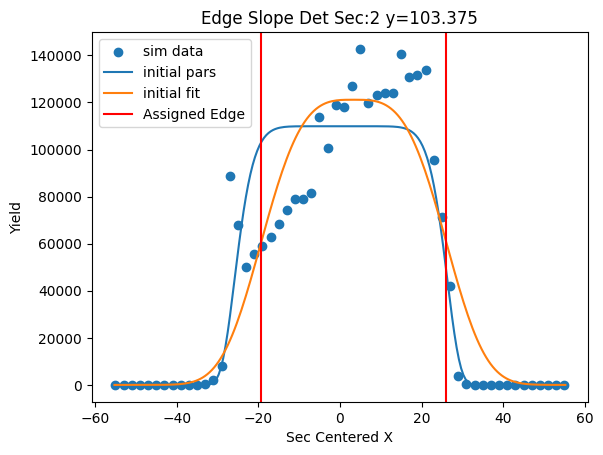

[1.10941914e+05 3.08163199e+00 1.83645261e+01 3.54054031e+00]


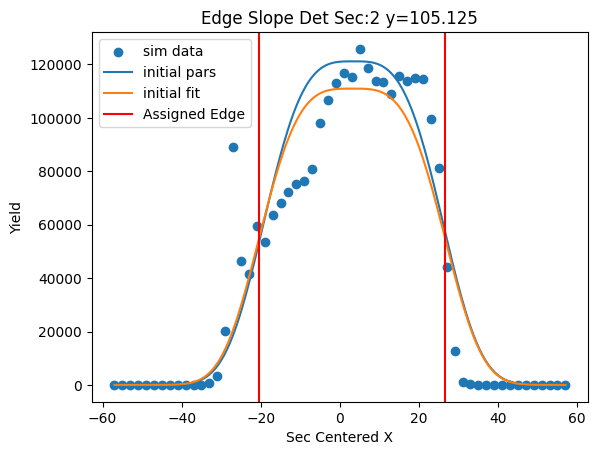

[1.05828959e+05 2.90174868e+00 1.87515845e+01 3.19189912e+00]


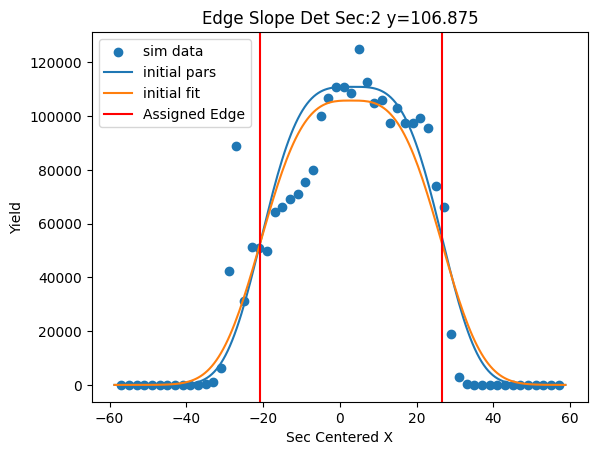

[1.03621047e+05 2.81995464e+00 1.88961891e+01 2.71503101e+00]


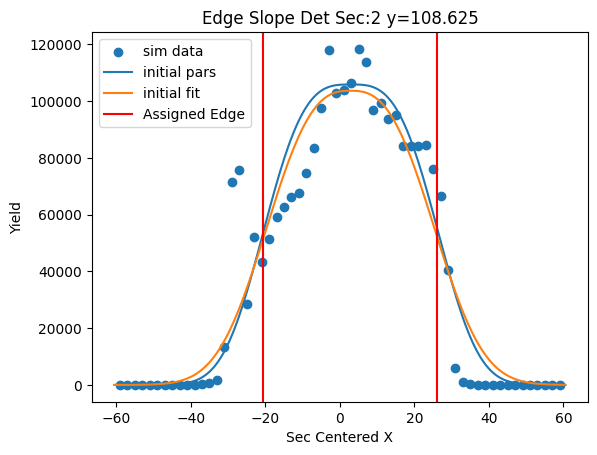

[9.85331897e+04 2.67773375e+00 1.89967360e+01 2.52103236e+00]


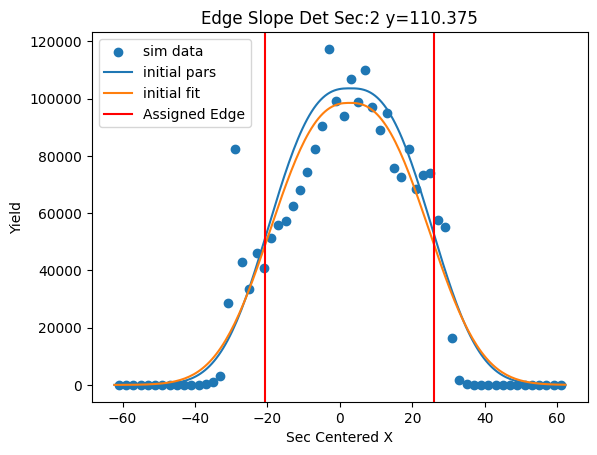

[9.03444094e+04 2.47108860e+00 1.94295809e+01 2.49375942e+00]


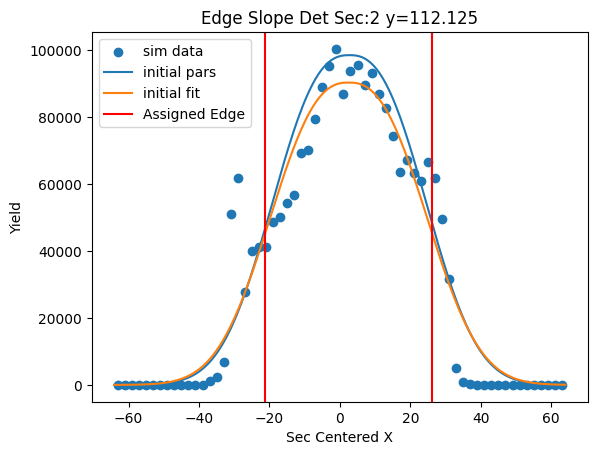

[8.69249000e+04 2.42317781e+00 2.03059917e+01 2.53147893e+00]


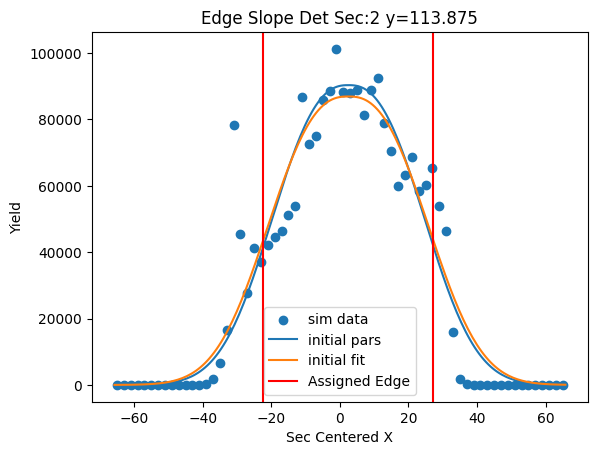

[8.21561552e+04 2.38690896e+00 2.13626348e+01 2.66152145e+00]


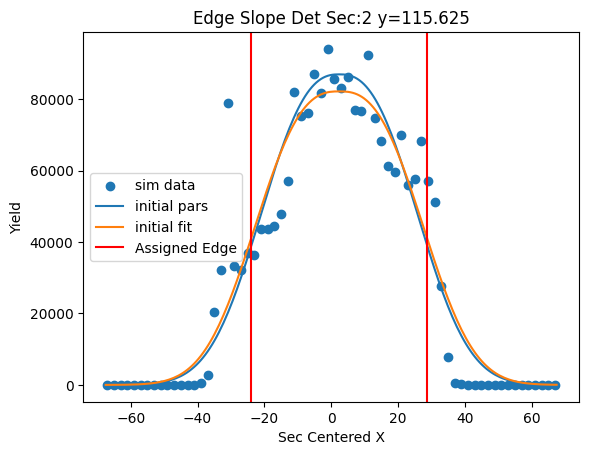

[7.67561811e+04 2.17406153e+00 2.23857538e+01 2.89625527e+00]


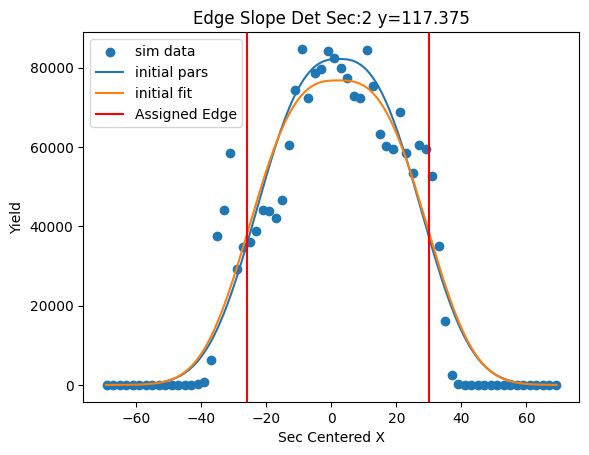

[7.12829244e+04 1.98262989e+00 2.27526769e+01 2.96616760e+00]


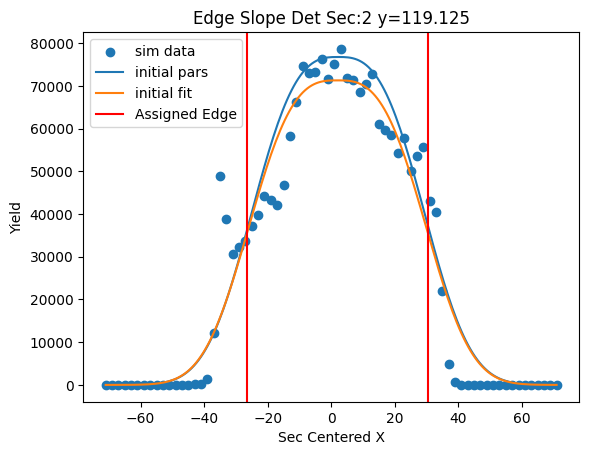

[6.92606173e+04 1.66222499e+00 2.32229262e+01 2.82028011e+00]


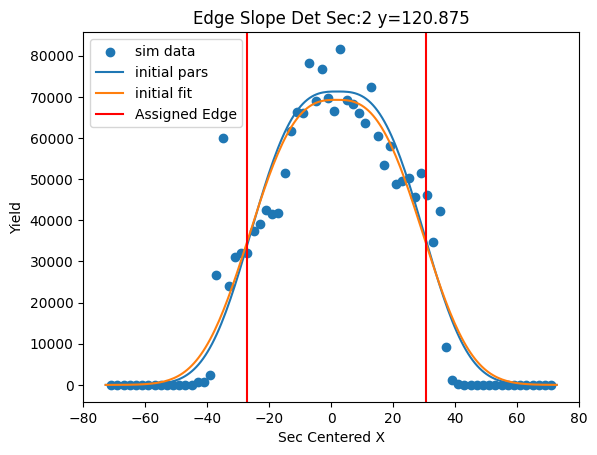

[6.70985782e+04 9.76761313e-01 2.35422236e+01 2.64630931e+00]


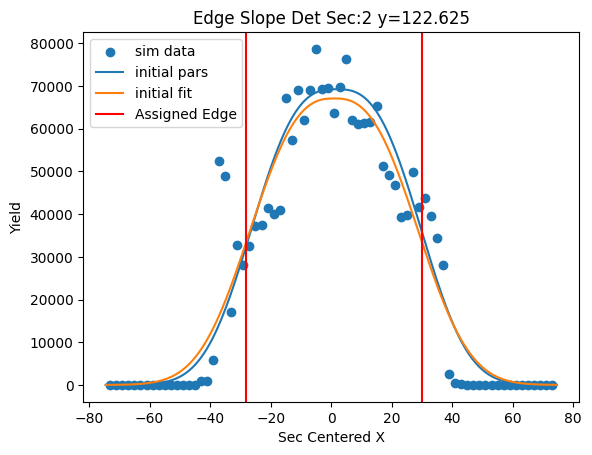

[6.24102170e+04 4.55855422e-01 2.33534485e+01 2.46989153e+00]


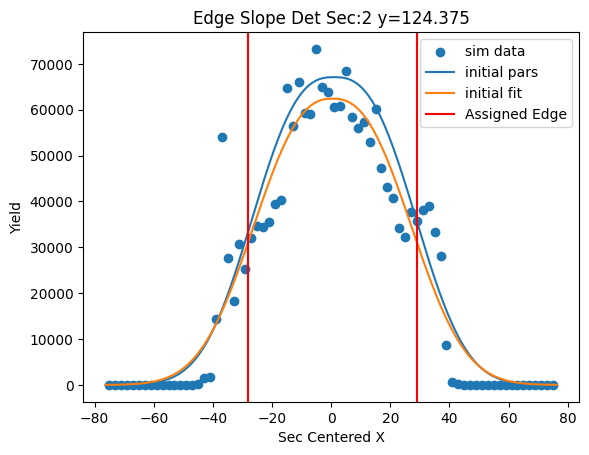

[5.78375867e+04 6.53591142e-01 2.33540435e+01 2.42614444e+00]


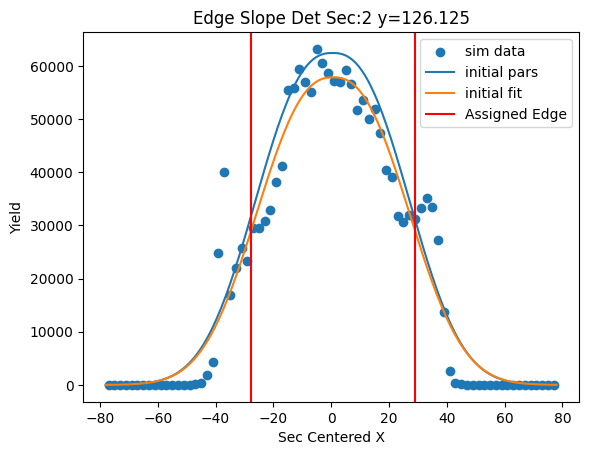

[5.73853753e+04 1.12988075e+00 2.41911365e+01 2.44536461e+00]


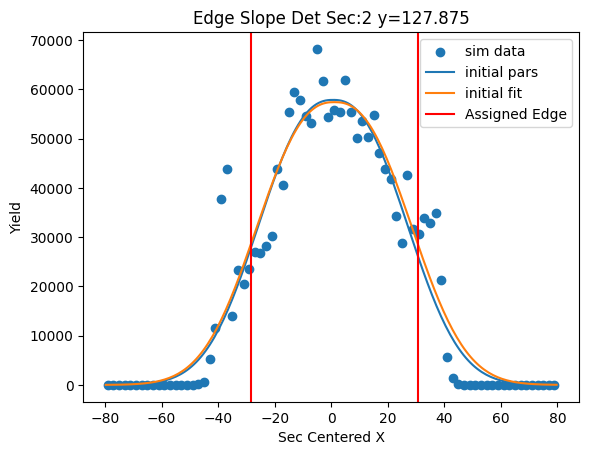

[5.52013084e+04 1.42754061e+00 2.50938730e+01 2.57186527e+00]


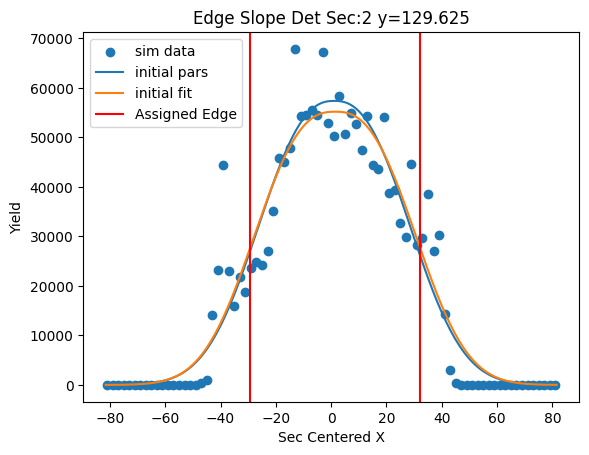

[5.13834917e+04 1.28074672e+00 2.60242959e+01 2.72885827e+00]


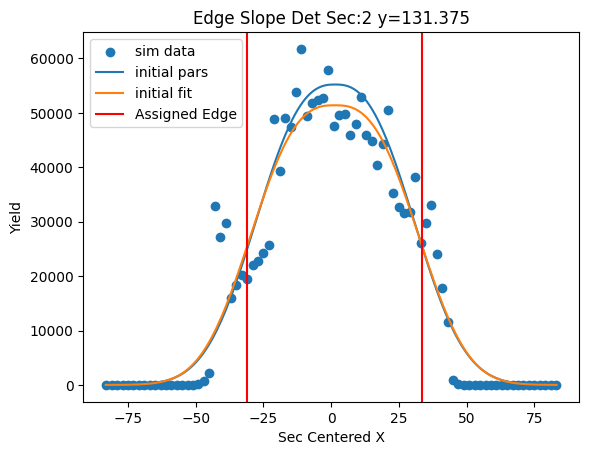

[4.69132466e+04 1.08445837e+00 2.62785747e+01 2.74859669e+00]


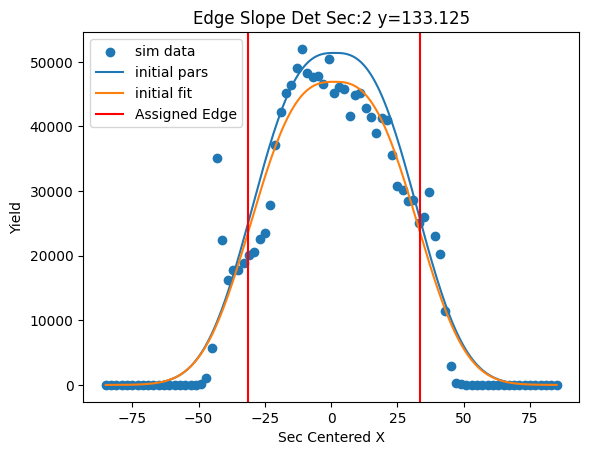

[4.59052174e+04 9.20083758e-01 2.70757330e+01 2.86073635e+00]


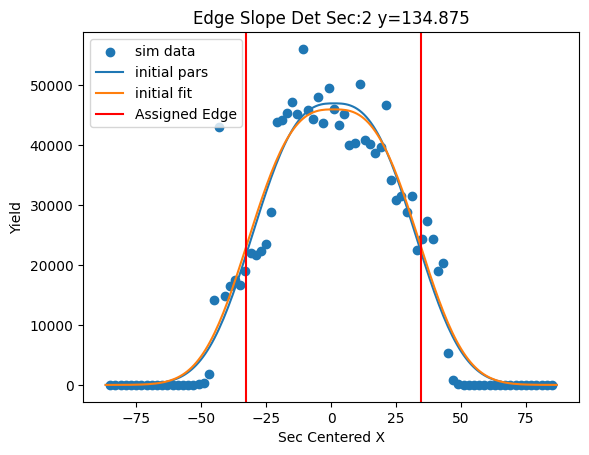

[4.52637020e+04 4.86962792e-01 2.78233789e+01 2.90862881e+00]


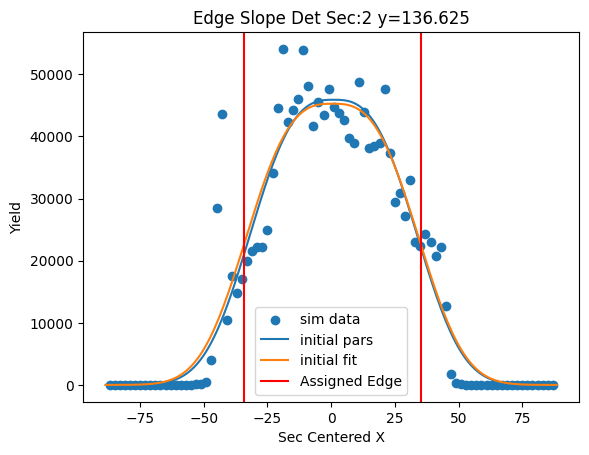

[4.28713823e+04 1.36861476e-01 2.77140826e+01 2.83378022e+00]


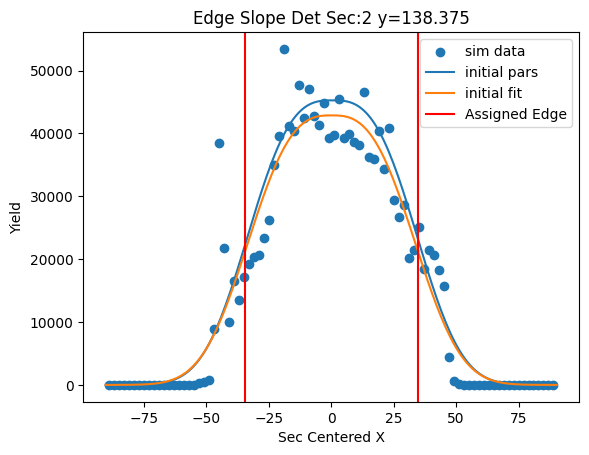

[ 4.01117096e+04 -1.78881251e-01  2.76636215e+01  2.76037498e+00]


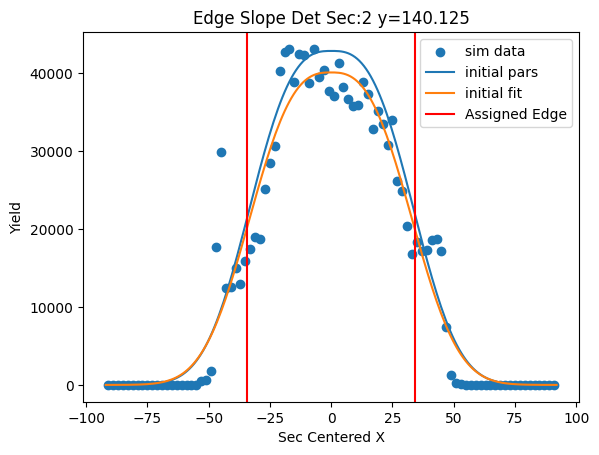

[ 3.93041527e+04 -7.76458475e-02  2.89274550e+01  2.87053629e+00]


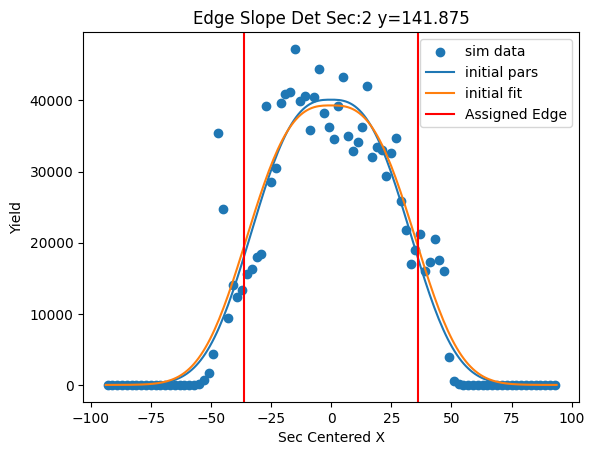

[3.74923283e+04 3.59903650e-01 2.99565070e+01 3.04003695e+00]


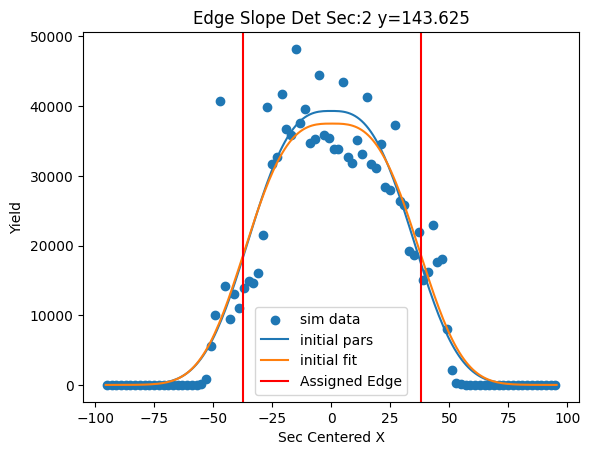

[3.51667284e+04 7.03153438e-01 3.08514338e+01 3.18254155e+00]


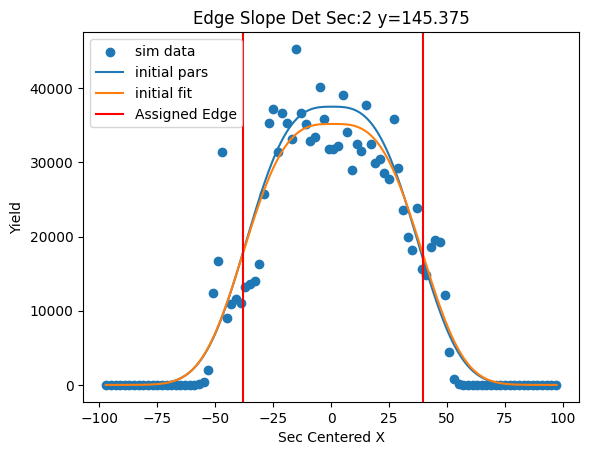

[3.27869221e+04 6.85414505e-01 3.10780900e+01 3.20394270e+00]


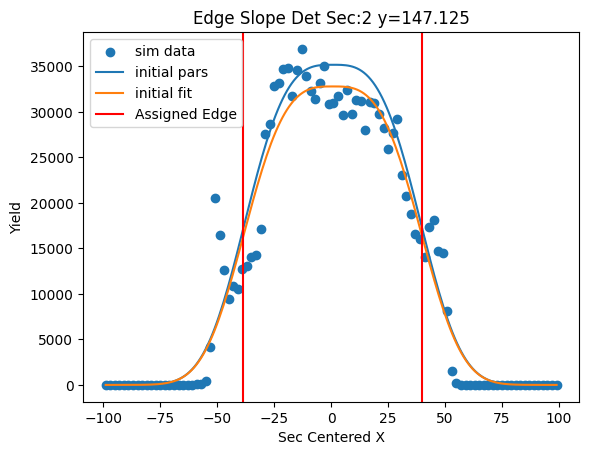

[3.30295287e+04 4.61985448e-01 3.19528217e+01 3.29140784e+00]


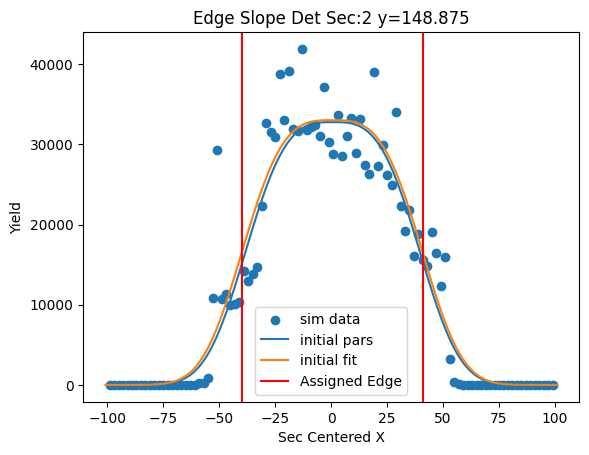

[3.17834054e+04 8.57493977e-02 3.27067458e+01 3.38983188e+00]


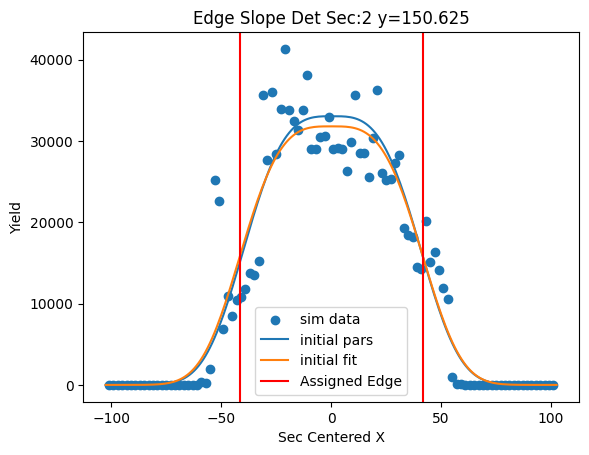

[ 2.90942472e+04 -2.40368765e-01  3.27826479e+01  3.37661679e+00]


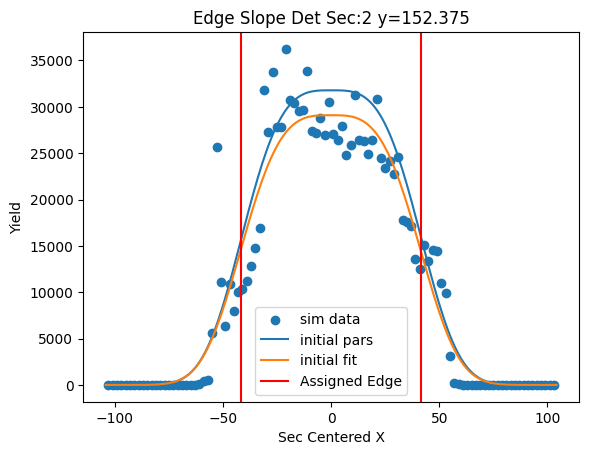

[ 2.76212183e+04 -2.36423591e-02  3.32375295e+01  3.48731592e+00]


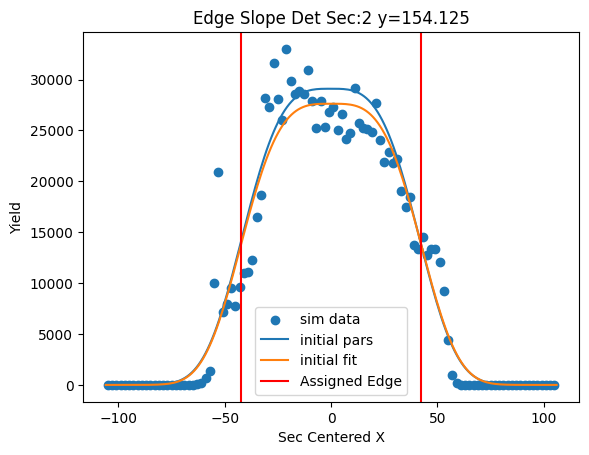

[2.79179625e+04 2.99371738e-01 3.46147523e+01 3.70551917e+00]


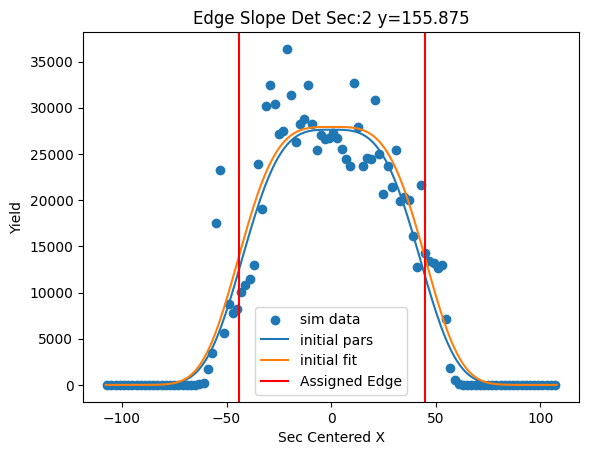

[2.66201619e+04 6.56555772e-01 3.56002338e+01 3.91693493e+00]


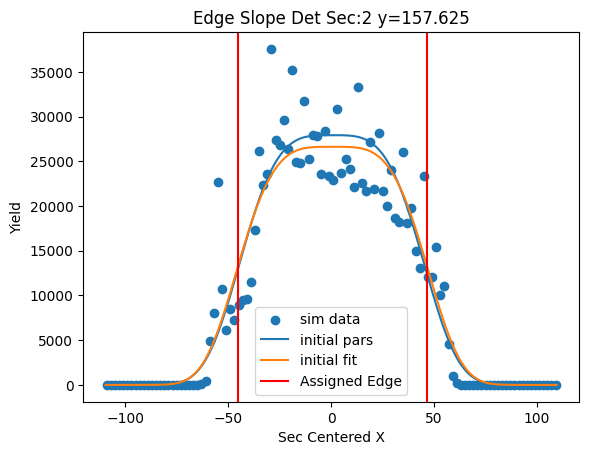

[2.46338008e+04 6.11947243e-01 3.67503172e+01 4.19422826e+00]


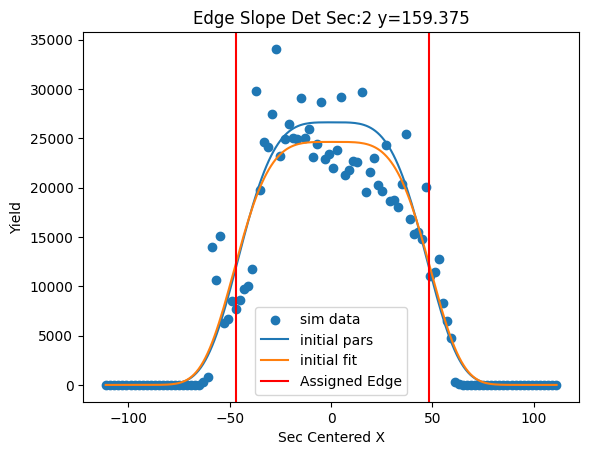

[2.19109777e+04 9.21122357e-01 3.74385446e+01 4.43277083e+00]


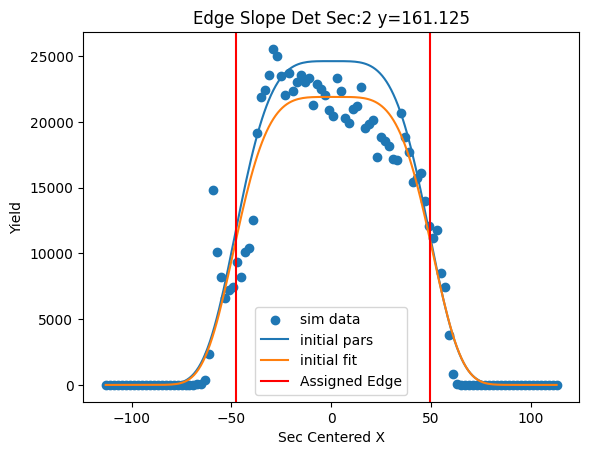

[2.22140957e+04 1.17065542e+00 3.86019196e+01 4.90666059e+00]


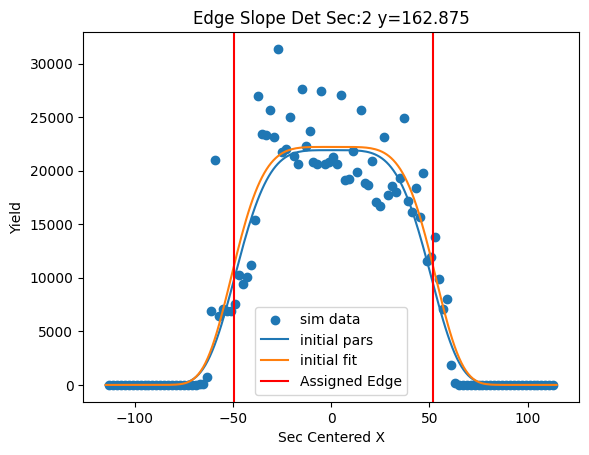

[2.17450638e+04 1.04588144e+00 3.94756403e+01 5.11153075e+00]


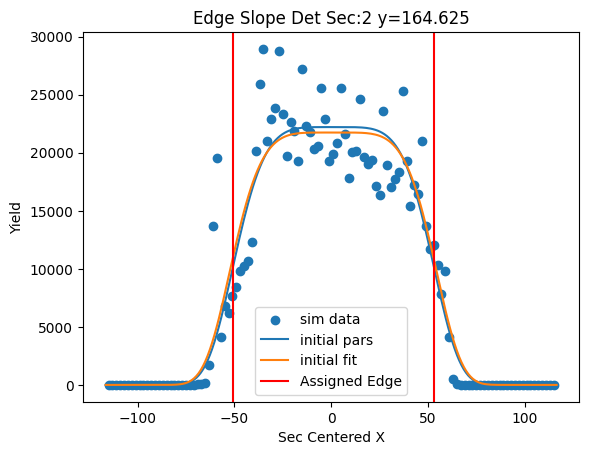

[2.01418583e+04 6.94243482e-01 3.95305560e+01 5.21820572e+00]


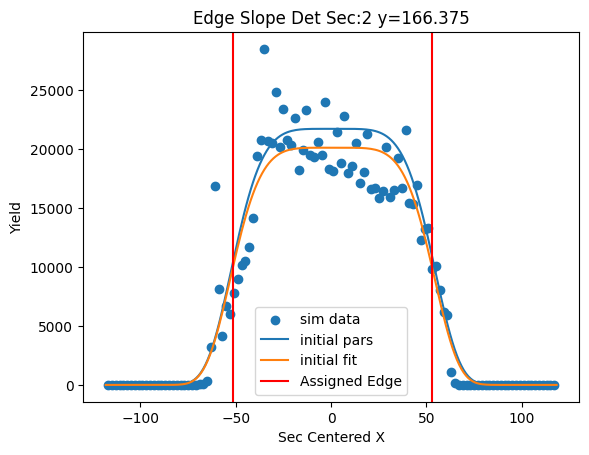

[1.89911597e+04 2.12112140e-01 3.98829483e+01 5.35939123e+00]


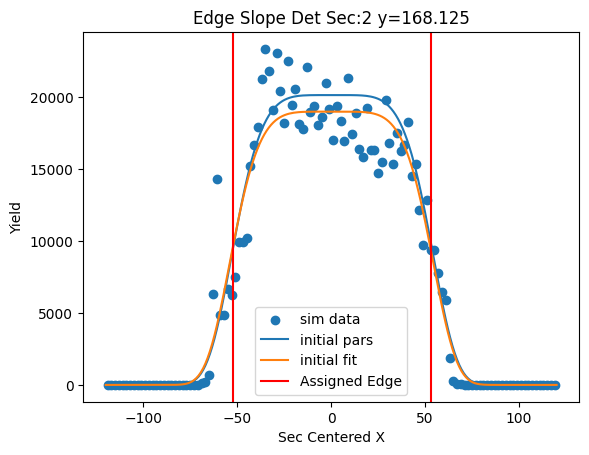

[1.90717037e+04 4.52894861e-01 4.07335665e+01 5.54806257e+00]


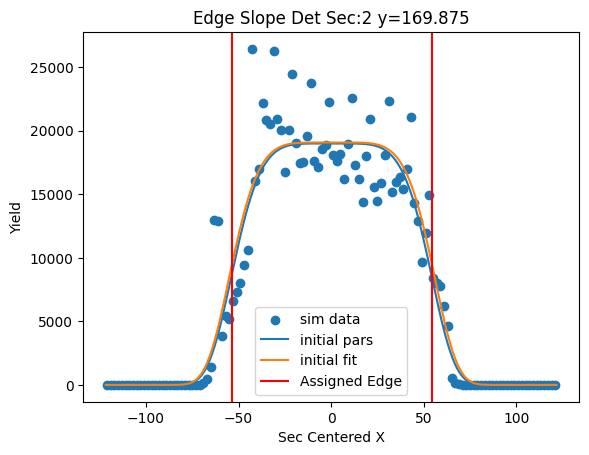

[1.82434354e+04 4.91835368e-01 4.13229004e+01 5.63862639e+00]


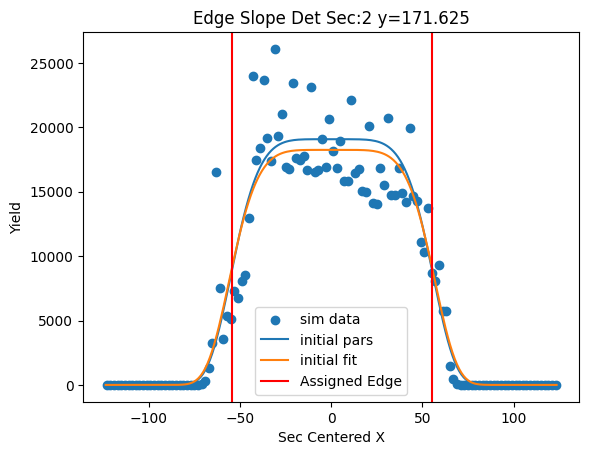

[1.75473754e+04 1.03092232e+00 4.22017627e+01 5.90522807e+00]


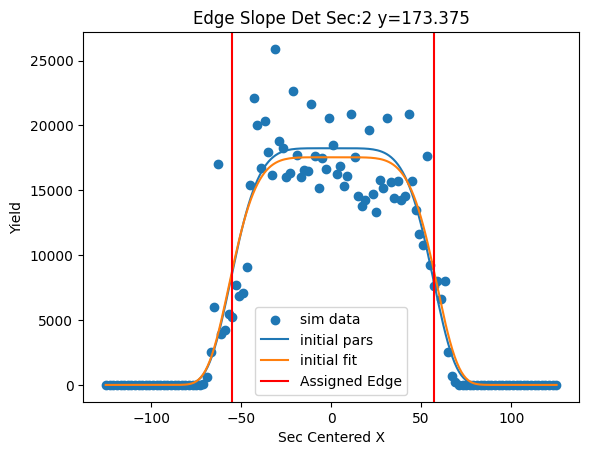

[1.62684570e+04 1.18136915e+00 4.21547244e+01 6.17320342e+00]


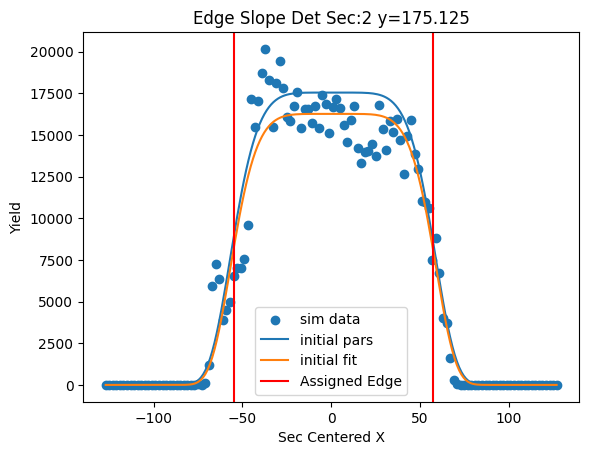

[1.70432116e+04 1.62869402e+00 4.31994506e+01 6.54725354e+00]


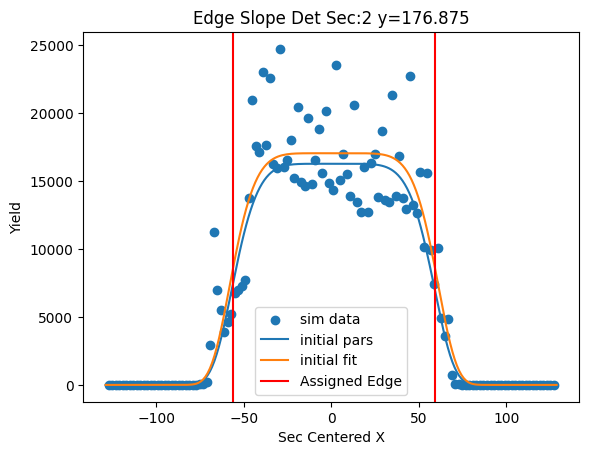

[1.64724926e+04 9.58796200e-01 4.40596059e+01 6.64205582e+00]


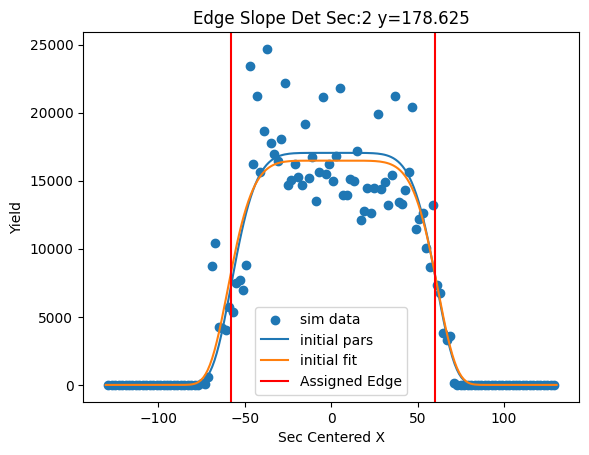

[1.45392131e+04 6.81271906e-01 4.41261224e+01 6.77881683e+00]


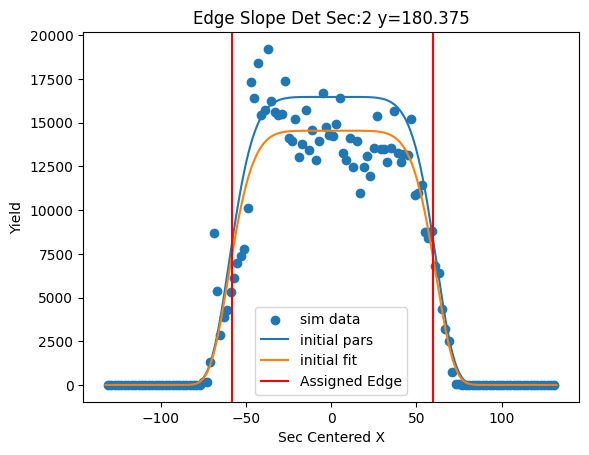

[1.42802084e+04 7.91862188e-01 4.45950107e+01 6.70015972e+00]


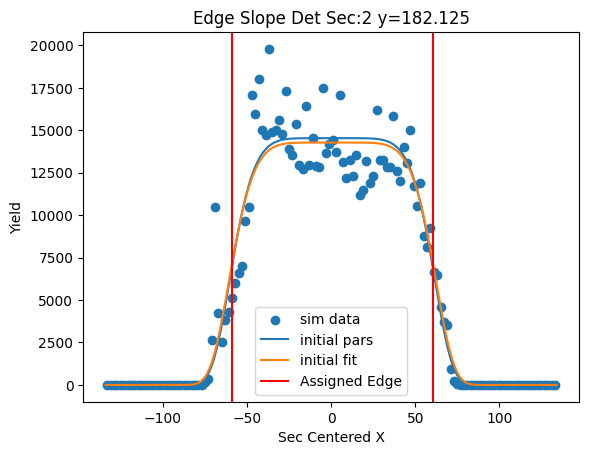

[1.50682510e+04 1.23521348e+00 4.58334114e+01 6.58405574e+00]


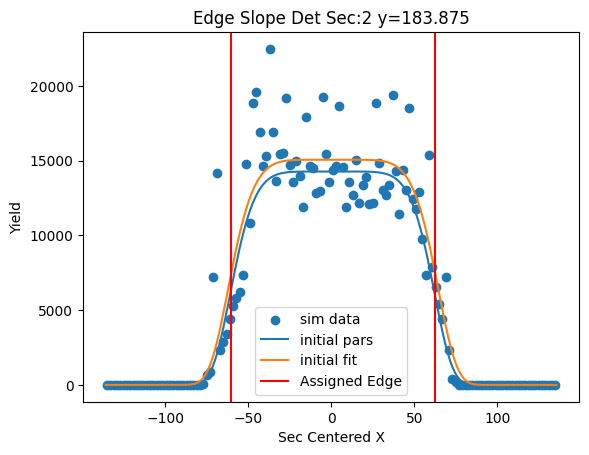

[1.43192089e+04 1.33350630e+00 4.64306884e+01 6.87289004e+00]


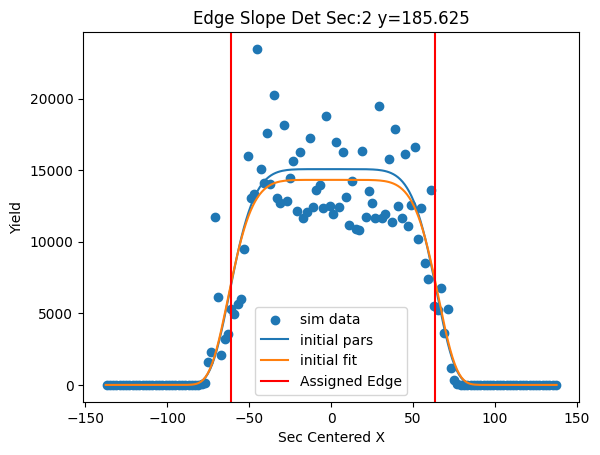

[1.25915165e+04 8.60665163e-01 4.69543666e+01 6.71471606e+00]


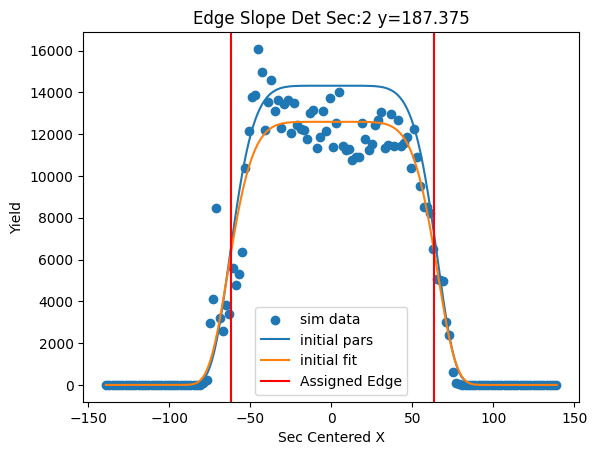

[1.28584276e+04 9.64829703e-01 4.84305672e+01 6.91579741e+00]


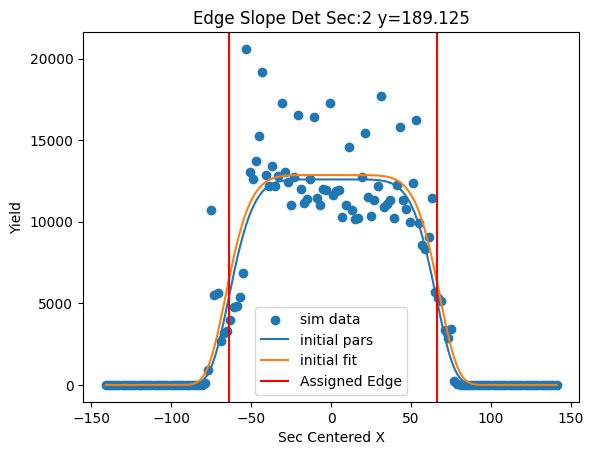

[1.26636414e+04 9.97773959e-01 4.95673548e+01 6.88883795e+00]


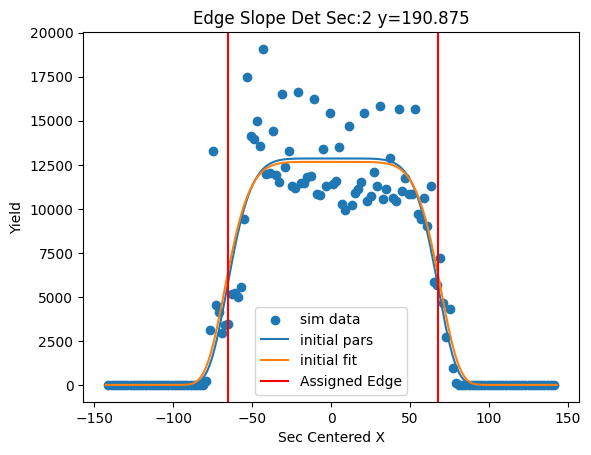

[1.25047001e+04 1.02808042e+00 5.07602731e+01 7.00159419e+00]


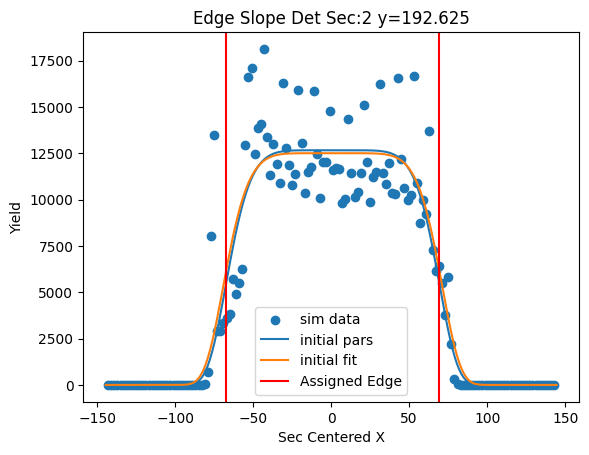

[1.11700726e+04 6.96504182e-01 5.09828151e+01 7.24711821e+00]


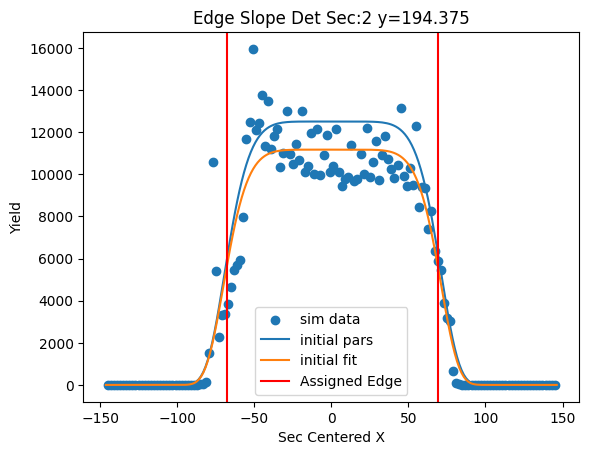

[1.09710543e+04 6.99101983e-01 5.14755864e+01 7.32192542e+00]


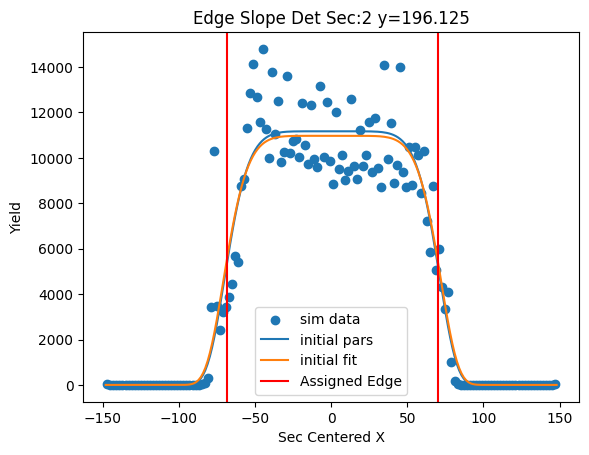

[1.11988105e+04 1.14008373e-01 5.24826835e+01 7.36363284e+00]


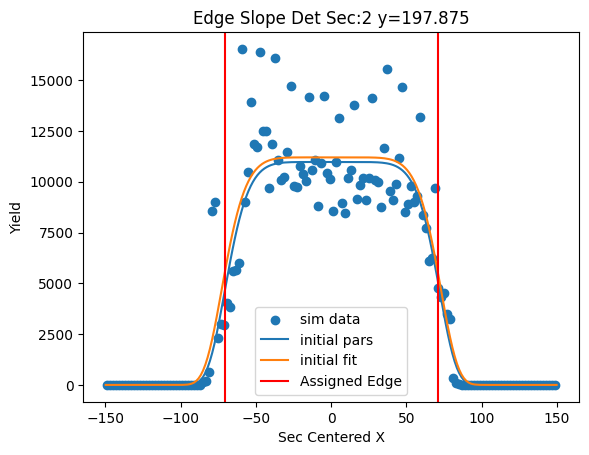

[ 1.02978840e+04 -8.67031258e-02  5.29720525e+01  7.32508290e+00]


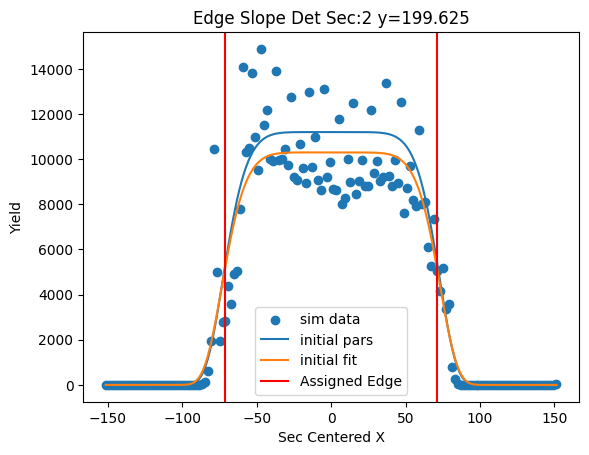

[9.21512742e+03 1.38534399e-01 5.31672056e+01 7.37130686e+00]


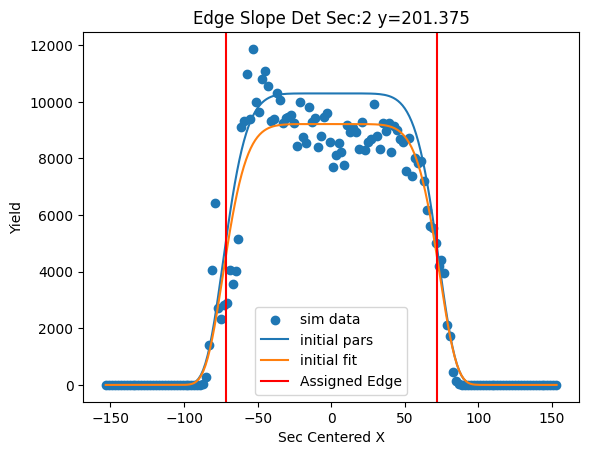

[9.99363815e+03 7.88549588e-01 5.50425462e+01 7.47860453e+00]


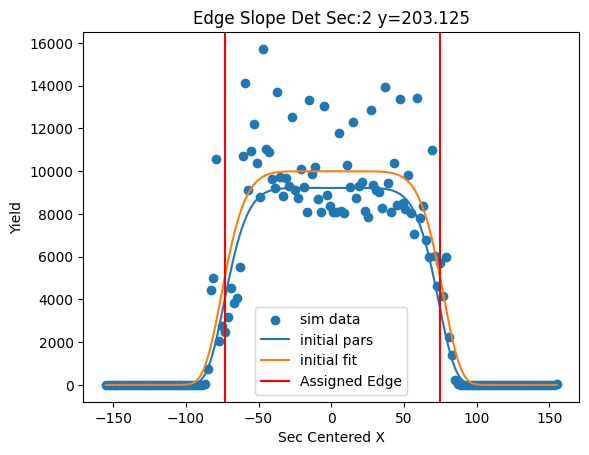

[1.00130004e+04 1.00517797e+00 5.59394828e+01 7.68631576e+00]


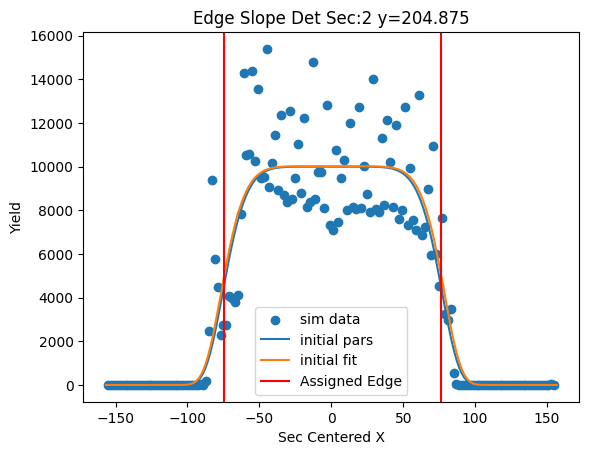

[9.46466698e+03 3.67148680e-01 5.73483318e+01 7.94021533e+00]


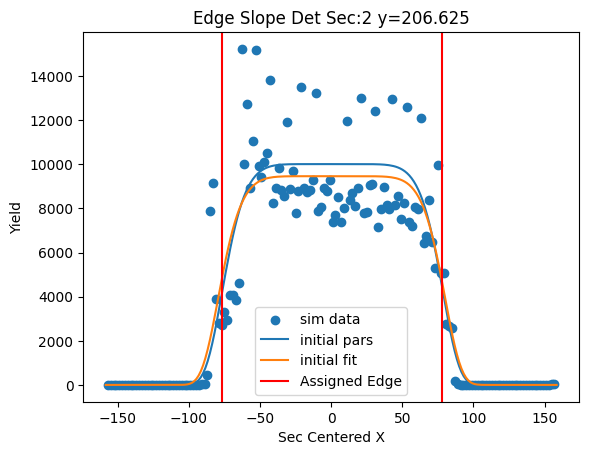

[8.17534715e+03 2.98198753e-01 5.77445157e+01 8.07693668e+00]


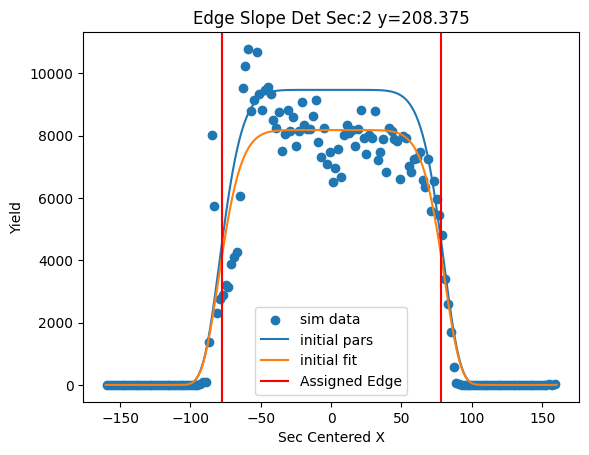

[8.58516182e+03 5.48171052e-01 5.88967367e+01 8.46993142e+00]


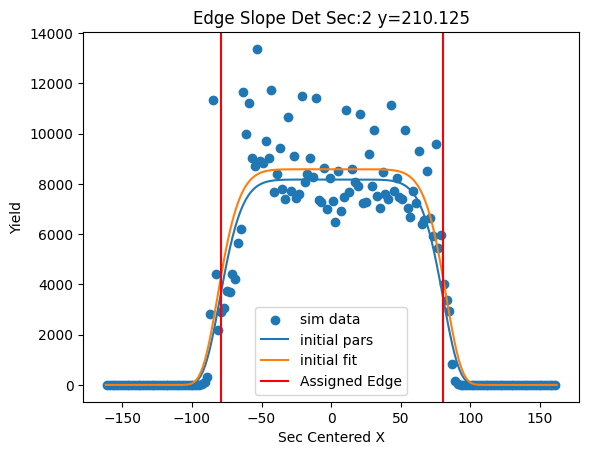

[9.26875076e+03 6.20911990e-01 6.04984338e+01 9.26740644e+00]


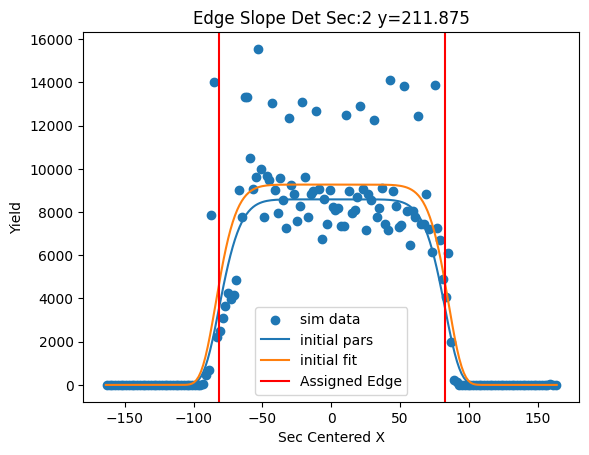

[8.62927704e+03 1.03567603e+00 6.11646387e+01 9.95490139e+00]


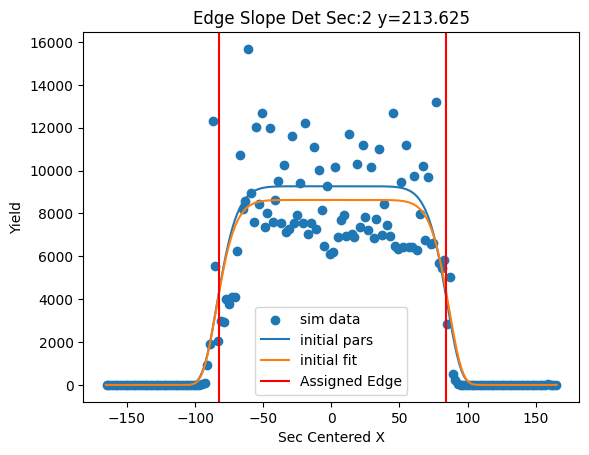

[7.44527654e+03 3.36368235e-01 6.17623595e+01 1.04906521e+01]


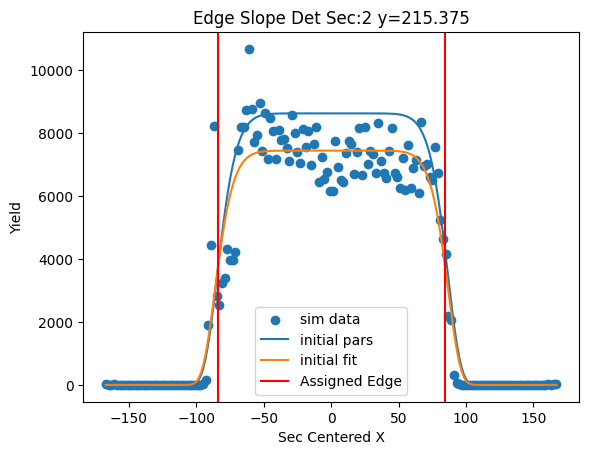

[8.07719412e+03 1.13649513e-01 6.30892906e+01 1.07797537e+01]


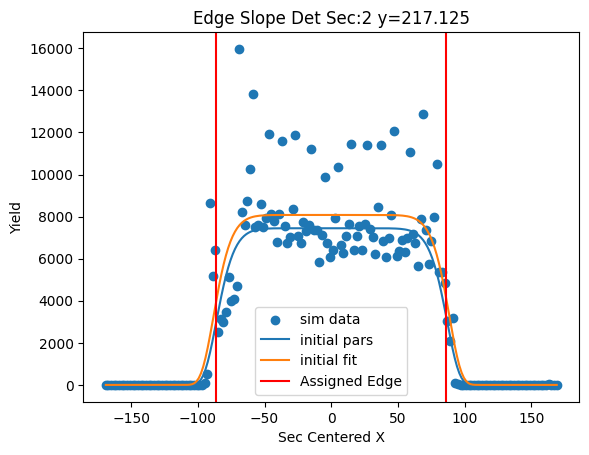

[7.89863966e+03 4.52703050e-02 6.38858253e+01 1.06566177e+01]


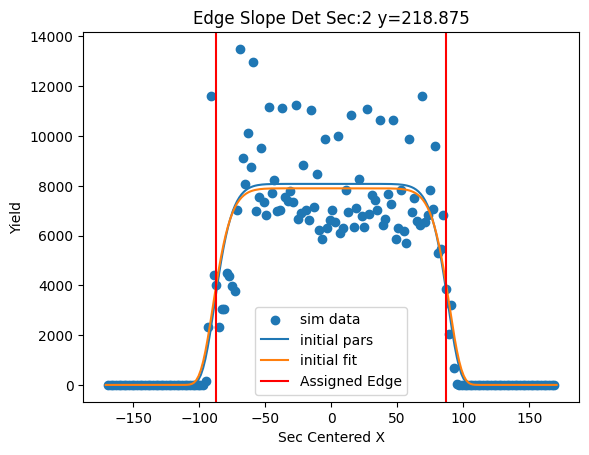

[7.52930989e+03 4.06861655e-01 6.48025400e+01 1.08568355e+01]


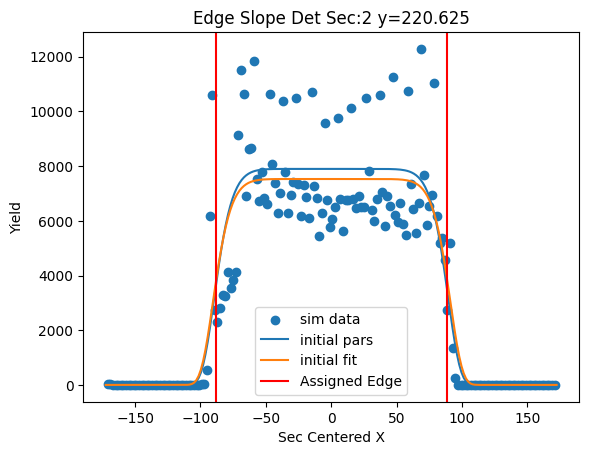

[6.60340540e+03 6.68115168e-01 6.45240956e+01 1.09938008e+01]


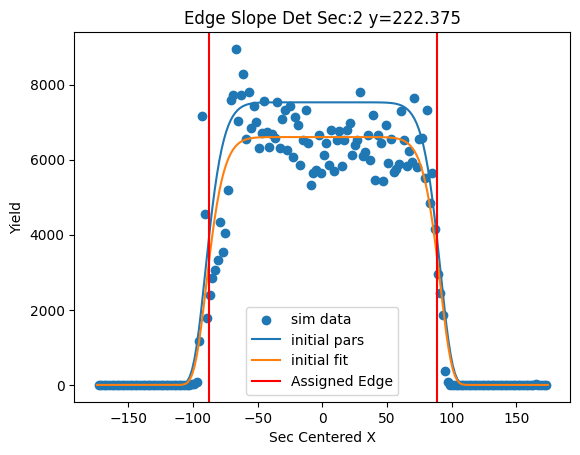

[6.89526200e+03 8.05765133e-01 6.51398584e+01 1.13316768e+01]


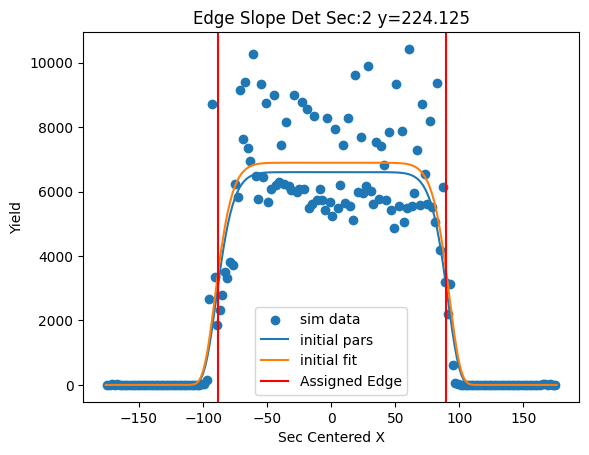

[6.96872408e+03 6.44959724e-01 6.57459412e+01 1.11876591e+01]


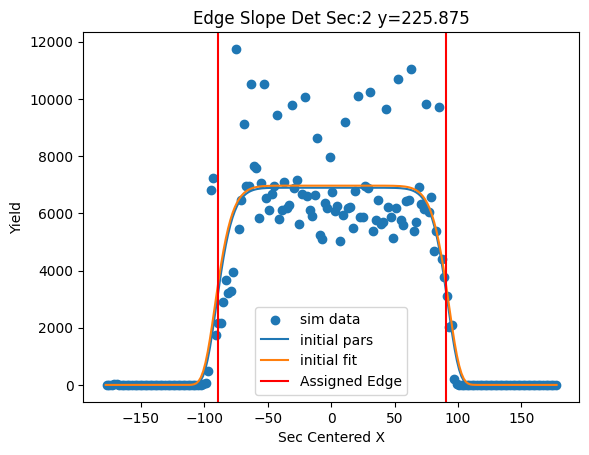

[6.10858871e+03 6.61106464e-01 6.59312698e+01 1.06812386e+01]


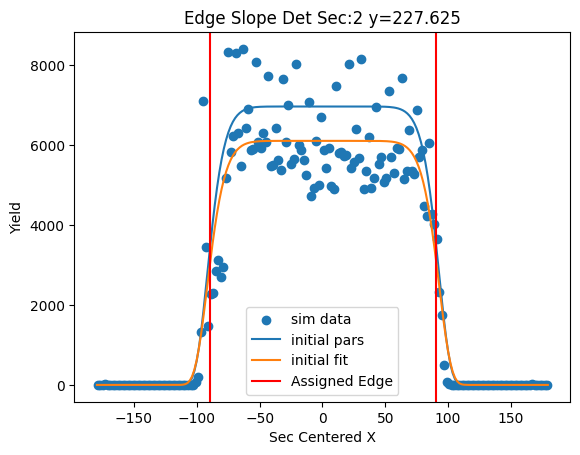

[5.58301743e+03 5.29929909e-01 6.59081453e+01 1.03765231e+01]


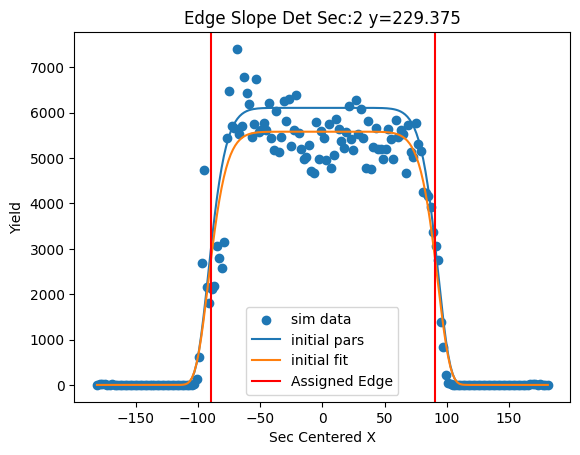

[6.35032812e+03 1.25231135e+00 6.63896132e+01 1.00416259e+01]


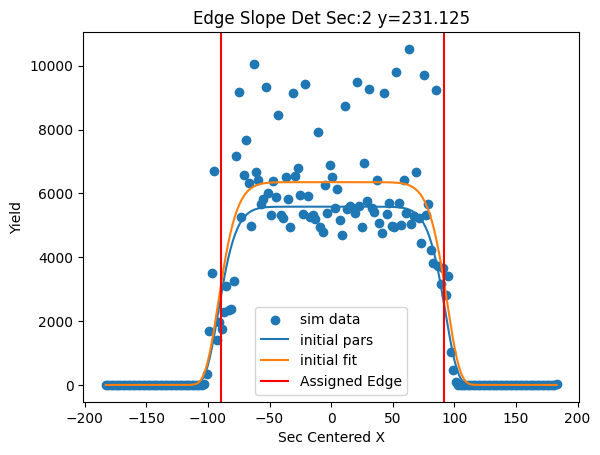

[6.24389781e+03 1.76189287e+00 6.62962407e+01 1.00406519e+01]


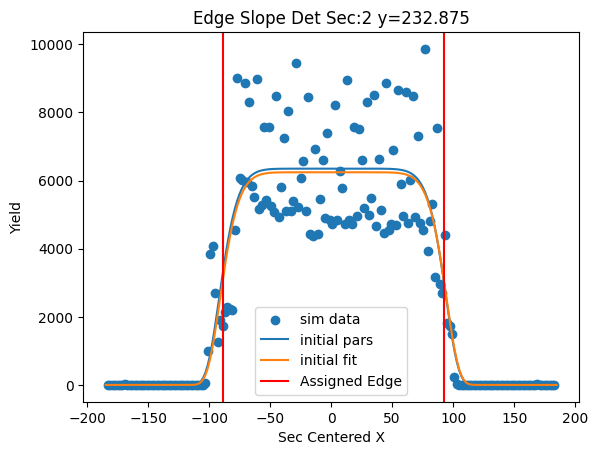

[5.83919041e+03 6.79867586e-01 6.73522137e+01 9.81960871e+00]


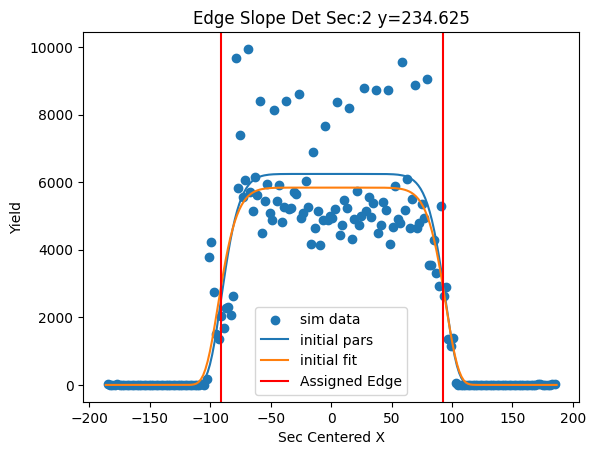

[4.83061396e+03 1.78683883e-01 6.77172292e+01 9.41791819e+00]


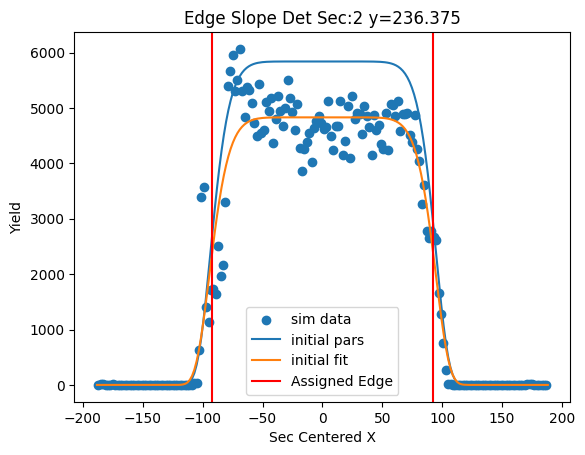

[5.13255394e+03 5.36482366e-01 6.86270154e+01 9.26110877e+00]


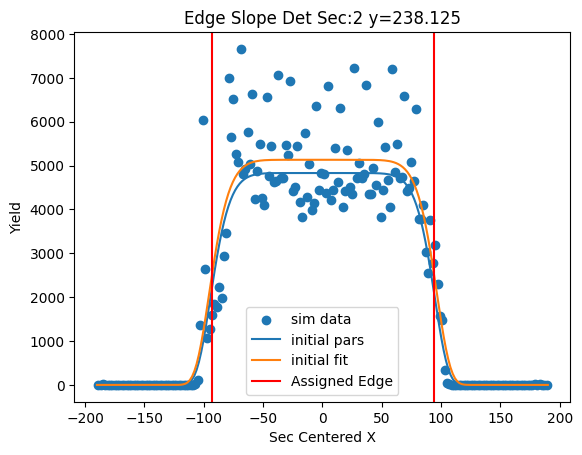

[5.48527058e+03 9.68093038e-01 6.96564383e+01 9.60106671e+00]


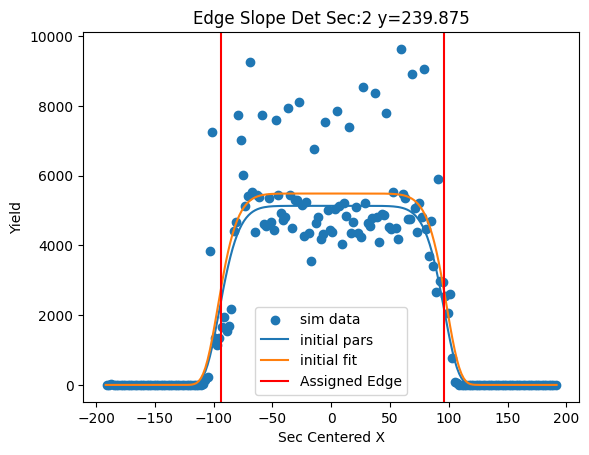

[4.94650353e+03 6.83551737e-01 7.01843882e+01 1.01897683e+01]


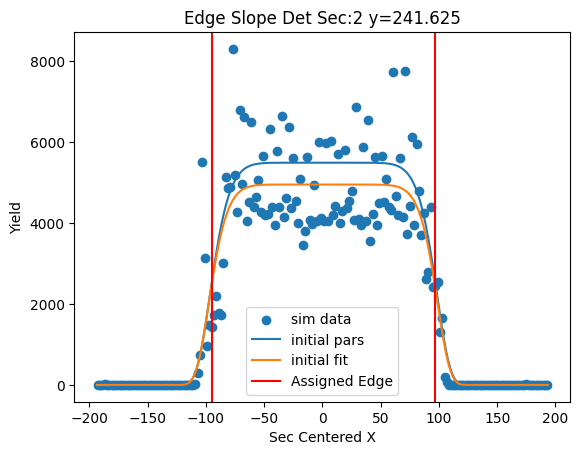

[4.47637165e+03 4.36915841e-01 7.06421419e+01 1.06374034e+01]


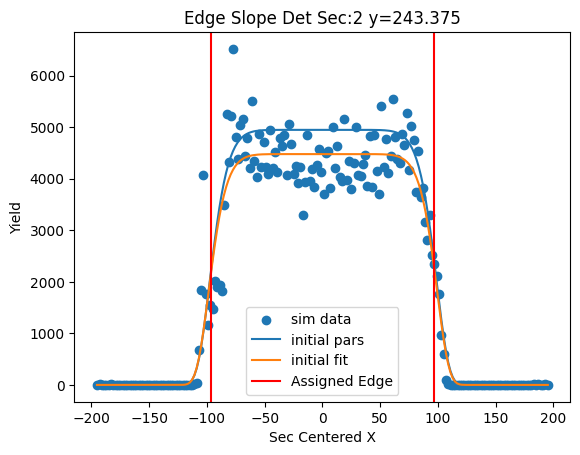

[4.91541514e+03 7.23815142e-01 7.10356773e+01 1.11513861e+01]


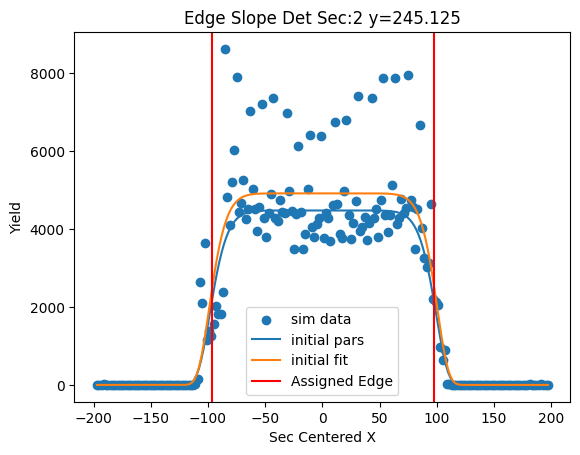

[4.75134546e+03 3.05606062e-01 7.16905103e+01 1.12552213e+01]


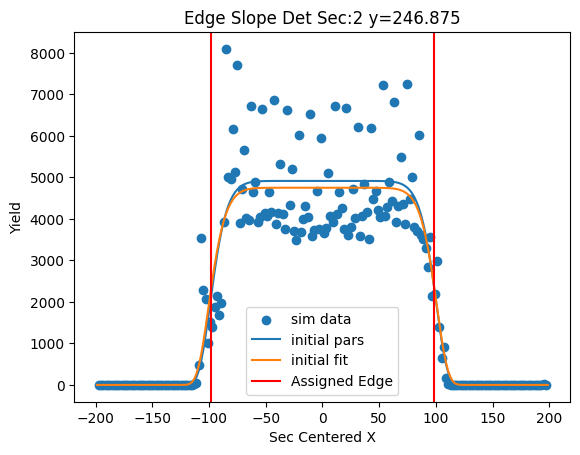

[4.65116748e+03 2.22087258e-01 7.25155068e+01 1.13847889e+01]


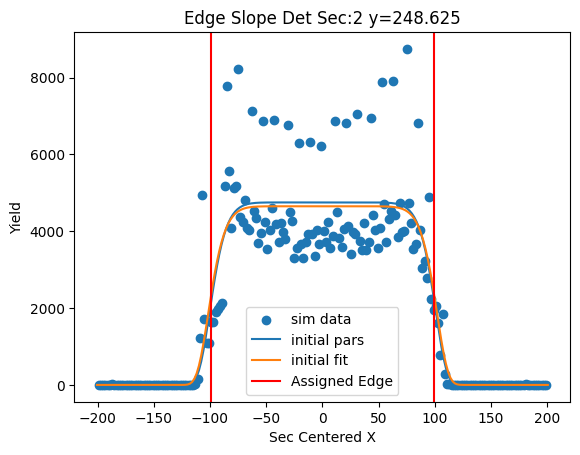

[4.03882613e+03 6.16023952e-01 7.25170995e+01 1.20245033e+01]


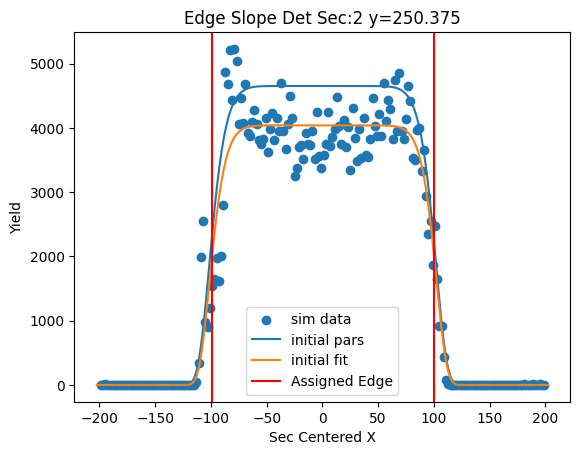

[4.52282072e+03 8.55605579e-01 7.31947418e+01 1.16862517e+01]


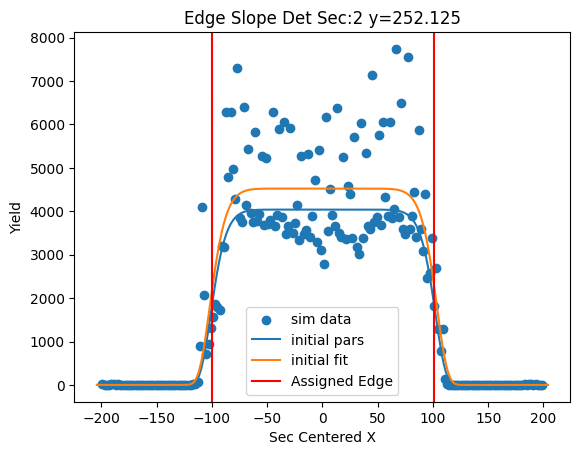

[ 4.56474431e+03 -5.72612573e-01  7.45803078e+01  1.12178225e+01]


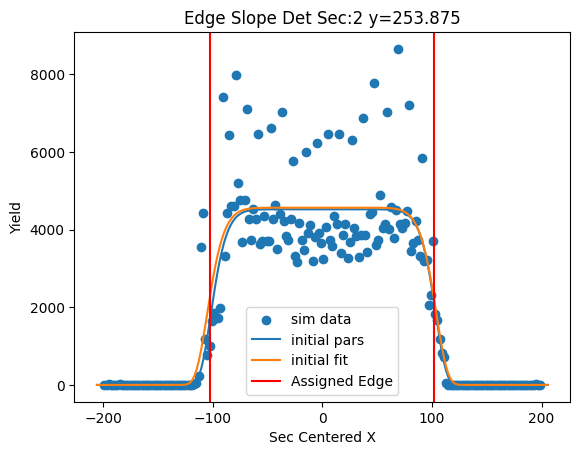

[ 3.89071172e+03 -8.05901867e-01  7.53167192e+01  1.12586461e+01]


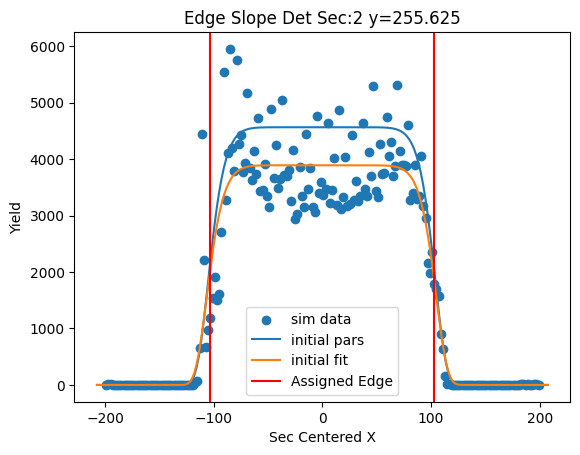

[ 3.65523731e+03 -1.00004906e+00  7.54541764e+01  1.08045338e+01]


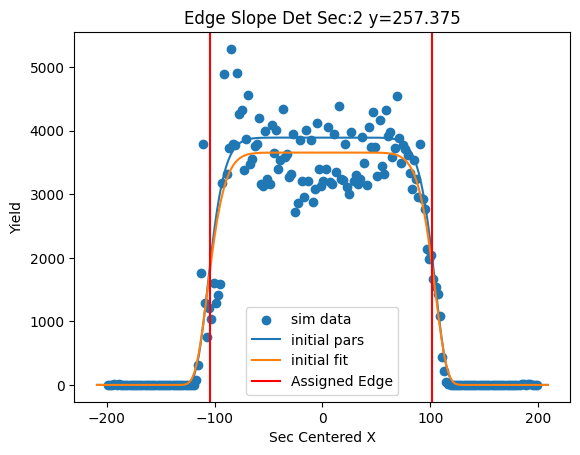

[ 4.24815271e+03 -1.12126798e+00  7.64433806e+01  1.07813402e+01]


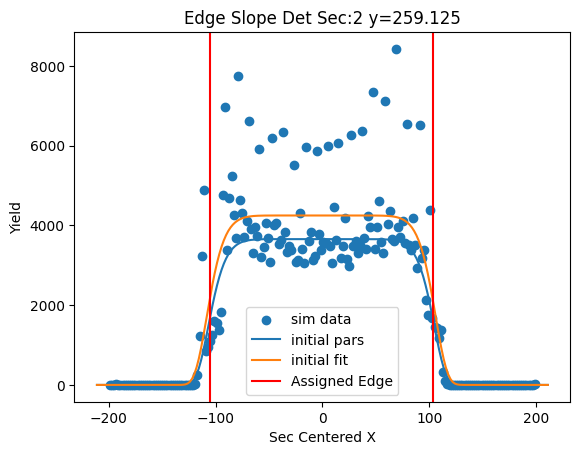

[ 4.11074731e+03 -1.54943251e+00  7.66045870e+01  1.08312348e+01]


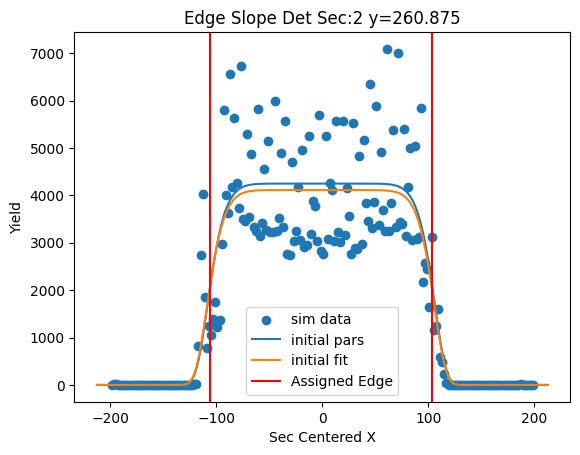

[ 3.80814653e+03 -2.14104292e+00  7.70616835e+01  1.05131604e+01]


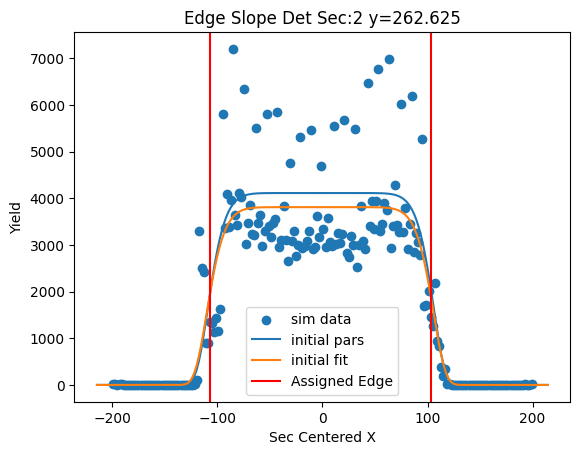

[ 3.12424240e+03 -1.83016939e+00  7.61985183e+01  1.00624990e+01]


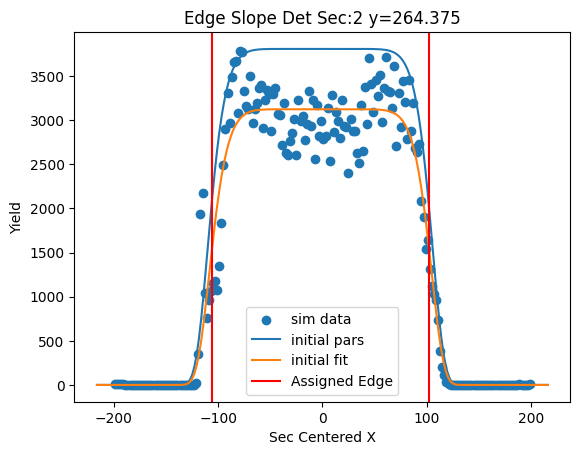

[ 3.48441391e+03 -1.45982239e+00  7.62556421e+01  1.04980212e+01]


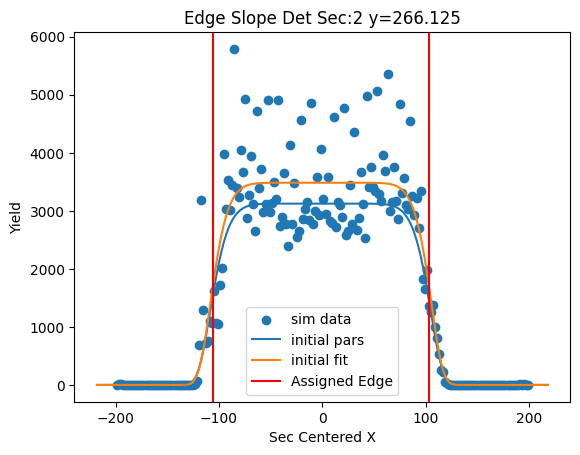

[ 3.63950587e+03 -4.97474635e-01  7.65656471e+01  1.14150751e+01]


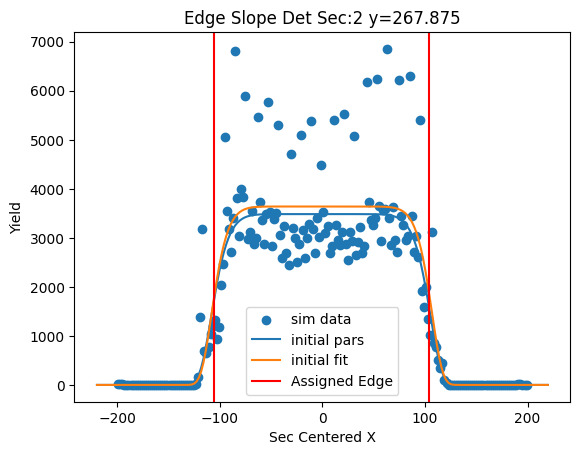

[ 3.15466598e+03 -4.99894246e-01  7.58333785e+01  1.17089049e+01]


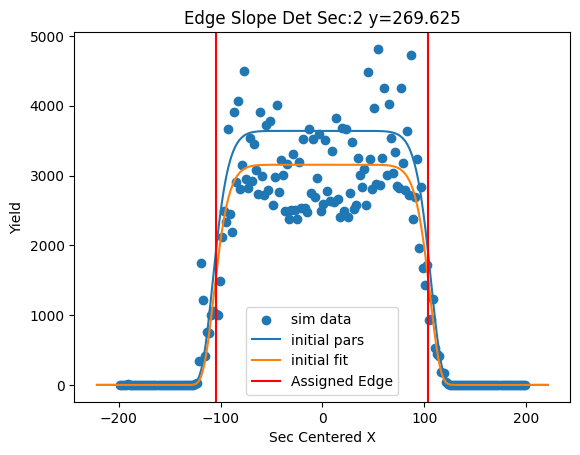

[ 2.99269005e+03 -6.80510923e-01  7.55951485e+01  1.21489641e+01]


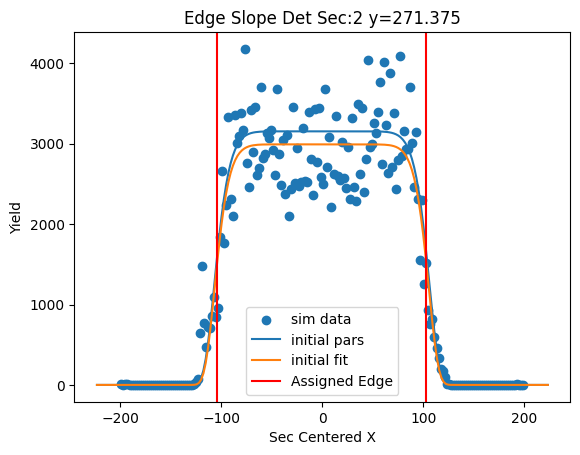

[ 3.31137324e+03 -1.01954048e+00  7.67779957e+01  1.20646087e+01]


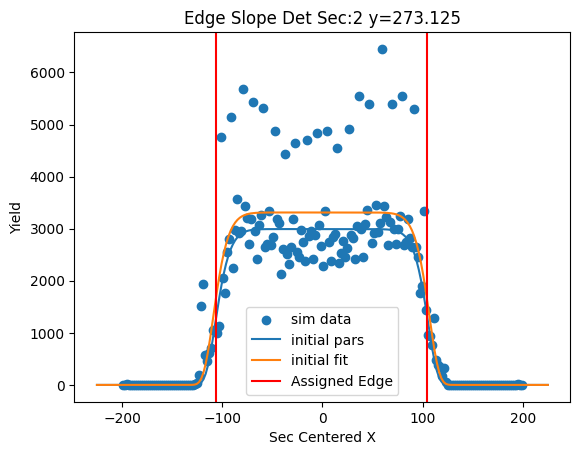

[ 2.99051981e+03 -1.65438266e+00  7.72802411e+01  1.19081386e+01]


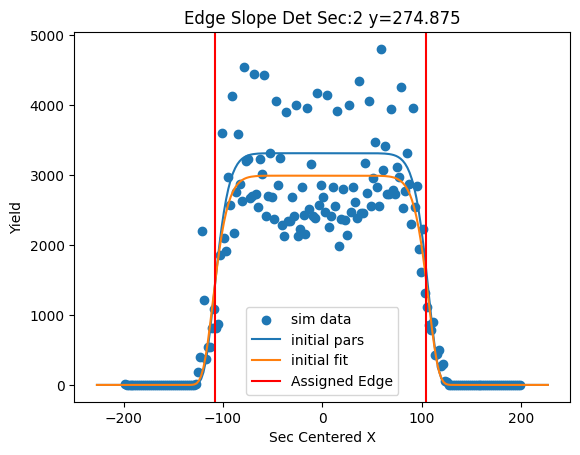

[ 2.51237680e+03 -2.14067918e+00  7.78619861e+01  1.09522138e+01]


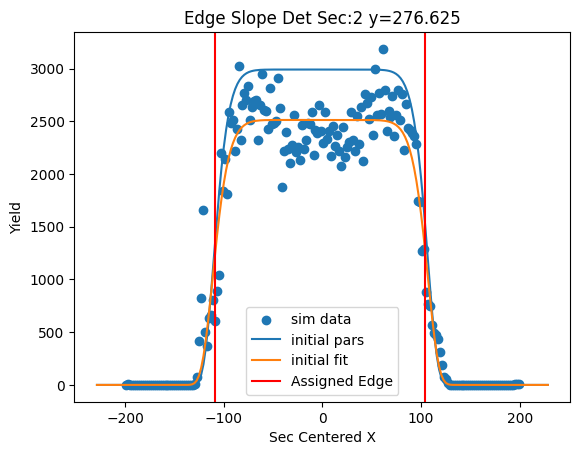

[ 2.97610038e+03 -1.78830434e+00  7.97263176e+01  1.04699172e+01]


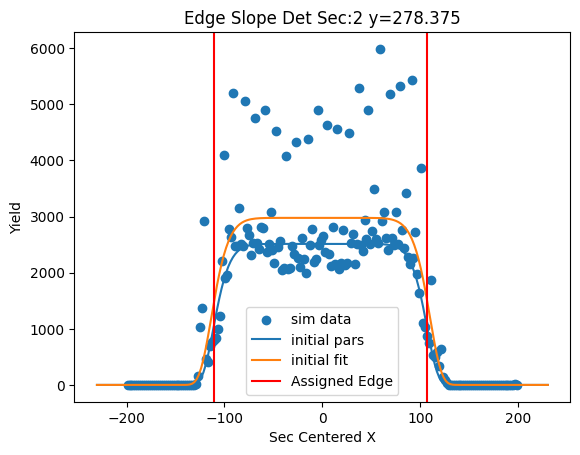

[ 2.94727924e+03 -2.33791168e+00  7.97782204e+01  1.03463281e+01]


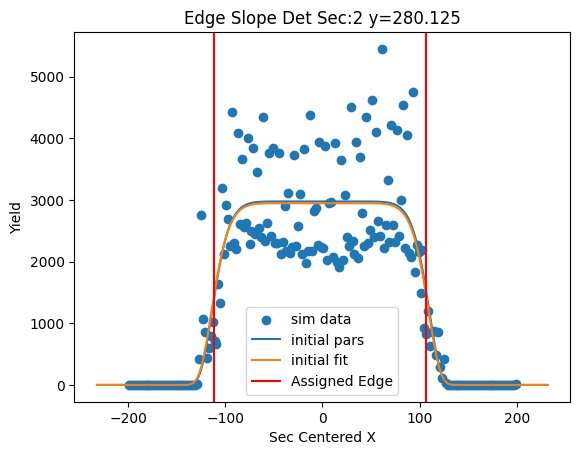

[2898.76719181   -3.09110335   81.42963091    9.87971419]


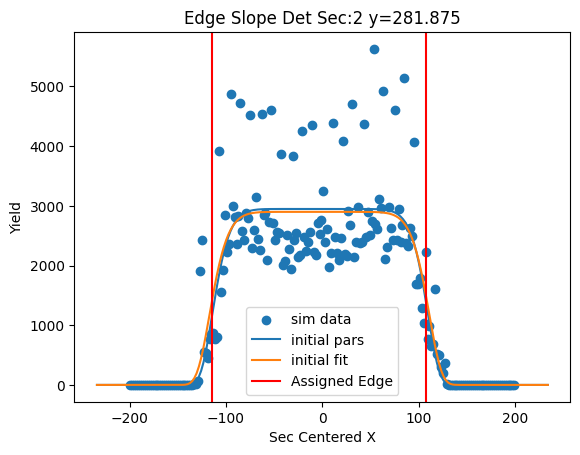

[2324.70699586   -3.49131431   81.1786932     9.87888645]


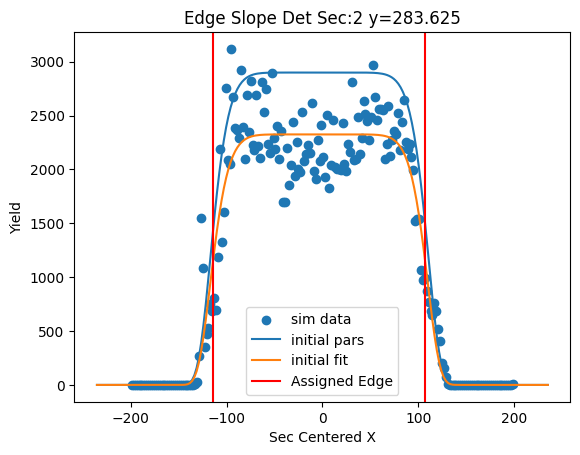

[2357.52992098   -3.60883055   81.89083109    9.77005371]


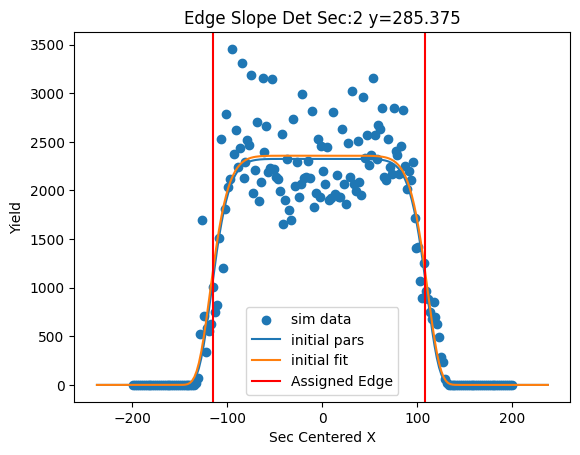

[ 2.75539382e+03 -2.35466494e+00  8.30168171e+01  9.56955483e+00]


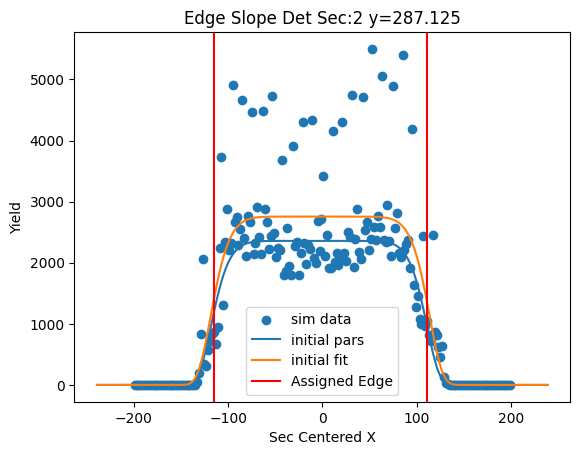

[ 2.55107781e+03 -2.19439470e+00  8.31926410e+01  9.28974982e+00]


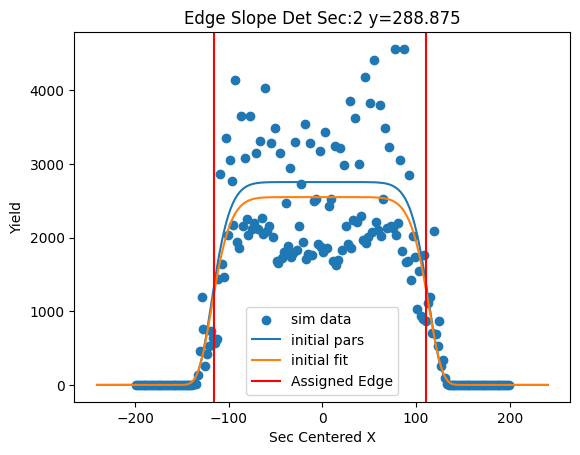

[2062.27344116   -2.9575841    83.4580449     8.76354166]


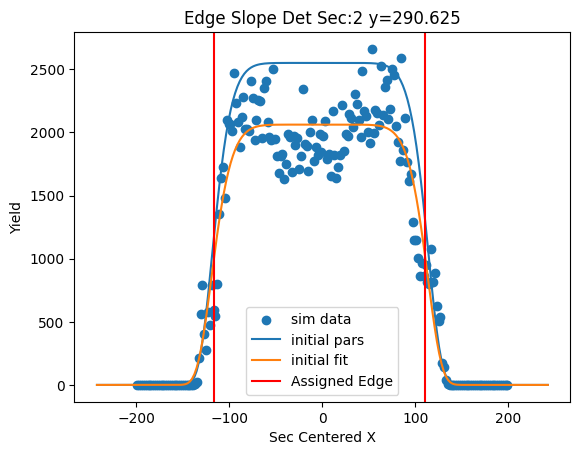

[ 2.30828890e+03 -2.01492272e+00  8.50404241e+01  9.08010556e+00]


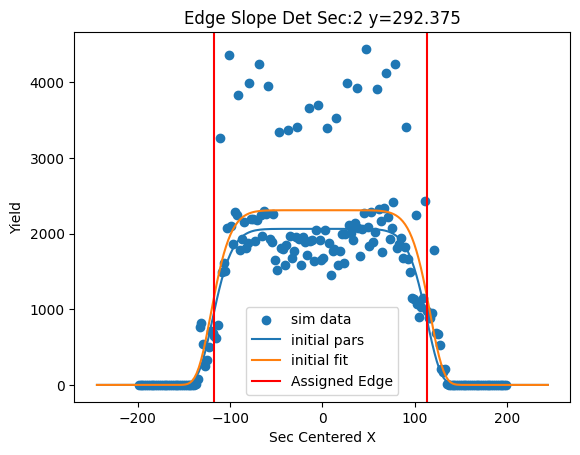

[2222.97213576   -2.91288623   85.66109984    8.53003927]


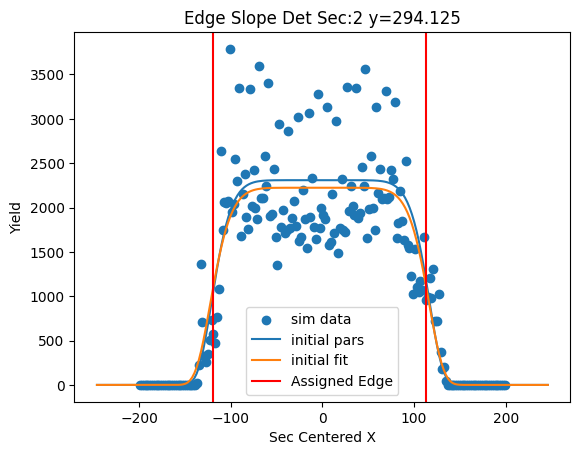

[ 2.28067961e+03 -1.48872429e+00  8.75692635e+01  8.90722796e+00]


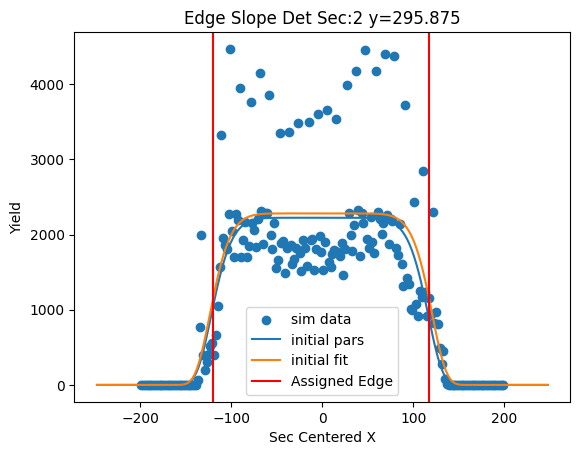

[1883.75614821   -2.3070915    88.00685366    8.39329153]


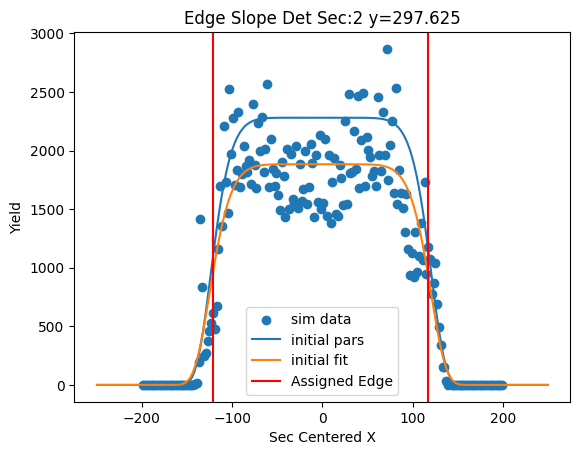

[ 1.94895351e+03 -1.73681078e+00  8.91050929e+01  9.04045795e+00]


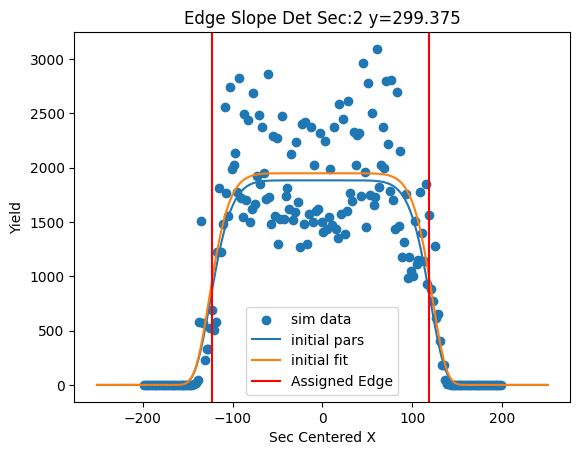

[ 2.09887121e+03 -1.85485451e+00  9.01183933e+01  9.90253202e+00]


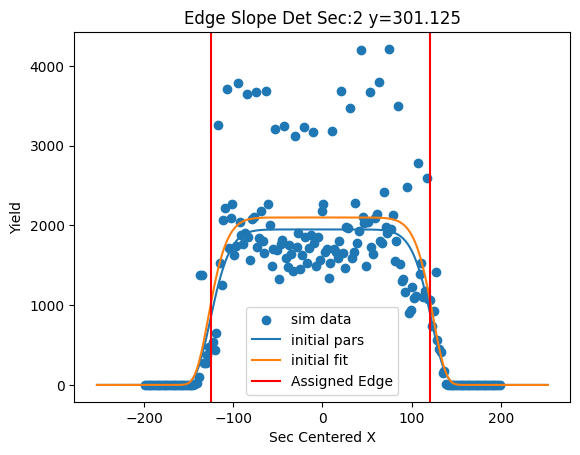

[1833.31772454   -2.42637032   90.46509151    9.82926358]


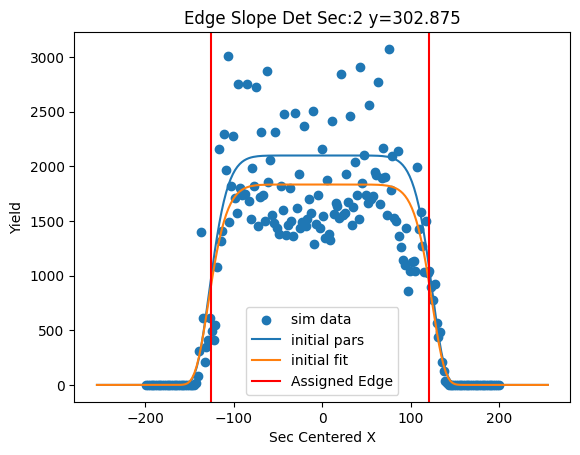

[1560.8013357    -2.84486516   90.71854095    9.53059091]


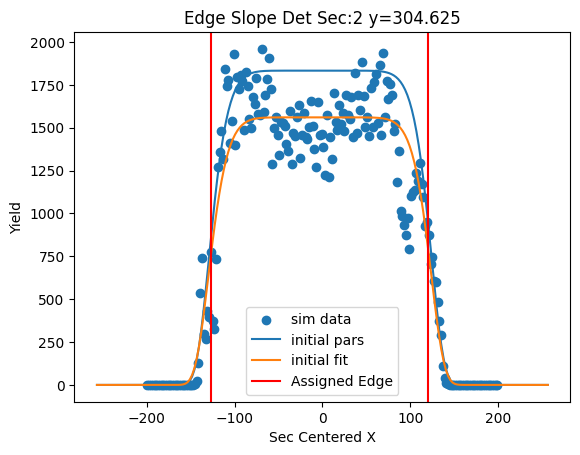

[ 1.94948703e+03 -3.73480382e-01  9.10399353e+01  1.24095596e+01]


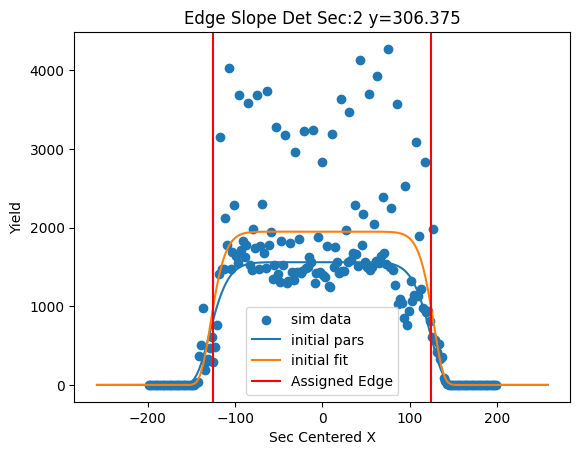

[1.93196590e+03 9.73112185e-03 9.08351081e+01 1.34155468e+01]


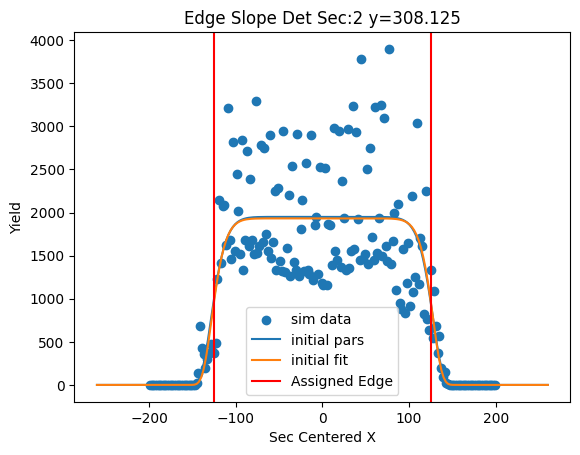

[ 1.84033994e+03 -3.33294943e-02  9.13432150e+01  1.50429479e+01]


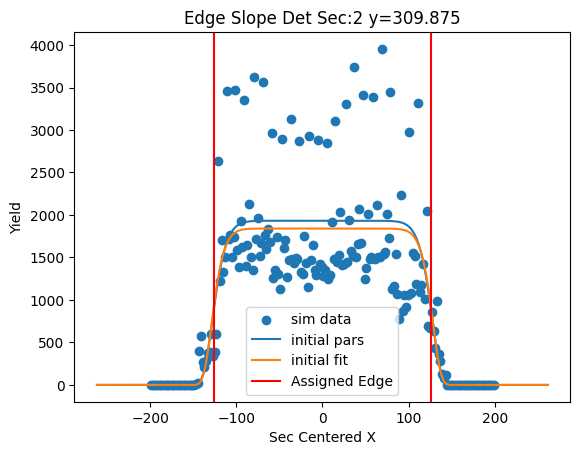

[ 1.39905256e+03 -1.00598429e+00  9.25559277e+01  1.24444029e+01]


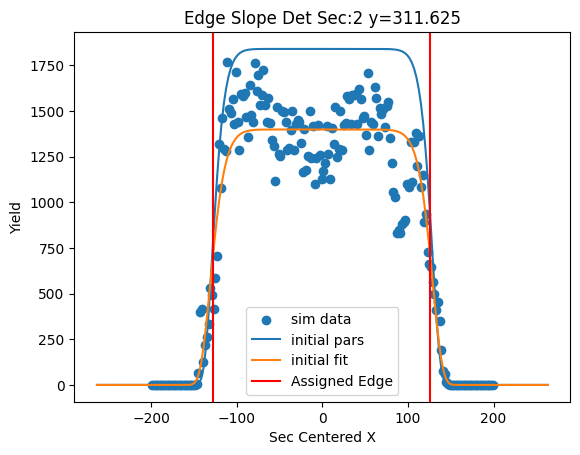

[ 1.47602480e+03 -1.63466830e-01  9.27948797e+01  1.36939275e+01]


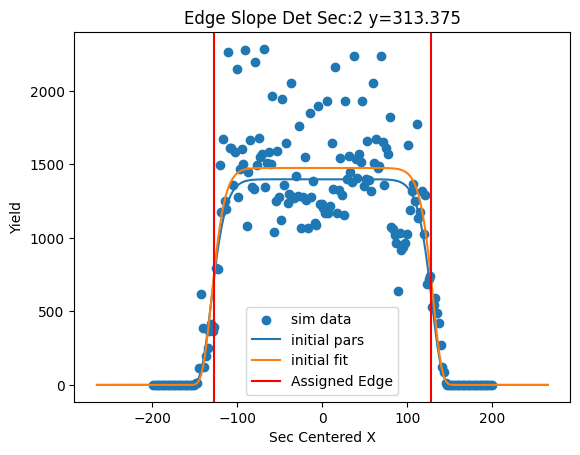

[1.74295548e+03 7.89376116e-01 9.34697029e+01 1.69033637e+01]


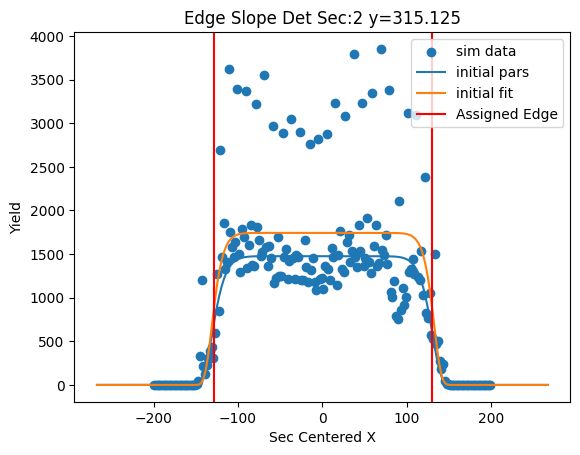

[1.58918158e+03 5.78508746e-01 9.42440569e+01 1.59005094e+01]


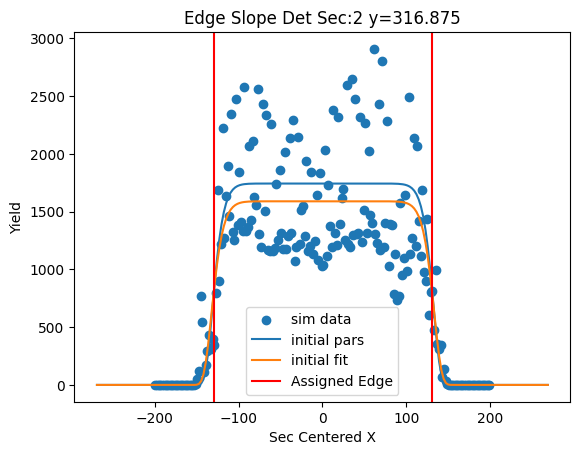

[ 1.32321009e+03 -7.46717250e-01  9.52496889e+01  1.40488540e+01]


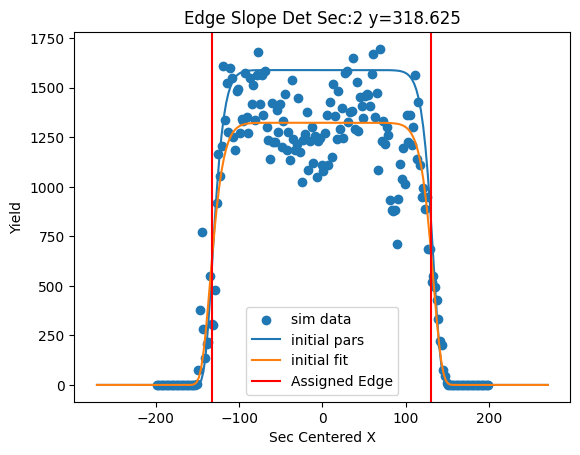

[ 1.56273460e+03 -4.70570458e-01  9.48129936e+01  1.79826117e+01]


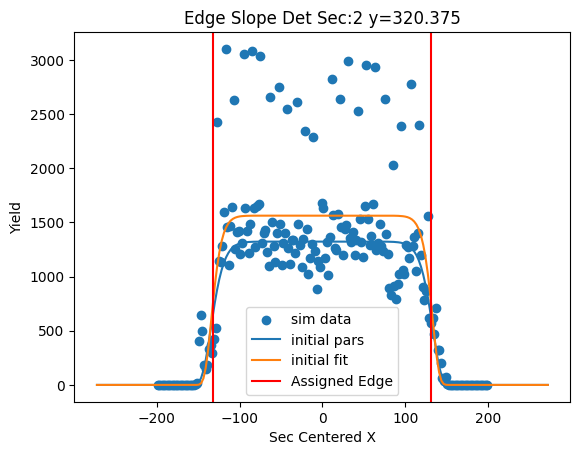

[ 1.51034624e+03 -1.25426520e+00  9.57741770e+01  1.56249023e+01]


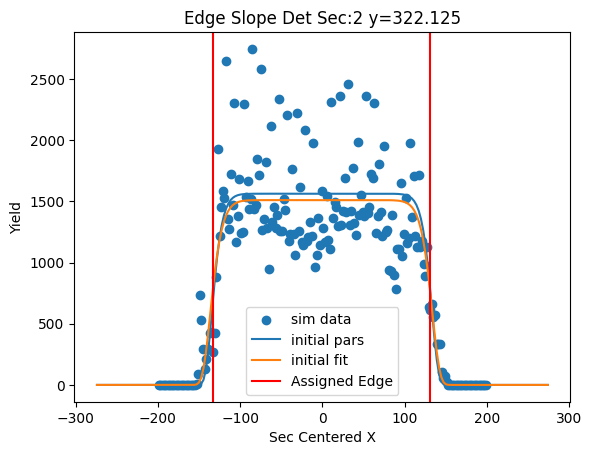

[ 1.60378707e+03 -6.75750823e-01  9.64684795e+01  1.85180211e+01]


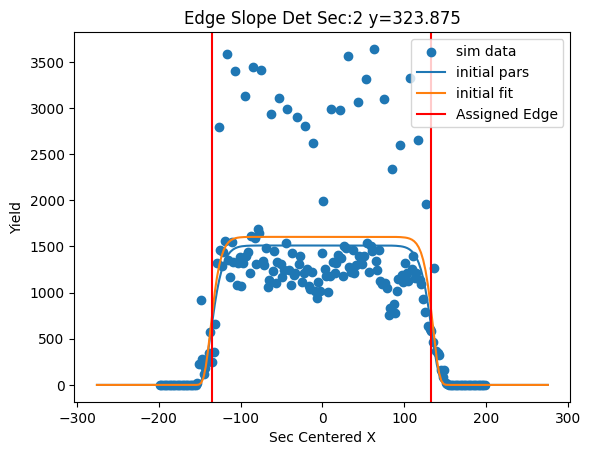

[1283.9327049    -1.51384999   96.99035438   16.33445702]


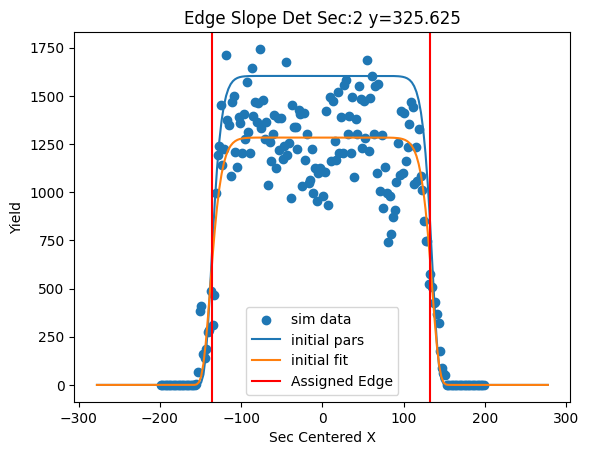

[ 1.48602741e+03 -1.19523566e+00  9.68460079e+01  1.67519038e+01]


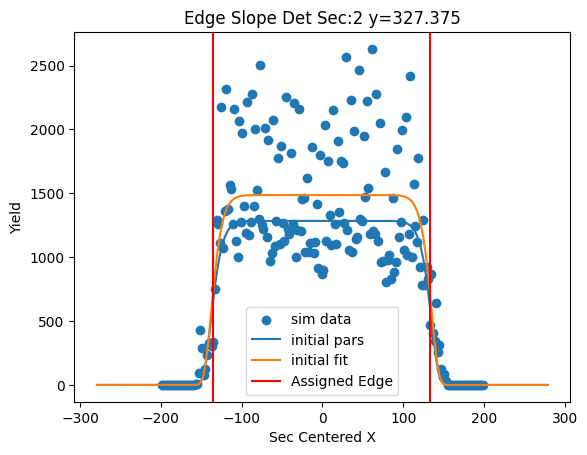

[ 1.58881528e+03 -1.37285885e+00  9.79274415e+01  1.69348778e+01]


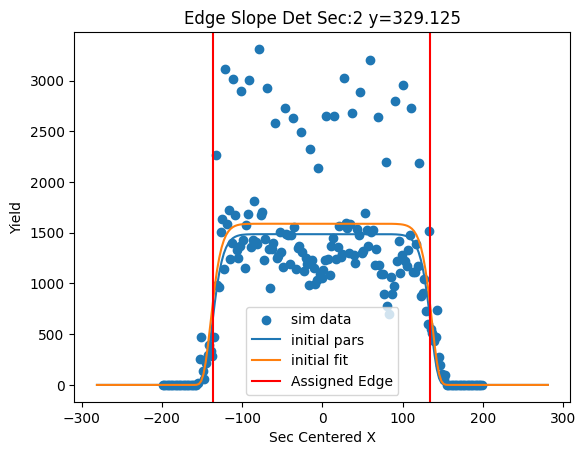

[1.00608284e+05 9.19248978e-01 1.64265814e+01 1.44451646e+01]


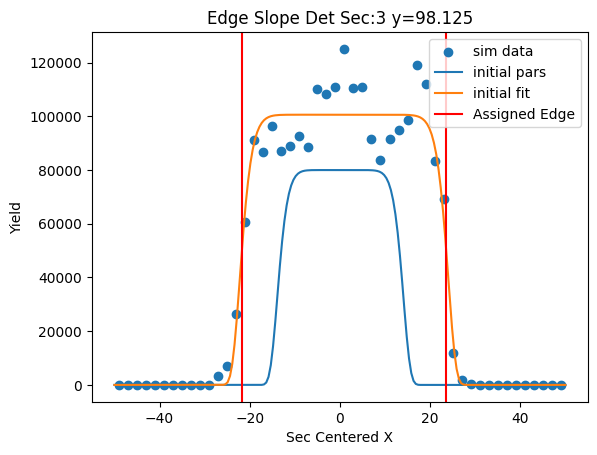

[1.02125060e+05 1.03001547e+00 1.70948436e+01 1.12602491e+01]


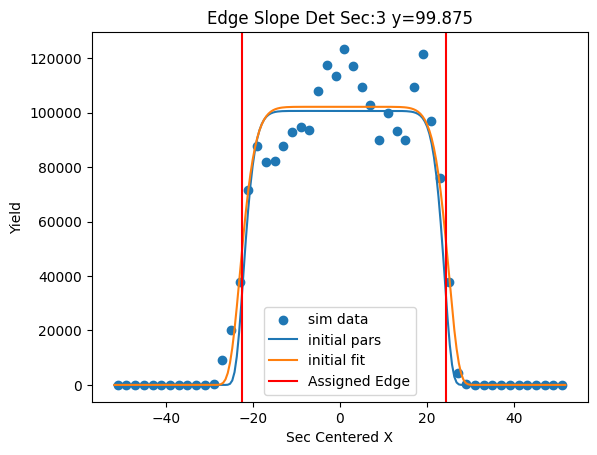

[1.01349390e+05 9.99110236e-01 1.80740363e+01 9.24855568e+00]


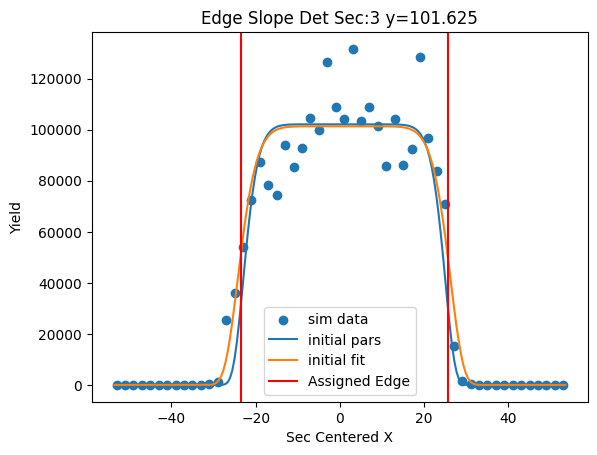

[9.57723325e+04 7.38324072e-01 1.91021976e+01 9.23090826e+00]


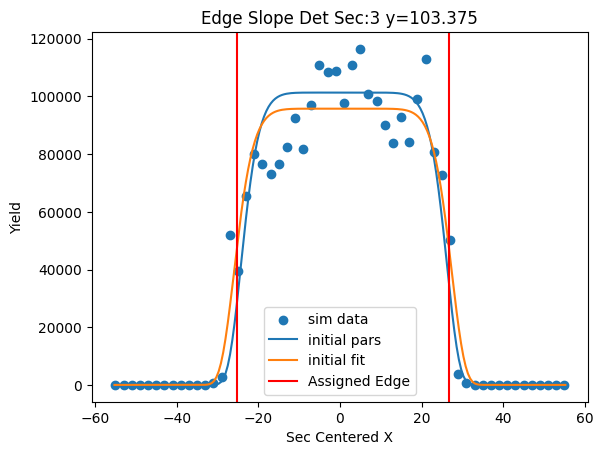

[8.61324857e+04 6.50898961e-01 1.95910367e+01 1.11649207e+01]


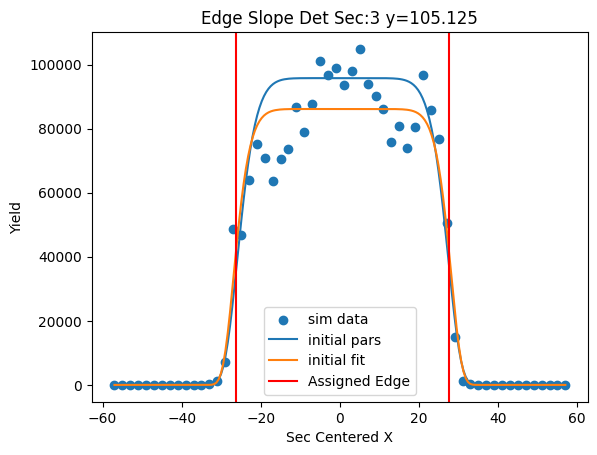

[8.09269691e+04 7.72354567e-01 2.01543021e+01 1.12739131e+01]


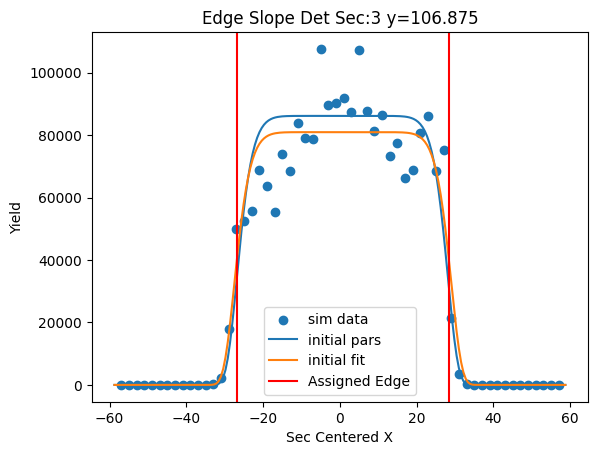

[7.85541284e+04 9.70874293e-01 2.07931270e+01 8.28594130e+00]


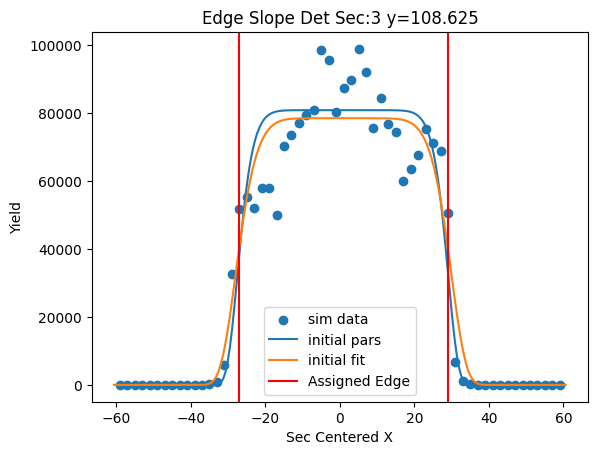

[7.51469236e+04 1.20735556e+00 2.11912039e+01 6.20772262e+00]


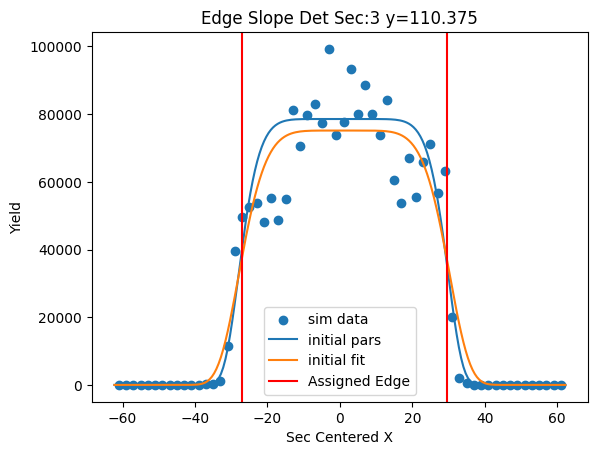

[6.74235740e+04 1.18290413e+00 2.18464627e+01 7.18823899e+00]


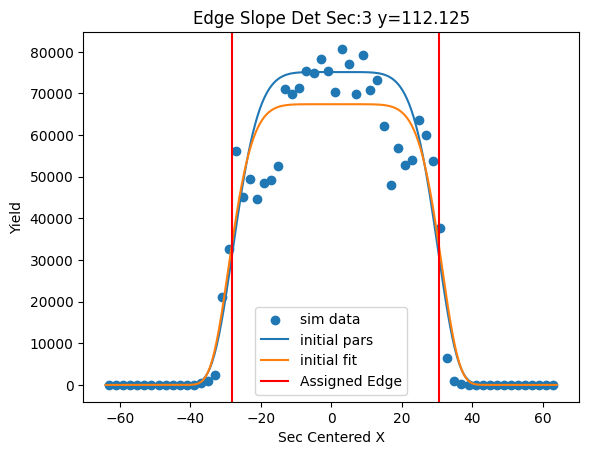

[6.29382029e+04 1.02846603e+00 2.28819172e+01 1.17577831e+01]


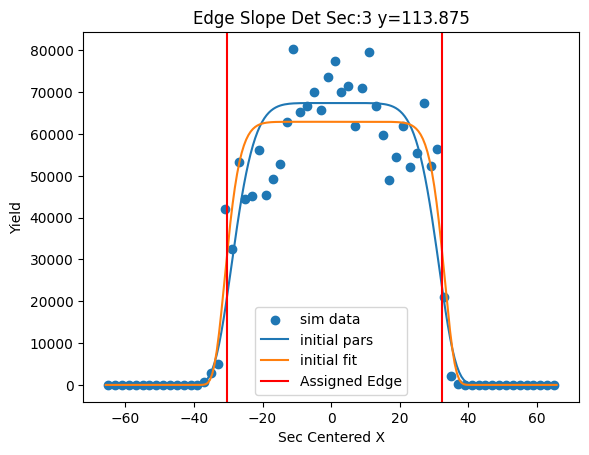

[5.97848014e+04 1.14592440e+00 2.35032198e+01 1.49105178e+01]


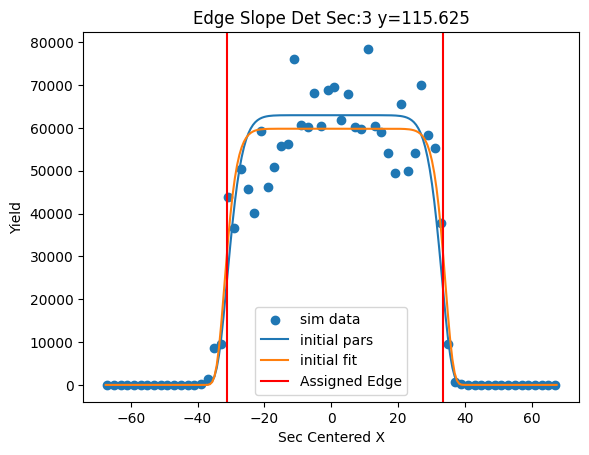

[5.75098643e+04 1.31666769e+00 2.41541395e+01 1.19162076e+01]


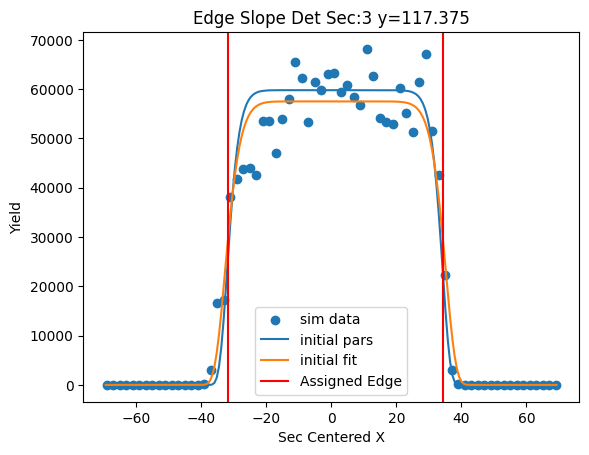

[5.41580619e+04 1.34465771e+00 2.46158903e+01 1.01609243e+01]


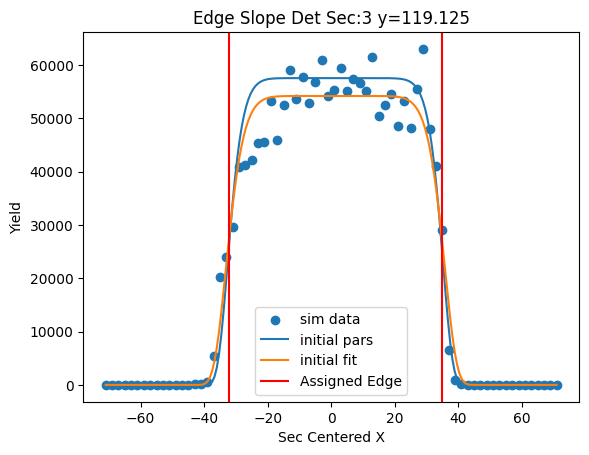

[5.16179967e+04 1.30789052e+00 2.53670922e+01 1.09887308e+01]


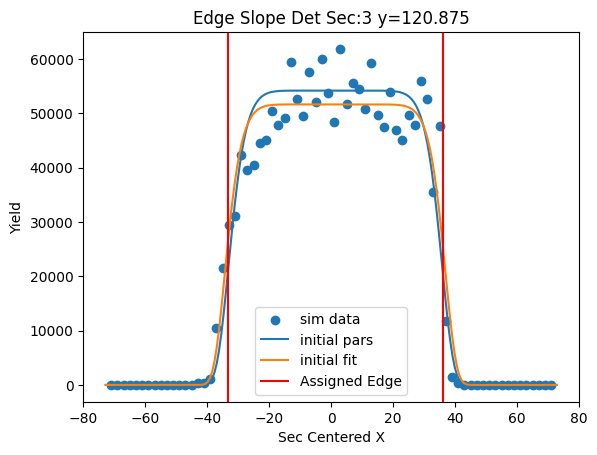

[4.87550407e+04 1.30550280e+00 2.61429050e+01 1.01545821e+01]


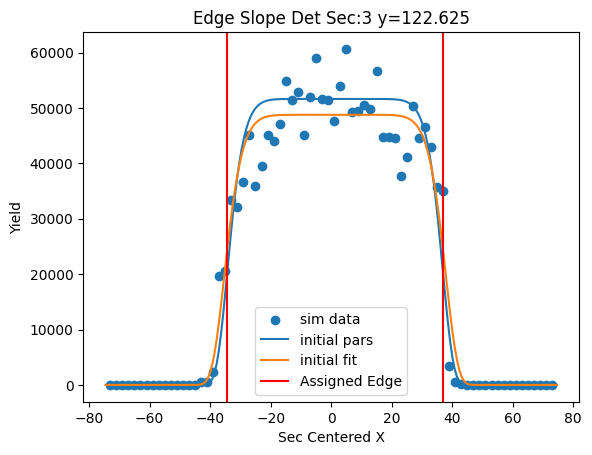

[4.48550373e+04 1.35709551e+00 2.66110312e+01 8.29325785e+00]


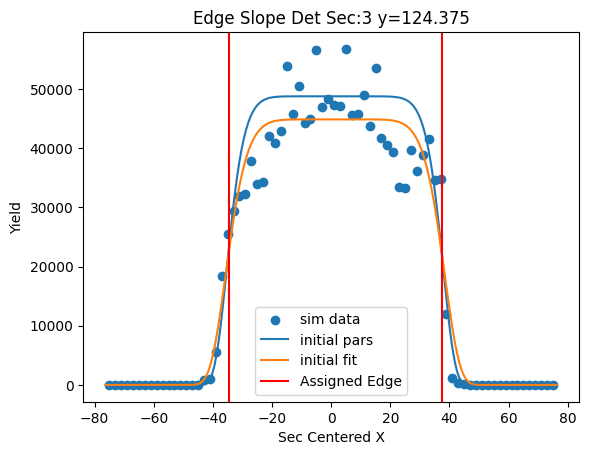

[4.40540809e+04 1.59082197e+00 2.65669533e+01 5.20196266e+00]


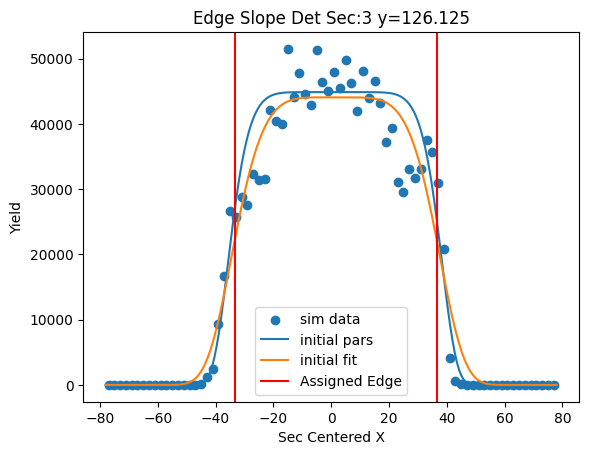

[4.55868295e+04 1.84283135e+00 2.72568593e+01 4.90902843e+00]


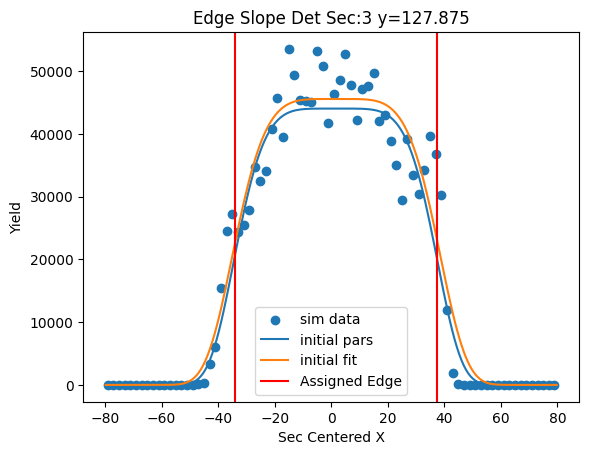

[4.46048999e+04 1.99966216e+00 2.82787851e+01 5.24315764e+00]


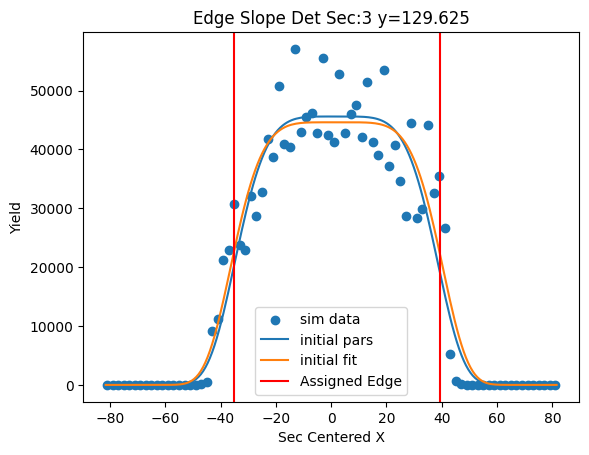

[4.18815191e+04 1.75373260e+00 2.93237369e+01 5.47042456e+00]


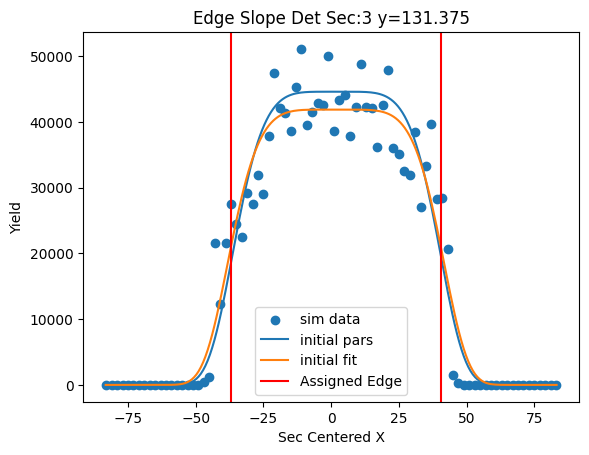

[3.79370505e+04 1.75711063e+00 2.97752747e+01 5.75766108e+00]


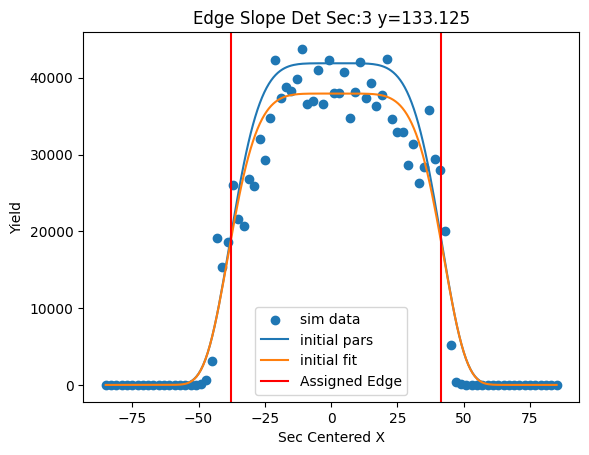

[3.81291312e+04 1.66985942e+00 3.02871373e+01 5.64826196e+00]


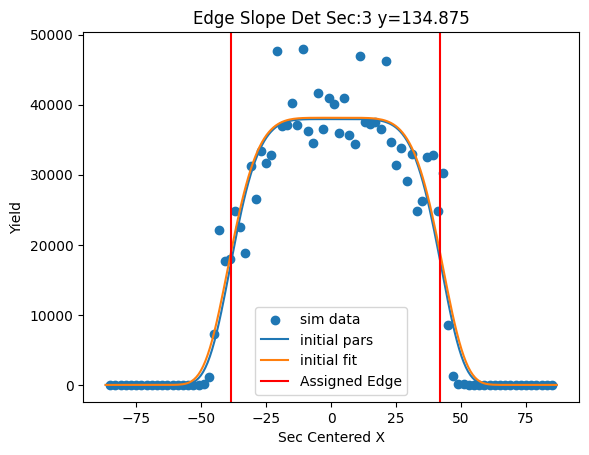

[3.80829596e+04 1.41757320e+00 3.07081215e+01 5.15029851e+00]


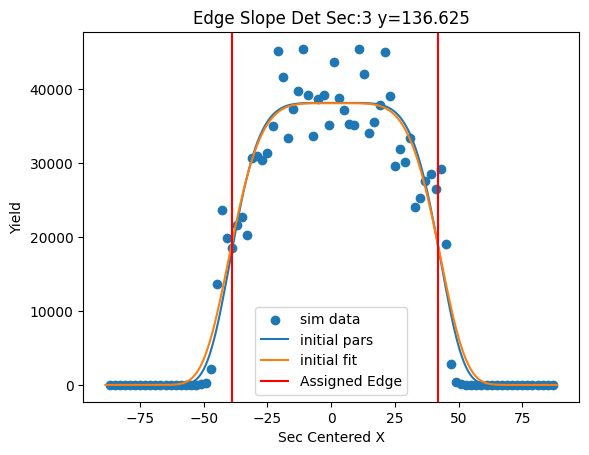

[3.58510449e+04 1.07609611e+00 3.06842082e+01 4.62136087e+00]


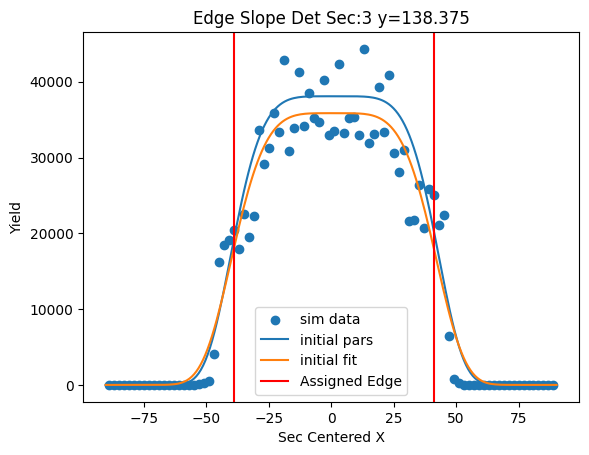

[3.34810392e+04 9.32111134e-01 3.07161964e+01 4.24223189e+00]


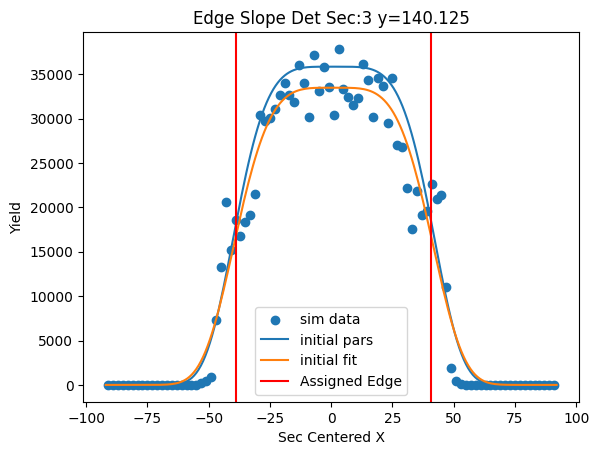

[3.32503190e+04 1.06362772e+00 3.18731411e+01 4.59573123e+00]


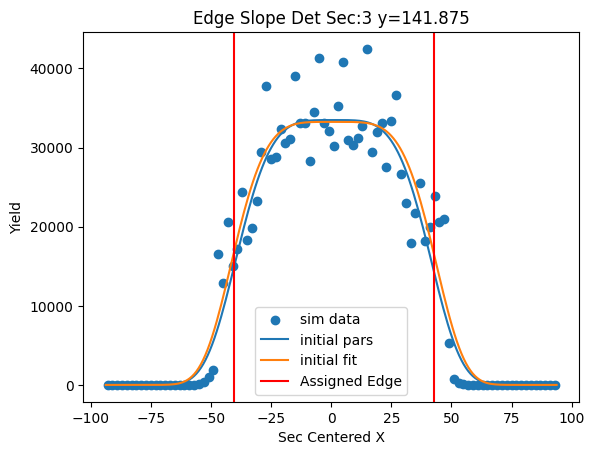

[3.16922461e+04 1.20031125e+00 3.29395936e+01 5.15250371e+00]


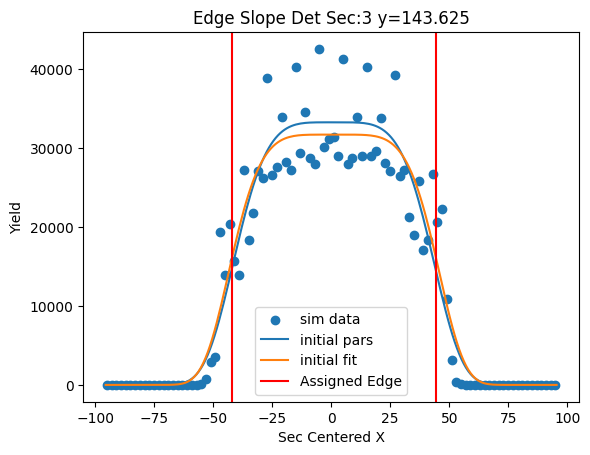

[2.97876848e+04 1.47906249e+00 3.36409158e+01 5.54774759e+00]


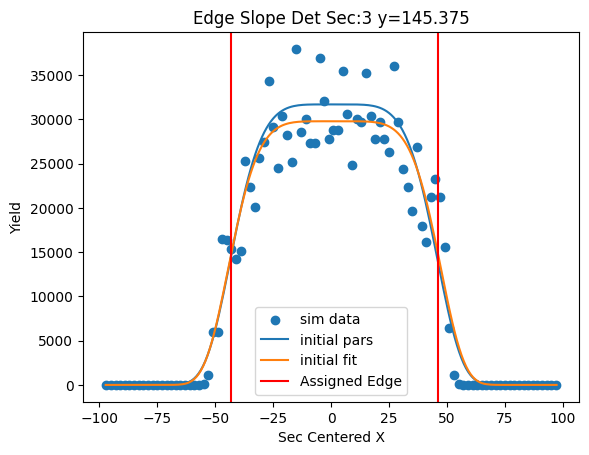

[2.78470229e+04 1.44527316e+00 3.38531951e+01 5.34771613e+00]


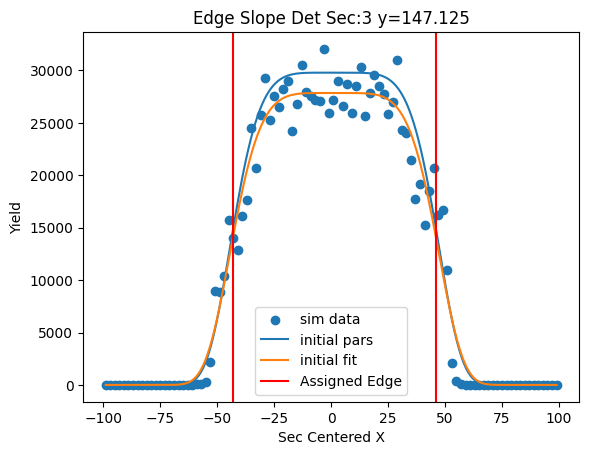

[2.84675525e+04 1.50124131e+00 3.46354658e+01 5.36260791e+00]


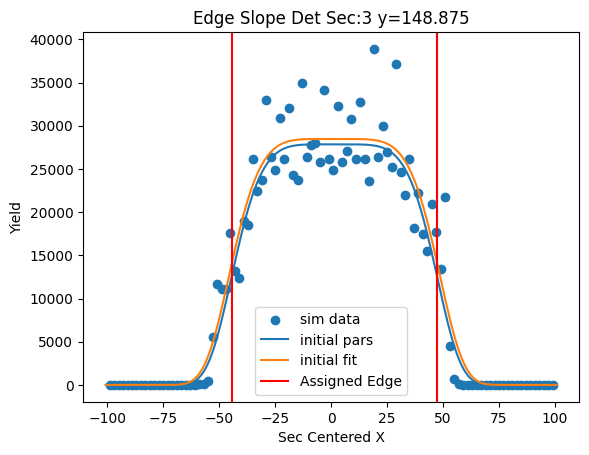

[2.76294555e+04 1.24416022e+00 3.52623361e+01 5.15365184e+00]


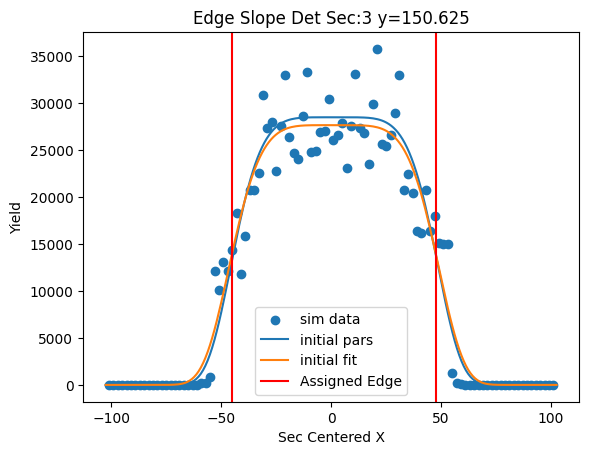

[2.53264379e+04 1.28279448e+00 3.52413720e+01 4.84165792e+00]


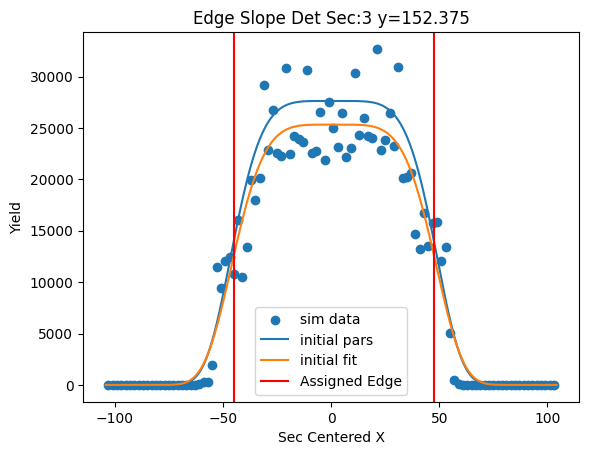

[2.40823100e+04 1.46623789e+00 3.52748314e+01 4.81521813e+00]


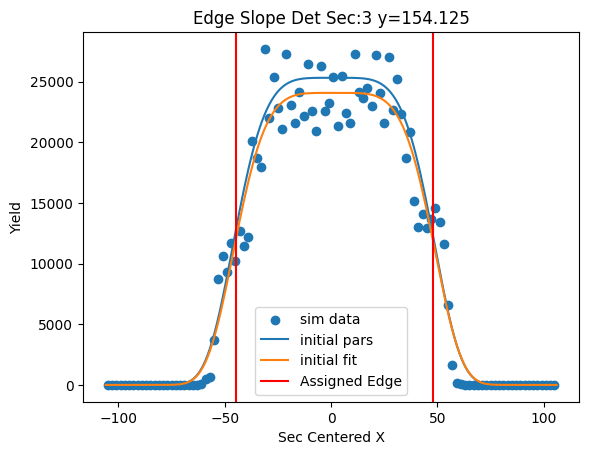

[2.50691196e+04 1.58077476e+00 3.63273278e+01 5.14929553e+00]


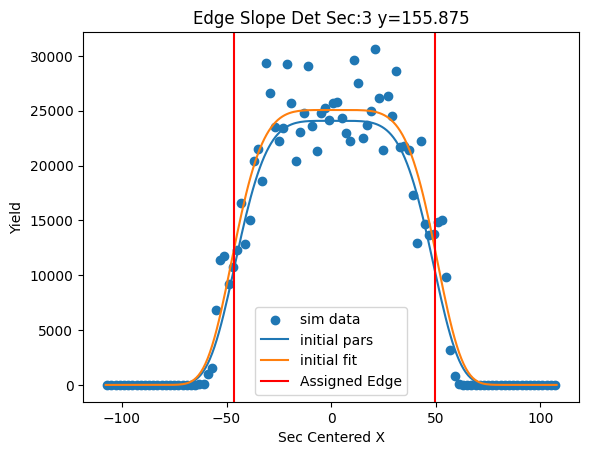

[2.40193511e+04 1.72007675e+00 3.74339015e+01 5.60846743e+00]


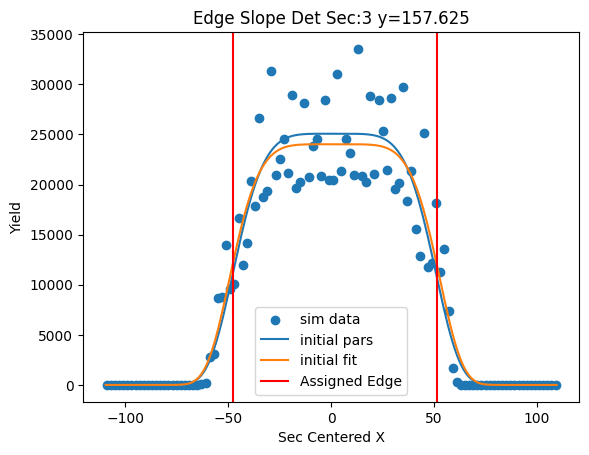

[2.20550606e+04 1.65129100e+00 3.85721309e+01 6.01635279e+00]


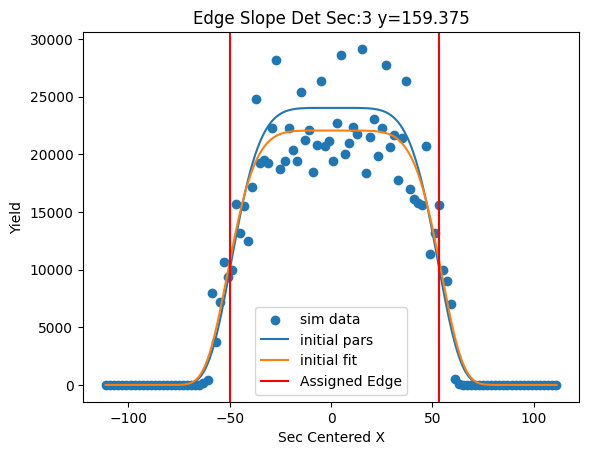

[1.92778407e+04 1.96833250e+00 3.92861209e+01 6.67177039e+00]


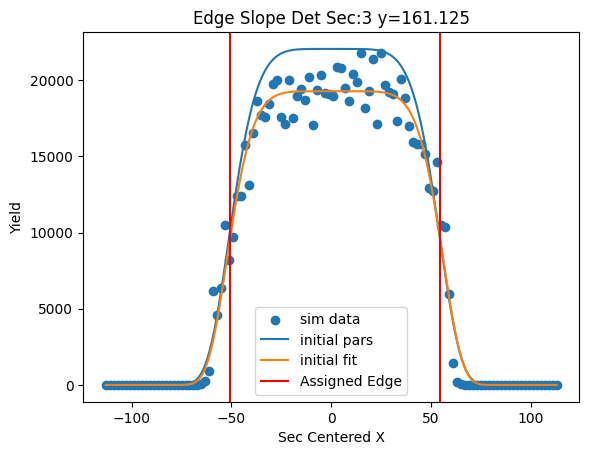

[2.00289497e+04 1.80879010e+00 4.04302709e+01 7.70935556e+00]


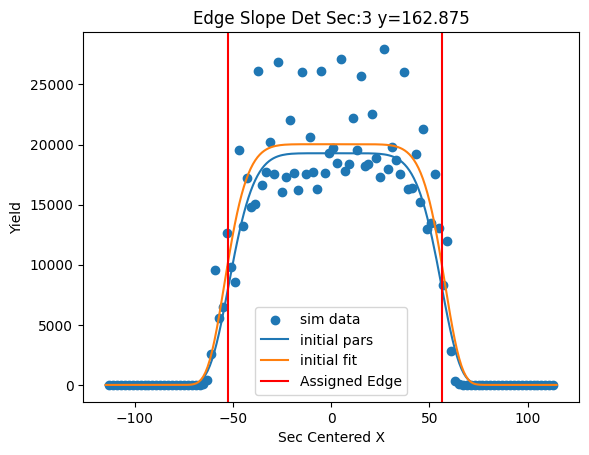

[1.96803916e+04 1.66982831e+00 4.10567422e+01 7.68835063e+00]


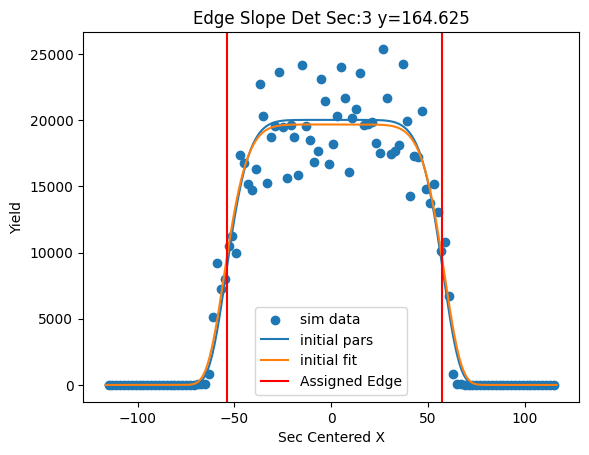

[1.79764666e+04 1.43070239e+00 4.11097128e+01 7.21249348e+00]


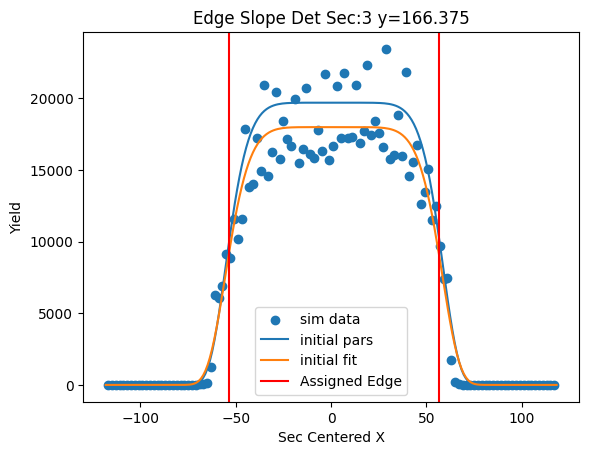

[1.71526745e+04 1.21634277e+00 4.12414176e+01 6.62922345e+00]


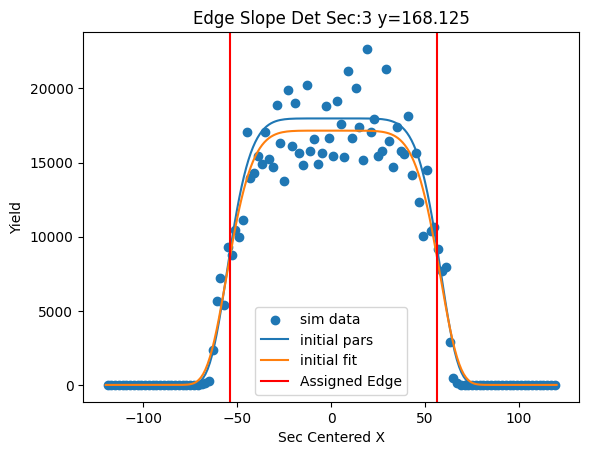

[1.73177742e+04 1.09058901e+00 4.18089723e+01 6.42844918e+00]


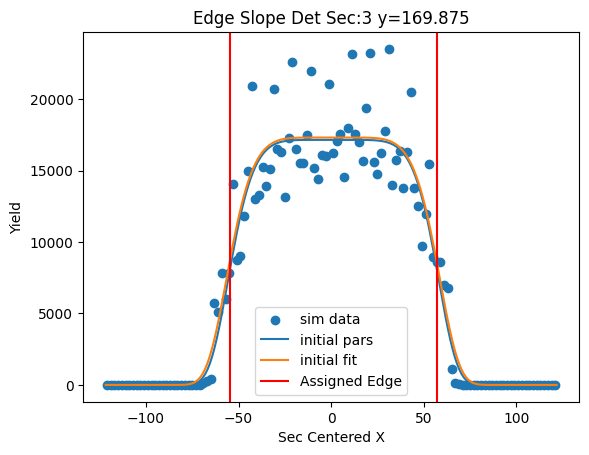

[1.64559227e+04 1.11825026e+00 4.23835310e+01 6.33552654e+00]


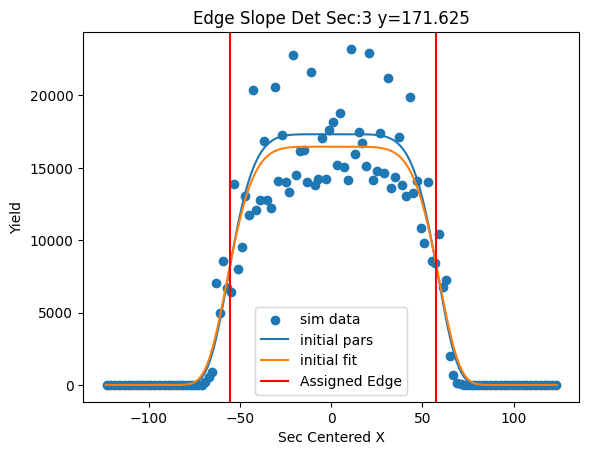

[1.57210742e+04 1.52668109e+00 4.31319872e+01 6.73314504e+00]


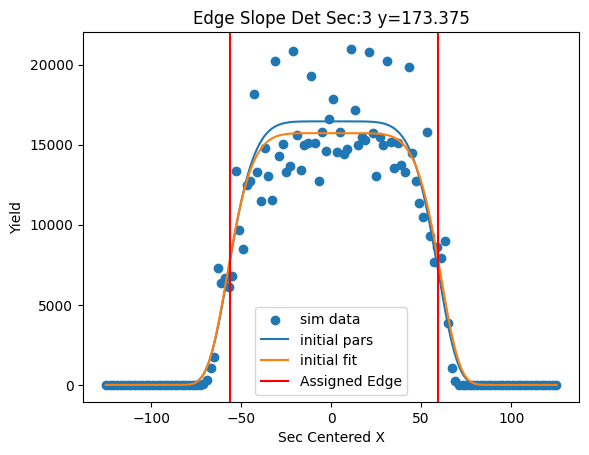

[1.44012387e+04 1.58580213e+00 4.34160096e+01 7.17717743e+00]


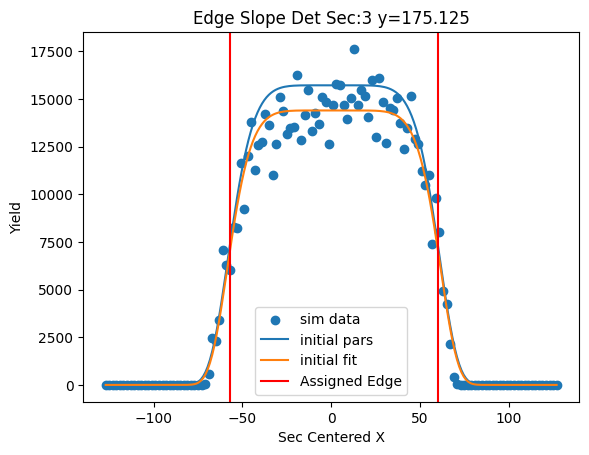

[1.52150973e+04 1.63116587e+00 4.46604590e+01 8.13707172e+00]


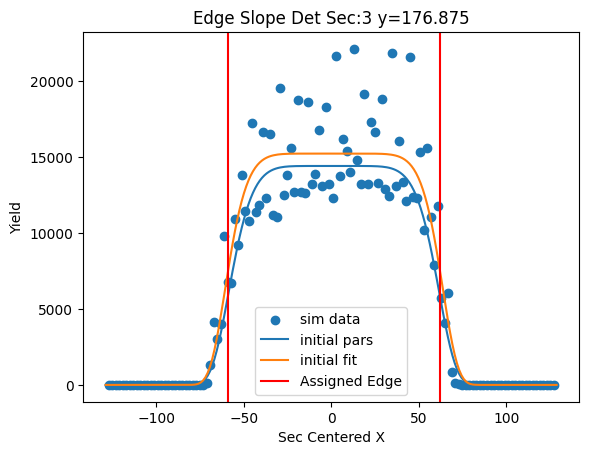

[1.45874089e+04 1.04432363e+00 4.56088729e+01 8.40130634e+00]


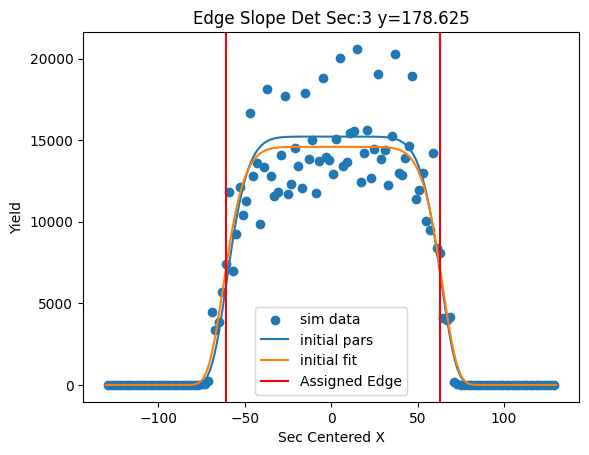

[1.27912180e+04 9.13353256e-01 4.58202017e+01 8.60152046e+00]


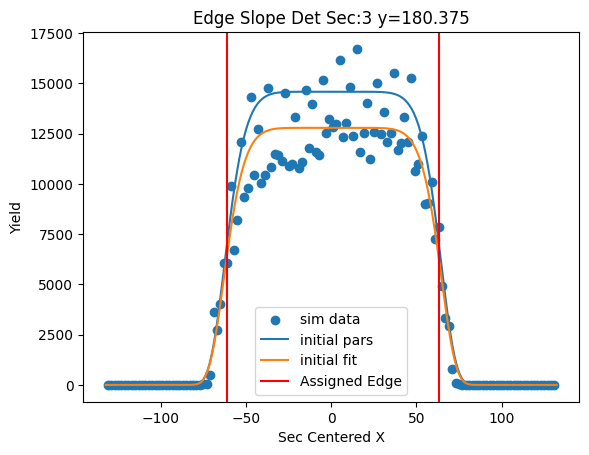

[1.25539422e+04 8.23572258e-01 4.62346339e+01 8.50768660e+00]


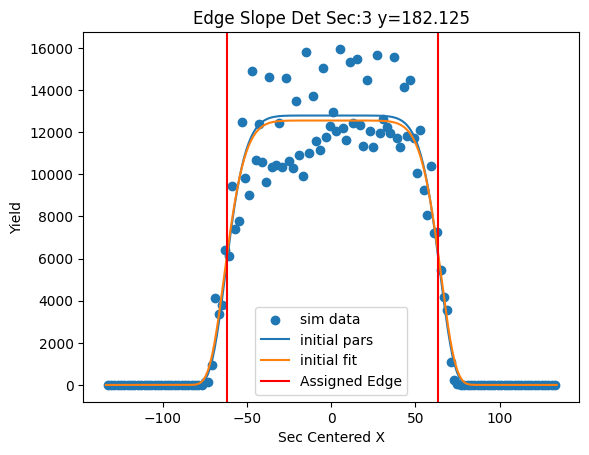

[1.33188224e+04 7.11655644e-01 4.73519397e+01 8.39998724e+00]


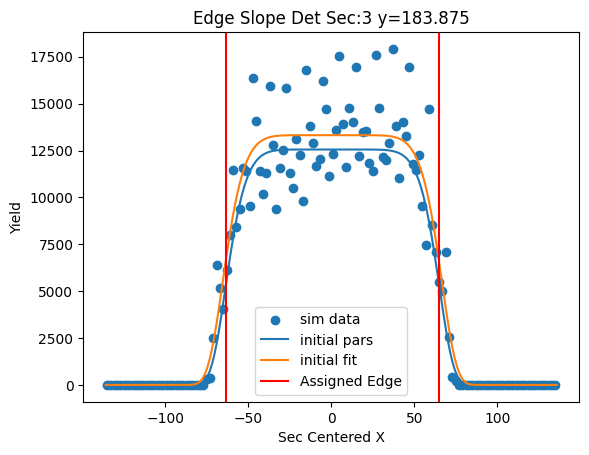

[1.27272758e+04 9.74898689e-01 4.79115635e+01 8.50040625e+00]


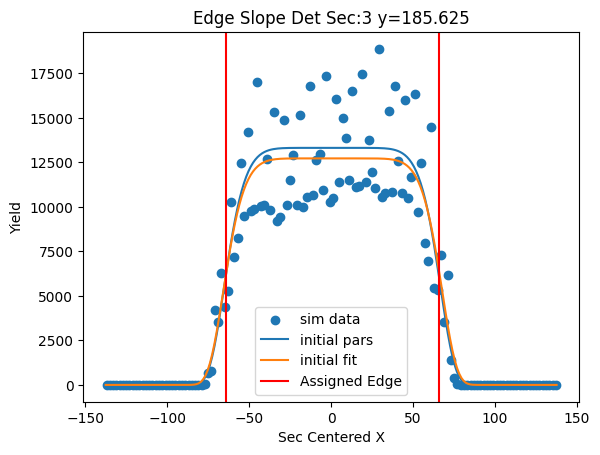

[1.09592134e+04 6.05327418e-01 4.81944743e+01 8.34850350e+00]


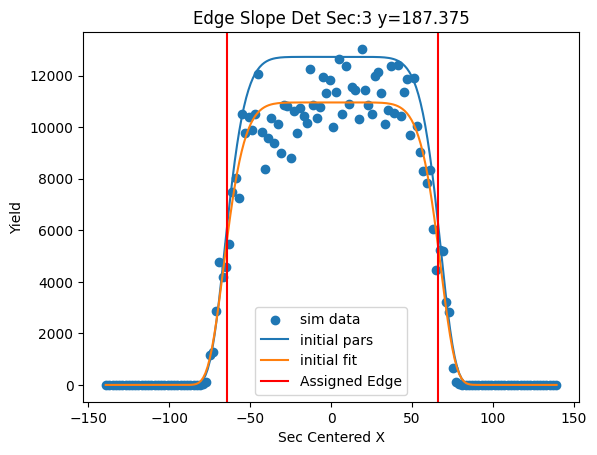

[1.14330134e+04 5.80057336e-01 4.95536446e+01 8.88773270e+00]


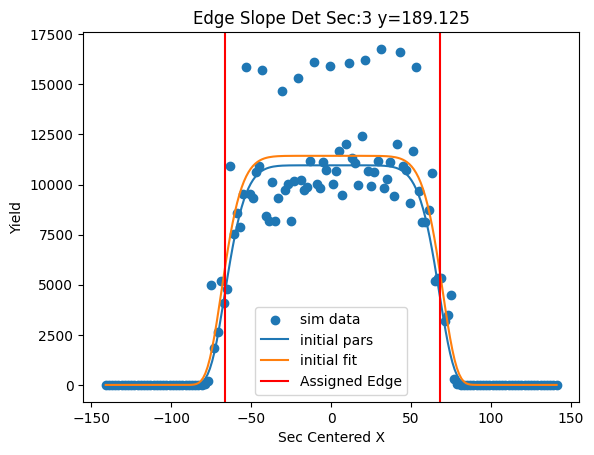

[1.13706784e+04 6.29319264e-01 5.06737483e+01 9.68998708e+00]


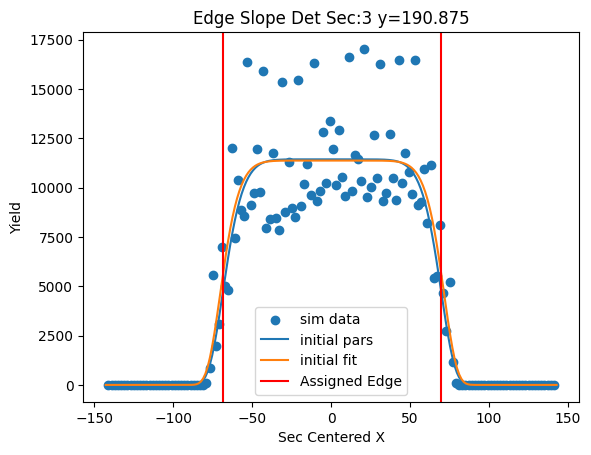

[1.10536721e+04 7.02824124e-01 5.17788694e+01 9.67466082e+00]


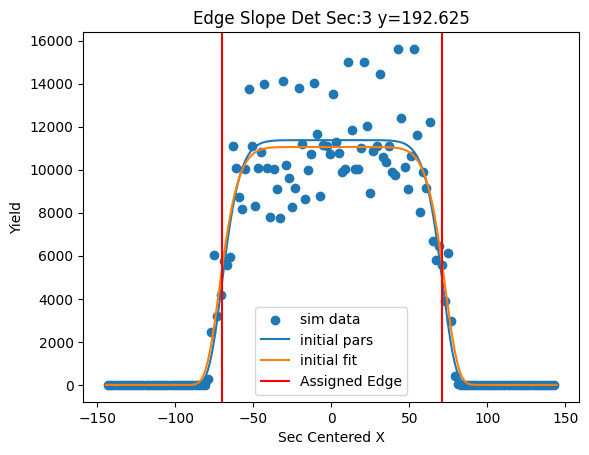

[9.90512294e+03 4.01826478e-01 5.19493145e+01 1.00046839e+01]


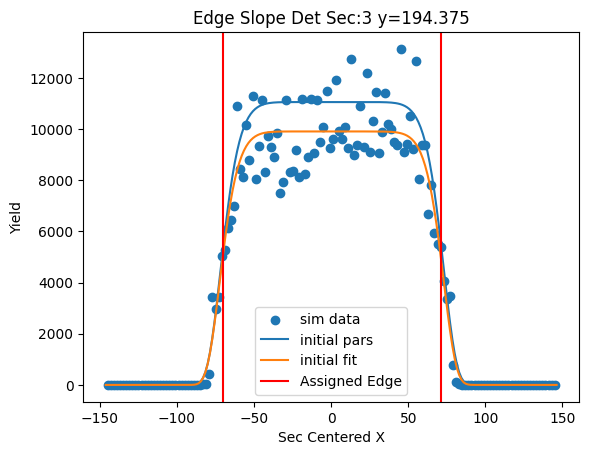

[9.91999106e+03 3.93007738e-01 5.24392214e+01 1.00856222e+01]


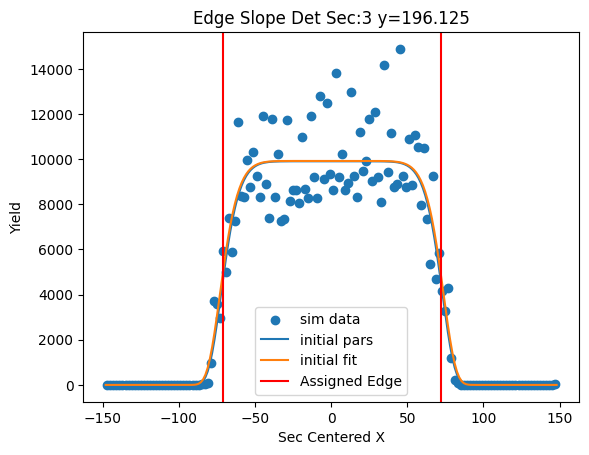

[1.00978270e+04 2.27473630e-01 5.33811554e+01 1.03009175e+01]


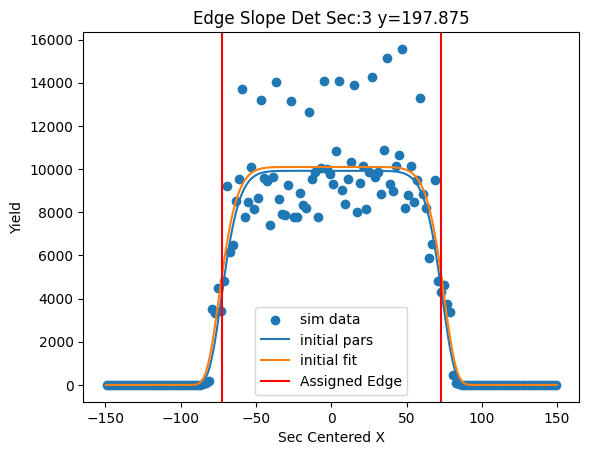

[9.29358850e+03 1.95624790e-01 5.38433401e+01 9.81376559e+00]


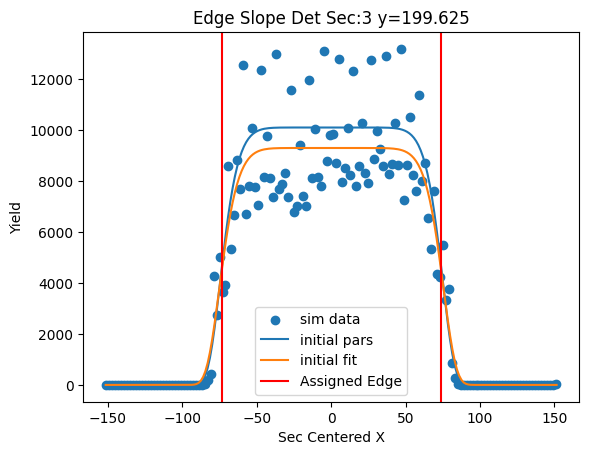

[8.17589132e+03 3.18332553e-01 5.40469190e+01 9.52899608e+00]


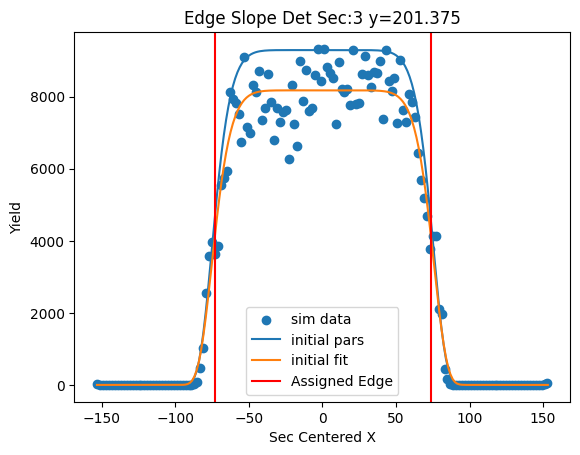

[8.89326559e+03 5.24196839e-01 5.53473554e+01 1.03071772e+01]


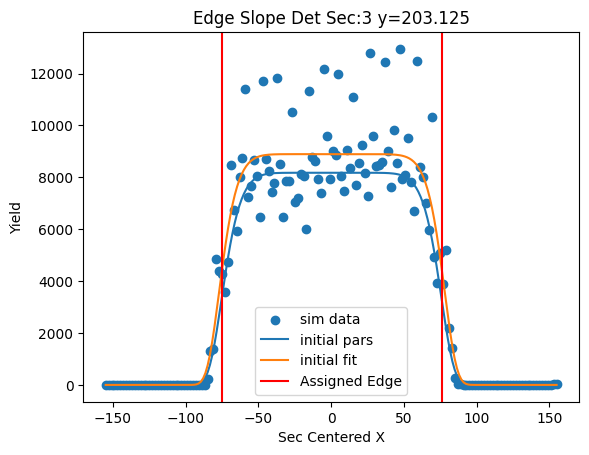

[8.95794480e+03 6.08698913e-01 5.62268235e+01 1.03290199e+01]


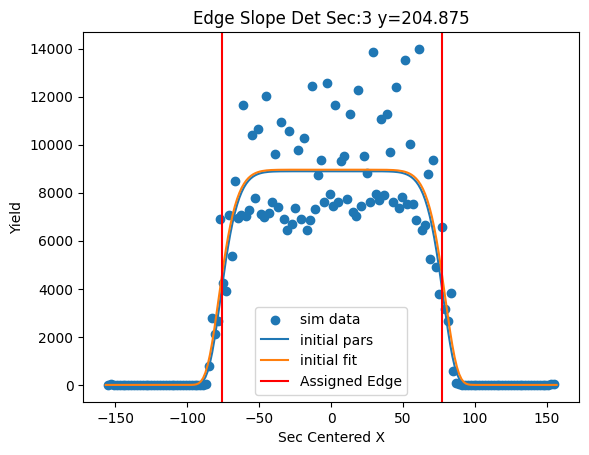

[8.38059648e+03 2.71063169e-01 5.74267517e+01 1.05140254e+01]


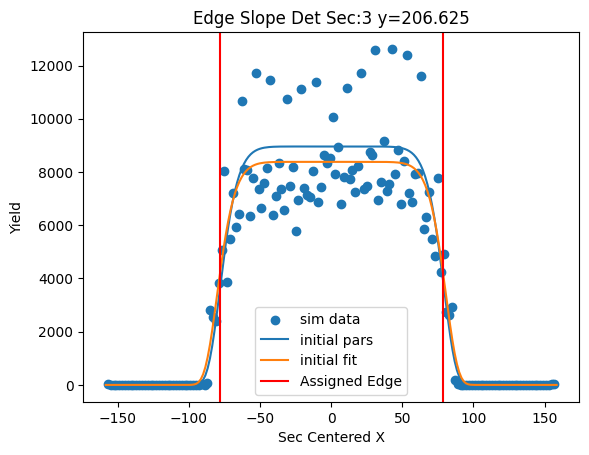

[7.09214132e+03 3.85467122e-01 5.78592207e+01 1.03943848e+01]


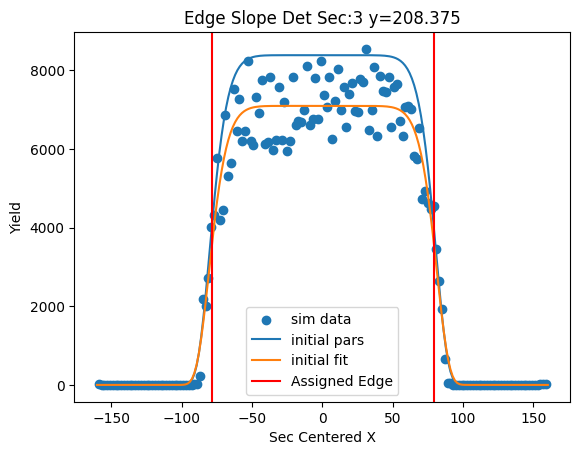

[7.34975361e+03 5.71532719e-01 5.87652662e+01 1.14377127e+01]


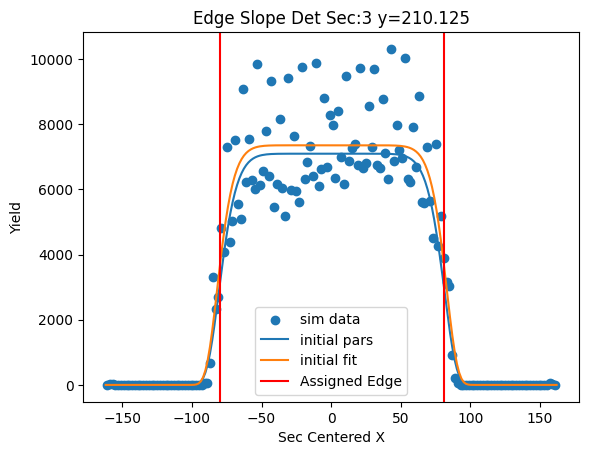

[7.75384266e+03 1.29385734e+00 5.98344657e+01 1.24652025e+01]


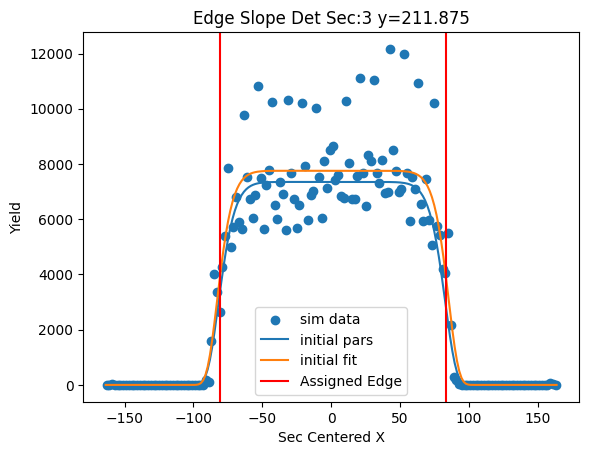

[7.20069287e+03 1.72083962e+00 6.03977924e+01 1.26767749e+01]


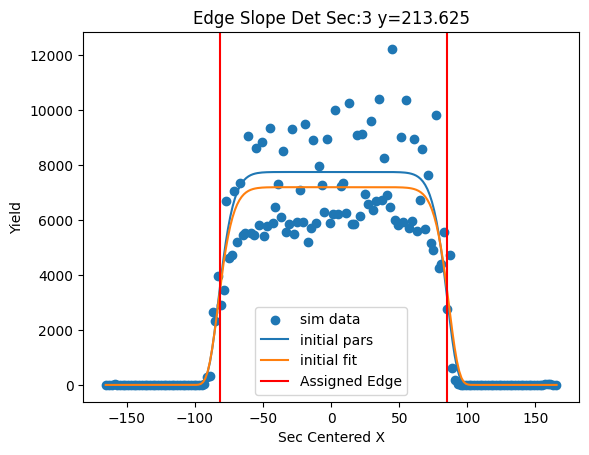

[6.22520916e+03 1.62585665e+00 6.08983741e+01 1.20971356e+01]


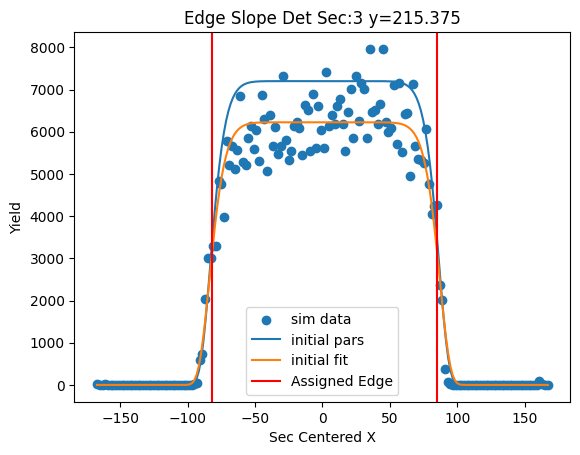

[6.70927131e+03 1.78579135e+00 6.20400171e+01 1.26095564e+01]


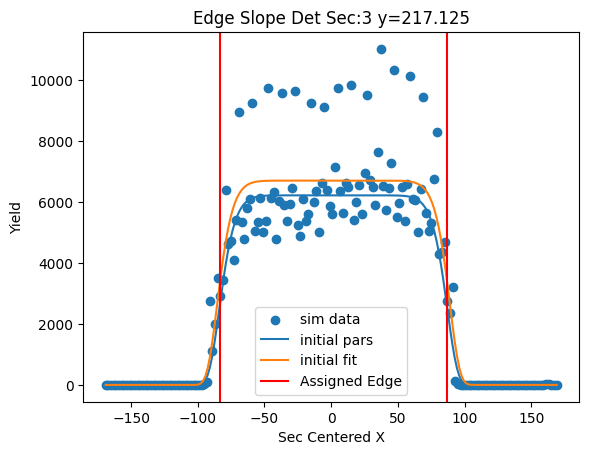

[6.61433004e+03 1.74003914e+00 6.31806204e+01 1.38248301e+01]


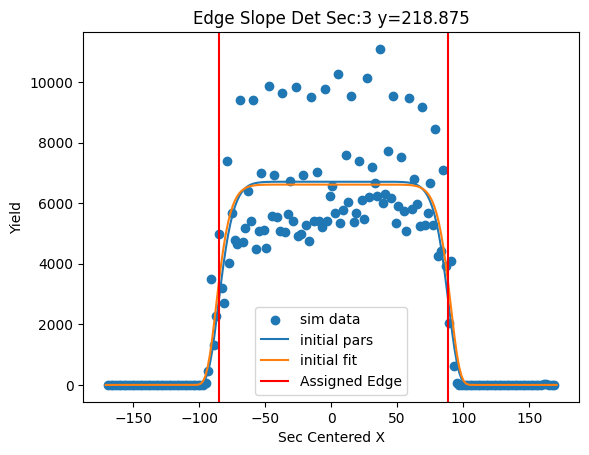

[6.38353006e+03 2.06212498e+00 6.39451323e+01 1.30735002e+01]


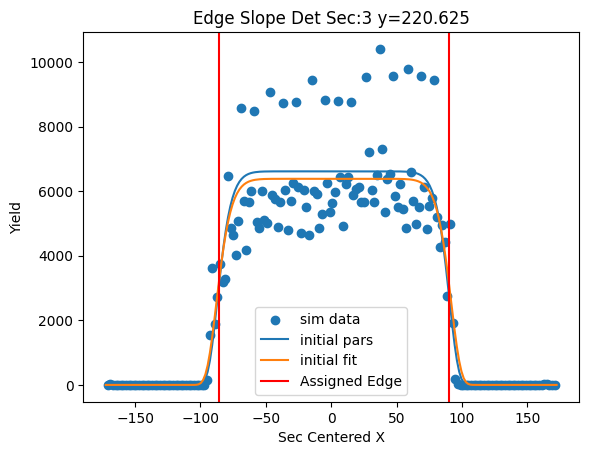

[5.57650889e+03 1.84601236e+00 6.41171213e+01 1.29990327e+01]


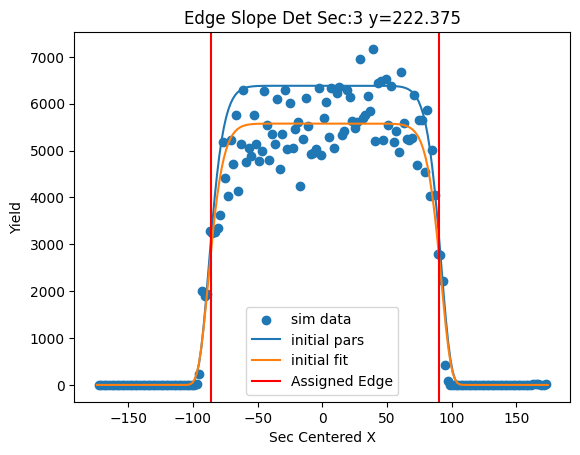

[5.97254400e+03 1.73640944e+00 6.48858085e+01 1.39002270e+01]


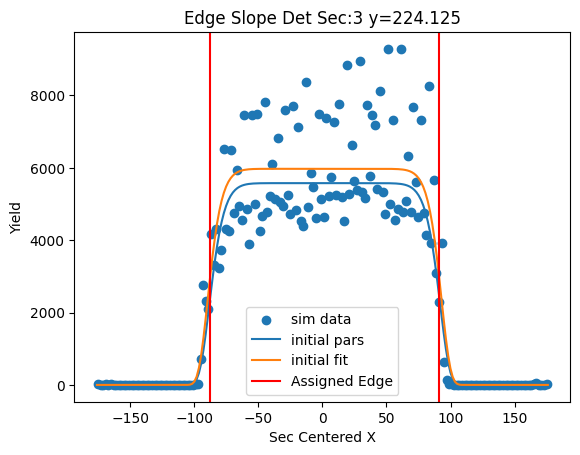

[6.14785144e+03 1.34829090e+00 6.58586656e+01 1.50959840e+01]


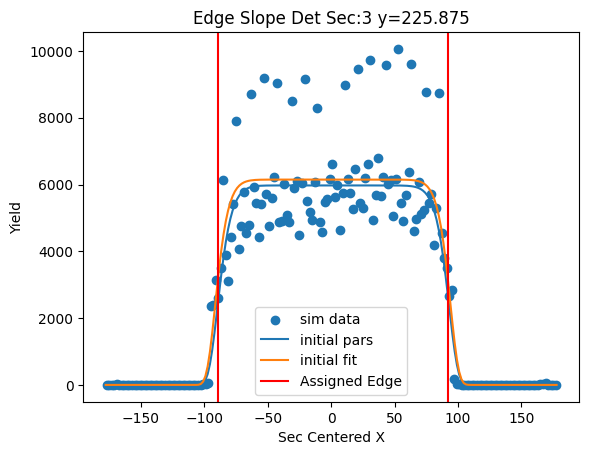

[5.49680741e+03 9.78249968e-01 6.64424163e+01 1.48883891e+01]


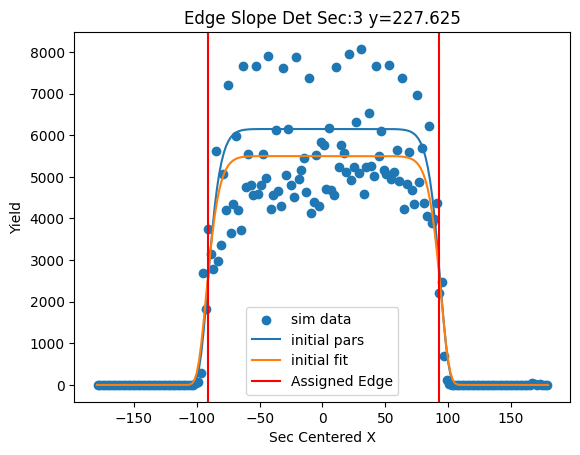

[4.97225606e+03 8.11232583e-01 6.64269717e+01 1.32383149e+01]


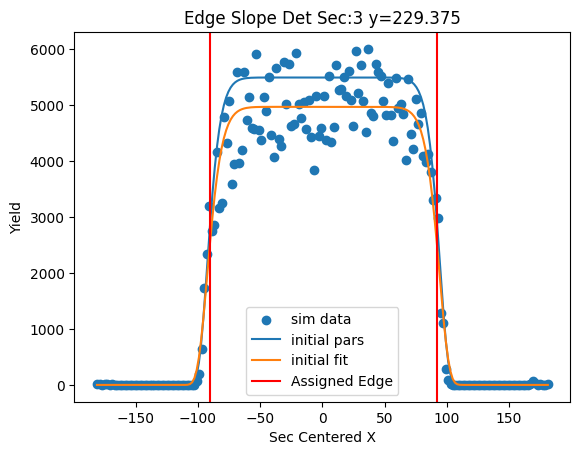

[5.71339809e+03 1.03439152e+00 6.71003655e+01 1.33834386e+01]


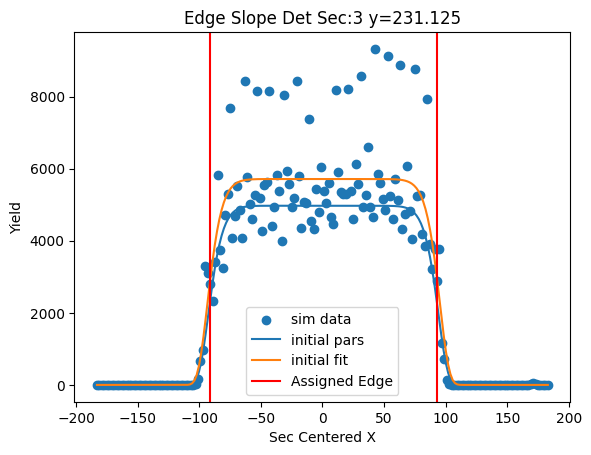

[5.64923170e+03 1.49340959e+00 6.74205107e+01 1.15746286e+01]


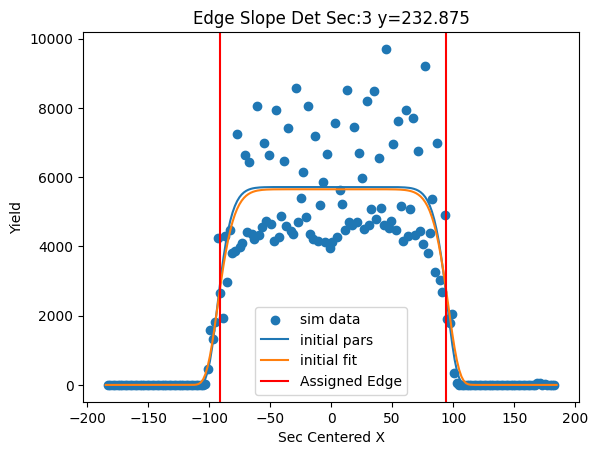

[5.26151510e+03 8.20176477e-01 6.84773985e+01 1.09144182e+01]


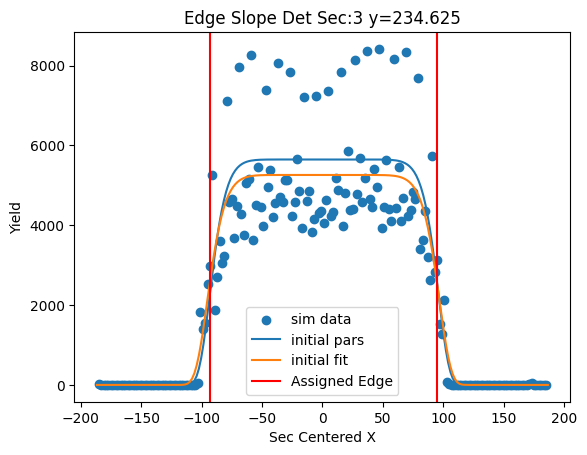

[4.28372787e+03 6.87784267e-01 6.85087638e+01 1.03491785e+01]


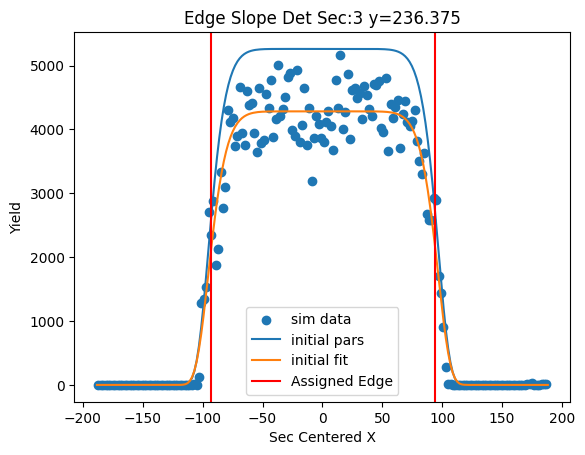

[4.61538181e+03 9.68411218e-01 6.97077864e+01 1.10569324e+01]


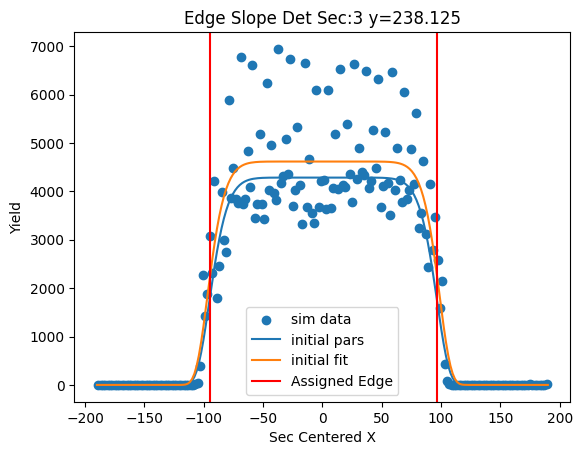

[4.82563473e+03 1.01396365e+00 7.07955447e+01 1.21203242e+01]


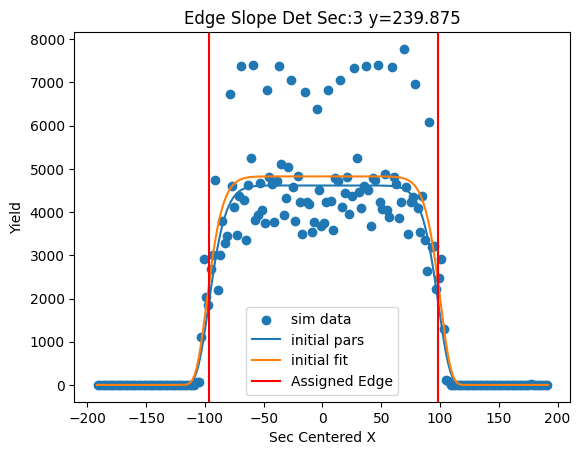

[4.29049259e+03 1.01820015e+00 7.13360041e+01 1.28148997e+01]


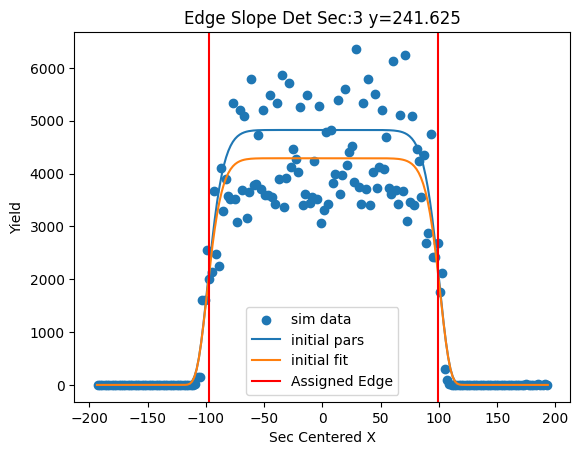

[3.87695981e+03 6.13012152e-01 7.16273702e+01 1.30199597e+01]


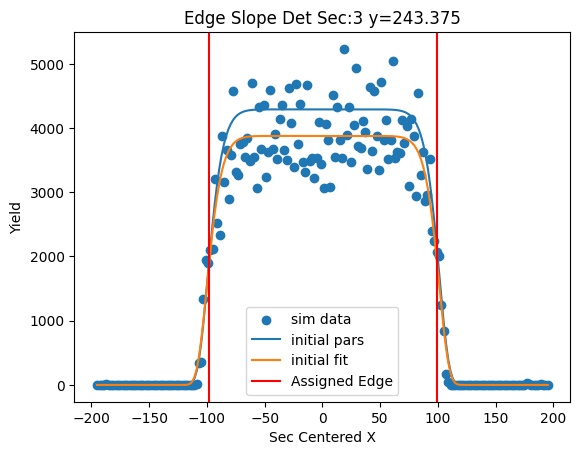

[4.24857531e+03 2.50140242e-01 7.24289443e+01 1.36727792e+01]


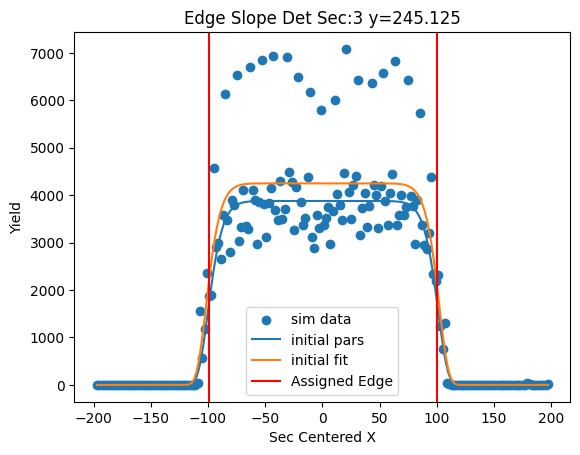

[4.08833207e+03 6.44210628e-02 7.29528719e+01 1.37218734e+01]


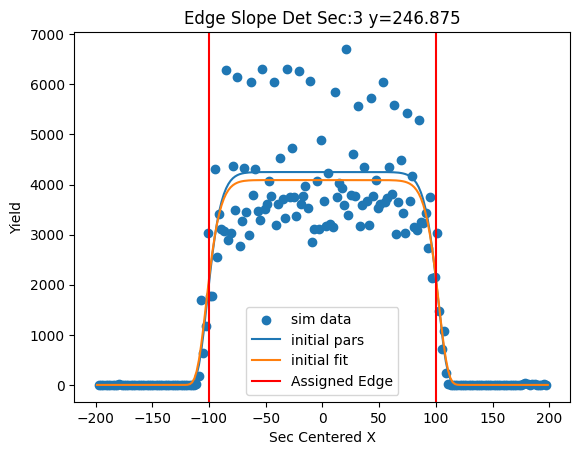

[3.92953791e+03 2.25771767e-01 7.36278731e+01 1.38426787e+01]


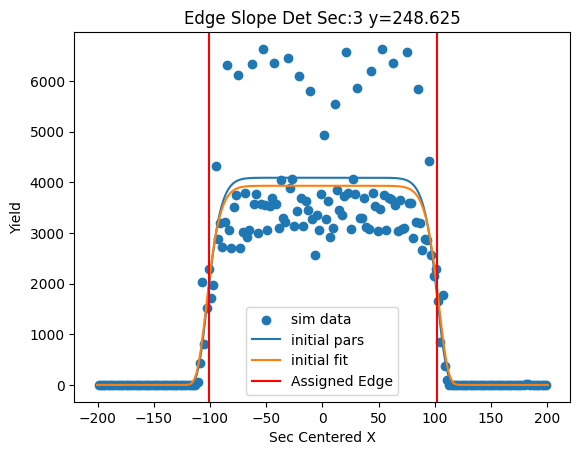

[3.37811697e+03 2.88933607e-01 7.36812902e+01 1.37116587e+01]


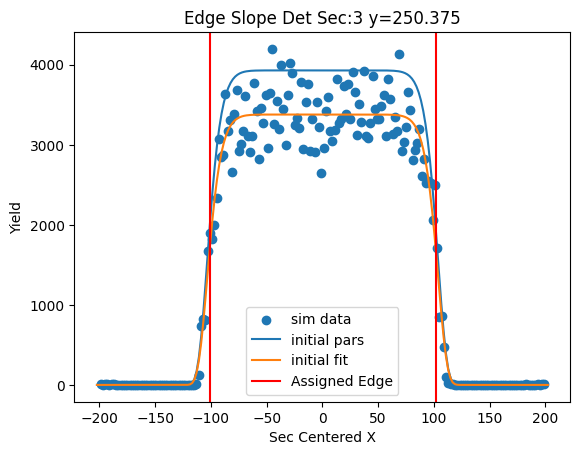

[3.84348142e+03 6.32211062e-01 7.46254047e+01 1.32246454e+01]


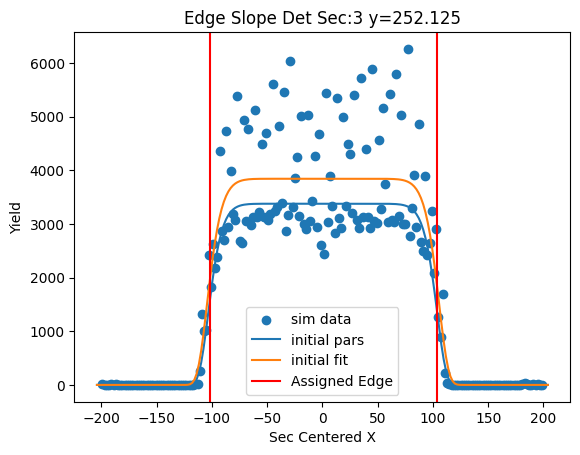

[3.91867523e+03 6.16830502e-01 7.55711353e+01 1.28251090e+01]


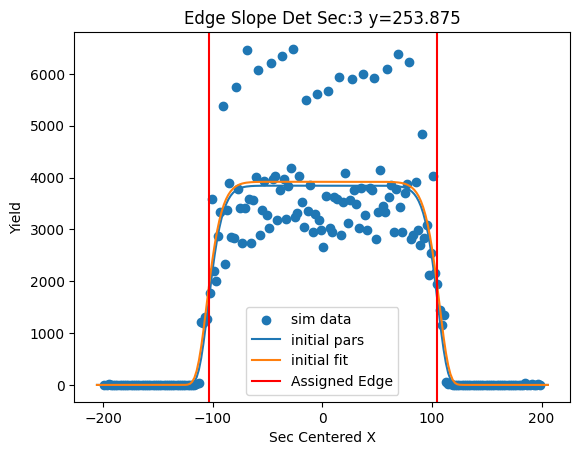

[3.30356669e+03 5.94914697e-01 7.62922510e+01 1.28711219e+01]


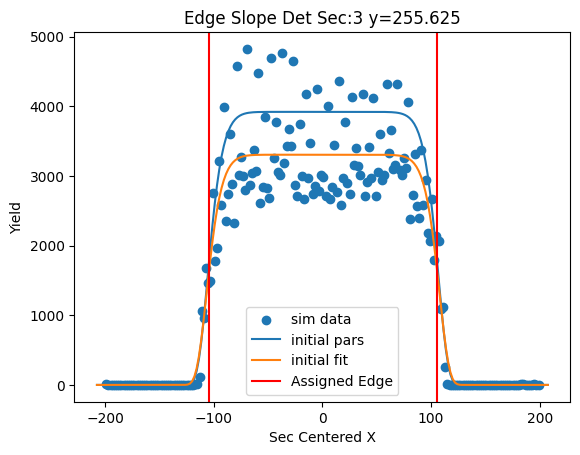

[3.10740011e+03 7.32122959e-01 7.66032592e+01 1.26831145e+01]


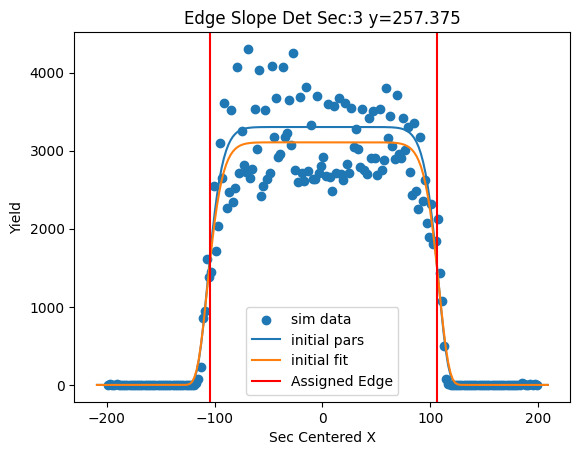

[3.66513535e+03 1.53136404e+00 7.74636415e+01 1.20280699e+01]


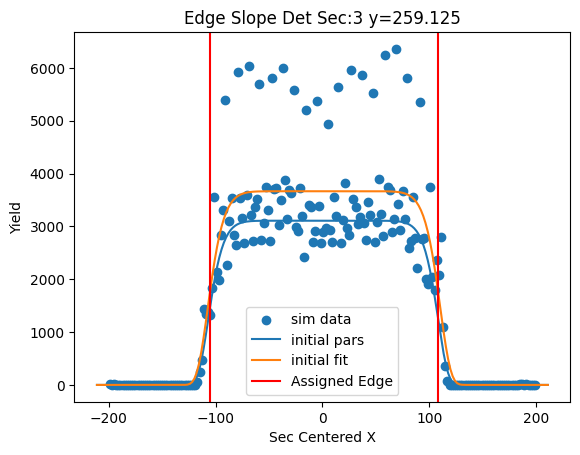

[3.57651965e+03 1.73760620e+00 7.76247028e+01 1.11820315e+01]


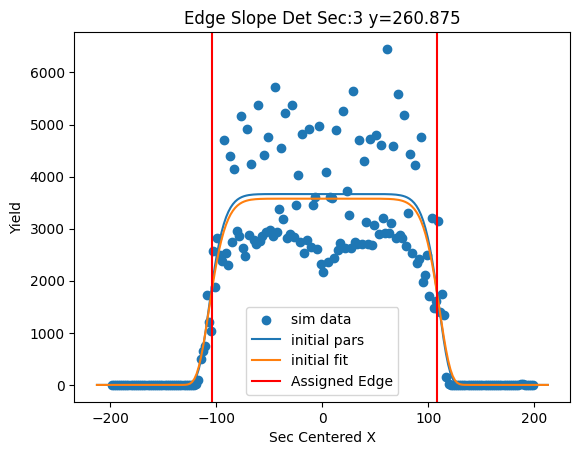

[3.41437841e+03 1.02216680e+00 7.80393633e+01 1.05390496e+01]


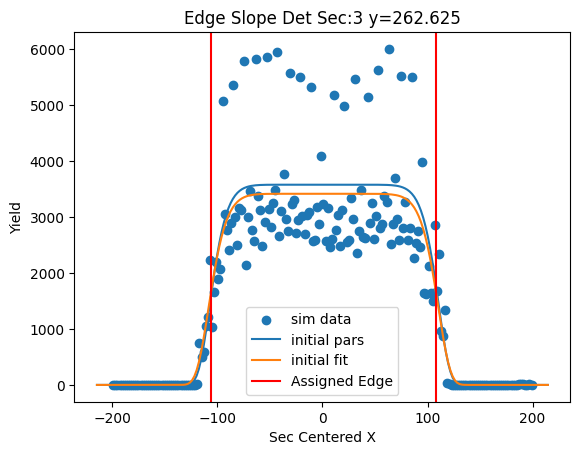

[2.72450755e+03 4.30411485e-01 7.78464070e+01 1.00148124e+01]


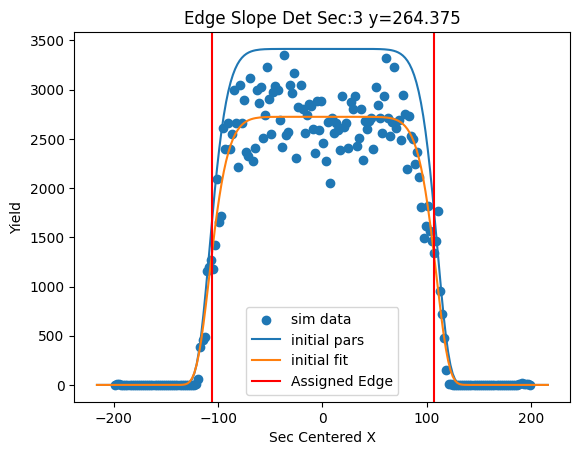

[ 3.16704103e+03 -9.58230379e-02  7.76616935e+01  9.45722290e+00]


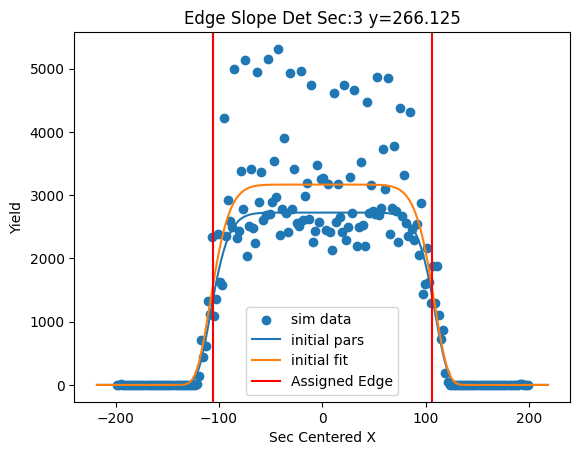

[ 3.29524834e+03 -3.51158882e-01  7.79540407e+01  9.93476494e+00]


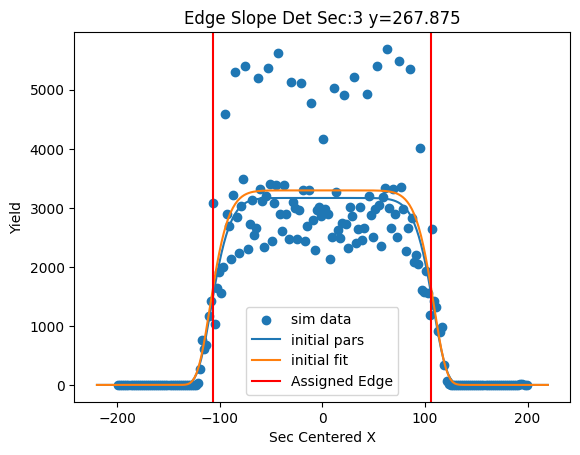

[ 2.80675405e+03 -2.94857599e-01  7.71889363e+01  9.12020121e+00]


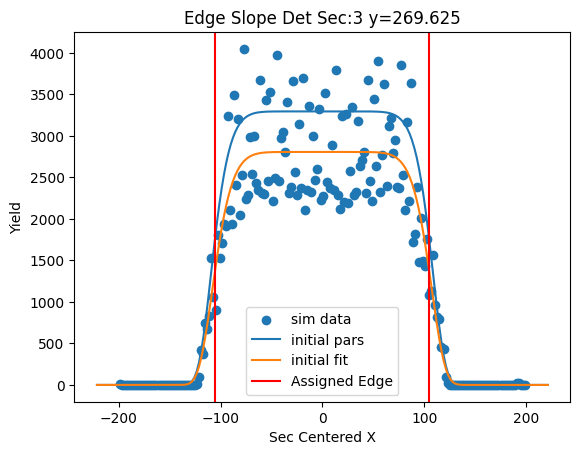

[ 2.71680156e+03 -4.18256212e-01  7.71783235e+01  8.67113158e+00]


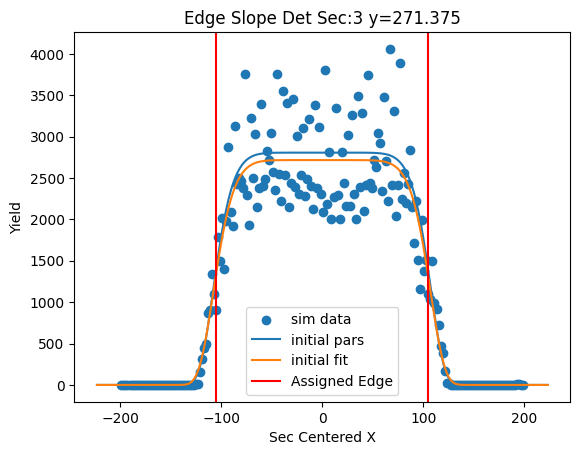

[3.00043656e+03 3.53108626e-02 7.87690220e+01 9.56225807e+00]


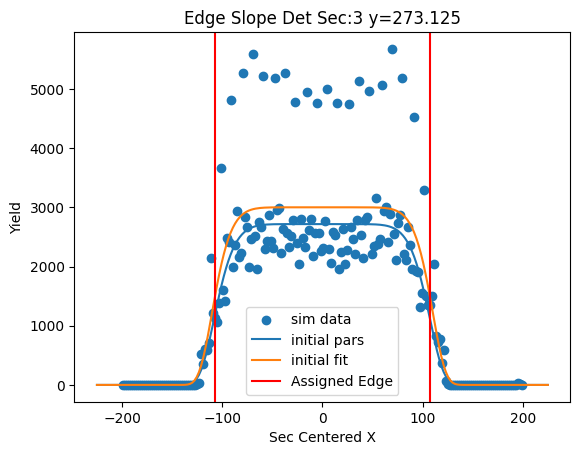

[ 2.75157995e+03 -1.86625345e-01  7.92492307e+01  8.87298268e+00]


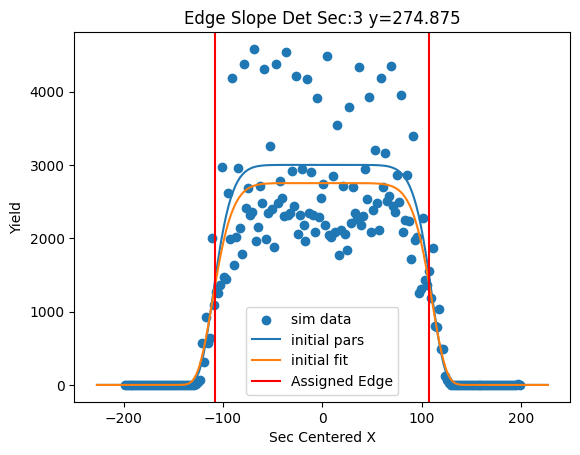

[2.21957188e+03 5.64679765e-02 7.97862156e+01 9.08070311e+00]


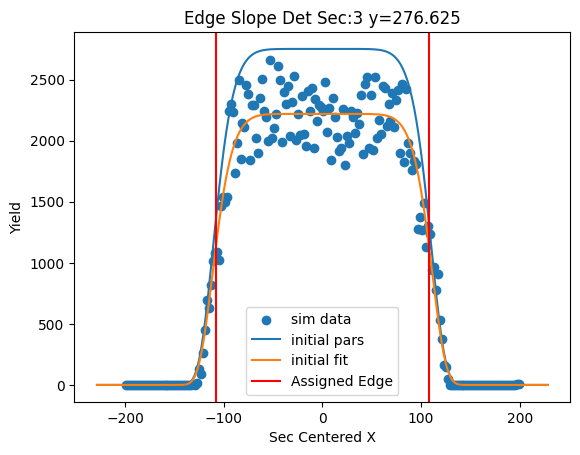

[2.71471043e+03 7.25077632e-01 8.16181440e+01 9.91780935e+00]


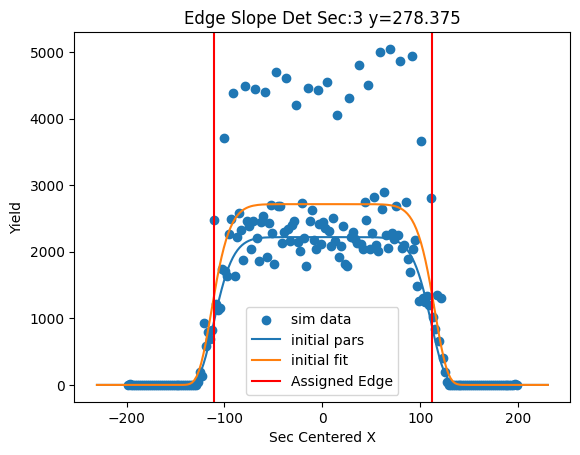

[2.71517630e+03 1.18987051e+00 8.22019934e+01 9.78752183e+00]


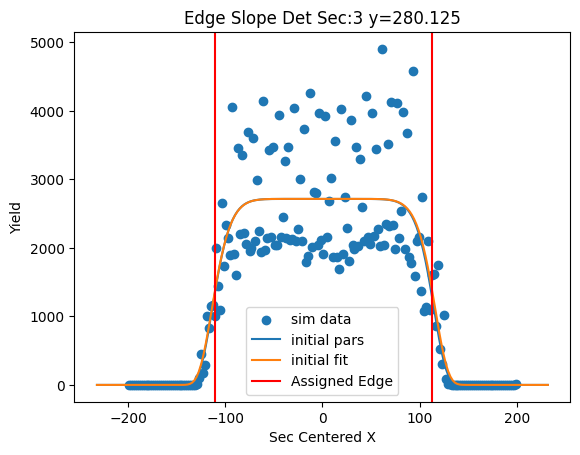

[2.67394234e+03 6.28833807e-01 8.33623966e+01 1.01598256e+01]


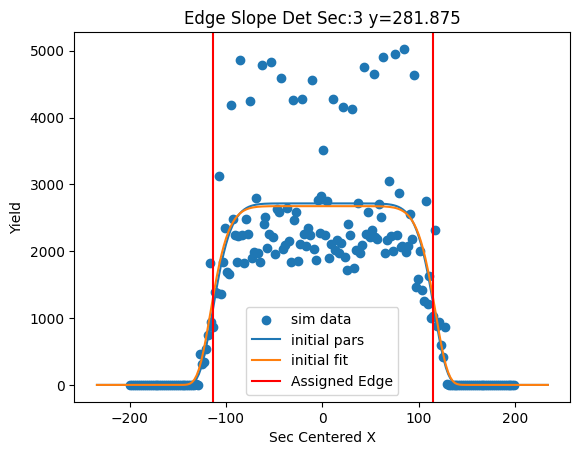

[ 2.11778017e+03 -1.98722401e-01  8.33351339e+01  9.86461188e+00]


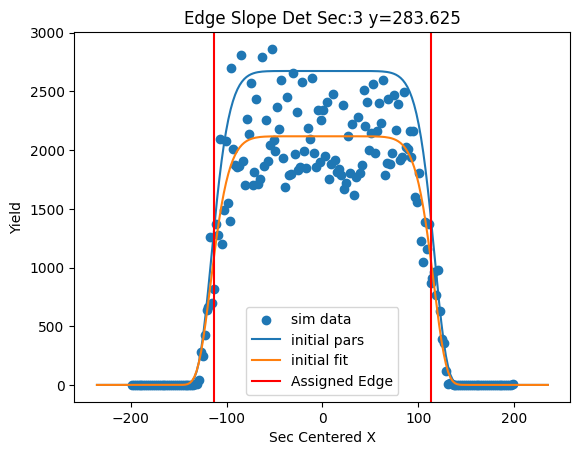

[ 2.17629119e+03 -6.99102292e-01  8.39350170e+01  1.00843515e+01]


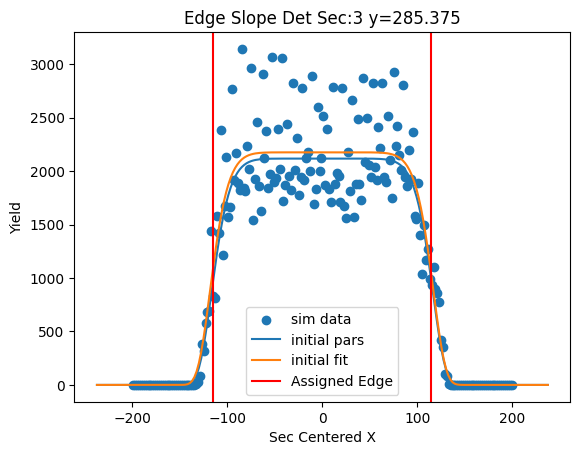

[ 2.58479215e+03 -3.35963009e-01  8.48856322e+01  1.06197122e+01]


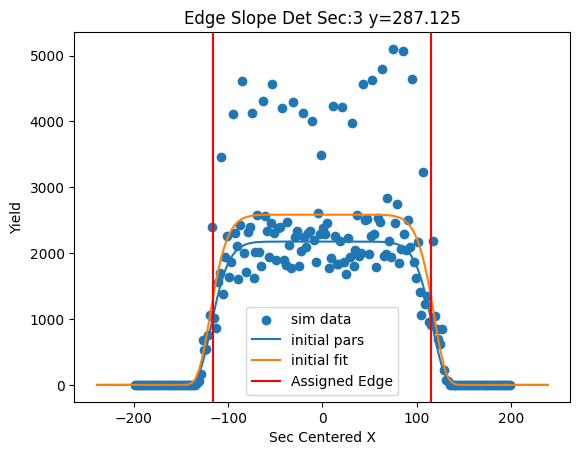

[2.40114443e+03 7.10226975e-02 8.49355662e+01 1.02518262e+01]


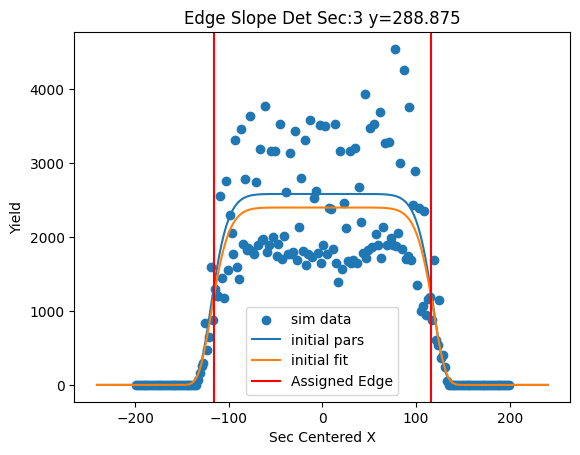

[ 1.90836701e+03 -7.64651769e-01  8.50089228e+01  9.75770752e+00]


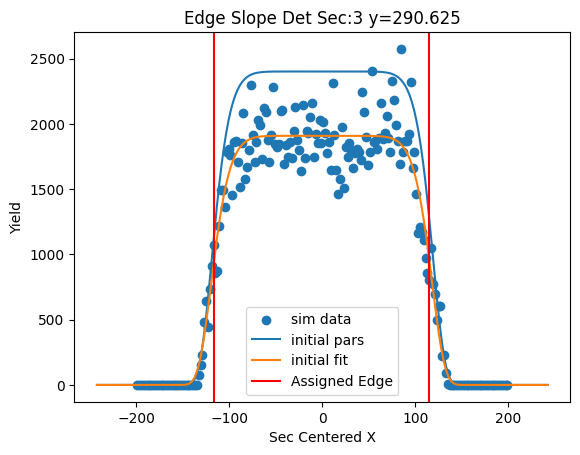

[ 2.24108393e+03 -5.20833073e-01  8.62457048e+01  1.02530006e+01]


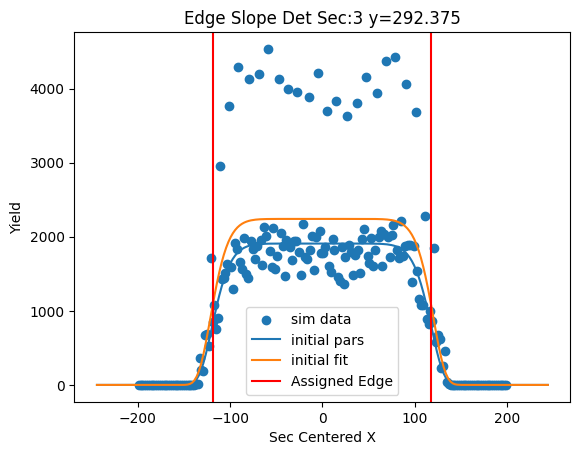

[ 2.14140077e+03 -7.79813789e-01  8.75063382e+01  1.00343044e+01]


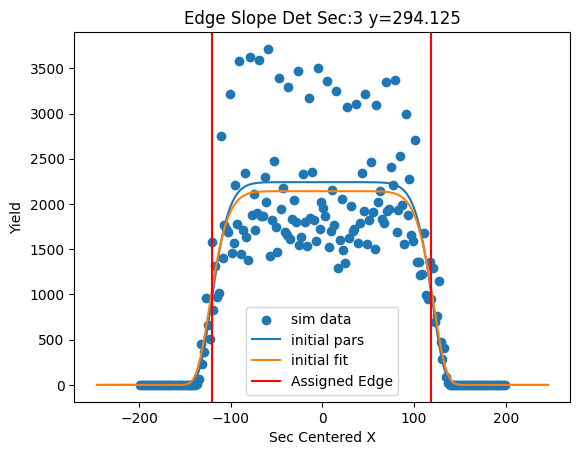

[2.17881727e+03 1.93519973e-01 8.89802208e+01 1.05081072e+01]


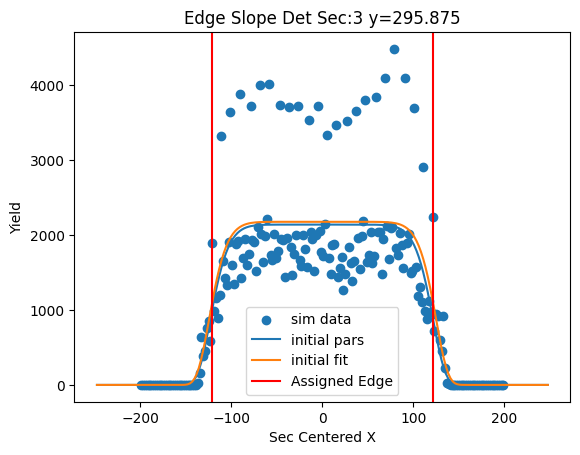

[1.76535898e+03 5.65704751e-01 8.95556214e+01 1.01522918e+01]


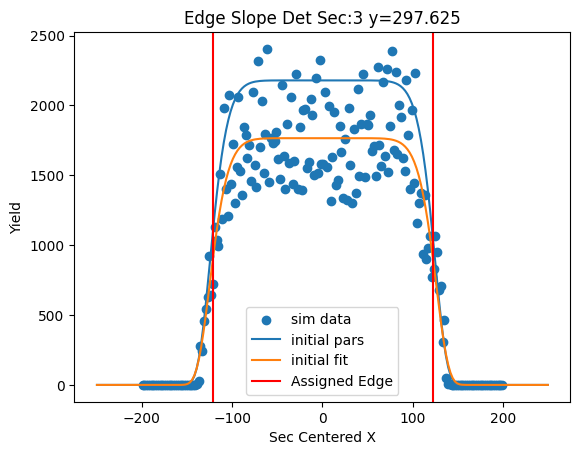

[1.87625851e+03 8.71069413e-01 9.07893670e+01 1.09644398e+01]


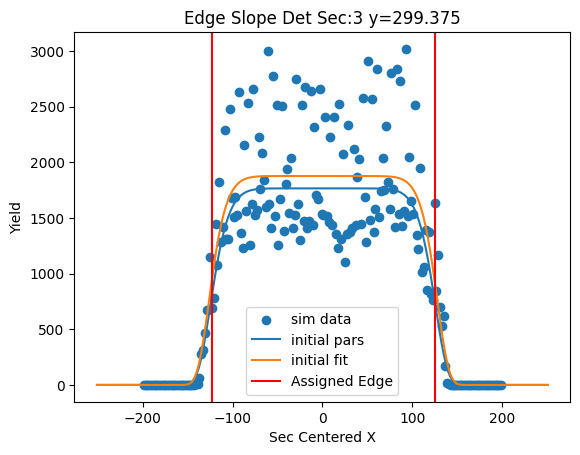

[2.06043378e+03 9.97918245e-01 9.17050654e+01 1.11485023e+01]


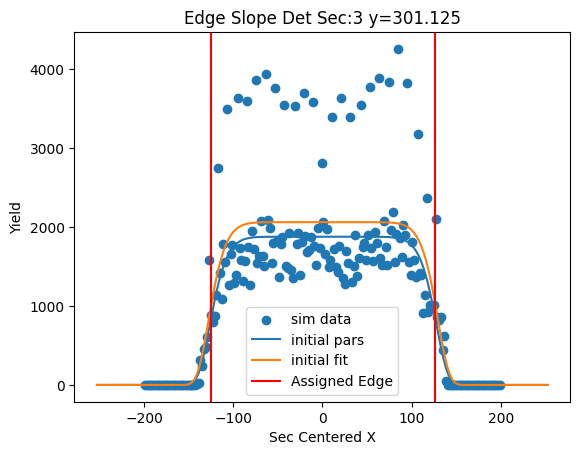

[1.76277149e+03 6.86596978e-01 9.22038247e+01 1.11207911e+01]


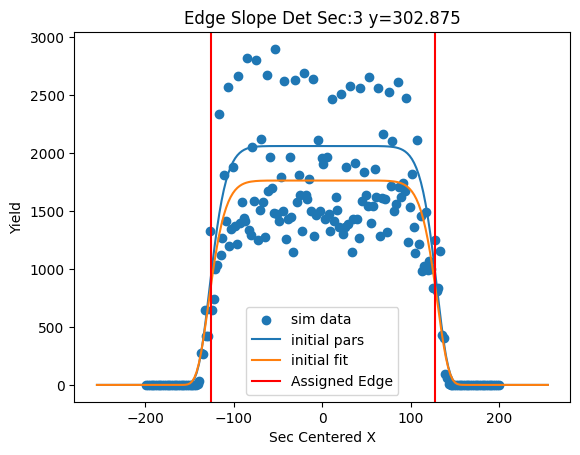

[1.44755042e+03 6.78521854e-02 9.23699474e+01 1.11926162e+01]


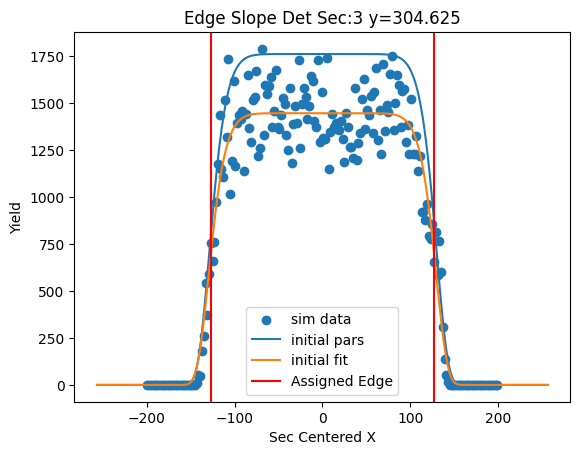

[1.84822800e+03 3.46178089e-01 9.23697195e+01 1.13130502e+01]


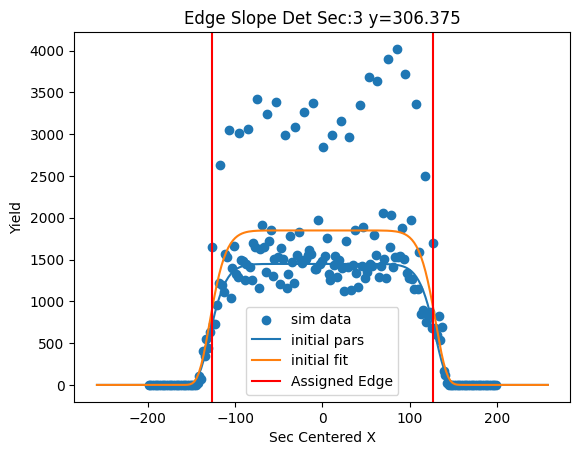

[ 1.85849046e+03 -3.97203326e-02  9.21113415e+01  1.08545960e+01]


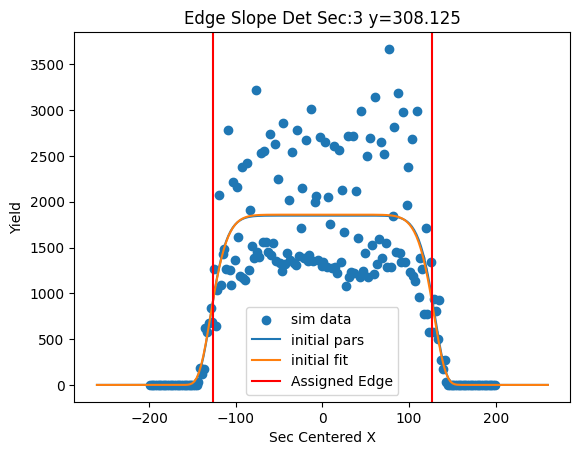

[ 1.80768493e+03 -2.23757638e-01  9.26727340e+01  1.11886816e+01]


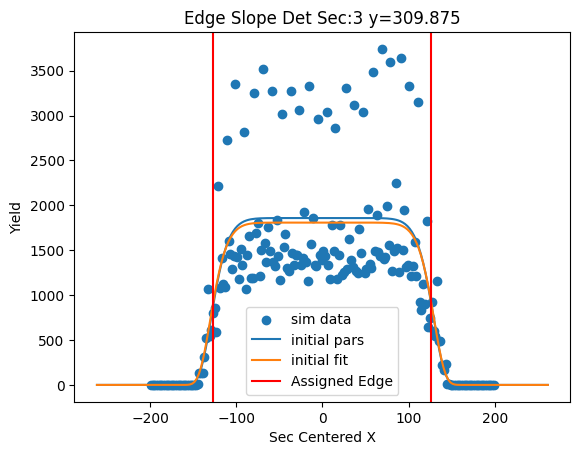

[ 1.34059141e+03 -1.12417468e+00  9.29257143e+01  1.06708197e+01]


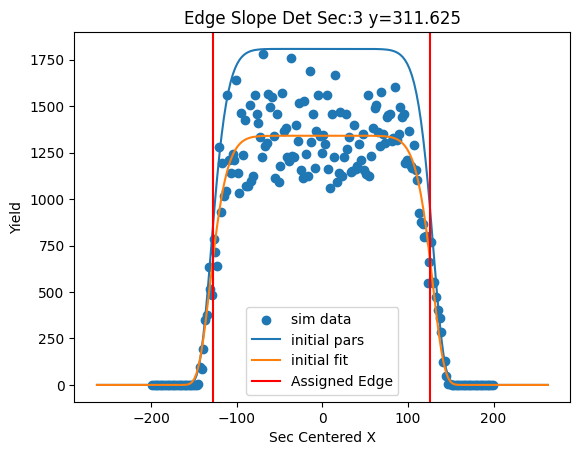

[ 1.45062057e+03 -8.97509642e-01  9.38102759e+01  1.04641279e+01]


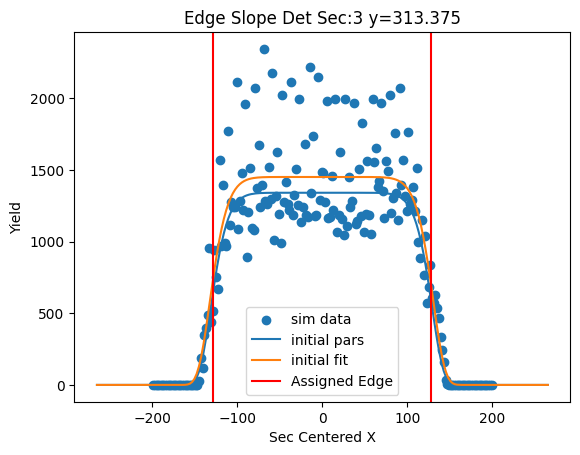

[1.68970241e+03 2.88643250e-01 9.52497075e+01 1.12619805e+01]


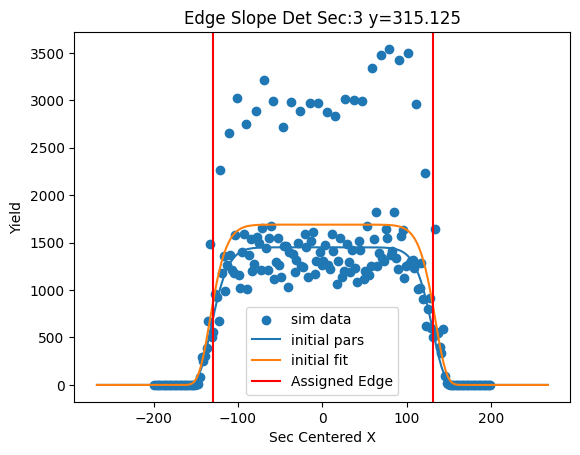

[1.49560006e+03 1.66717855e-01 9.57828758e+01 1.09824527e+01]


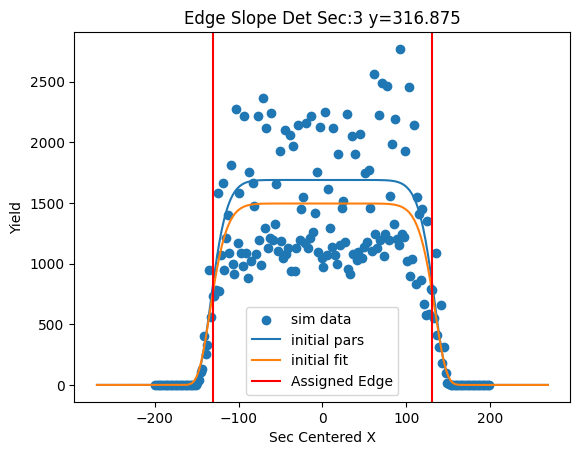

[ 1.23112615e+03 -2.93959746e-01  9.62861701e+01  1.08392464e+01]


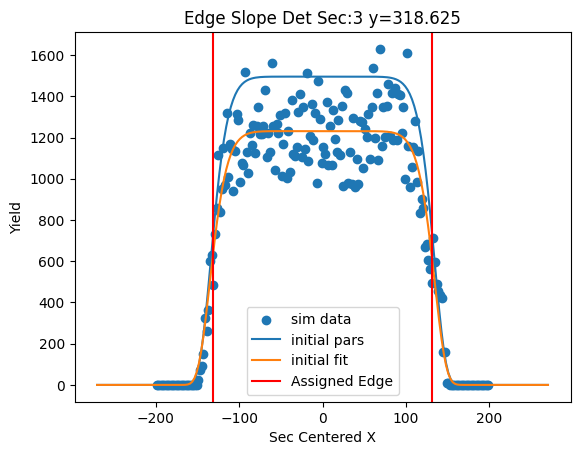

[1.48573511e+03 5.13595984e-01 9.72526746e+01 1.14842470e+01]


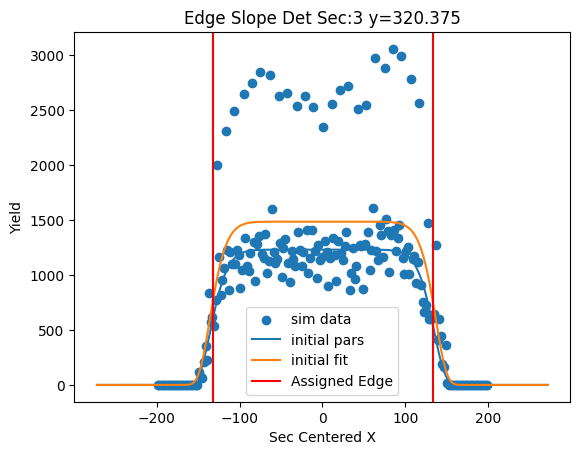

[ 1.41677804e+03 -5.99600581e-01  9.82774136e+01  1.14912380e+01]


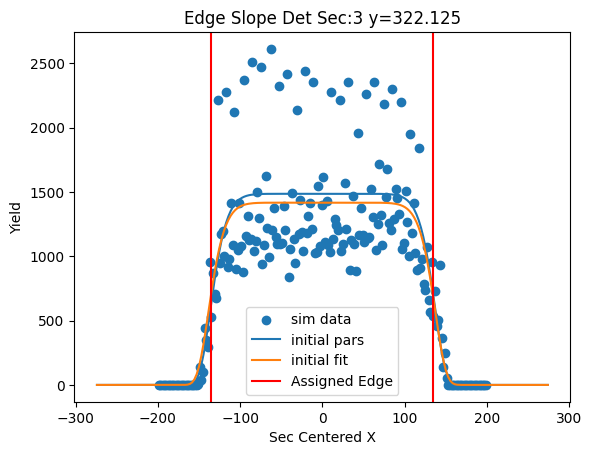

[1.45545321e+03 5.70230615e-01 9.89595108e+01 1.26948926e+01]


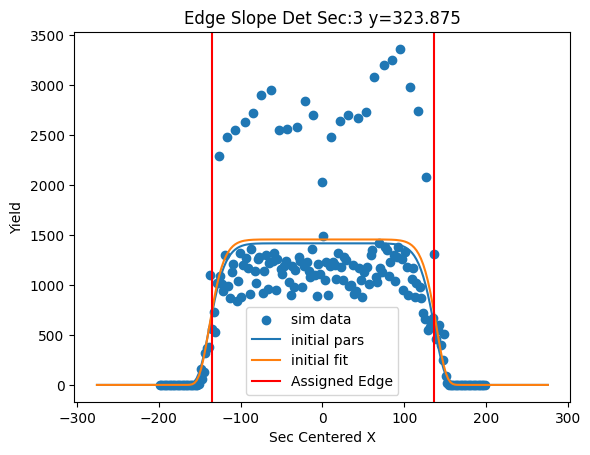

[ 1.14726790e+03 -4.68276003e-01  9.83565881e+01  1.11485994e+01]


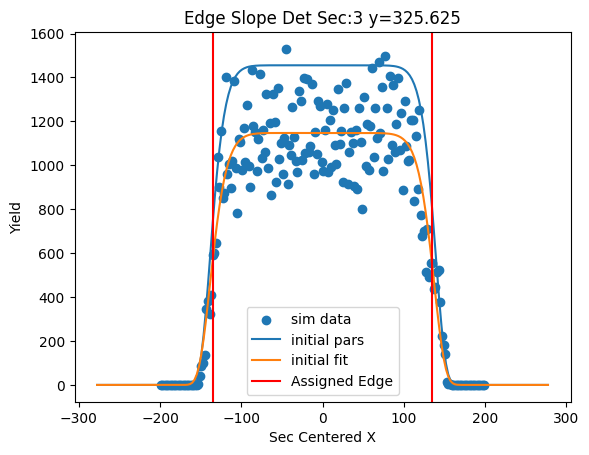

[1.33151248e+03 2.75373363e-01 9.85051309e+01 1.16786900e+01]


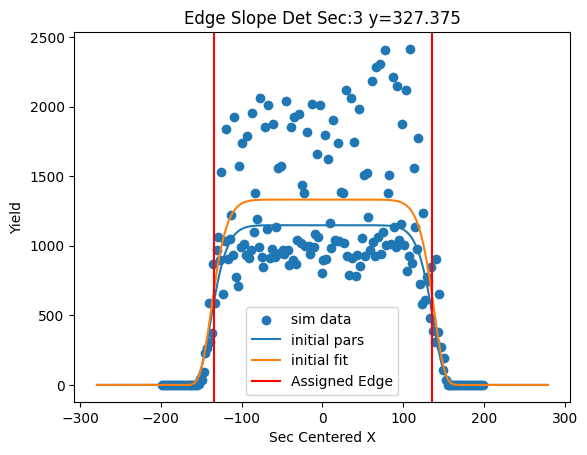

[1.42452361e+03 2.45149826e-01 9.92760035e+01 1.19903982e+01]


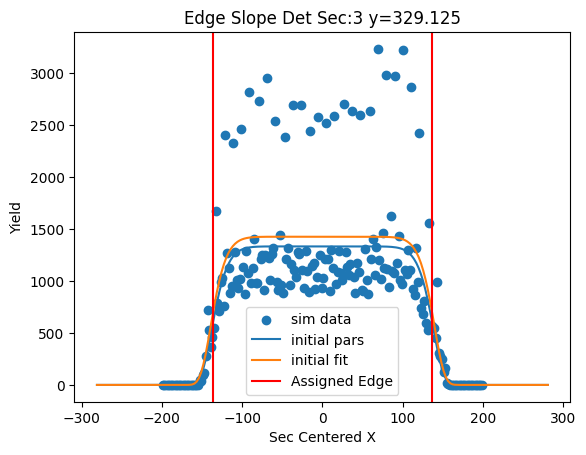

[8.66030149e+04 6.62791160e-01 1.65738442e+01 1.87603428e+01]


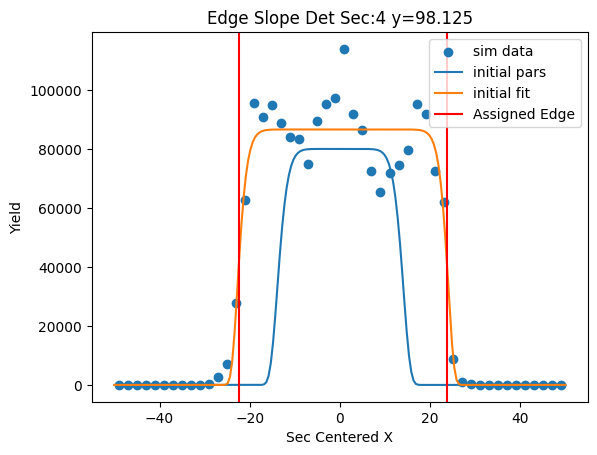

[8.73697215e+04 8.16171136e-01 1.73165312e+01 1.42440175e+01]


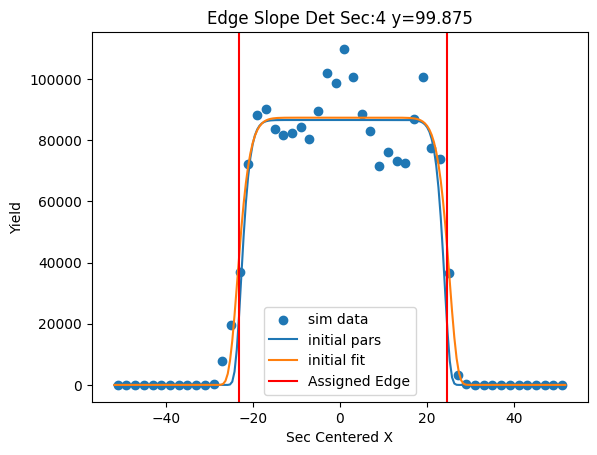

[8.68453542e+04 7.76858683e-01 1.83105919e+01 1.12071592e+01]


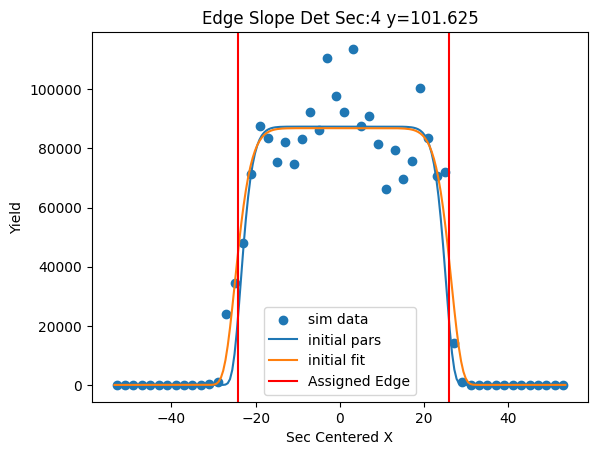

[8.33398460e+04 3.84293672e-01 1.92955186e+01 1.07857312e+01]


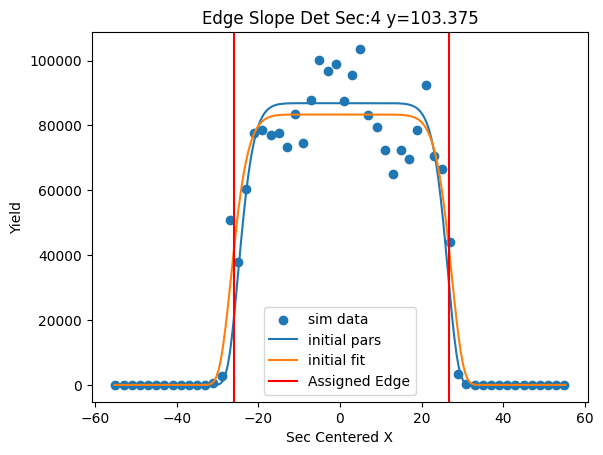

[7.61164690e+04 2.69527356e-01 1.97199437e+01 1.28919867e+01]


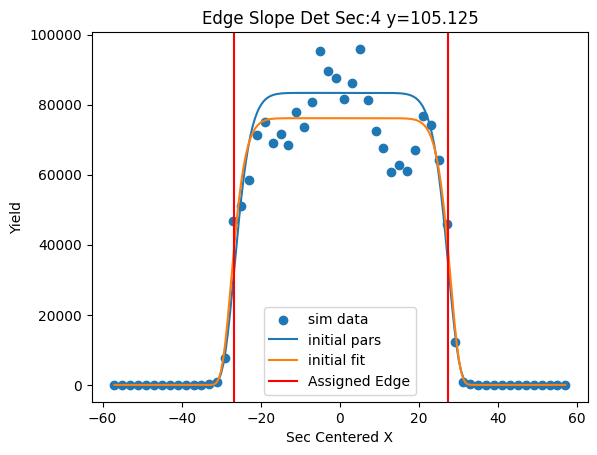

[7.13490285e+04 2.40814517e-01 2.02607815e+01 1.39916086e+01]


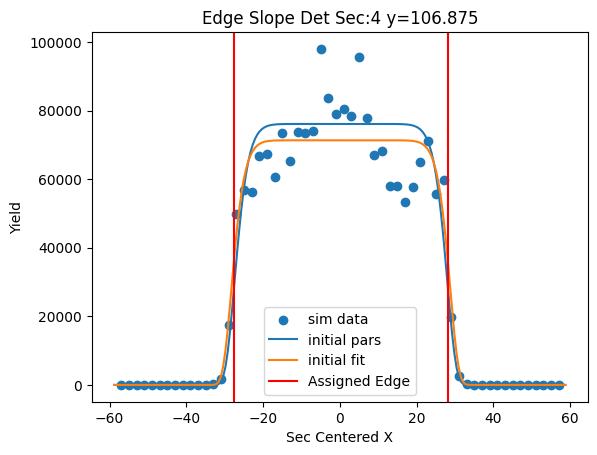

[6.84630980e+04 2.44547921e-01 2.09569375e+01 1.33140589e+01]


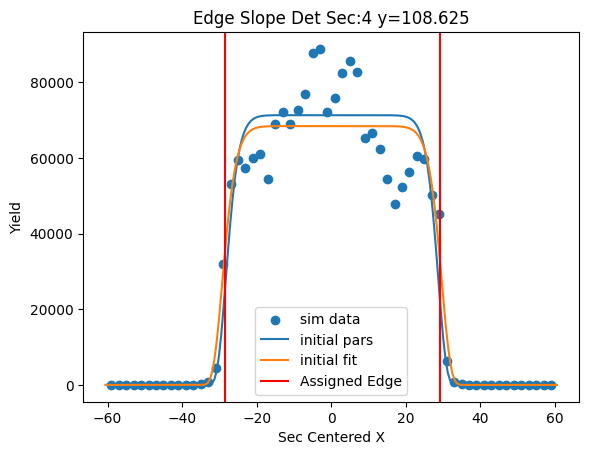

[6.51598785e+04 2.82688624e-01 2.15118011e+01 1.22290065e+01]


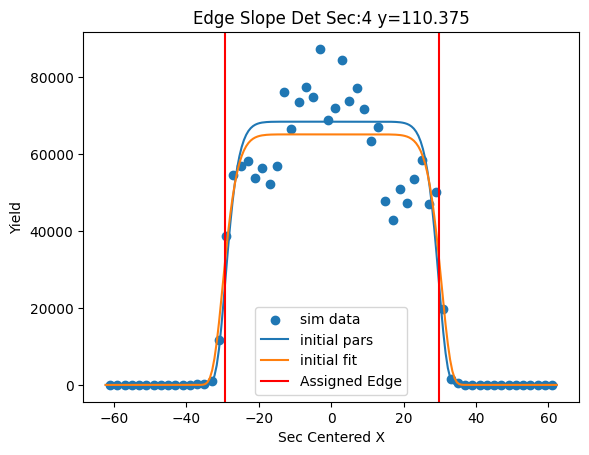

[6.09118115e+04 4.49187331e-01 2.20699115e+01 1.06087697e+01]


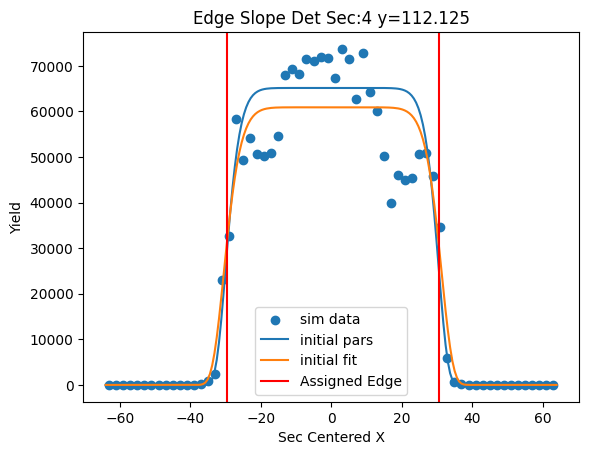

[5.84947678e+04 6.67233104e-01 2.29004033e+01 1.31895733e+01]


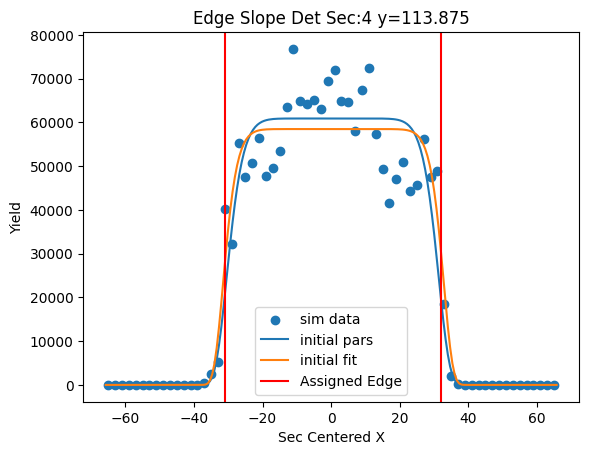

[5.72232960e+04 7.51875343e-01 2.35643376e+01 1.43880926e+01]


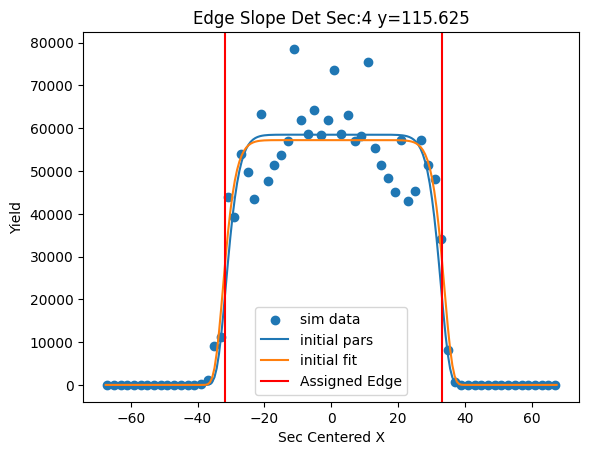

[5.58035647e+04 7.22532039e-01 2.43189765e+01 1.14258225e+01]


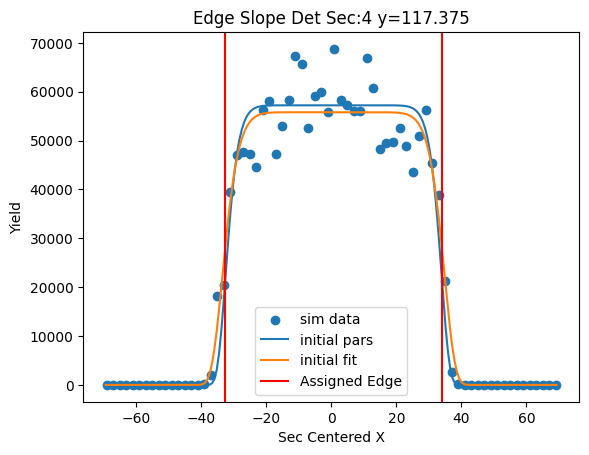

[5.36074066e+04 5.77946964e-01 2.48087335e+01 9.48527579e+00]


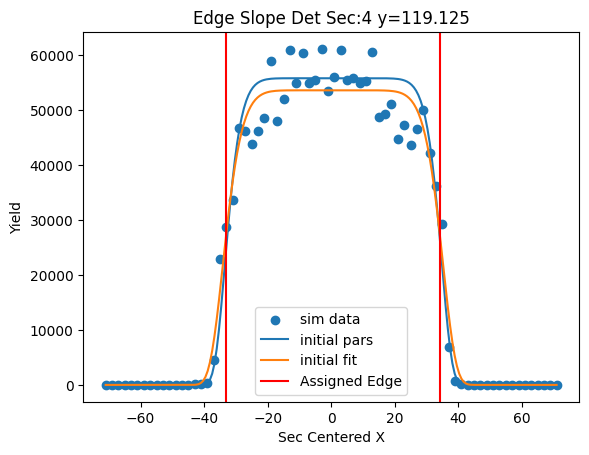

[5.15278611e+04 5.71746209e-01 2.55144854e+01 8.85189848e+00]


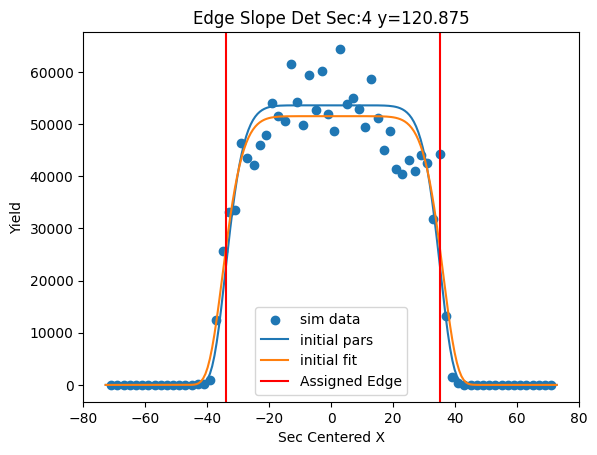

[4.79285405e+04 3.49114553e-01 2.63823290e+01 8.29459071e+00]


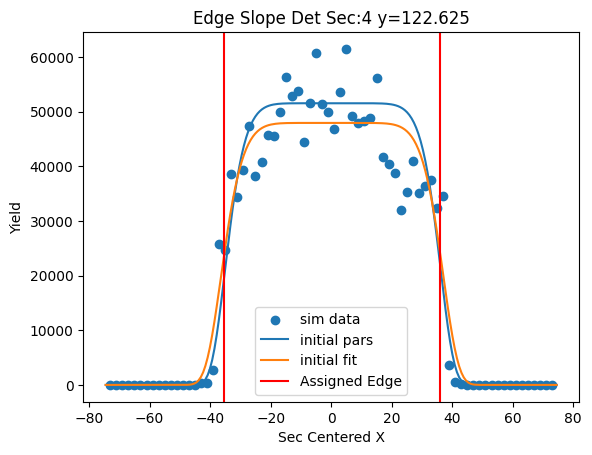

[4.41272742e+04 5.96053161e-02 2.65877037e+01 5.46129609e+00]


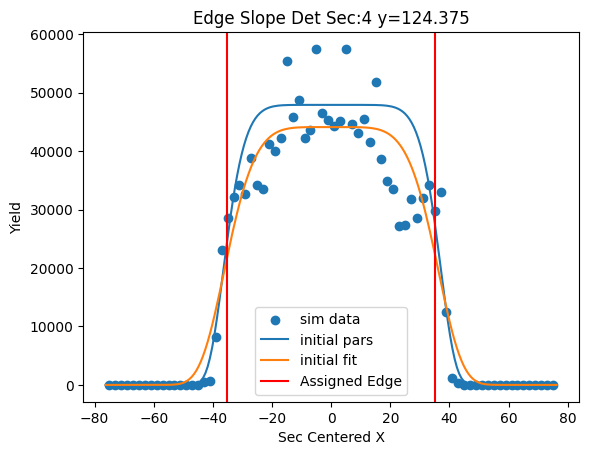

[ 4.23130525e+04 -1.75062957e-02  2.59707916e+01  3.67963340e+00]


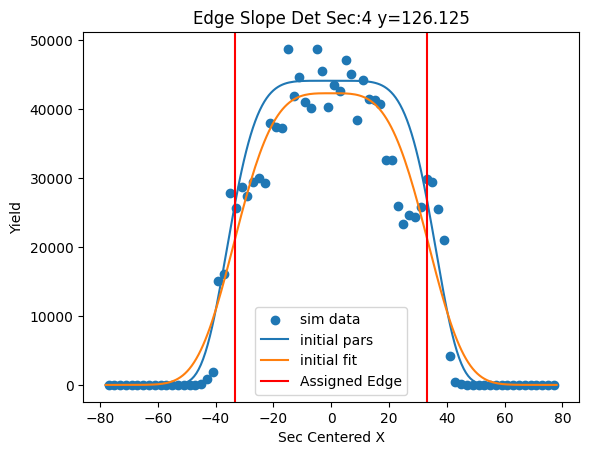

[4.24815967e+04 1.57740544e-01 2.64656741e+01 3.55138490e+00]


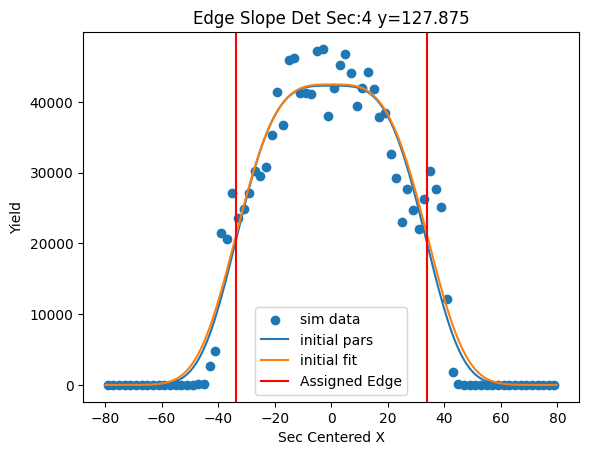

[4.07702065e+04 3.80656424e-01 2.76471470e+01 3.84025885e+00]


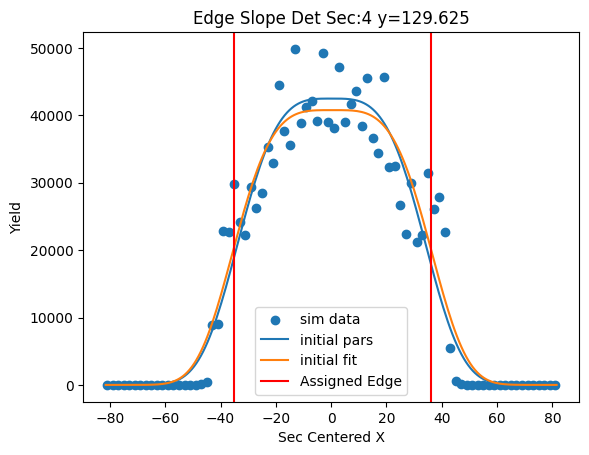

[3.71313494e+04 3.96649164e-01 2.89075631e+01 4.21823685e+00]


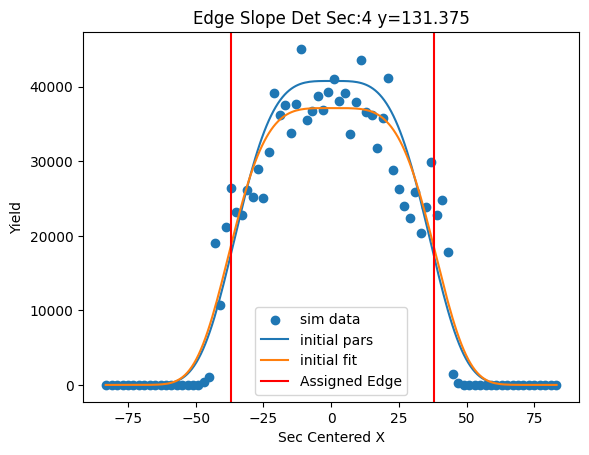

[3.28219169e+04 4.62239208e-01 2.95327697e+01 4.53413802e+00]


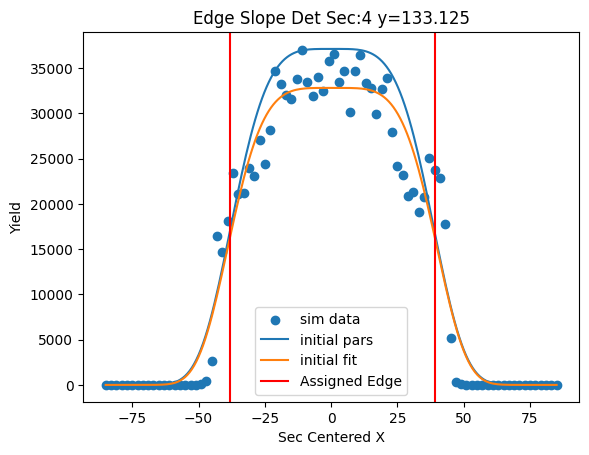

[3.28419152e+04 5.42012624e-01 2.97766976e+01 4.38436639e+00]


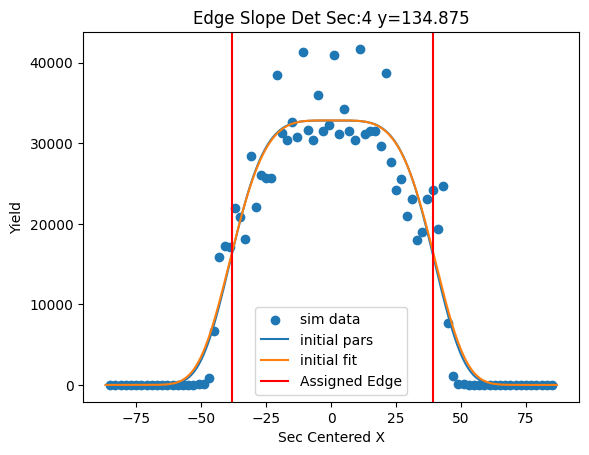

[3.27066729e+04 4.08940035e-01 2.99916687e+01 4.06334345e+00]


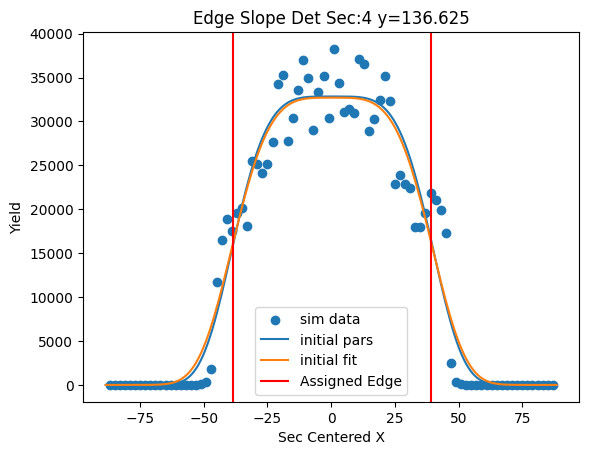

[3.12779775e+04 3.42003778e-01 2.97221515e+01 3.60671291e+00]


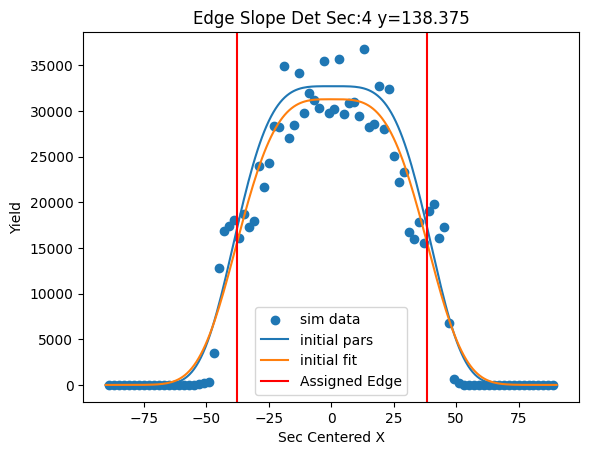

[2.93735488e+04 4.54550573e-01 2.96136617e+01 3.28270146e+00]


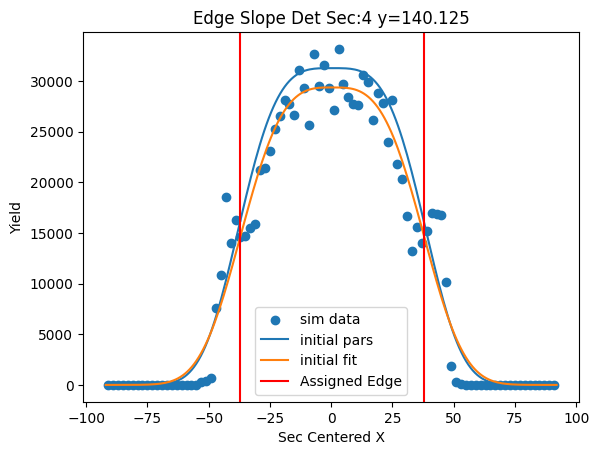

[2.85479283e+04 8.85991429e-01 3.04043853e+01 3.27586156e+00]


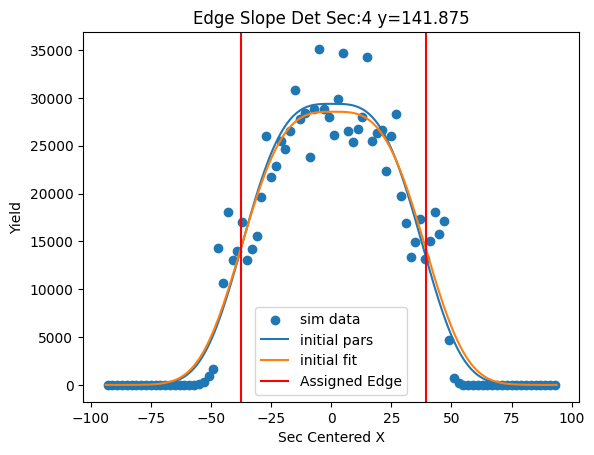

[2.69735018e+04 1.14137457e+00 3.14581555e+01 3.48080302e+00]


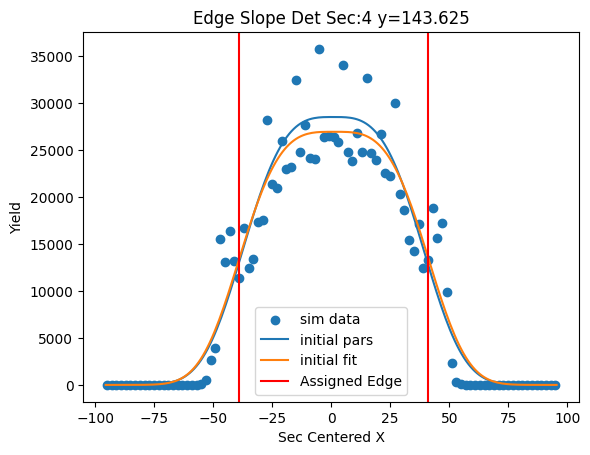

[2.53816325e+04 1.46598534e+00 3.24643939e+01 3.73724442e+00]


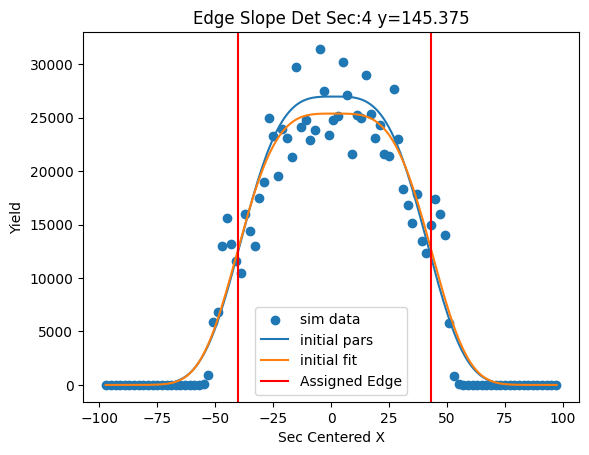

[2.41515480e+04 1.55504935e+00 3.30067786e+01 3.91419414e+00]


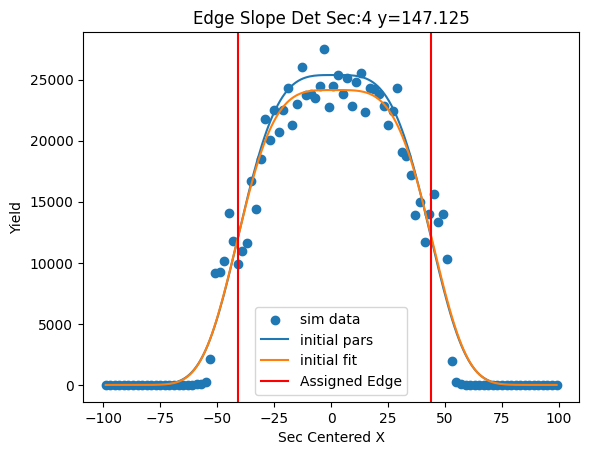

[2.45096854e+04 1.28497040e+00 3.39331652e+01 4.10182046e+00]


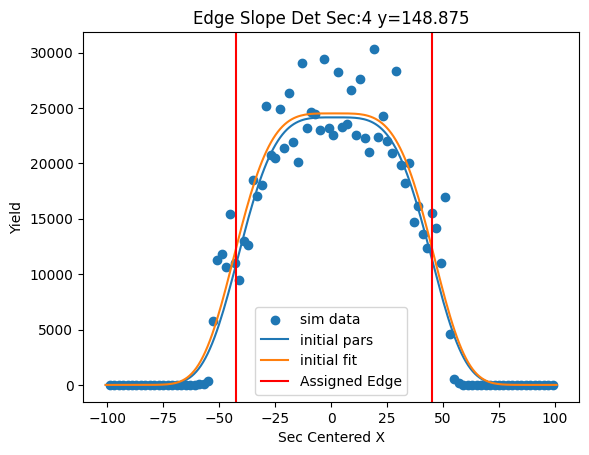

[2.34771725e+04 1.00421076e+00 3.46941309e+01 4.05180819e+00]


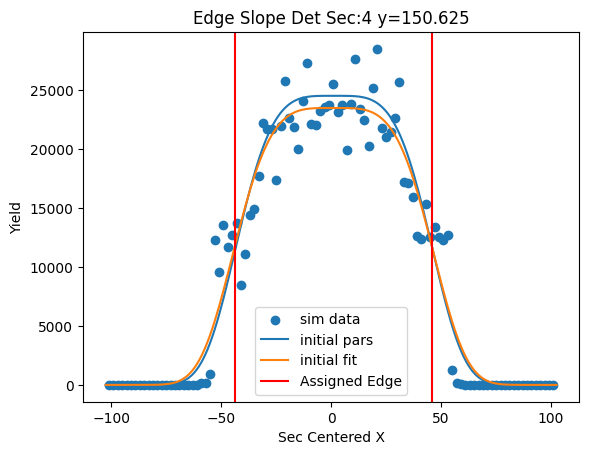

[2.12959469e+04 8.51879579e-01 3.46472491e+01 3.85297219e+00]


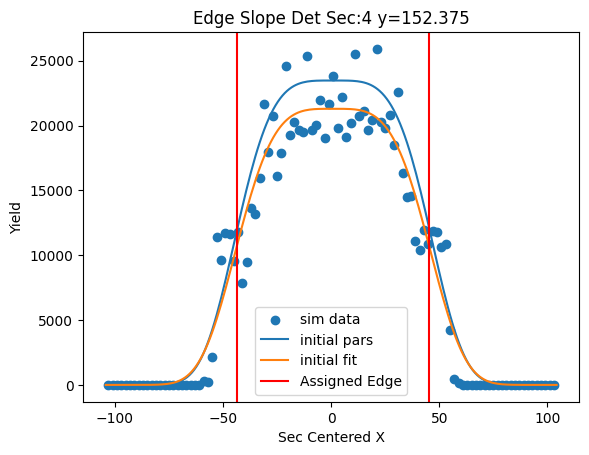

[2.04981519e+04 6.84895902e-01 3.42771577e+01 3.66213776e+00]


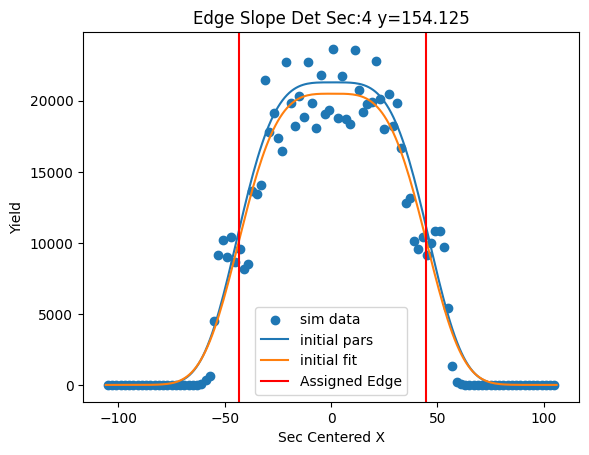

[2.10333811e+04 5.53729877e-01 3.48995774e+01 3.62017909e+00]


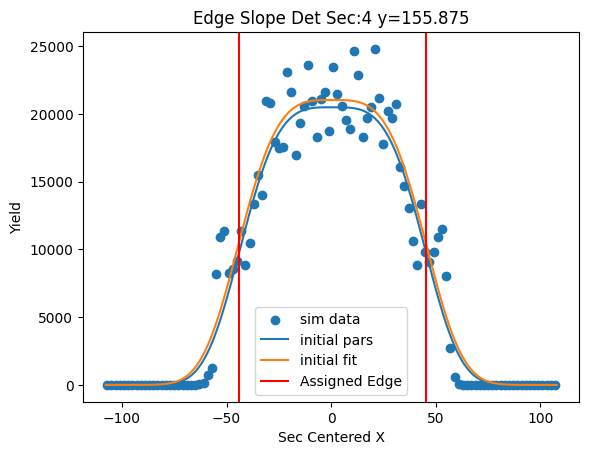

[2.04157932e+04 3.98060717e-01 3.55576822e+01 3.71393472e+00]


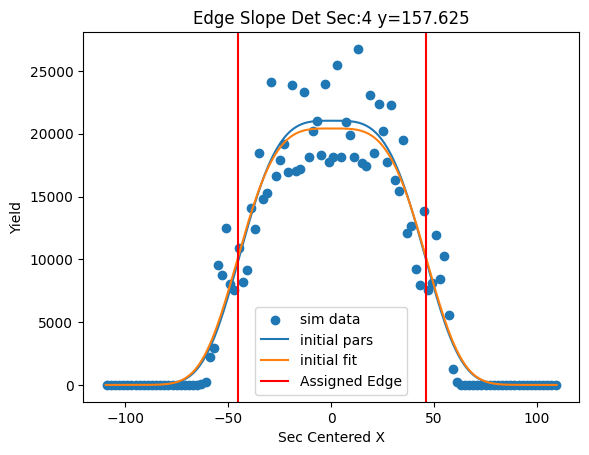

[1.90705050e+04 1.57535243e-01 3.66801687e+01 3.86316963e+00]


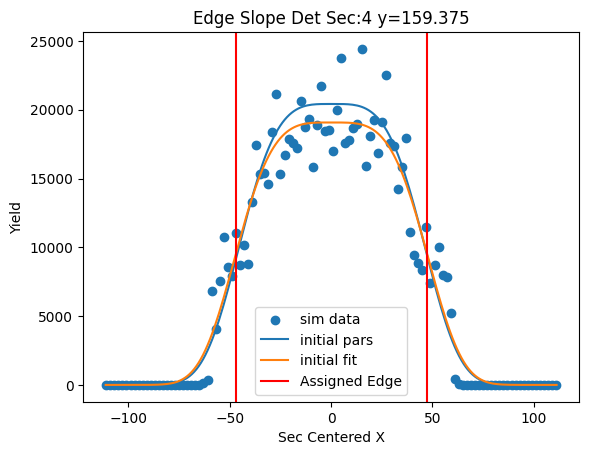

[1.69769017e+04 2.68727607e-01 3.76146927e+01 4.14474070e+00]


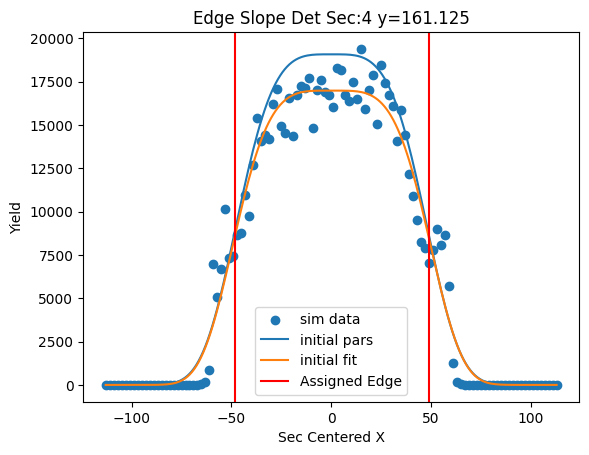

[1.71479698e+04 1.38471747e-01 3.89814312e+01 4.68599210e+00]


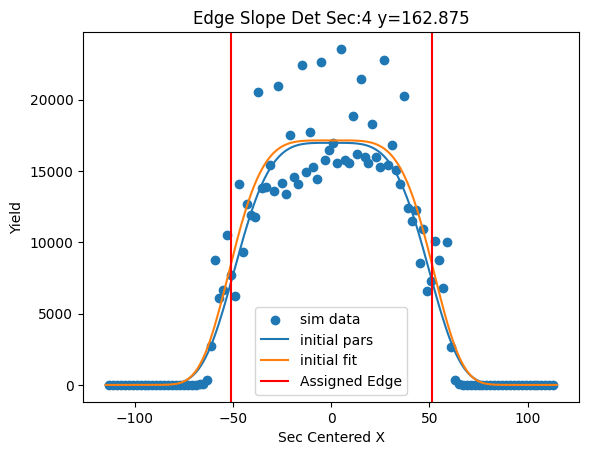

[1.66533670e+04 1.08116557e-01 3.98931402e+01 5.14323589e+00]


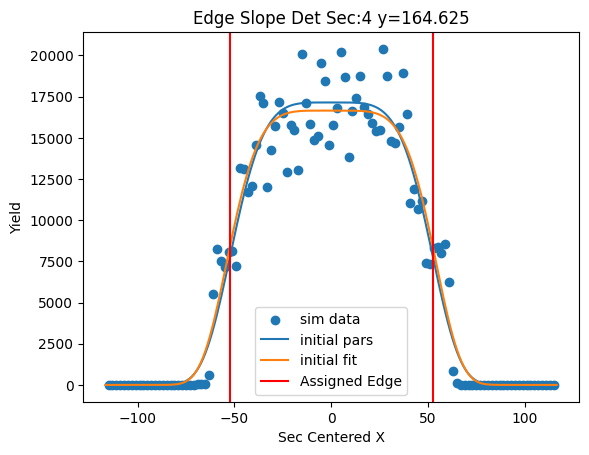

[ 1.56531551e+04 -1.31585802e-01  4.01221786e+01  5.31423126e+00]


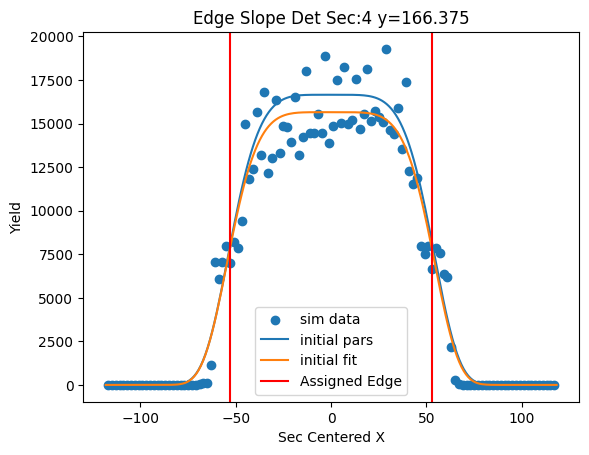

[ 1.50290968e+04 -2.50072313e-01  4.05433507e+01  5.51447478e+00]


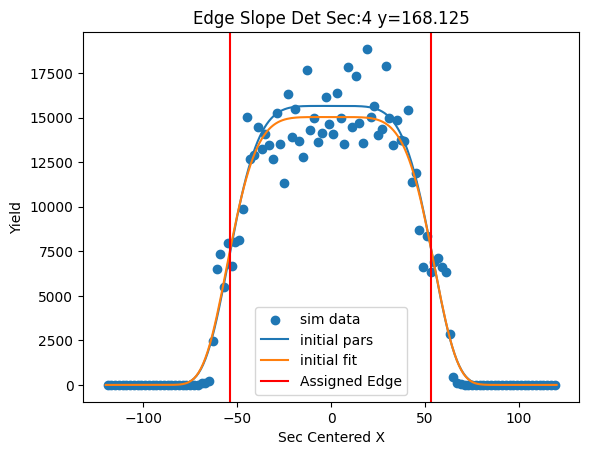

[ 1.49222370e+04 -3.93196563e-01  4.14217767e+01  5.88288485e+00]


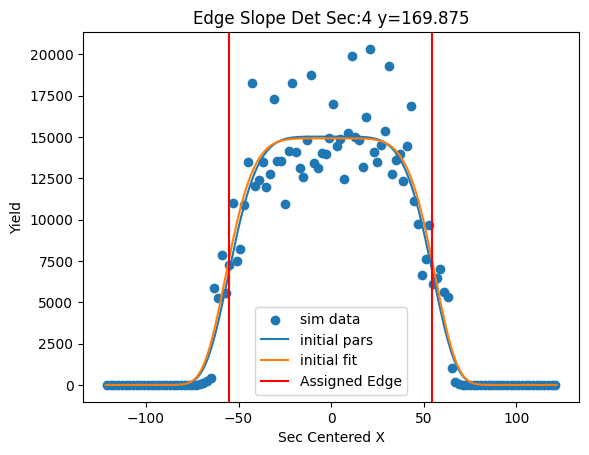

[ 1.40992345e+04 -4.32417002e-01  4.21314153e+01  6.22915566e+00]


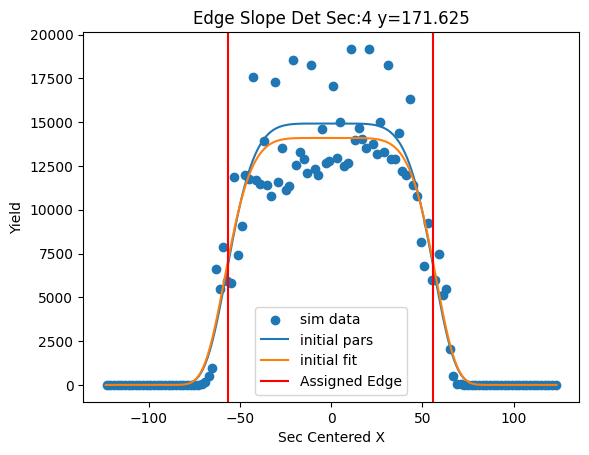

[ 1.32795196e+04 -9.16412362e-02  4.29404057e+01  6.72249055e+00]


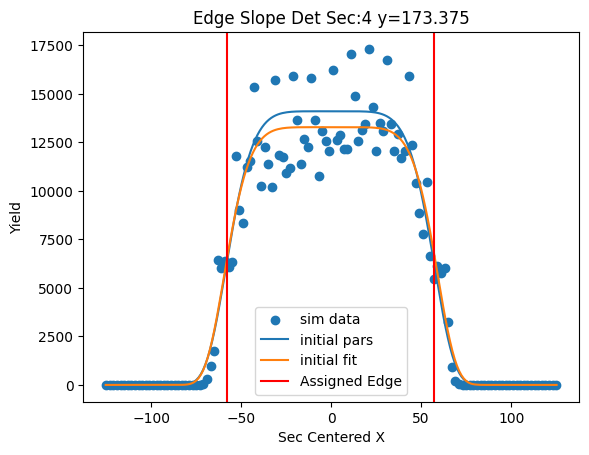

[ 1.24007025e+04 -9.85553090e-02  4.33150714e+01  7.12173337e+00]


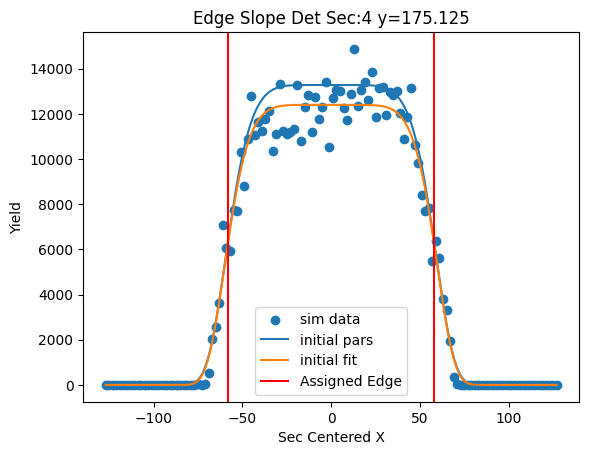

[ 1.27517592e+04 -5.68567110e-02  4.44853860e+01  7.81976370e+00]


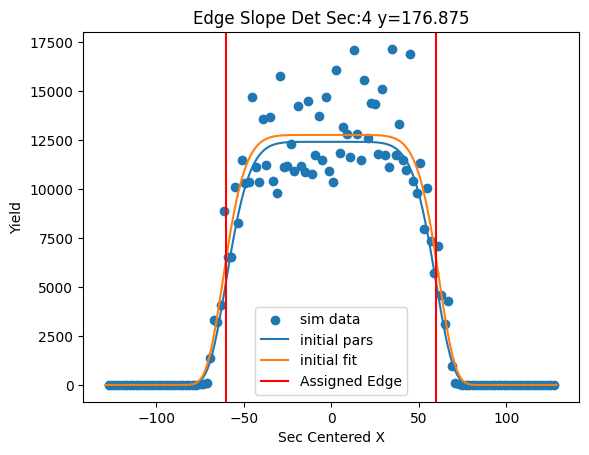

[ 1.22339821e+04 -4.19038979e-01  4.54155867e+01  8.22207273e+00]


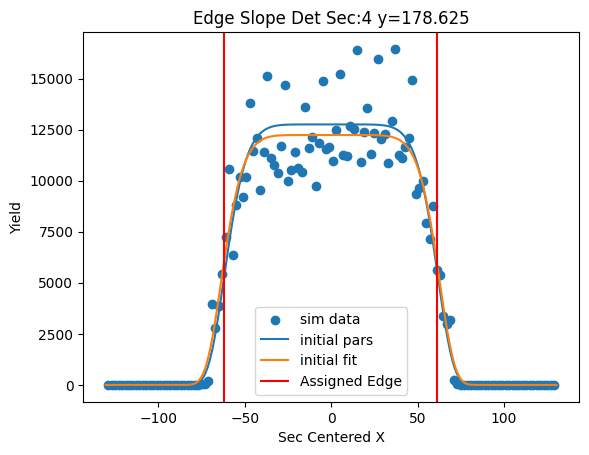

[ 1.07867624e+04 -3.62066068e-01  4.56667167e+01  8.33593204e+00]


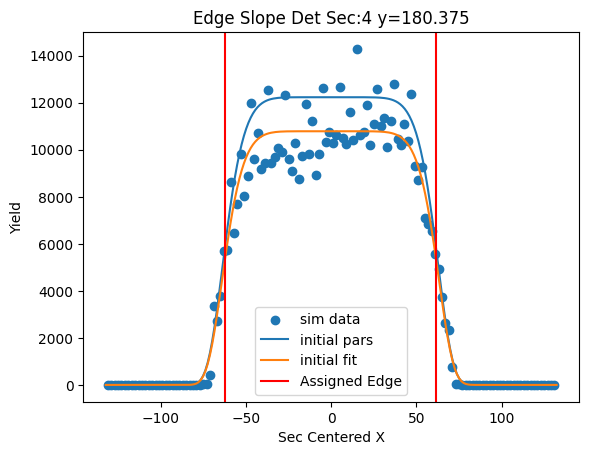

[ 1.04806172e+04 -2.07372708e-01  4.60150993e+01  8.44350661e+00]


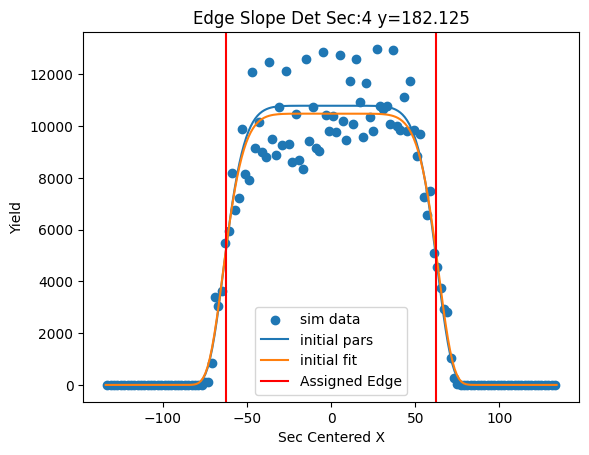

[1.09734629e+04 5.05658899e-02 4.68889791e+01 8.17735306e+00]


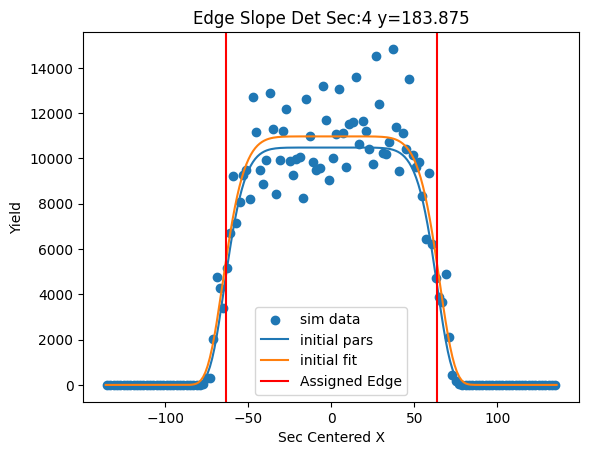

[1.05719684e+04 2.42896243e-01 4.75774393e+01 8.22931247e+00]


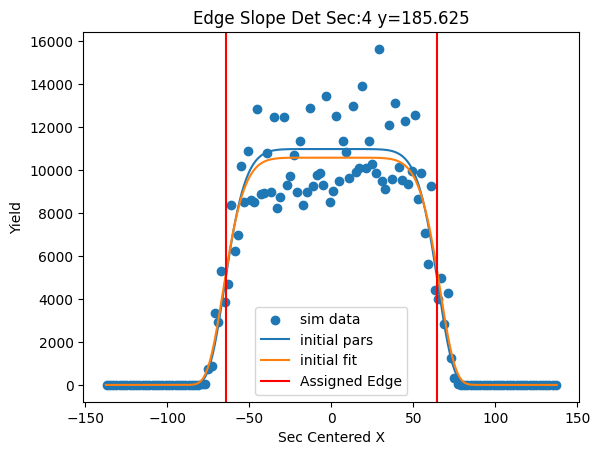

[9.50882959e+03 2.04975053e-01 4.80215393e+01 8.10902715e+00]


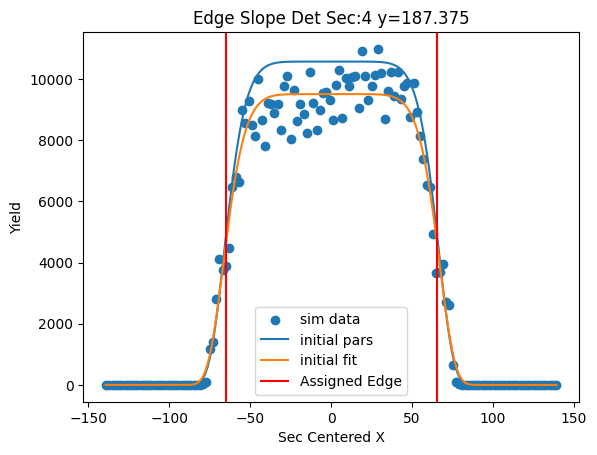

[9.61806912e+03 3.18433321e-01 4.95511036e+01 8.03239688e+00]


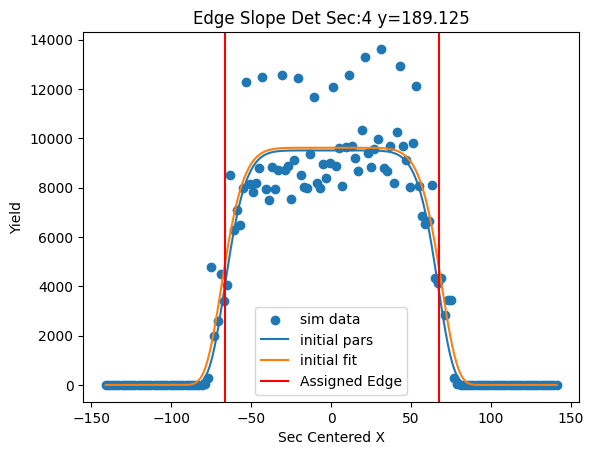

[9.41401643e+03 3.83900643e-01 5.08704801e+01 8.54117896e+00]


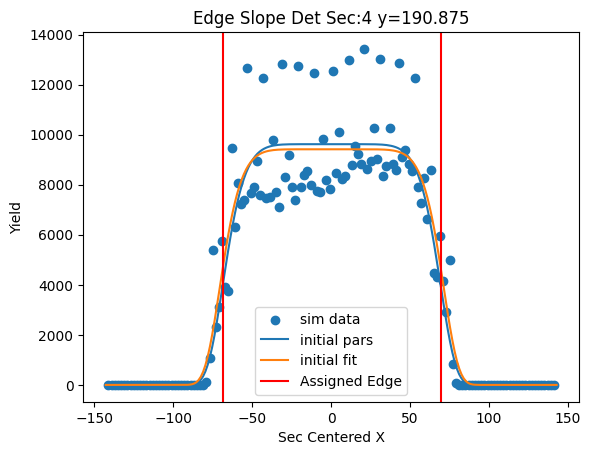

[9.16397615e+03 4.79454651e-01 5.21476484e+01 9.23304220e+00]


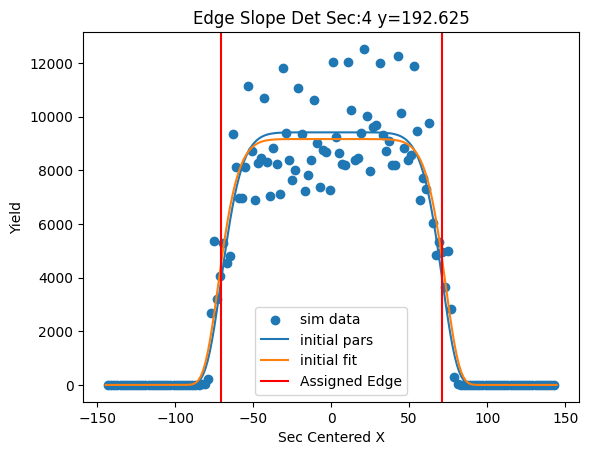

[8.44059325e+03 3.43266459e-01 5.25315976e+01 9.64424770e+00]


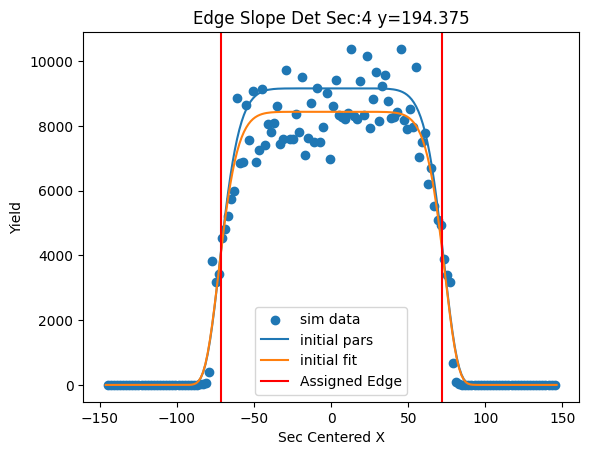

[8.44880466e+03 1.64241540e-01 5.30656347e+01 9.87742753e+00]


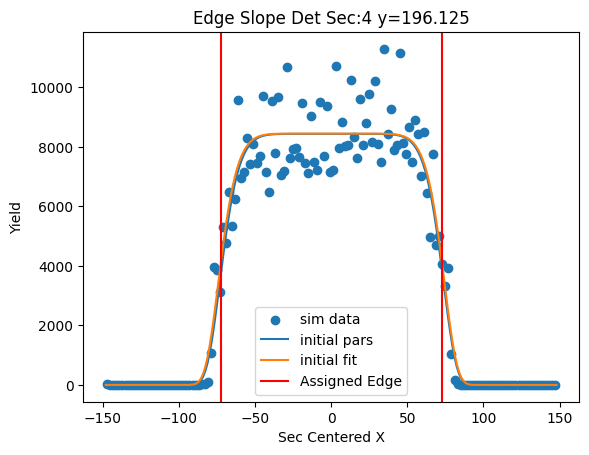

[ 8.61174361e+03 -2.28215278e-01  5.39387090e+01  1.02822171e+01]


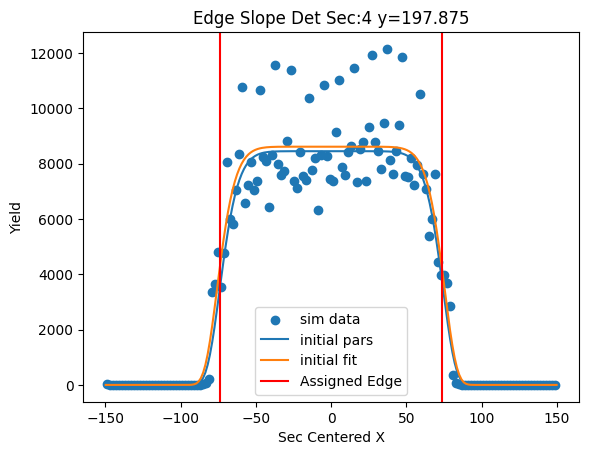

[ 8.04834294e+03 -1.18432625e-01  5.43587506e+01  9.59842860e+00]


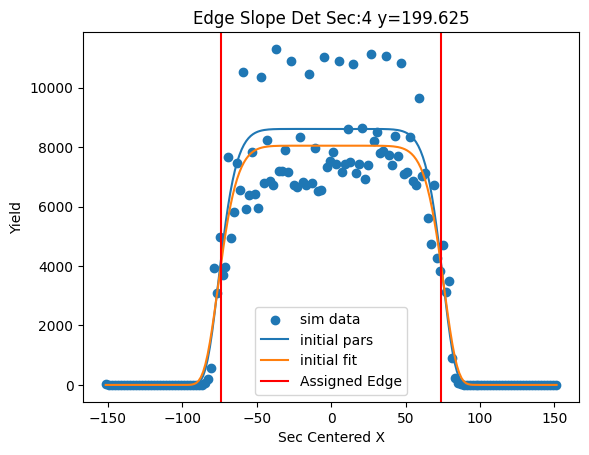

[ 7.27414964e+03 -2.69479823e-01  5.44963925e+01  9.20525425e+00]


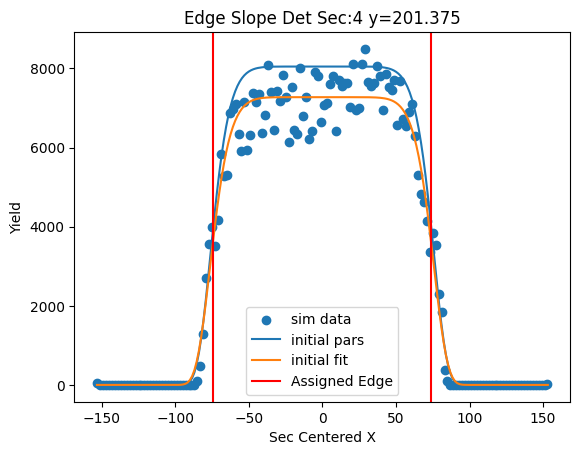

[ 7.80620972e+03 -8.95659870e-02  5.55968105e+01  9.49787764e+00]


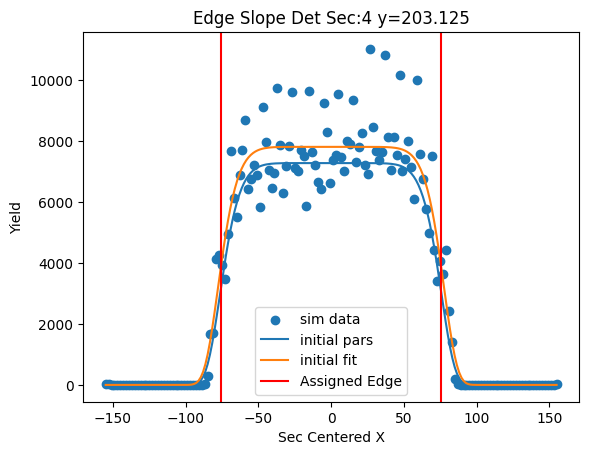

[ 7.75688865e+03 -5.97477028e-02  5.66419466e+01  9.90631342e+00]


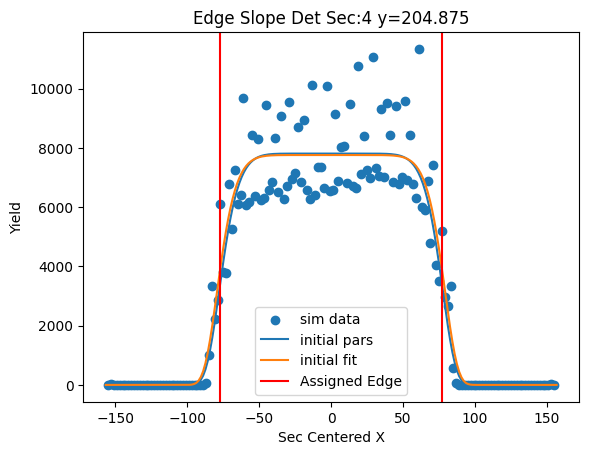

[ 7.39897998e+03 -3.06209254e-01  5.78121455e+01  1.01985066e+01]


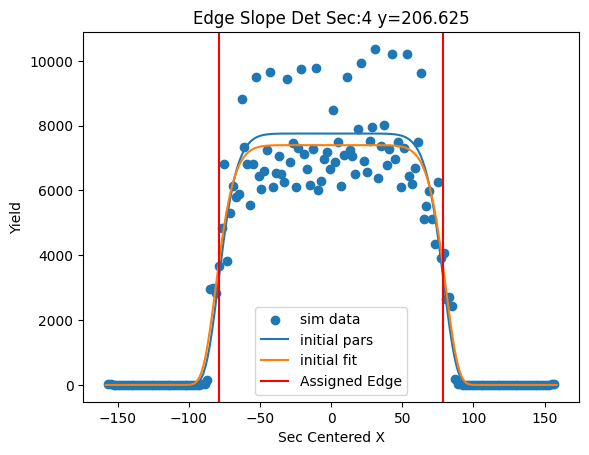

[ 6.42196611e+03 -3.23468042e-01  5.84335701e+01  1.10616947e+01]


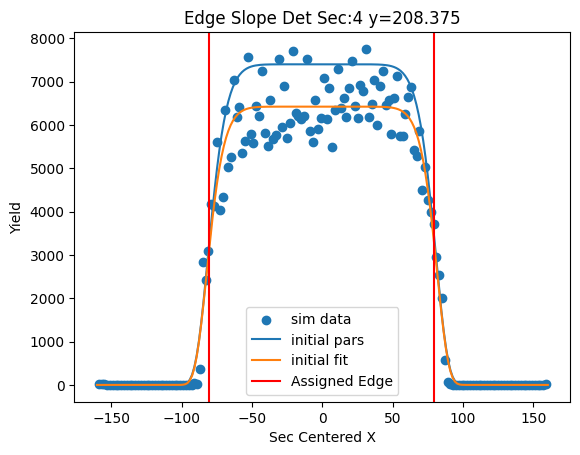

[ 6.52516067e+03 -5.48076664e-02  5.92872951e+01  1.21553576e+01]


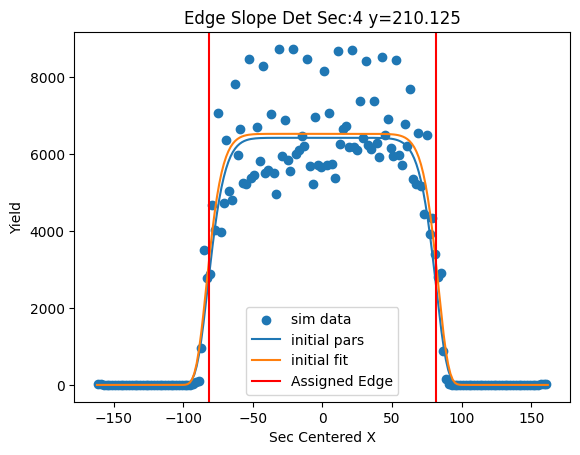

[6.74495002e+03 3.67399541e-02 6.03761509e+01 1.32895984e+01]


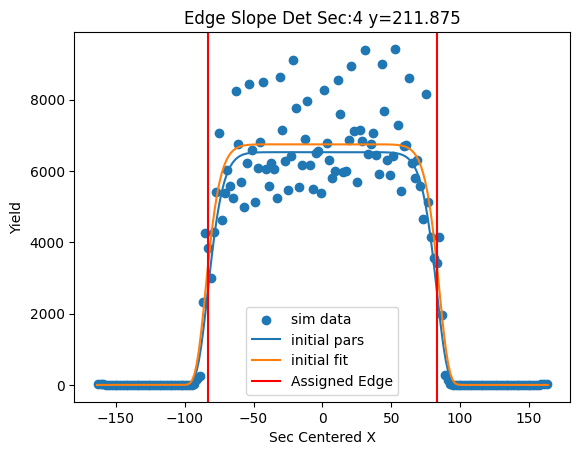

[6.27963541e+03 9.35540682e-02 6.09265925e+01 1.36807568e+01]


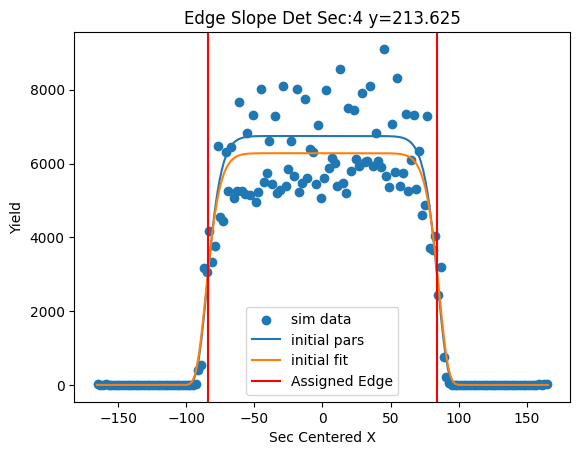

[ 5.62578970e+03 -1.71065813e-01  6.14639202e+01  1.30412719e+01]


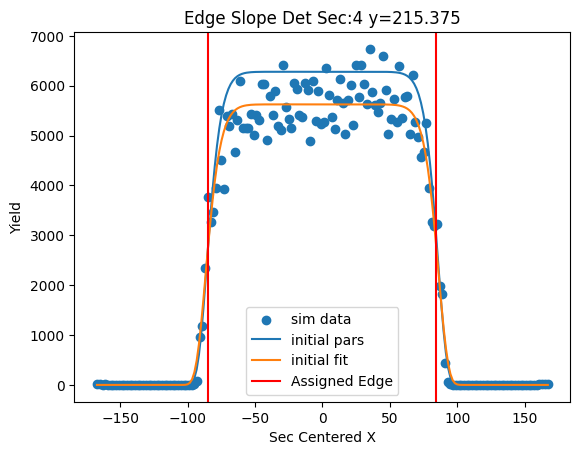

[ 5.86146376e+03 -2.72983186e-01  6.25950640e+01  1.30069901e+01]


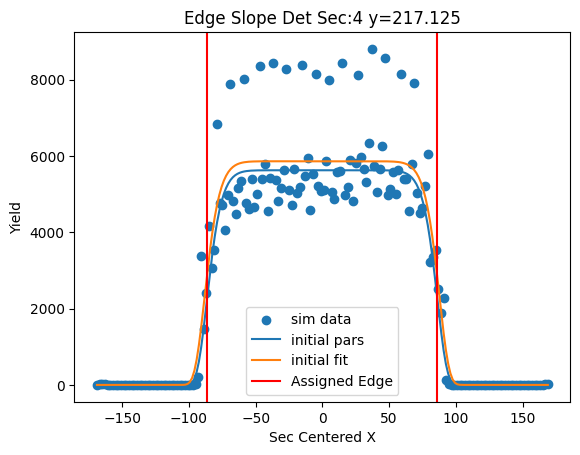

[ 5.72343465e+03 -3.81985818e-01  6.36576569e+01  1.29131339e+01]


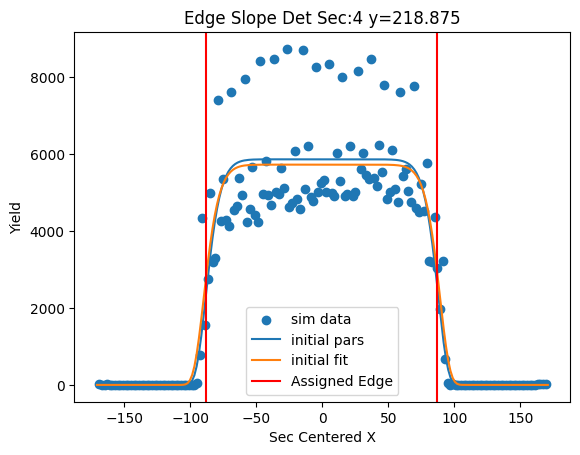

[ 5.52515474e+03 -8.26575802e-02  6.44455313e+01  1.17367006e+01]


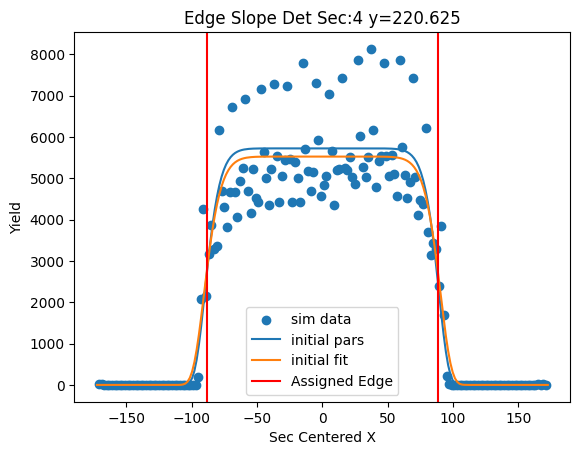

[ 5.00358805e+03 -2.13291697e-01  6.46481909e+01  1.08133503e+01]


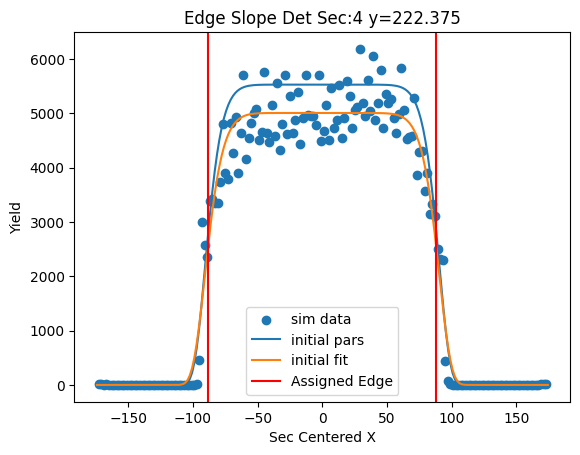

[ 5.18310839e+03 -3.00235562e-01  6.56189809e+01  1.10682394e+01]


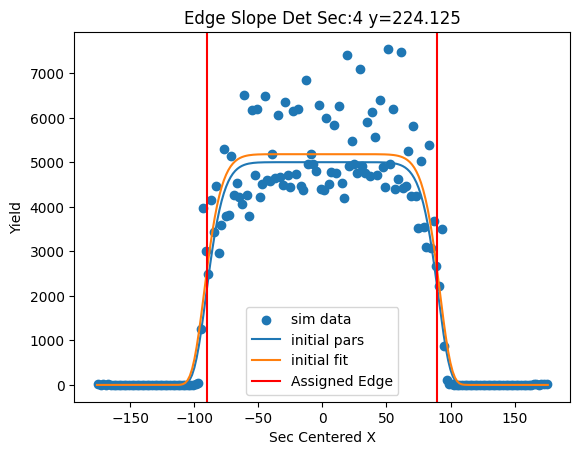

[ 5.25862435e+03 -7.54501318e-01  6.64197472e+01  1.06163101e+01]


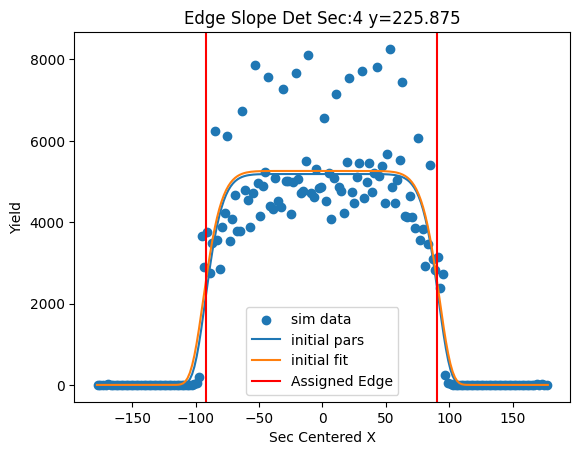

[ 4.68384040e+03 -8.10495376e-01  6.65946764e+01  9.42396119e+00]


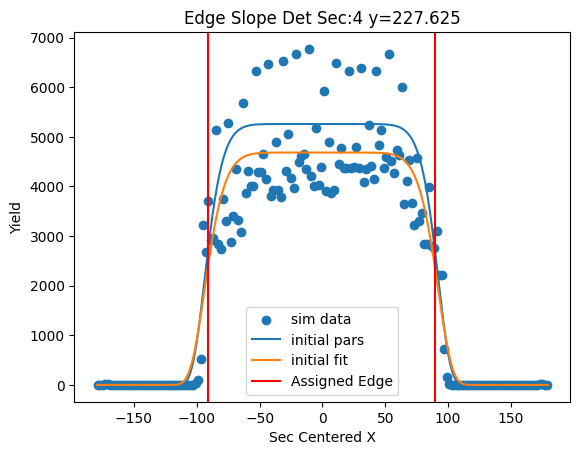

[ 4.34195027e+03 -8.47854626e-01  6.63365250e+01  8.37997738e+00]


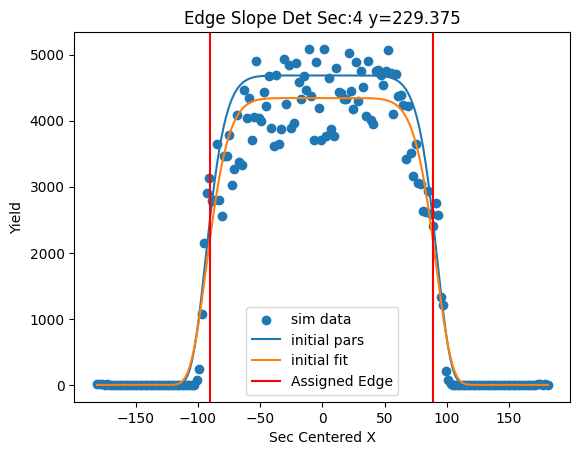

[ 4.83068399e+03 -4.67186622e-01  6.65680949e+01  8.01969535e+00]


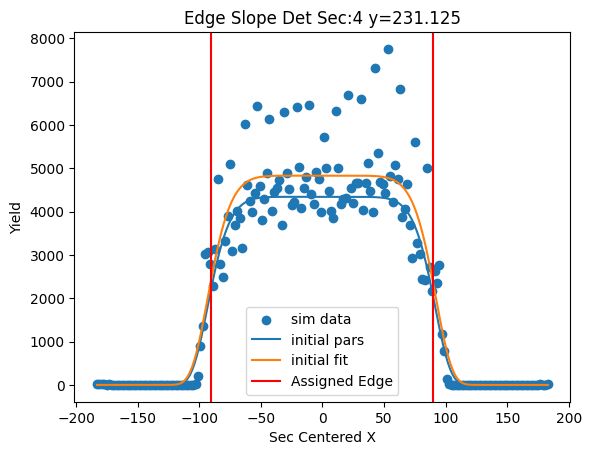

[ 4.72730233e+03 -3.60383283e-01  6.66655158e+01  7.37099016e+00]


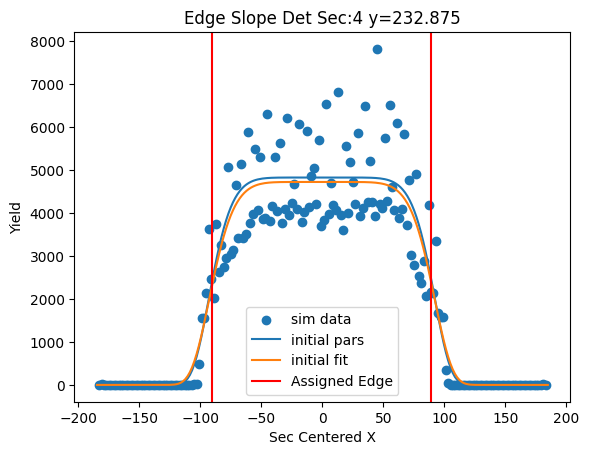

[ 4.49314113e+03 -9.24084803e-01  6.72977086e+01  7.10219363e+00]


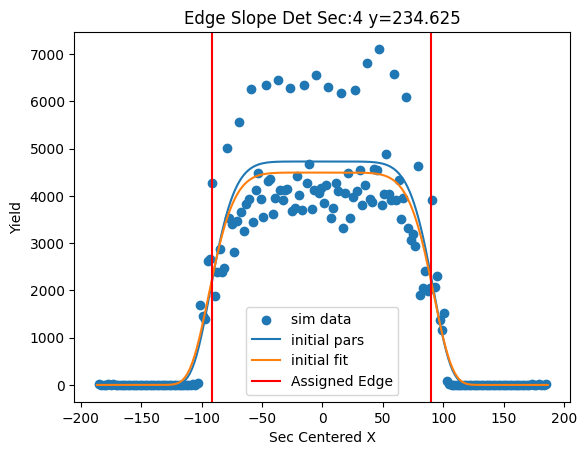

[ 3.79208146e+03 -8.92909112e-01  6.74570526e+01  7.04180262e+00]


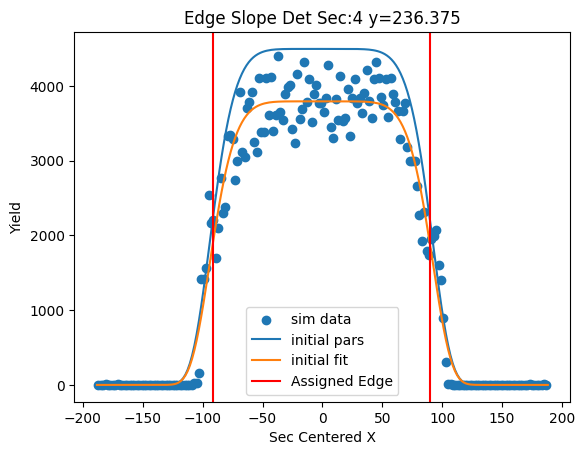

[ 3.95085972e+03 -3.41145629e-01  6.89955150e+01  7.61624247e+00]


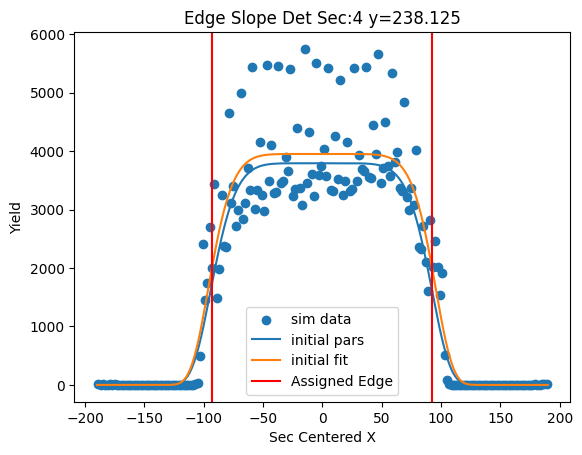

[4.07480312e+03 2.82178291e-02 7.05376170e+01 8.40470460e+00]


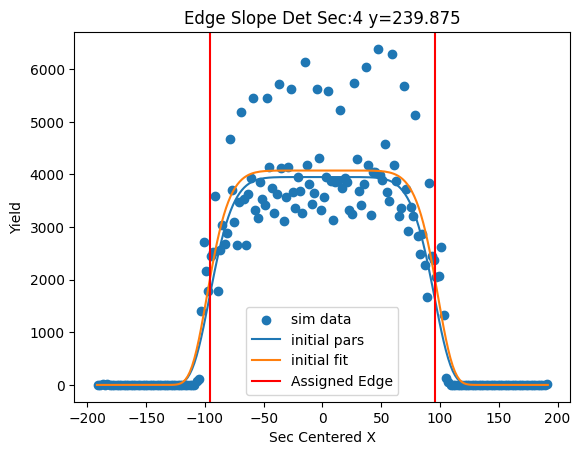

[ 3.72977632e+03 -1.42344133e-01  7.11951041e+01  9.18675589e+00]


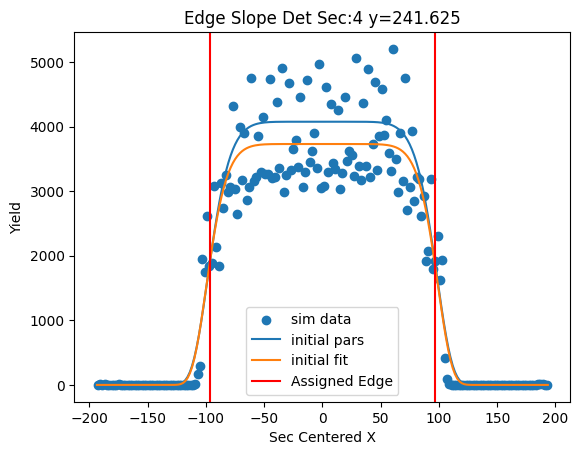

[ 3.44458338e+03 -5.23906189e-01  7.17250254e+01  9.74296860e+00]


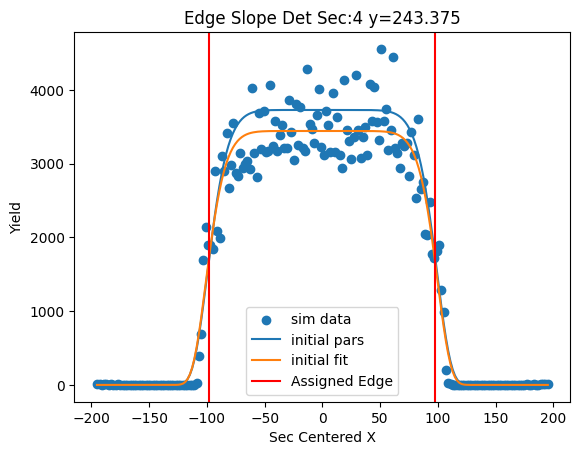

[ 3.65947385e+03 -5.12296930e-01  7.23376572e+01  1.03302644e+01]


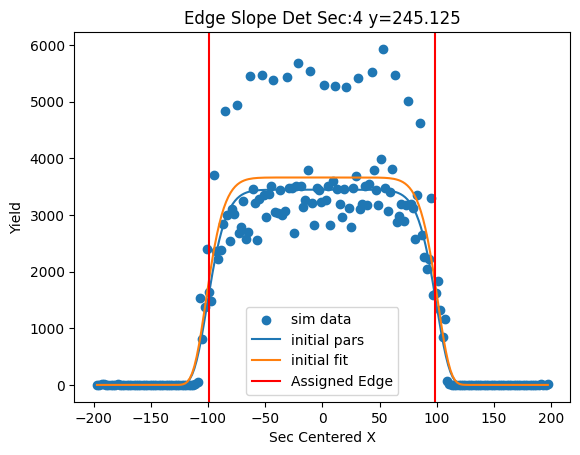

[ 3.52293082e+03 -7.13096709e-01  7.24635719e+01  9.68315009e+00]


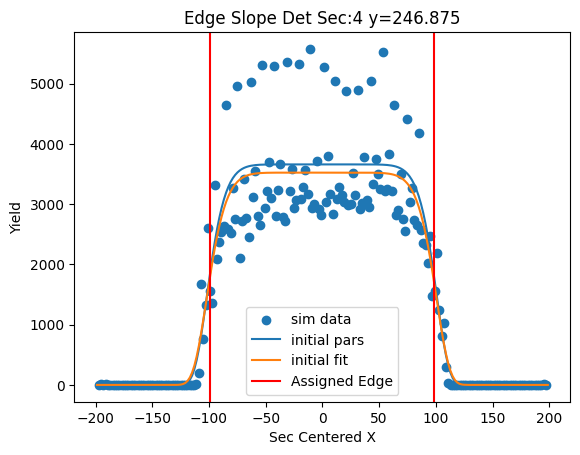

[3.39668536e+03 5.89981540e-02 7.30093335e+01 1.03320079e+01]


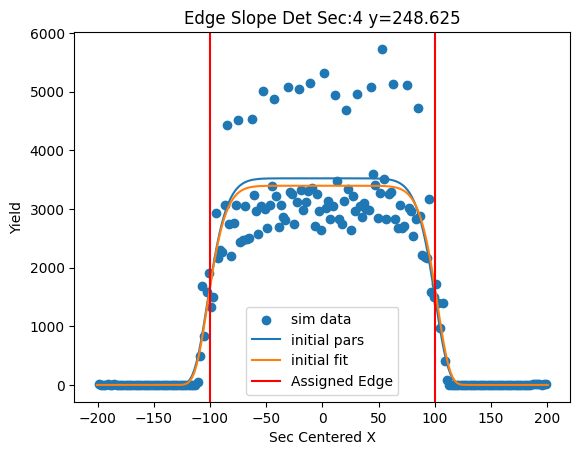

[ 2.98218355e+03 -2.26199175e-01  7.28217817e+01  1.04686043e+01]


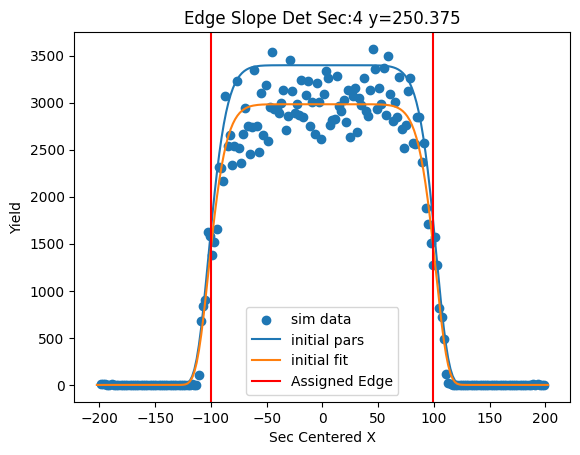

[3.24393662e+03 8.95845358e-02 7.35199275e+01 1.04845612e+01]


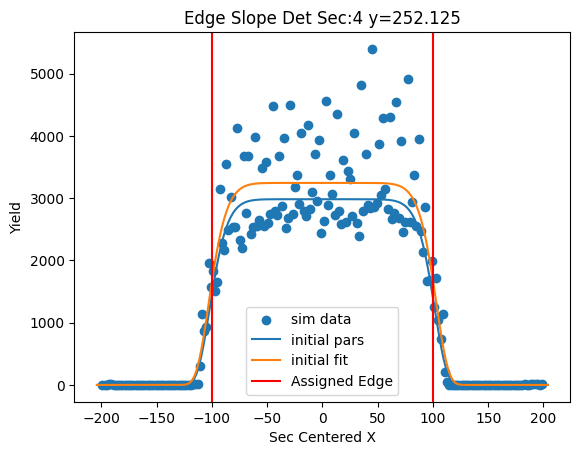

[ 3.30369817e+03 -9.17542075e-02  7.43627616e+01  9.97923071e+00]


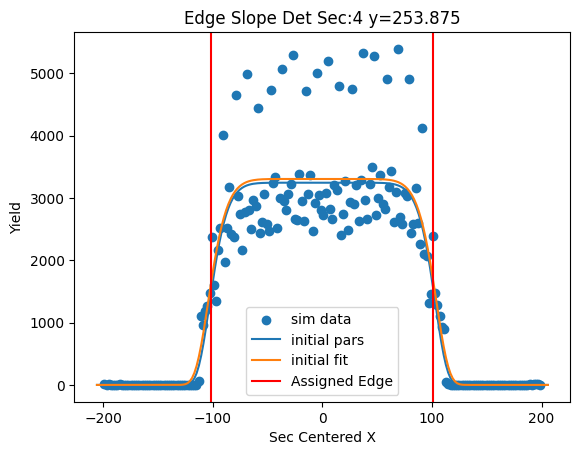

[ 2.84140342e+03 -4.74635265e-01  7.50178053e+01  9.42555522e+00]


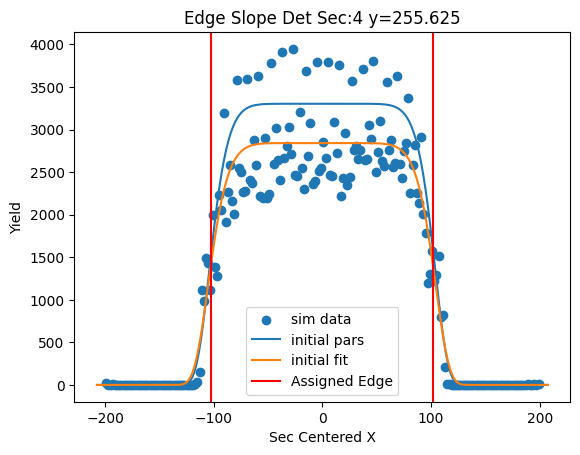

[ 2.68194472e+03 -7.40320858e-02  7.50020123e+01  8.70635993e+00]


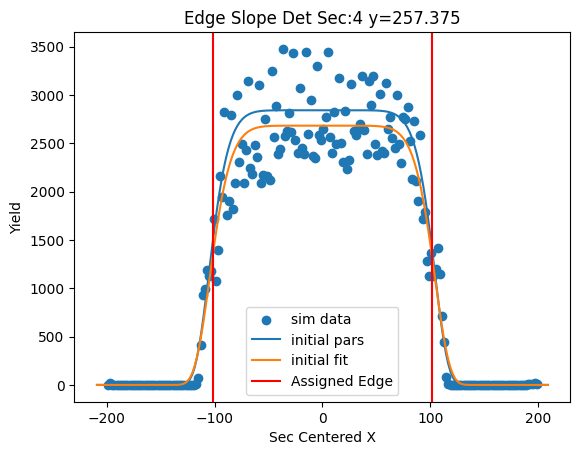

[3.03033723e+03 1.66568905e-01 7.59512446e+01 9.13269953e+00]


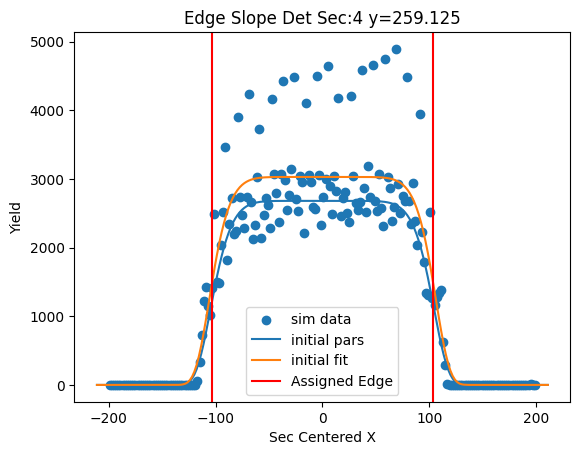

[2.91572390e+03 1.95098823e-01 7.63196855e+01 8.83259778e+00]


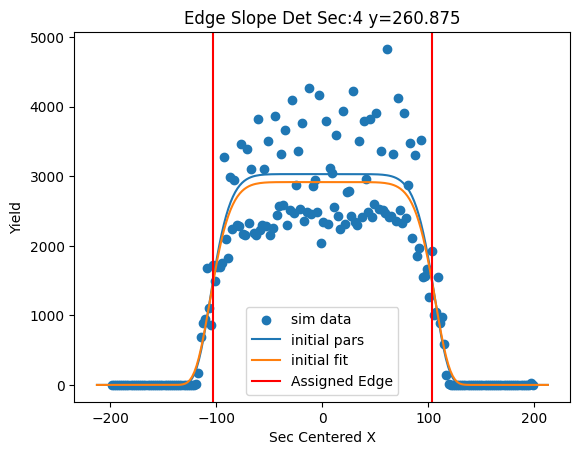

[ 2.79013881e+03 -1.05485588e-01  7.66864924e+01  8.54702904e+00]


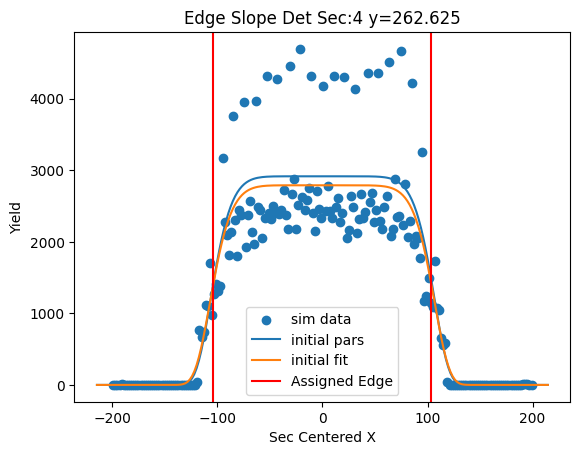

[ 2.30602292e+03 -5.41330659e-01  7.68311622e+01  8.24245809e+00]


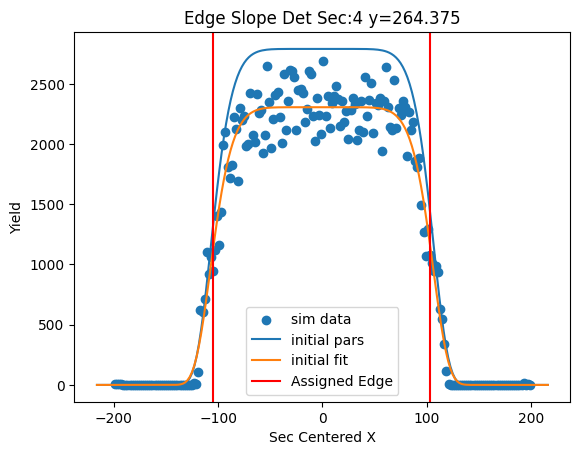

[ 2.57508848e+03 -6.19199809e-01  7.70281598e+01  8.49726519e+00]


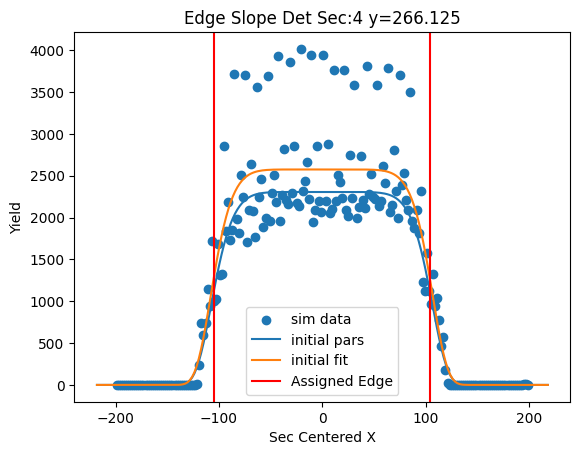

[2.64424159e+03 1.78220808e-01 7.71209771e+01 8.31047526e+00]


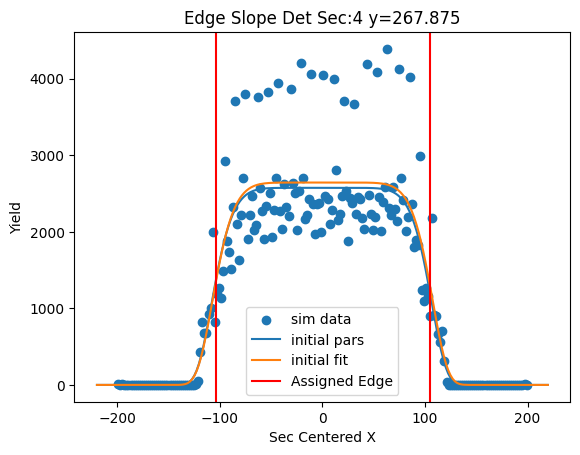

[ 2.28467203e+03 -2.37474806e-01  7.64609151e+01  7.92224598e+00]


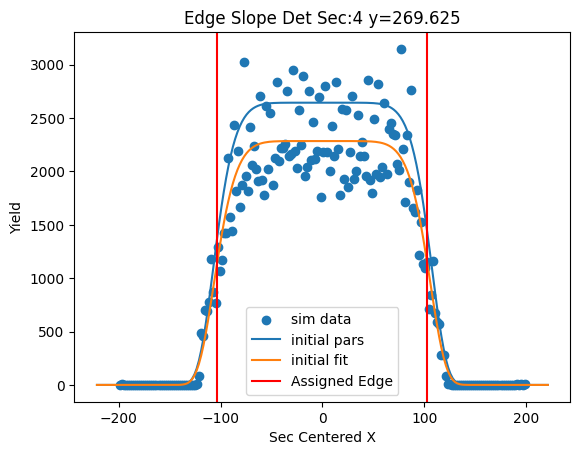

[ 2.23159444e+03 -2.08849557e-01  7.60115188e+01  7.77118438e+00]


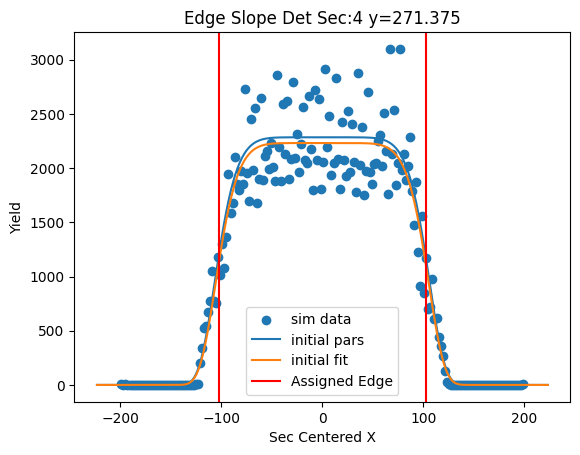

[ 2.46422120e+03 -2.65344501e-01  7.70606079e+01  7.81670086e+00]


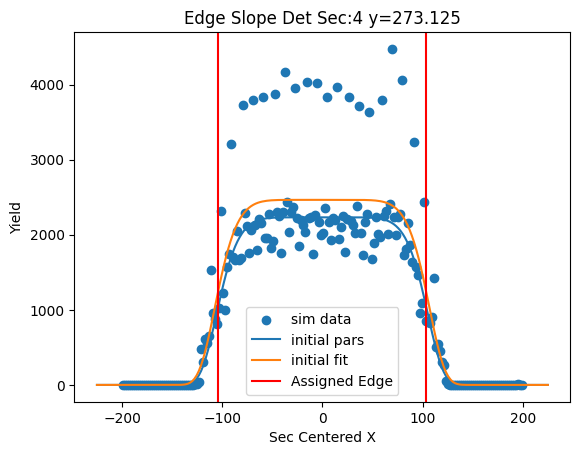

[ 2.23851598e+03 -6.44229036e-01  7.77097196e+01  7.78510777e+00]


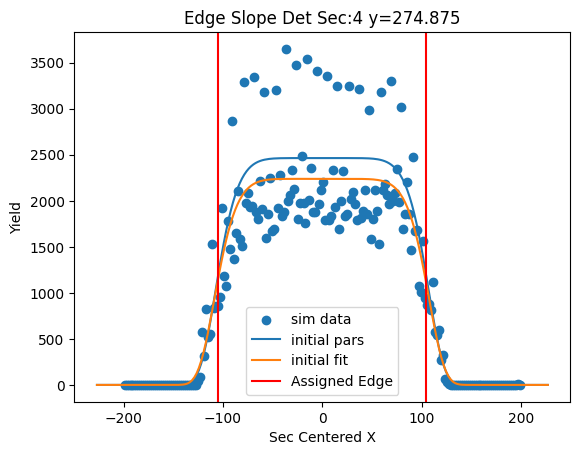

[ 1.88418199e+03 -6.08873878e-01  7.79643467e+01  8.04788722e+00]


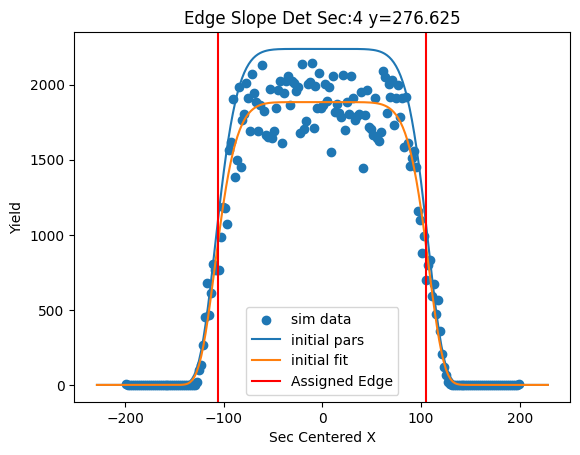

[2.20035250e+03 5.62645357e-02 7.96264310e+01 8.64940912e+00]


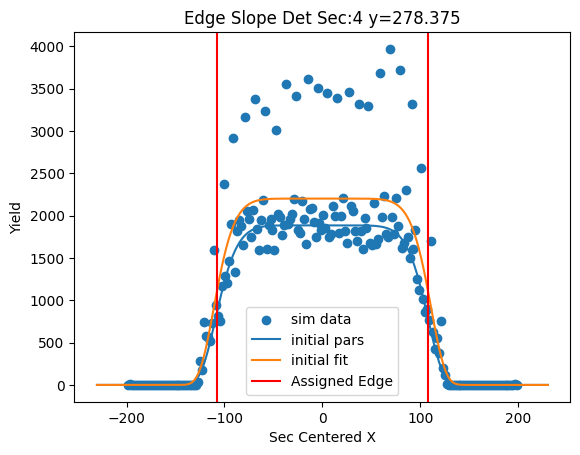

[2.19182165e+03 2.20830840e-01 8.03904873e+01 8.88689697e+00]


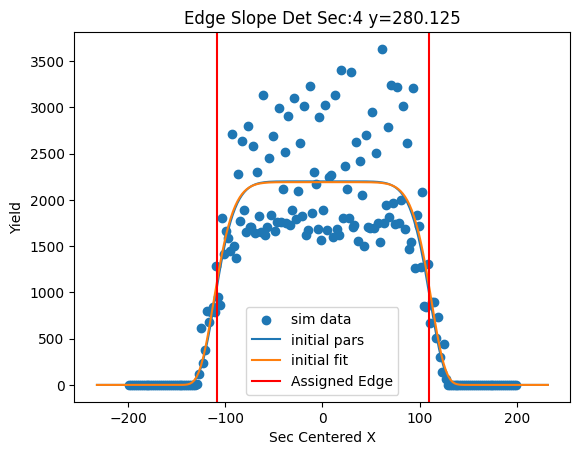

[2.16813446e+03 5.26326810e-02 8.15096783e+01 9.21181439e+00]


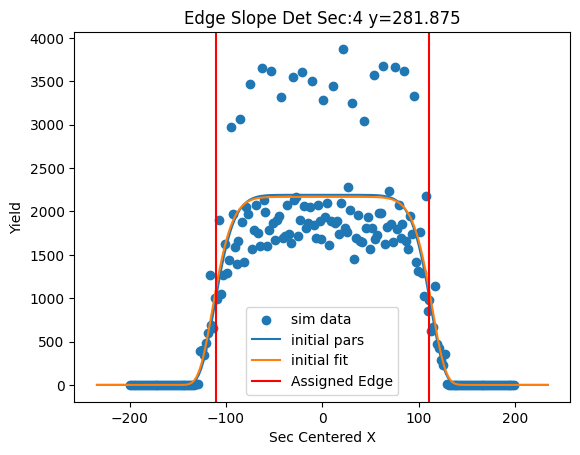

[ 1.76080505e+03 -4.94633226e-01  8.17489416e+01  8.41836396e+00]


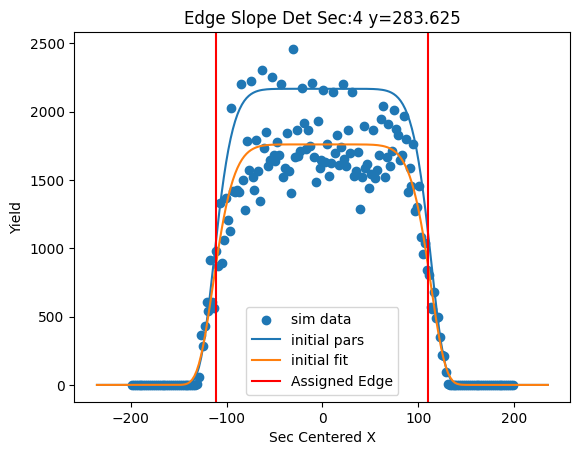

[ 1.77142009e+03 -9.67550838e-01  8.26400608e+01  8.95723969e+00]


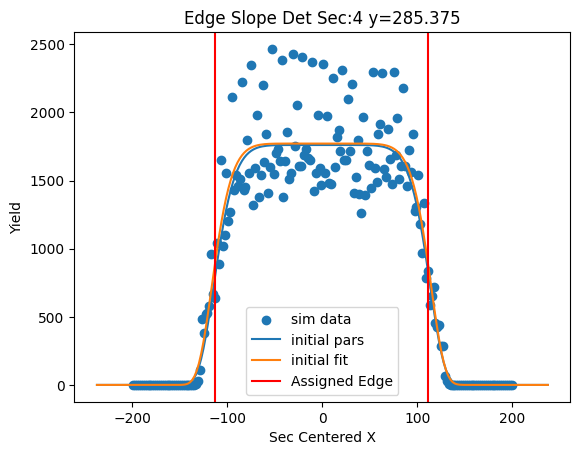

[2.00912313e+03 5.47672234e-06 8.36925262e+01 8.70450608e+00]


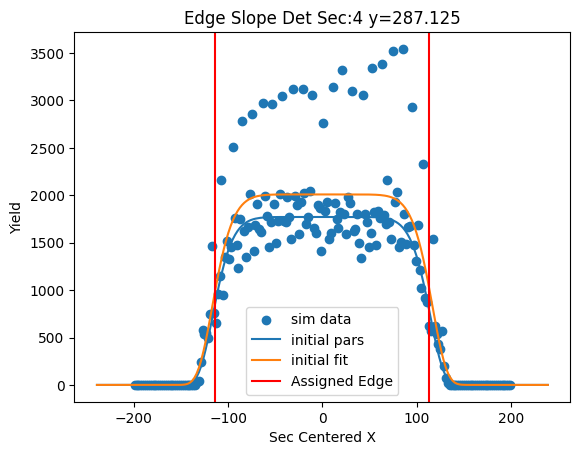

[ 1.88058381e+03 -2.08597791e-01  8.36214857e+01  8.74364554e+00]


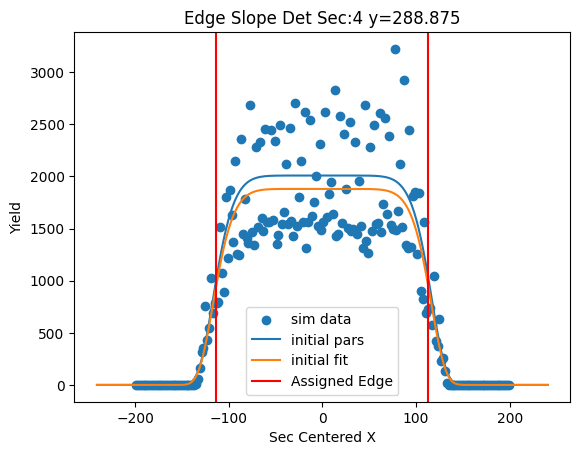

[ 1.57370286e+03 -1.19939504e+00  8.37953087e+01  8.35607025e+00]


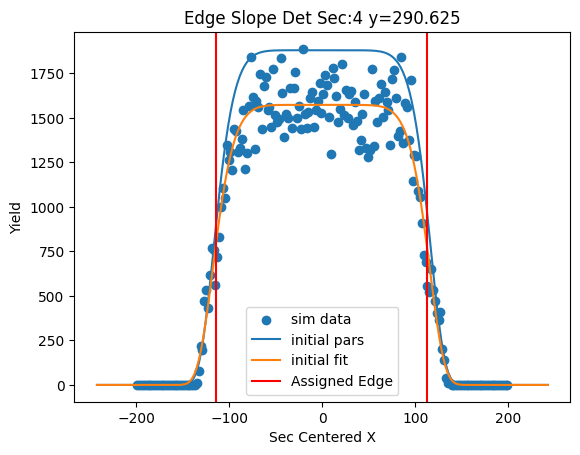

[ 1.78604823e+03 -9.99751624e-01  8.50787067e+01  8.37967657e+00]


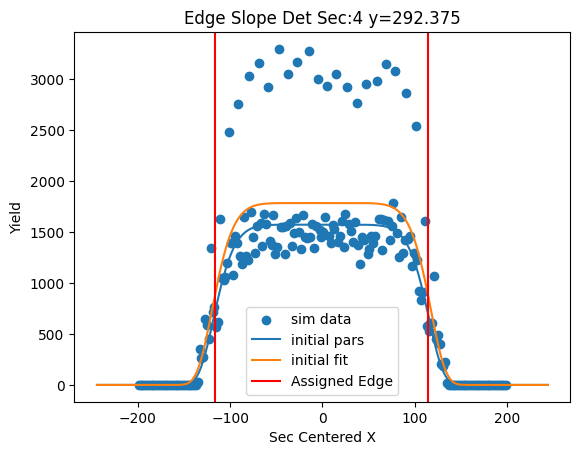

[ 1.70842483e+03 -9.81259574e-01  8.59893420e+01  7.98063281e+00]


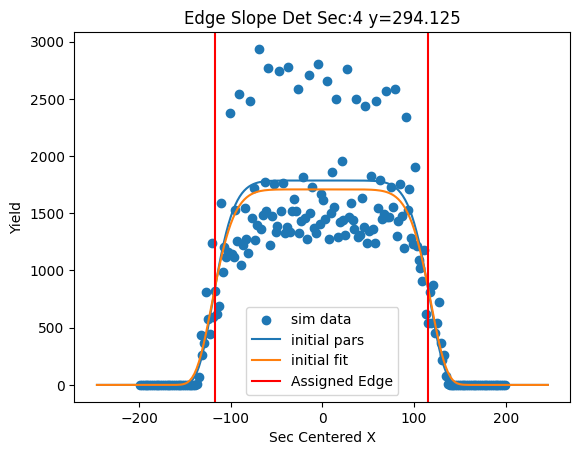

[ 1.70477165e+03 -3.63921752e-01  8.79008626e+01  8.27429594e+00]


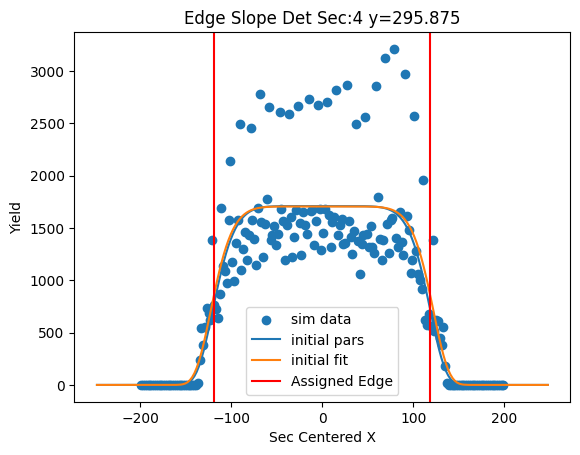

[ 1.43565234e+03 -1.01207559e+00  8.84599459e+01  8.58802123e+00]


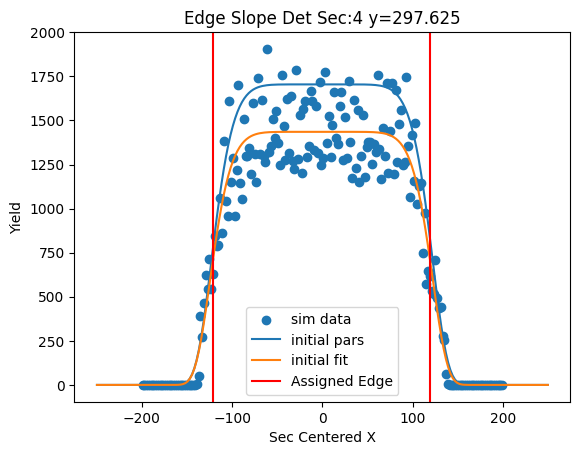

[ 1.48895722e+03 -5.34478544e-01  8.89258705e+01  8.60103061e+00]


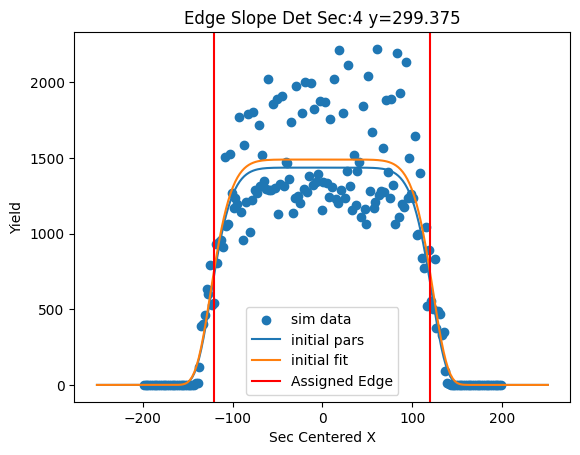

[ 1.60057855e+03 -8.41250939e-01  8.97644878e+01  9.08549014e+00]


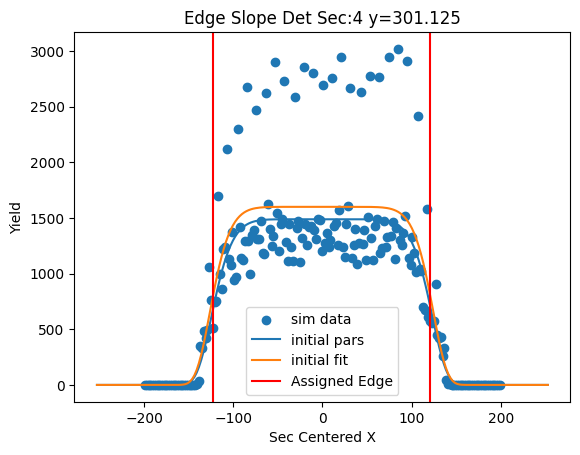

[1405.99476055   -1.78341973   90.33065219    8.9954529 ]


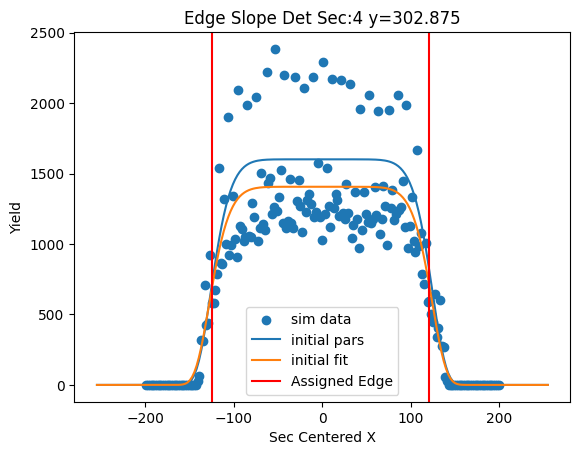

[1189.1109593    -2.15790601   90.44680324    9.2551797 ]


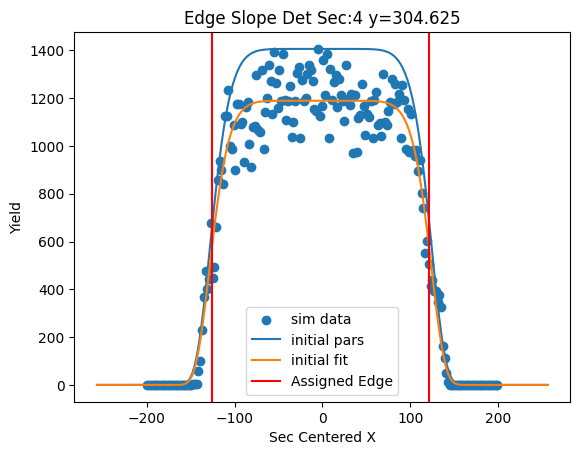

[ 1.41841848e+03 -8.23765230e-01  9.07284079e+01  9.45285606e+00]


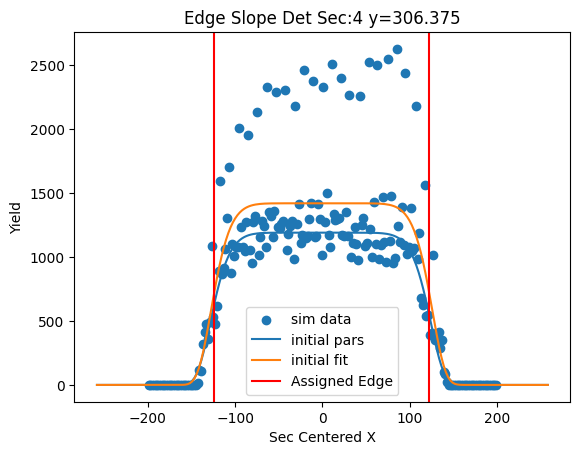

[ 1.39266853e+03 -1.15690879e+00  9.05915746e+01  9.07274664e+00]


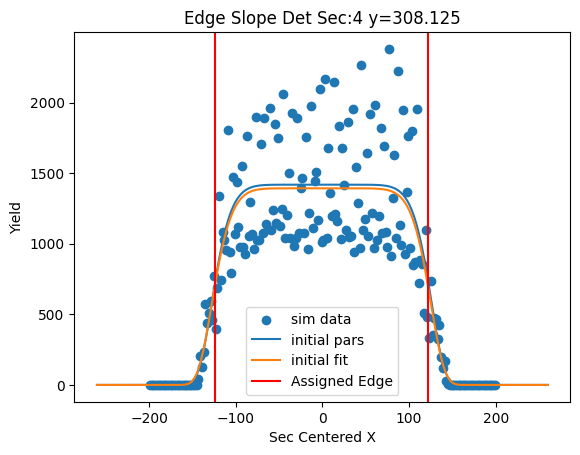

[1351.03617199   -1.64974775   91.25354487    9.11953624]


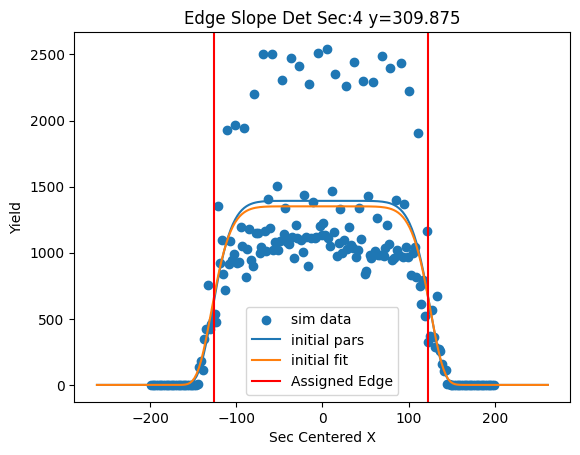

[1028.02010287   -3.07568937   91.84804204    9.4153255 ]


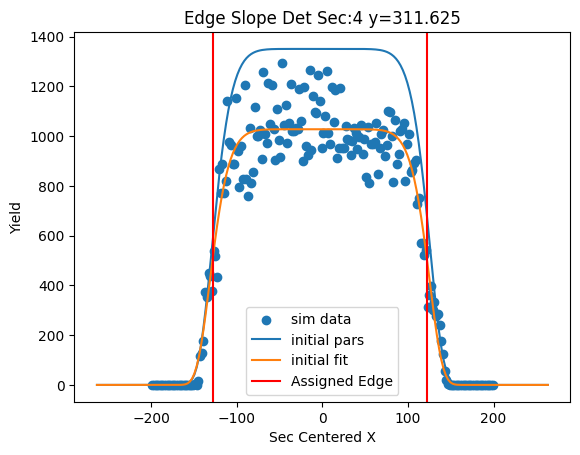

[1100.09471179   -2.13147904   92.33530895    8.77654868]


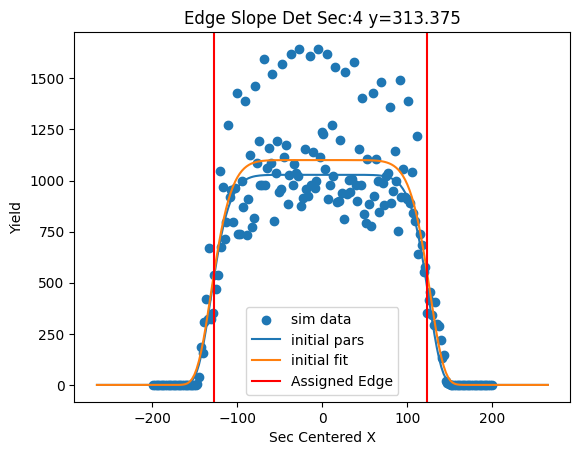

[ 1.23421452e+03 -1.13280112e+00  9.38699807e+01  8.95144571e+00]


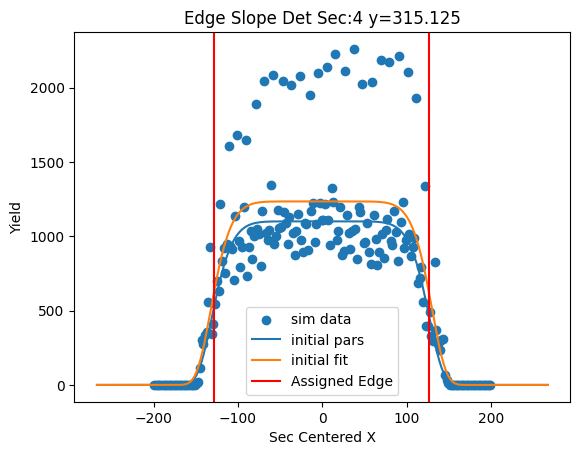

[1108.56180651   -1.12419615   94.57053964    9.34730048]


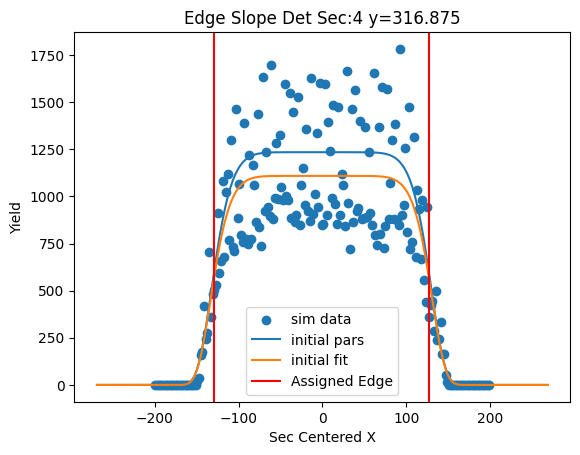

[951.2656118   -1.35352711  94.97725985   9.30984198]


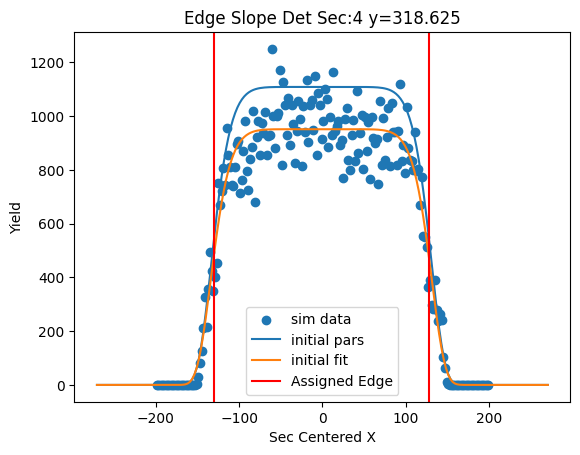

[ 1.07915056e+03 -1.05923030e+00  9.55017780e+01  9.48921662e+00]


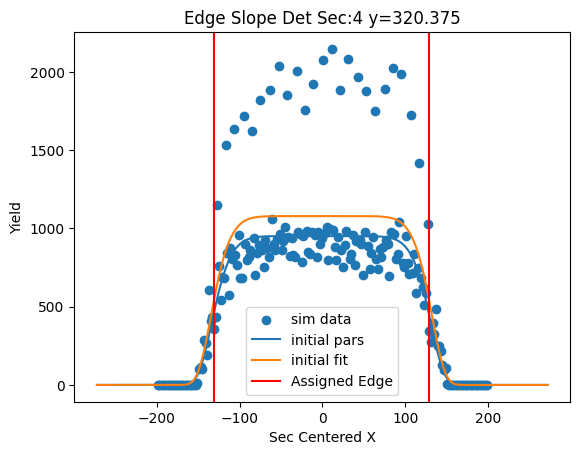

[1031.67841415   -1.9303801    96.71487041   10.1557254 ]


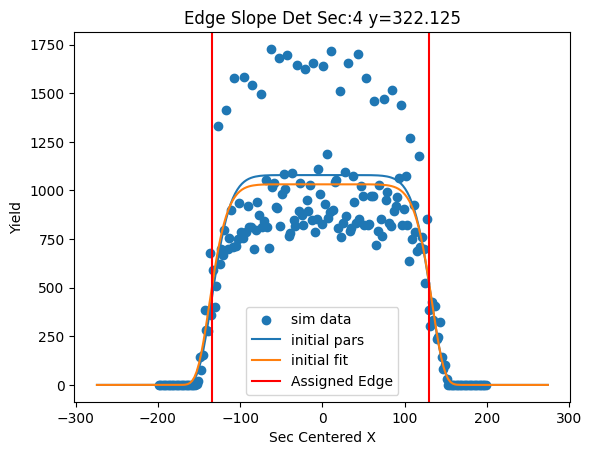

[ 1.05114738e+03 -3.63111641e-01  9.73454316e+01  1.01452754e+01]


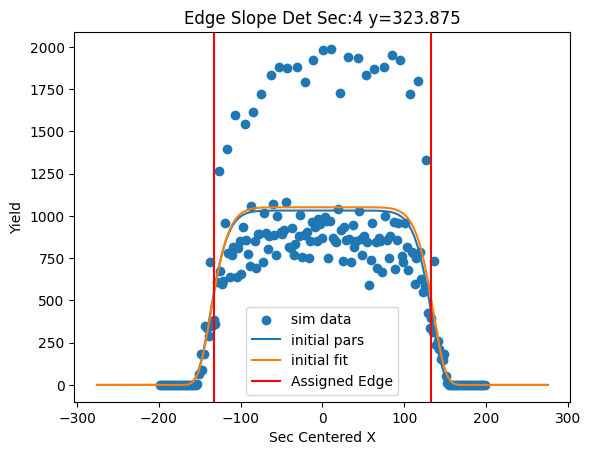

[856.03559511  -1.36756308  96.87946303   9.93894994]


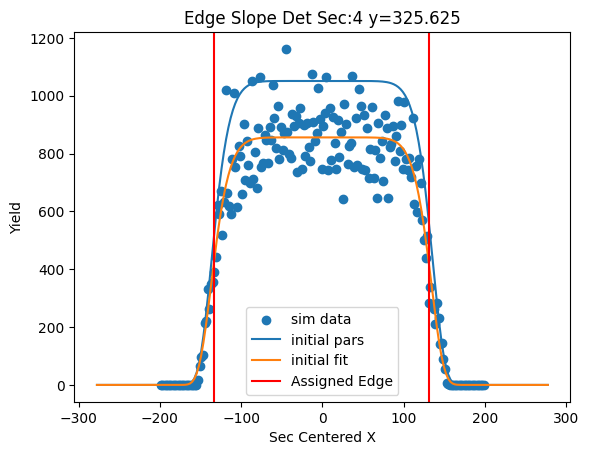

[ 9.61322735e+02 -5.71631914e-01  9.72060776e+01  9.95627543e+00]


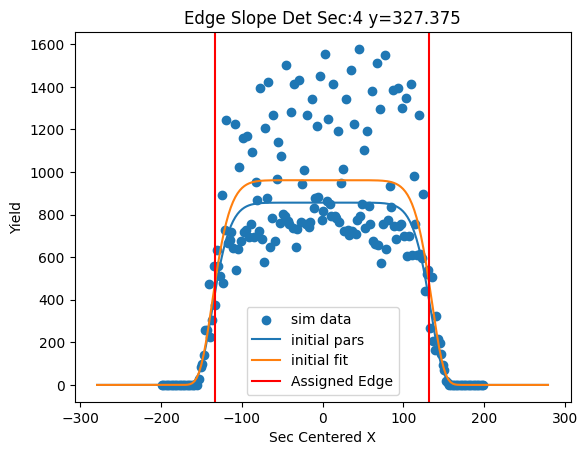

[ 1.04443882e+03 -9.01112977e-01  9.81240378e+01  1.03263829e+01]


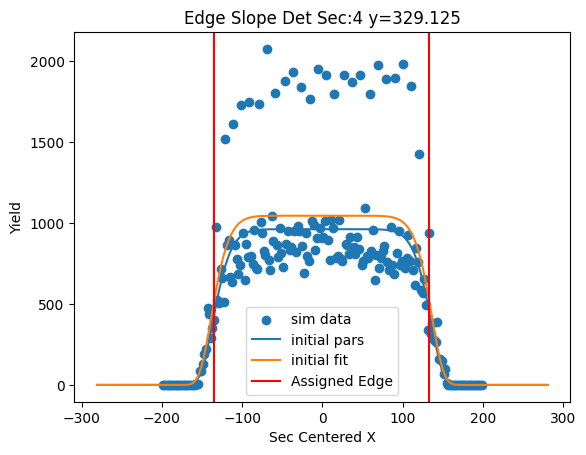

[1.07965484e+05 8.02743593e-01 1.64772261e+01 1.35543223e+01]


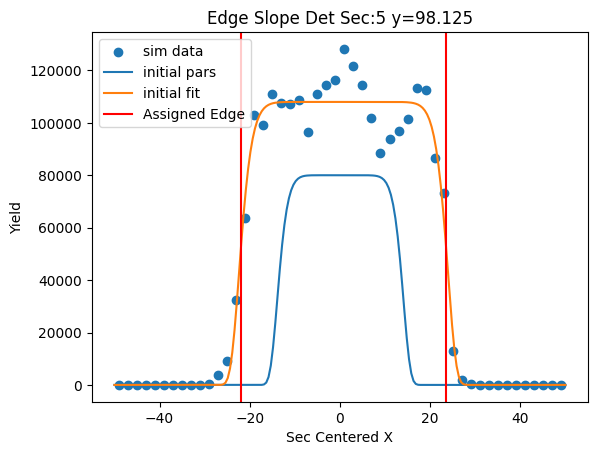

[1.07139382e+05 8.30429413e-01 1.71813609e+01 1.12862703e+01]


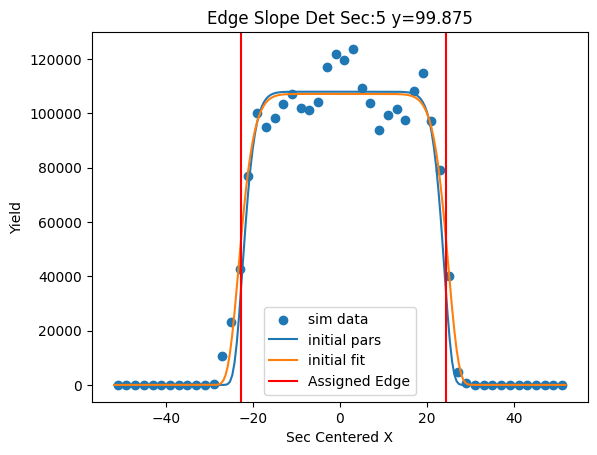

[1.06105916e+05 7.74879882e-01 1.81041447e+01 9.03089763e+00]


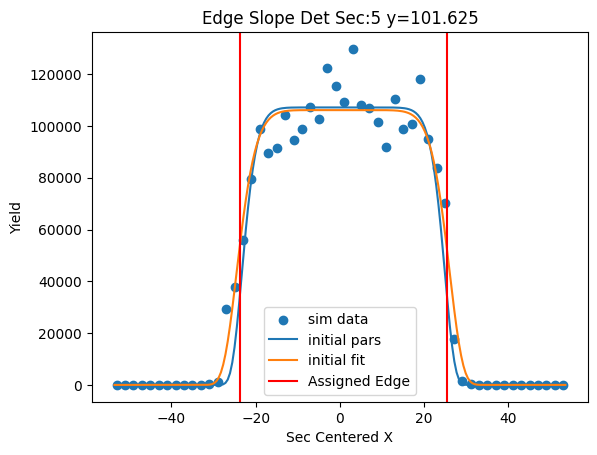

[1.02508844e+05 5.14868237e-01 1.89452824e+01 8.26930876e+00]


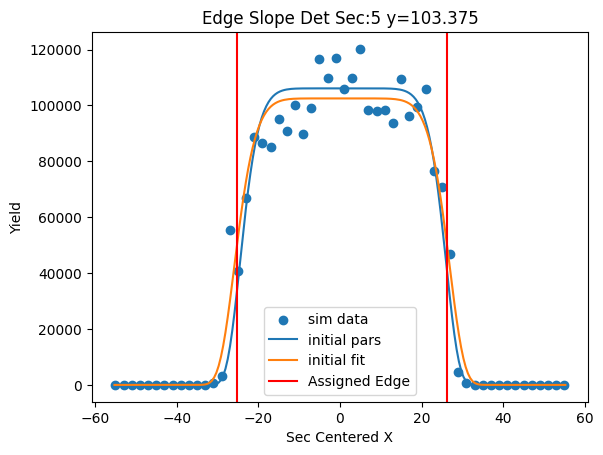

[9.45707831e+04 5.23972597e-01 1.93758366e+01 8.54924979e+00]


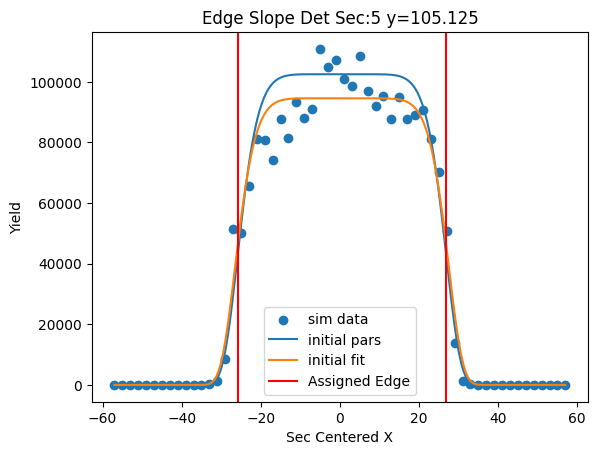

[9.01797949e+04 6.16893125e-01 1.98382695e+01 7.34959832e+00]


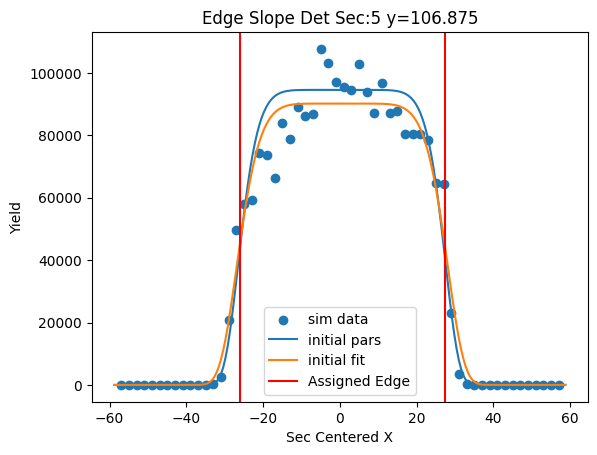

[8.76023315e+04 5.43644728e-01 2.04507878e+01 6.19435540e+00]


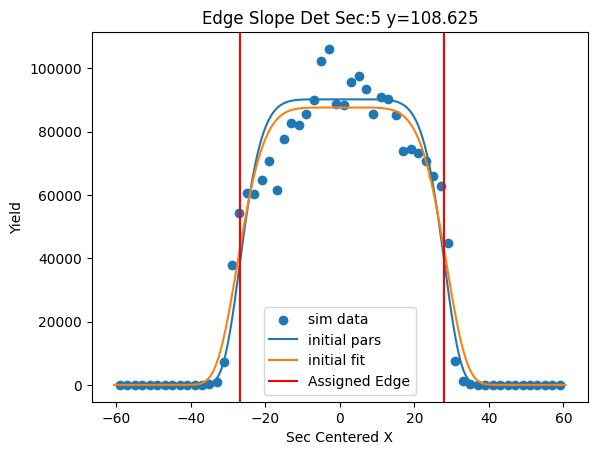

[8.19550471e+04 4.10241045e-01 2.10902721e+01 6.56703835e+00]


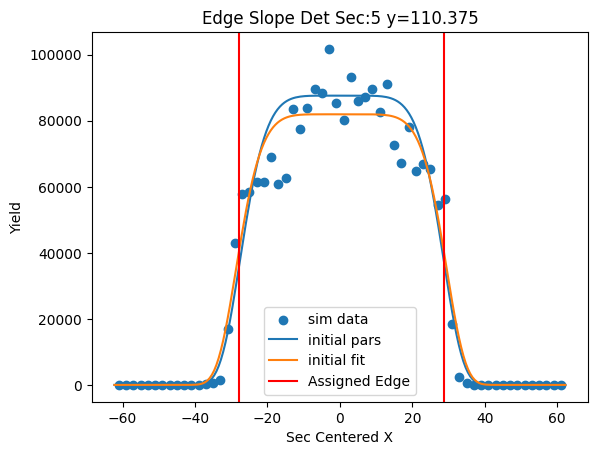

[7.56672446e+04 5.11568873e-01 2.17012125e+01 7.00993001e+00]


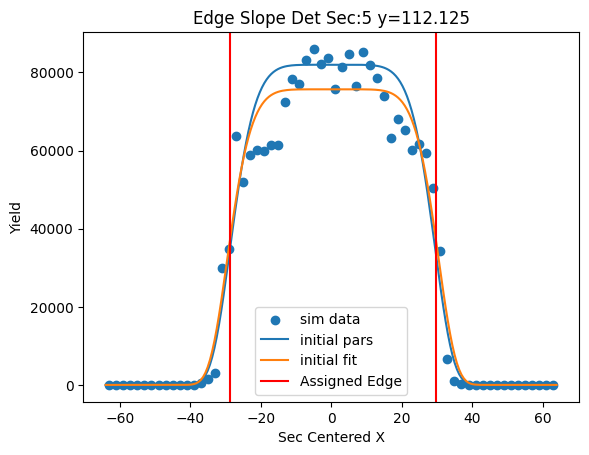

[7.31847968e+04 5.19909852e-01 2.26949595e+01 8.80206812e+00]


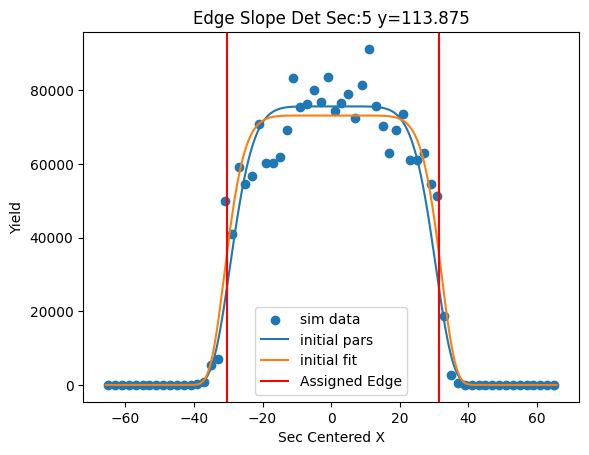

[7.04062736e+04 4.38292339e-01 2.35160663e+01 1.10003621e+01]


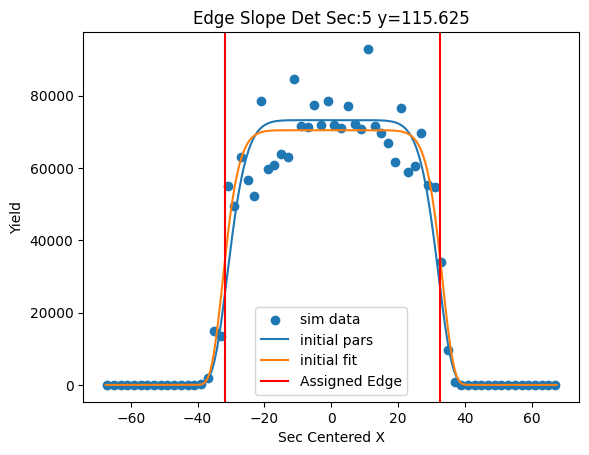

[6.64995876e+04 5.52536258e-01 2.41800880e+01 9.61747568e+00]


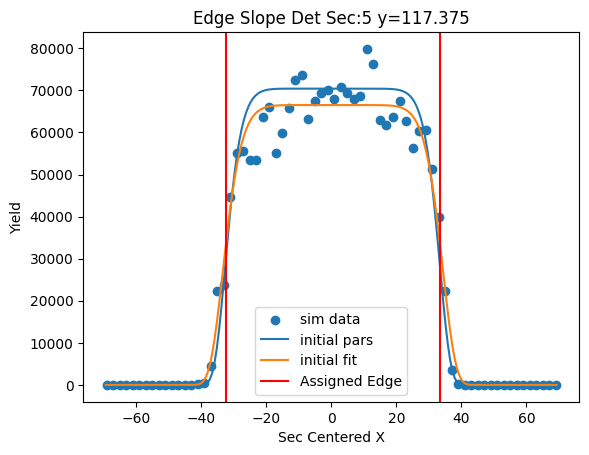

[6.11370667e+04 4.81458624e-01 2.47104064e+01 8.34220225e+00]


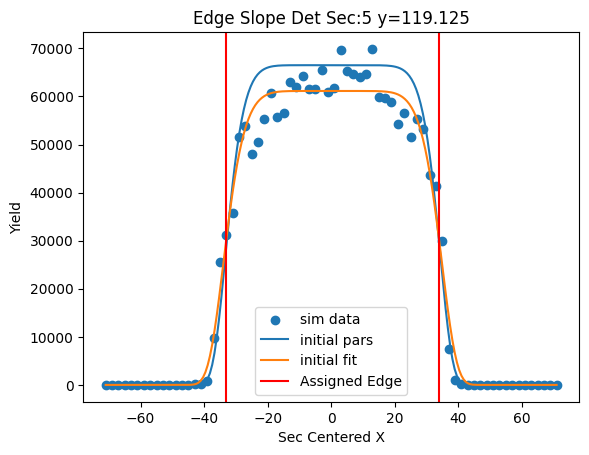

[5.79681002e+04 4.18276976e-01 2.54666819e+01 7.64020158e+00]


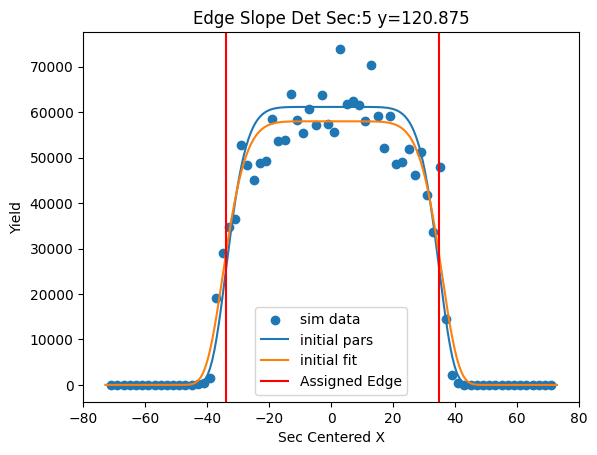

[5.43161732e+04 3.39081915e-01 2.60864140e+01 6.66823459e+00]


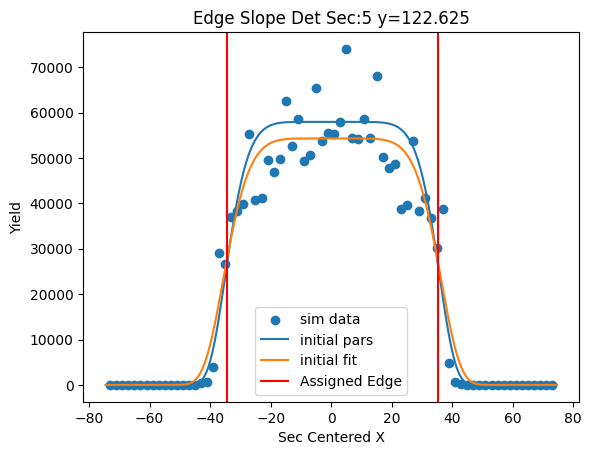

[4.88788111e+04 1.81620835e-01 2.61372266e+01 5.21027970e+00]


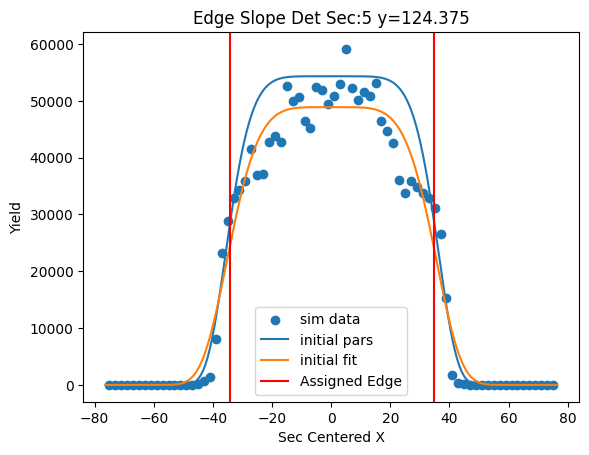

[4.55042457e+04 2.72718826e-01 2.59339621e+01 4.17025449e+00]


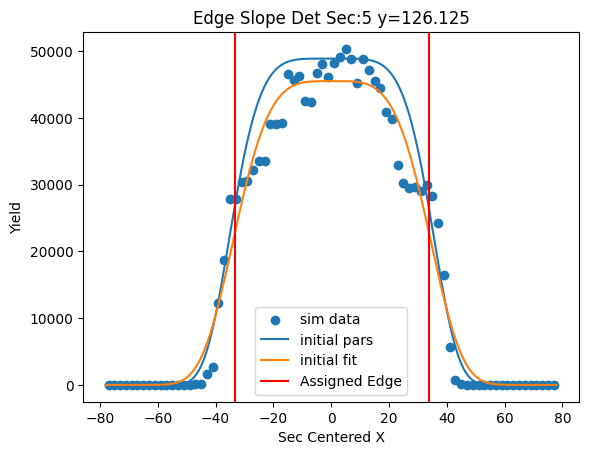

[4.43698677e+04 4.65113860e-01 2.64279886e+01 4.04358336e+00]


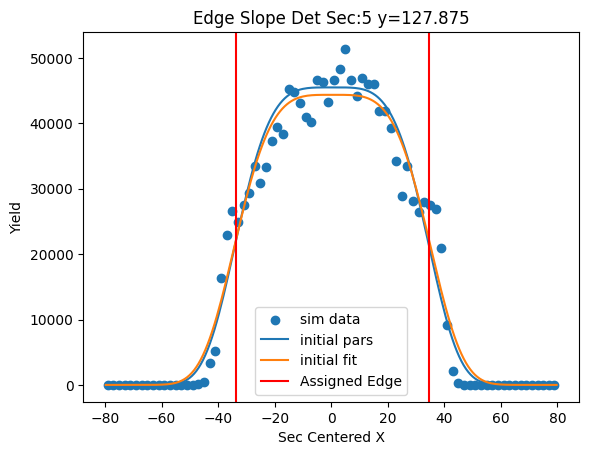

[4.25629267e+04 4.90299253e-01 2.73451455e+01 4.16735032e+00]


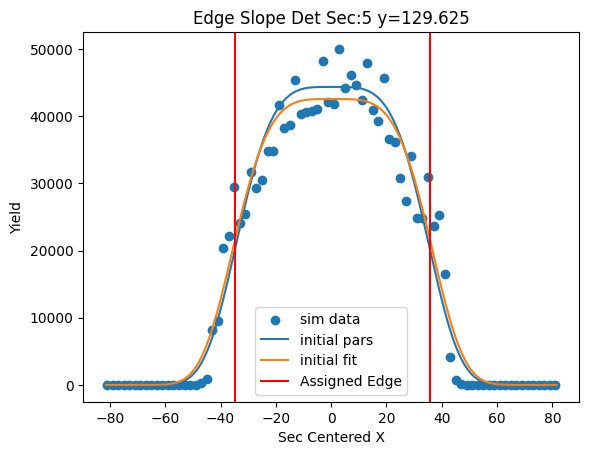

[4.01954637e+04 3.38967474e-01 2.81734314e+01 4.28154619e+00]


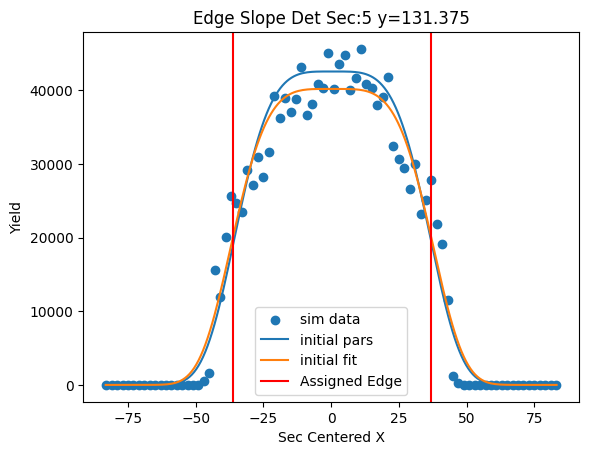

[3.71853004e+04 4.56324439e-01 2.87264468e+01 4.38565451e+00]


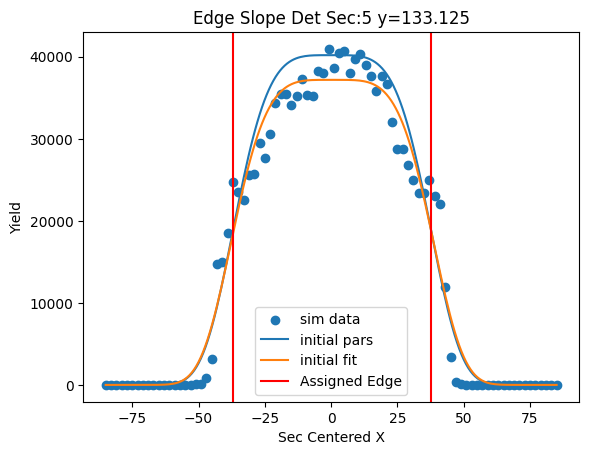

[3.69006577e+04 4.21070181e-01 2.95423320e+01 4.57300907e+00]


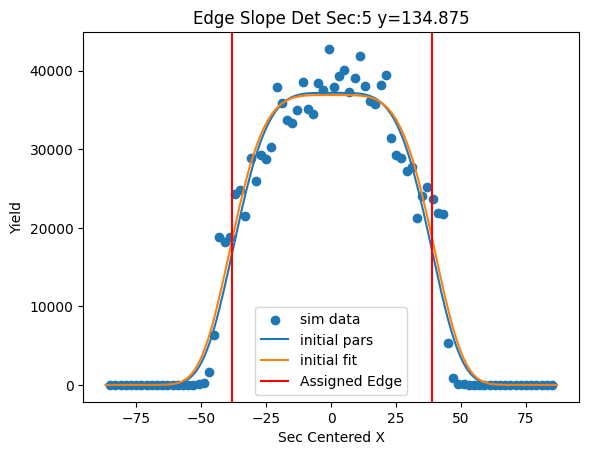

[3.72196515e+04 2.33602353e-01 3.02913463e+01 4.64160672e+00]


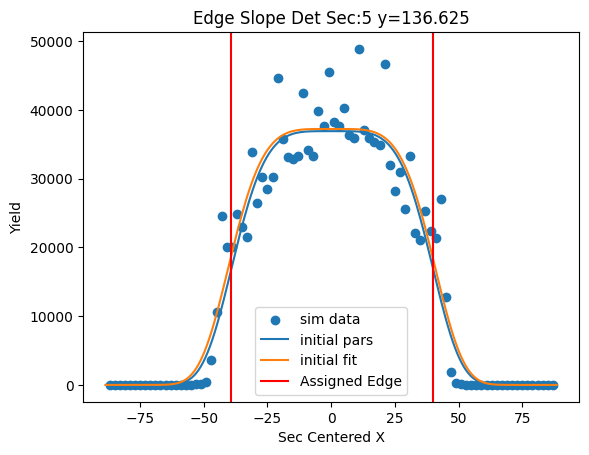

[3.58682272e+04 1.72135245e-01 3.04725751e+01 4.31012776e+00]


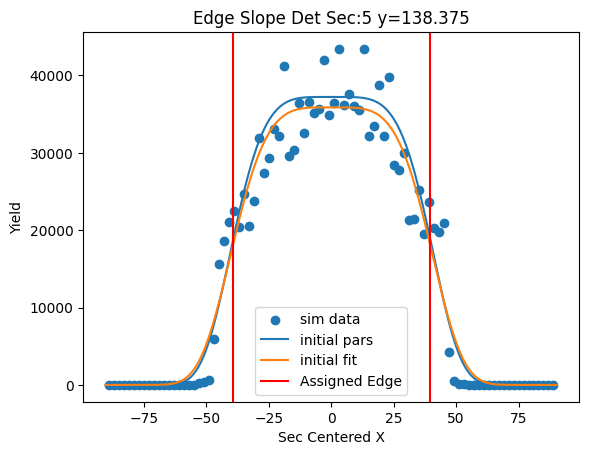

[ 3.44408628e+04 -6.18185108e-02  3.05155990e+01  3.98137335e+00]


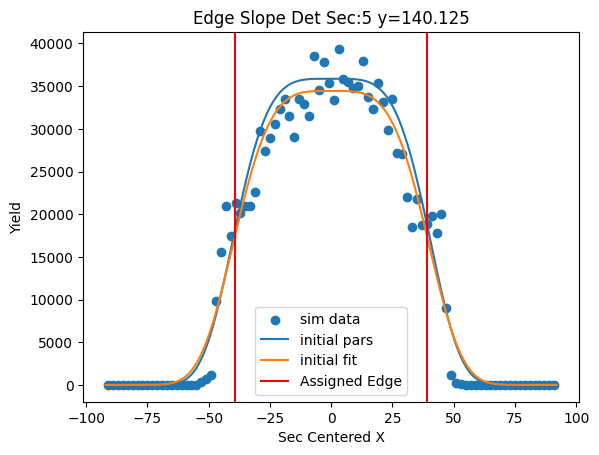

[ 3.45547590e+04 -1.15791675e-01  3.15627664e+01  4.22311529e+00]


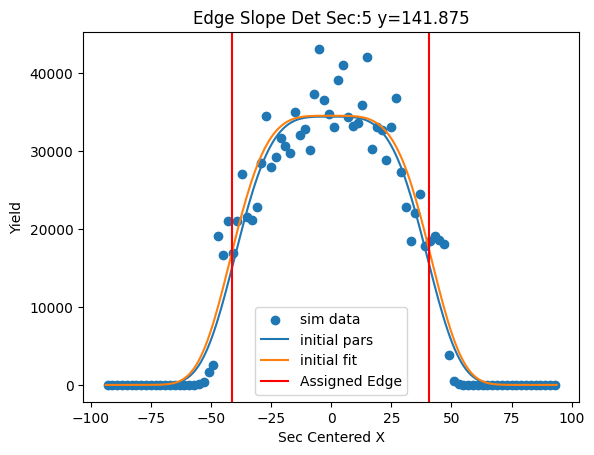

[ 3.31017159e+04 -2.56309681e-01  3.28897445e+01  4.80786000e+00]


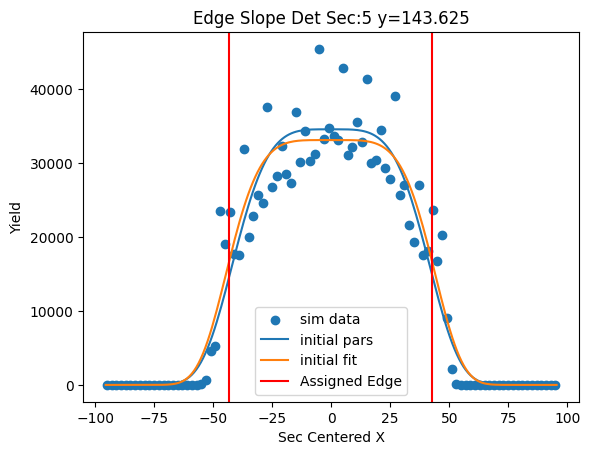

[ 3.07646368e+04 -3.01299989e-01  3.39087388e+01  5.27733075e+00]


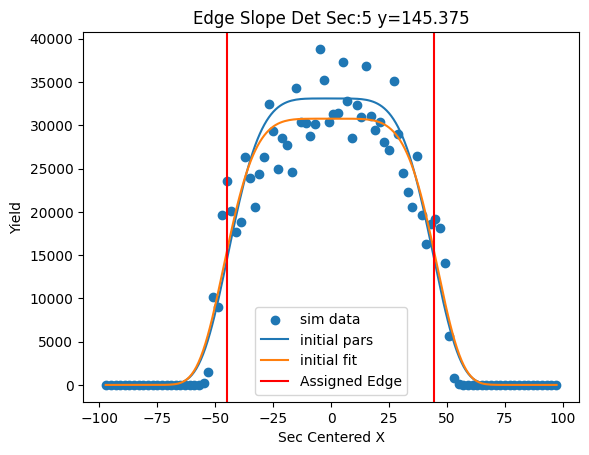

[ 2.84354224e+04 -5.10782697e-01  3.44742348e+01  5.36983525e+00]


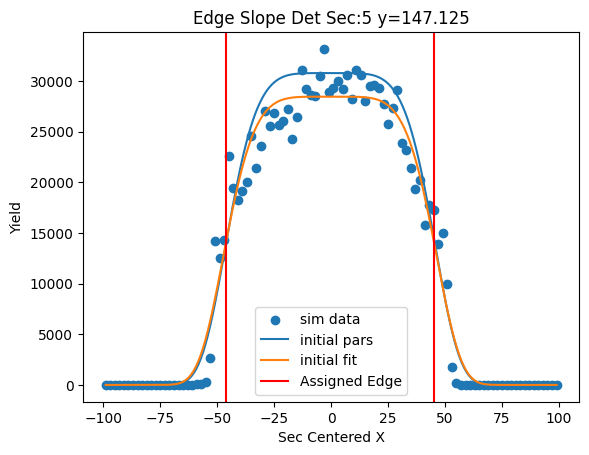

[ 2.83765118e+04 -9.21918176e-01  3.56639234e+01  6.07262109e+00]


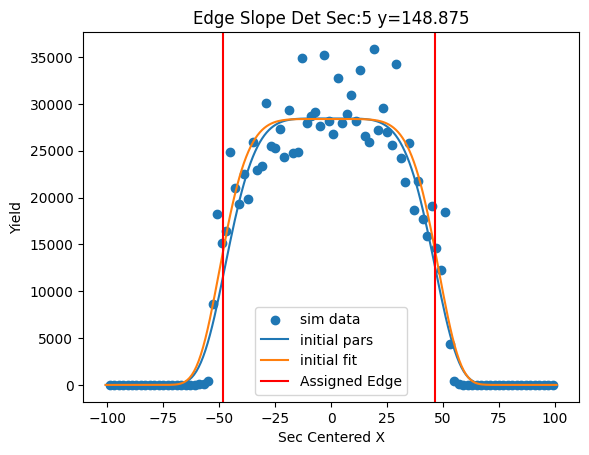

[ 2.74737626e+04 -1.32157399e+00  3.64601594e+01  6.40004456e+00]


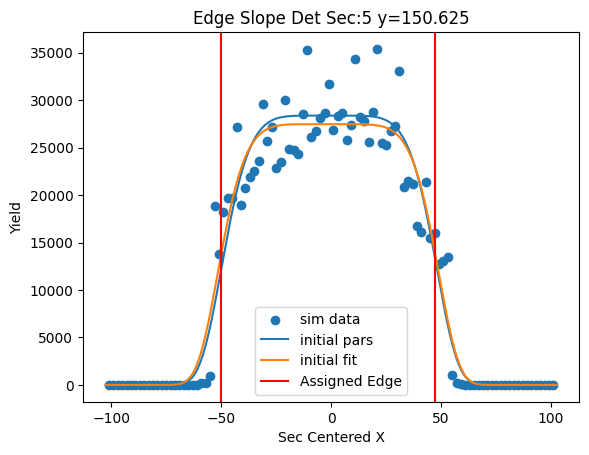

[ 2.52498221e+04 -1.49194587e+00  3.64177976e+01  6.02498011e+00]


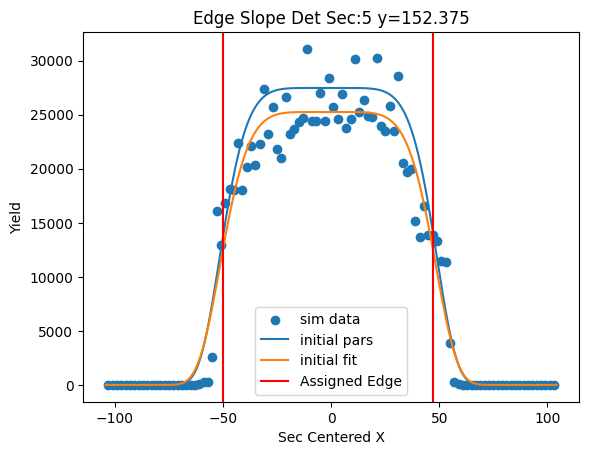

[ 2.39139473e+04 -1.24580149e+00  3.64293108e+01  5.67583629e+00]


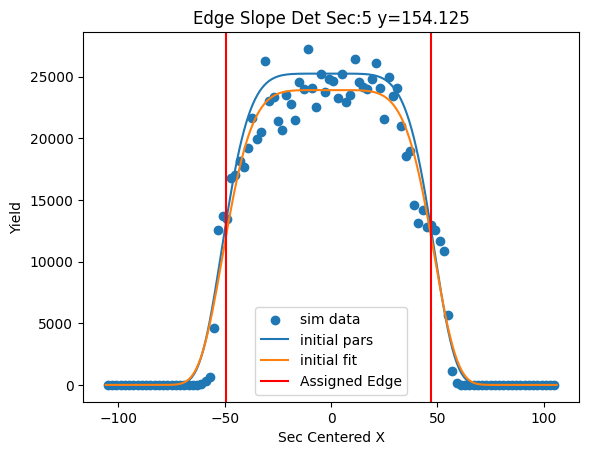

[ 2.41709436e+04 -1.17727743e+00  3.72866410e+01  5.87053250e+00]


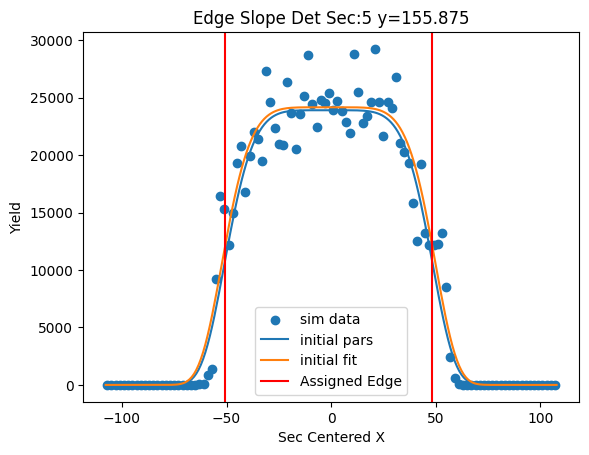

[ 2.28594595e+04 -1.20362013e+00  3.81999367e+01  6.43306721e+00]


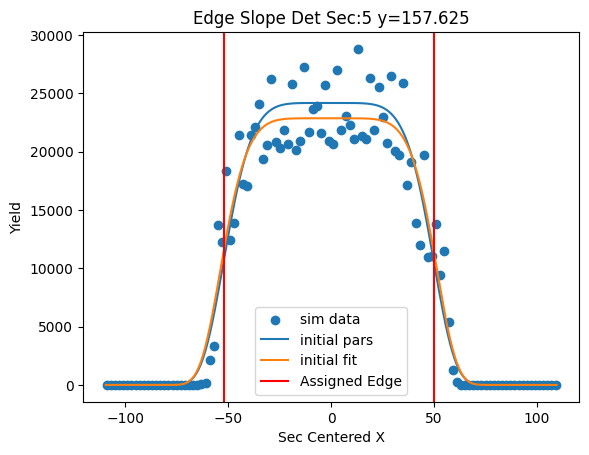

[ 2.16387170e+04 -1.14244751e+00  3.89374593e+01  6.82887443e+00]


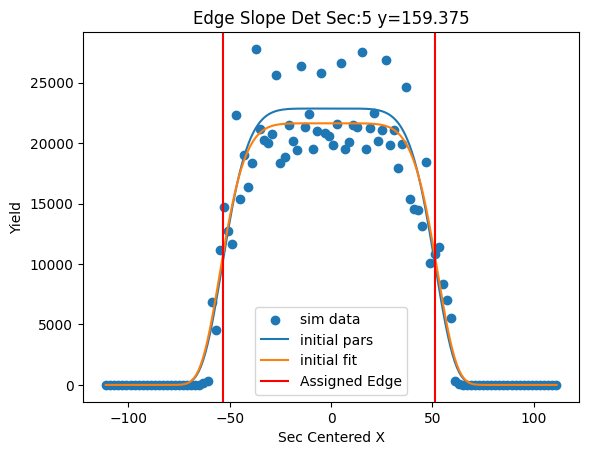

[ 1.96035196e+04 -8.87597125e-01  3.93605951e+01  6.96493930e+00]


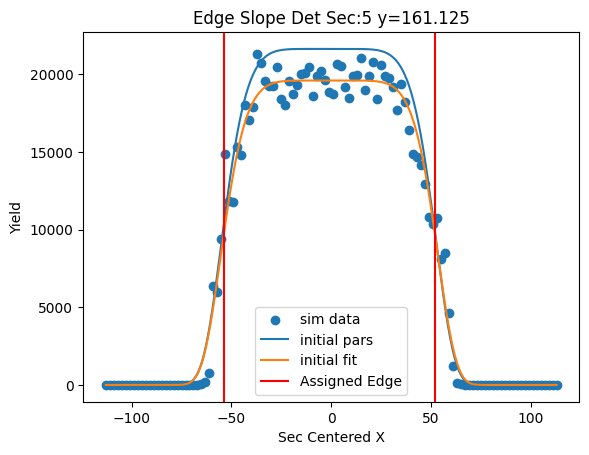

[ 1.98420420e+04 -9.17670554e-01  4.05402357e+01  8.32299550e+00]


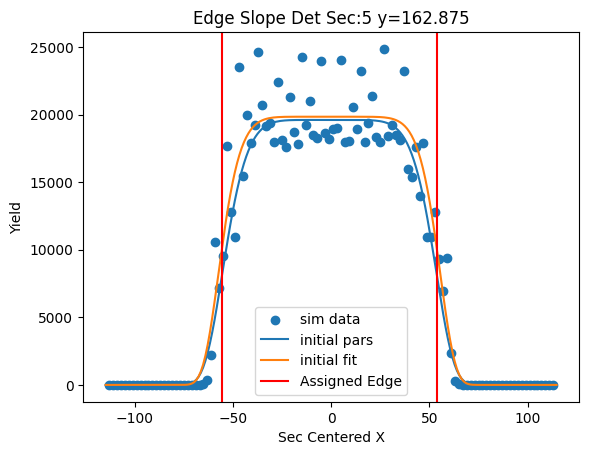

[ 1.95947874e+04 -8.92159557e-01  4.11509112e+01  8.81211594e+00]


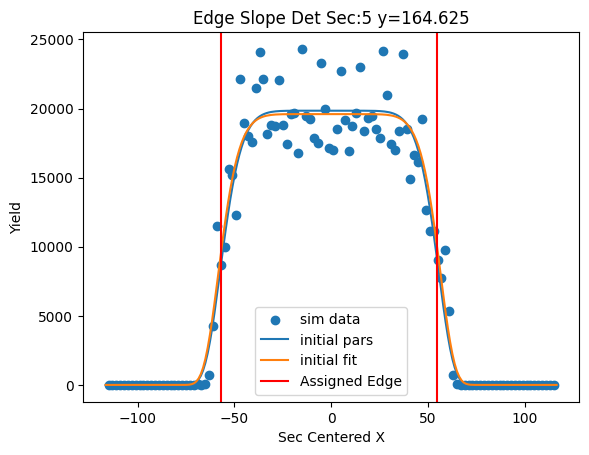

[ 1.81829607e+04 -1.04049395e+00  4.13546687e+01  8.99995517e+00]


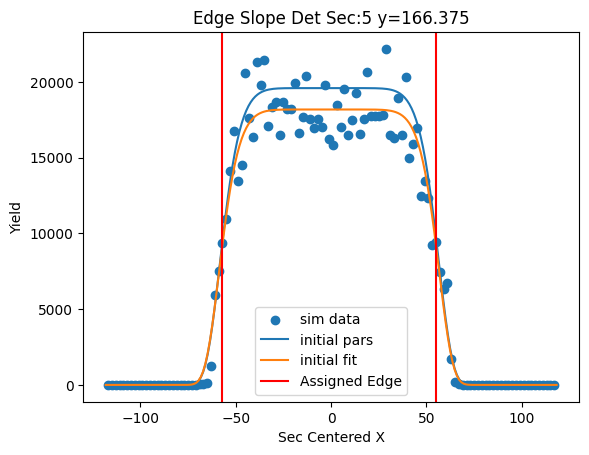

[ 1.75699797e+04 -1.22784761e+00  4.15305170e+01  9.03198295e+00]


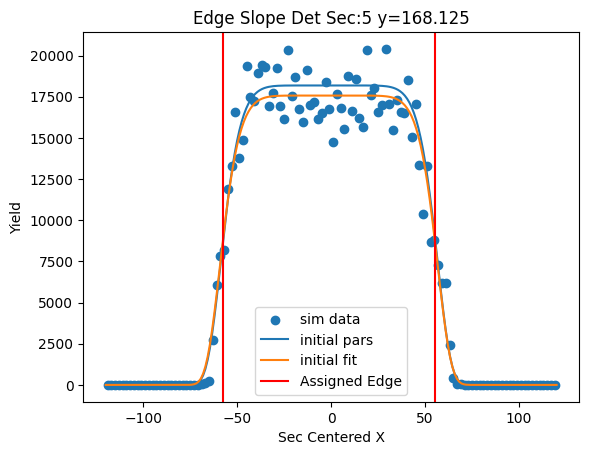

[ 1.78640739e+04 -1.12630029e+00  4.22928120e+01  9.85289804e+00]


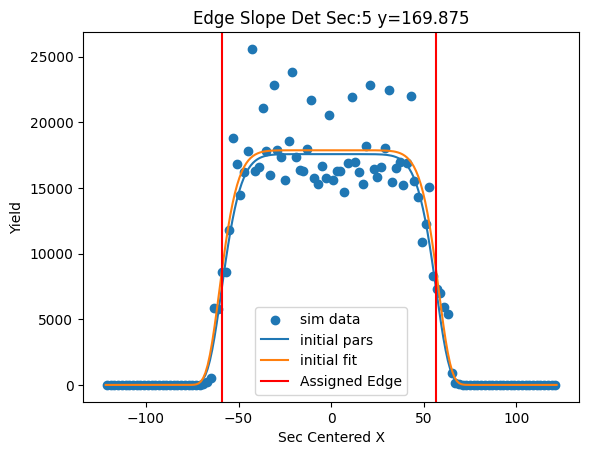

[ 1.71670114e+04 -1.12968490e+00  4.29008541e+01  9.74969518e+00]


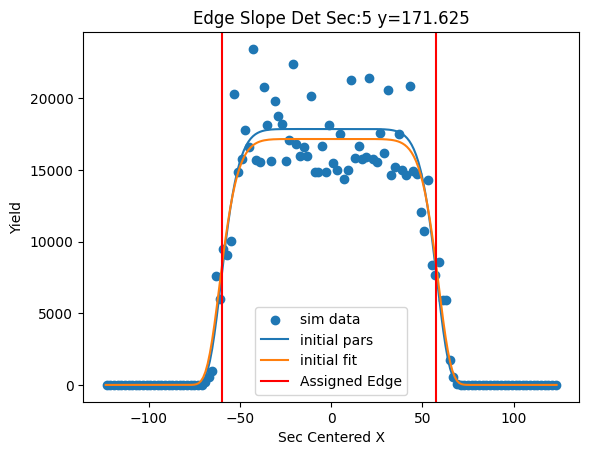

[ 1.63327088e+04 -7.85602053e-01  4.35371582e+01  9.65055953e+00]


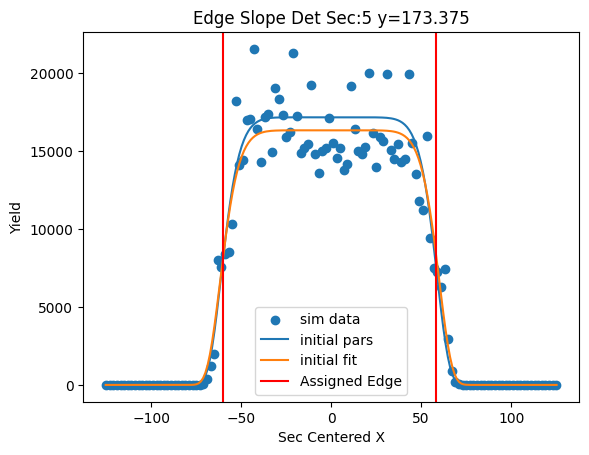

[ 1.51270294e+04 -7.98307865e-01  4.37040208e+01  9.47904711e+00]


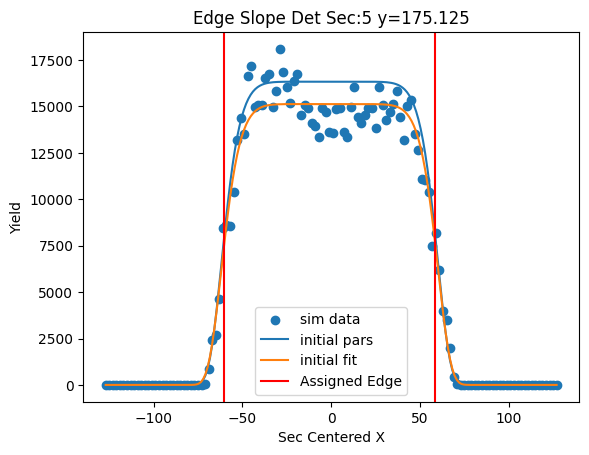

[ 1.56622343e+04 -4.44287255e-01  4.46898123e+01  9.82750105e+00]


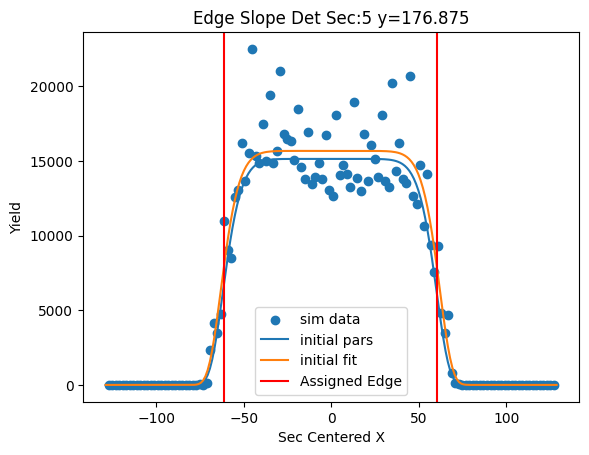

[ 1.54070545e+04 -5.45352406e-01  4.54791740e+01  9.10742400e+00]


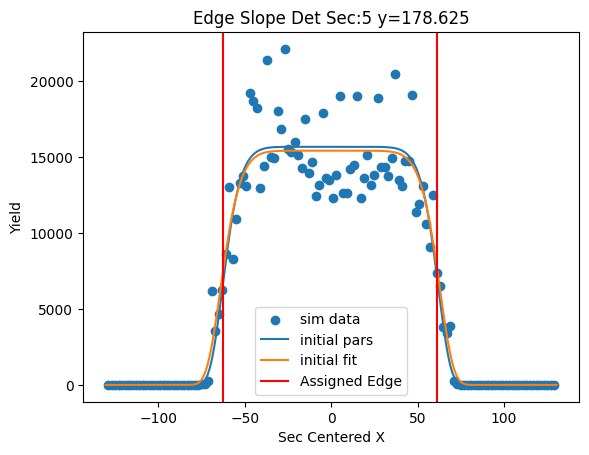

[ 1.37901870e+04 -5.99359250e-01  4.57299078e+01  8.95639878e+00]


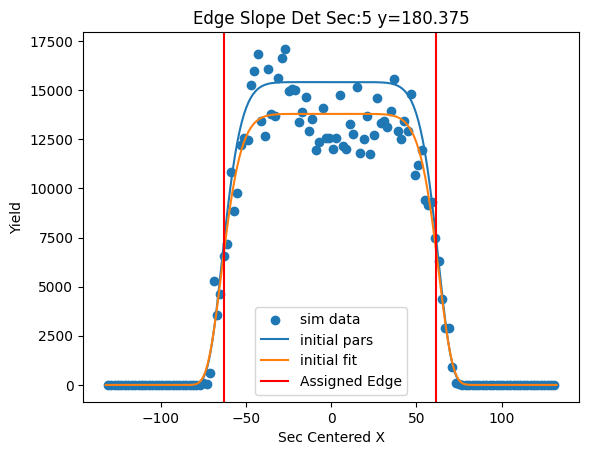

[ 1.34828956e+04 -3.92891971e-01  4.61396246e+01  8.80343217e+00]


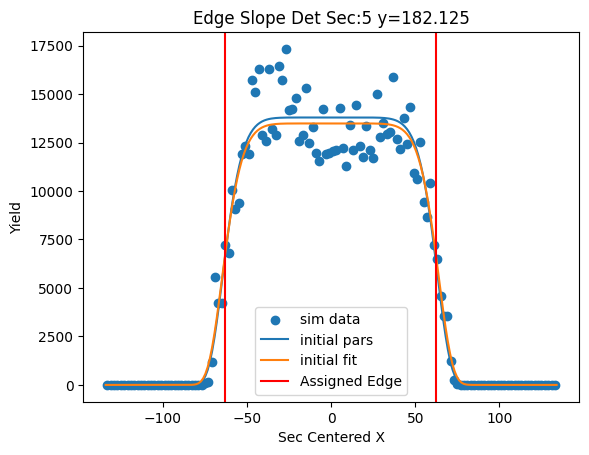

[ 1.39481222e+04 -1.28518439e-01  4.74307880e+01  8.57286122e+00]


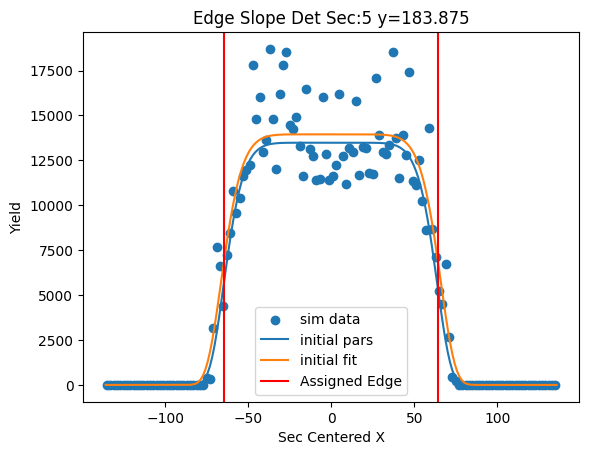

[ 1.33200266e+04 -9.70684871e-02  4.82685888e+01  8.80160410e+00]


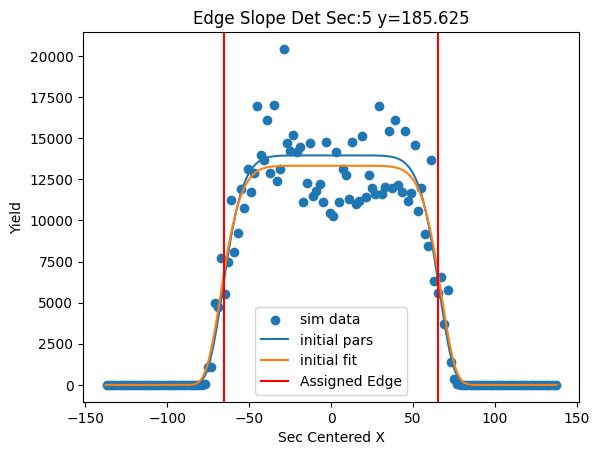

[ 1.20141653e+04 -1.94083688e-01  4.87403338e+01  8.67103460e+00]


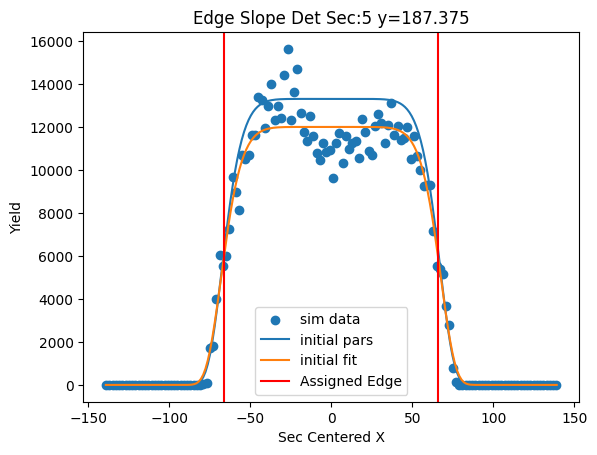

[ 1.22914679e+04 -1.54811022e-01  5.01600488e+01  8.72797048e+00]


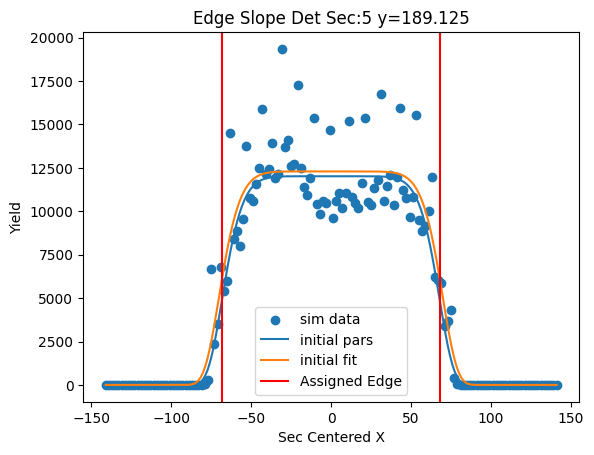

[ 1.19877840e+04 -1.91832184e-01  5.14635429e+01  9.29955430e+00]


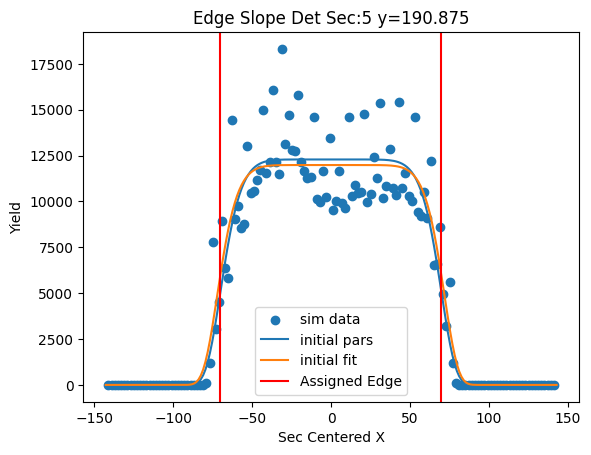

[1.17584327e+04 2.07659843e-01 5.25460525e+01 1.00783767e+01]


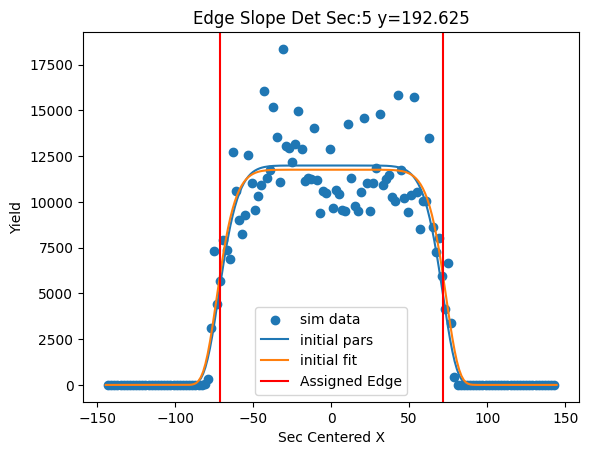

[1.05598005e+04 2.56238385e-01 5.28732670e+01 1.04467777e+01]


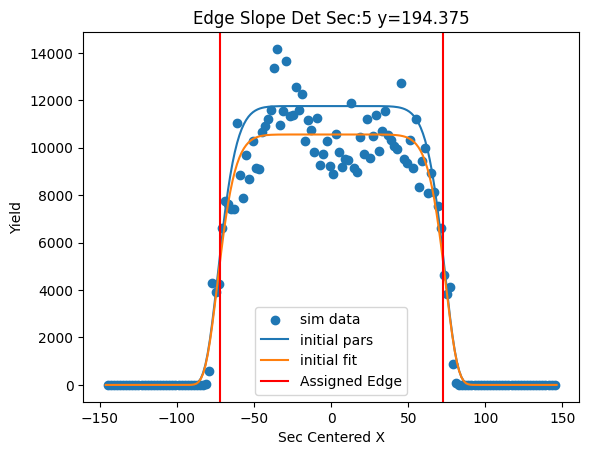

[1.04500245e+04 2.58624465e-01 5.33625212e+01 1.09544520e+01]


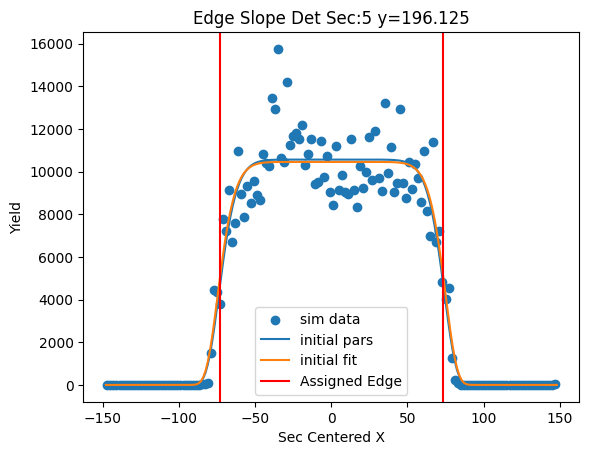

[1.06609738e+04 3.40581447e-02 5.42540415e+01 1.22709991e+01]


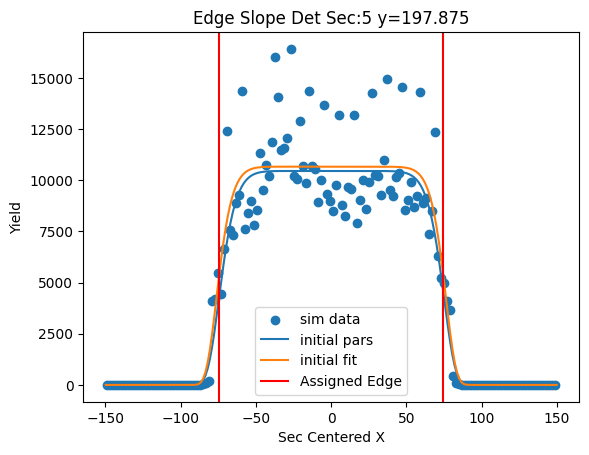

[ 9.81310595e+03 -6.95403120e-02  5.48920088e+01  1.19686990e+01]


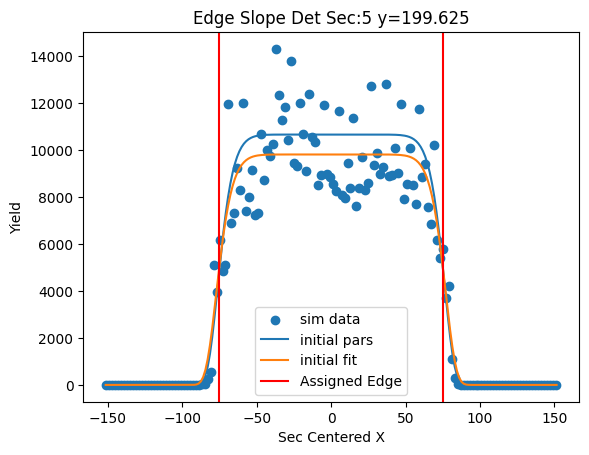

[8.78488873e+03 1.89947511e-01 5.49060650e+01 1.02513488e+01]


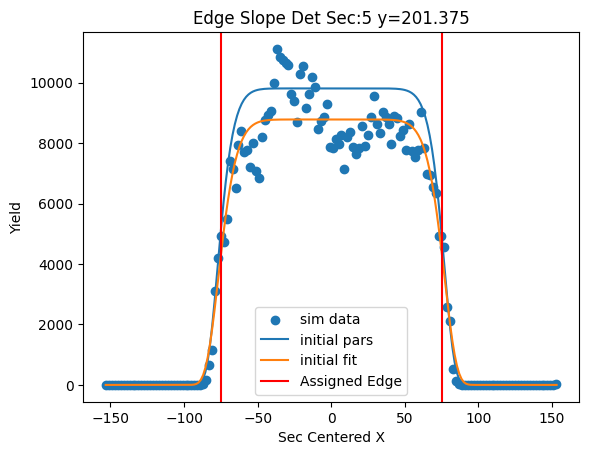

[9.21100210e+03 2.31759196e-01 5.61619843e+01 1.15447734e+01]


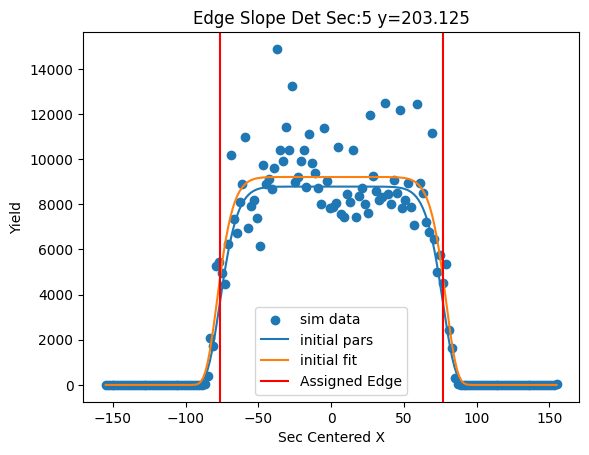

[8.98639178e+03 3.74842744e-01 5.72337715e+01 1.17291052e+01]


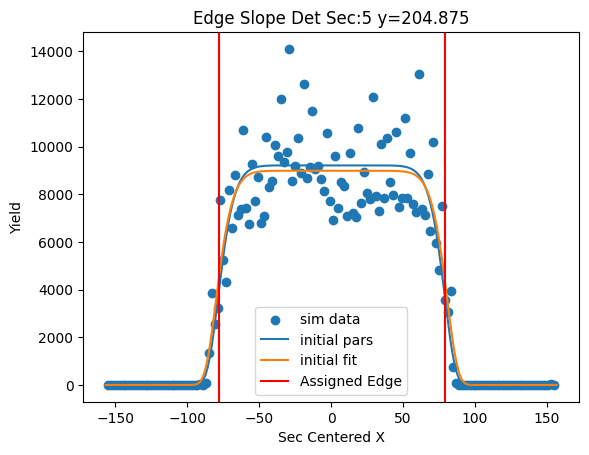

[ 8.70161248e+03 -1.19361727e-02  5.81204515e+01  1.15248165e+01]


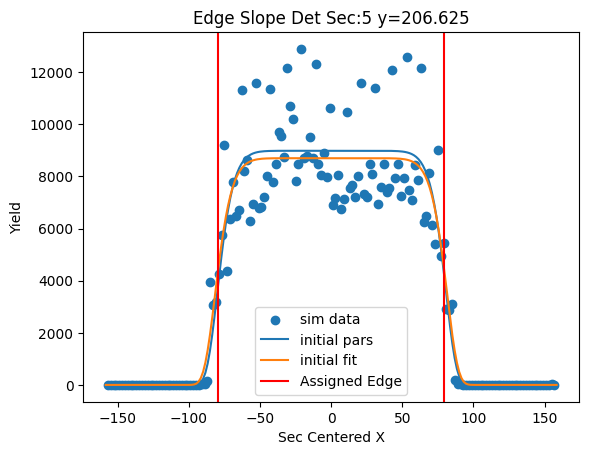

[7.57708552e+03 1.28169472e-02 5.84685552e+01 1.05110735e+01]


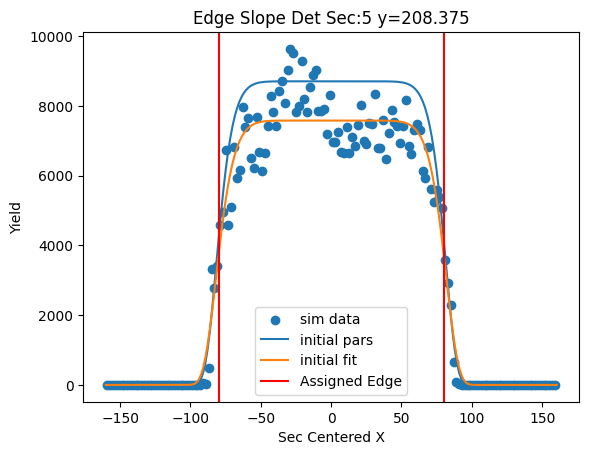

[7.62549820e+03 2.03311368e-01 5.92476868e+01 1.09957706e+01]


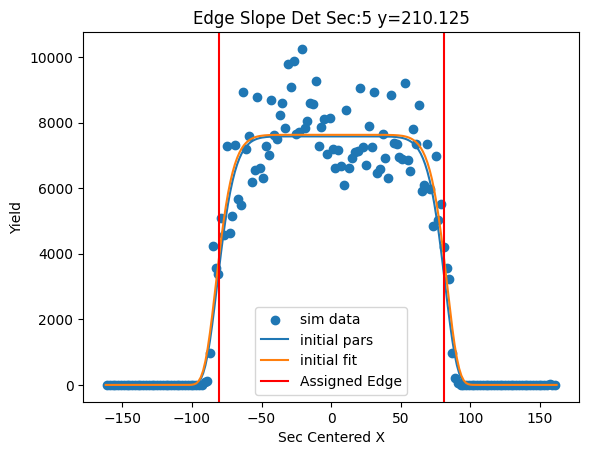

[7.91691244e+03 4.69139967e-01 6.04625876e+01 1.30489585e+01]


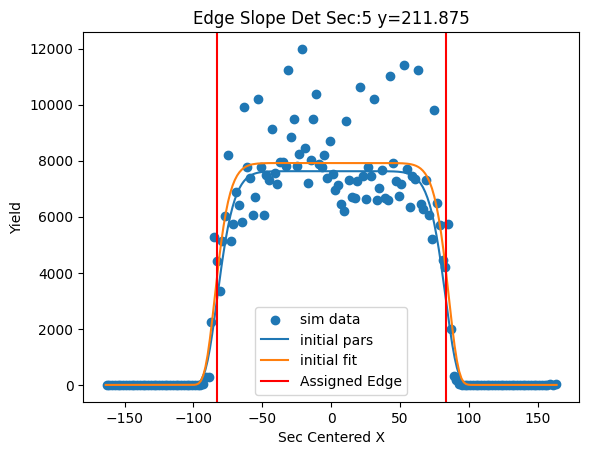

[7.28531928e+03 6.15009028e-01 6.09615879e+01 1.34237990e+01]


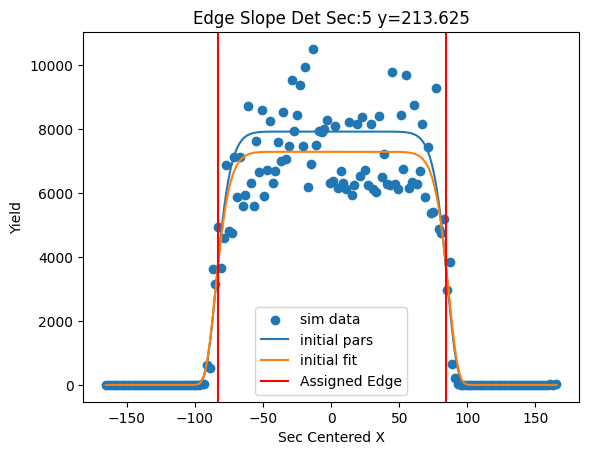

[6.59349960e+03 4.86147621e-01 6.12685554e+01 1.22340577e+01]


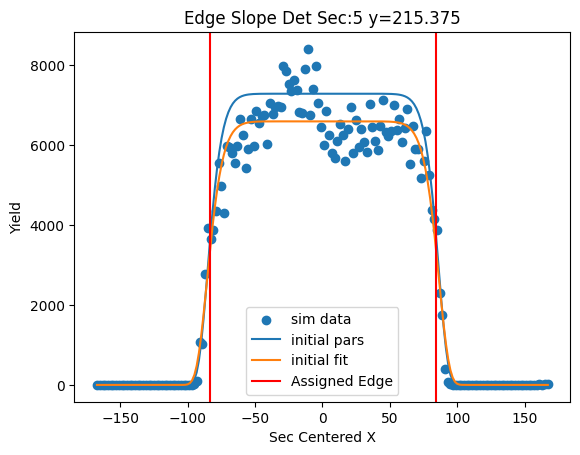

[6.99001514e+03 3.53236883e-01 6.23649652e+01 1.30081396e+01]


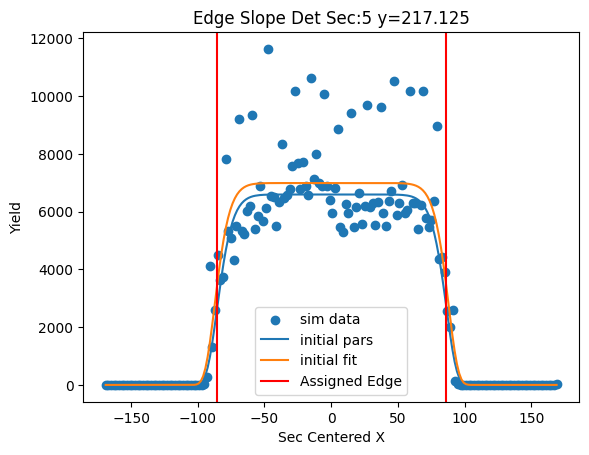

[6.69385847e+03 4.25786797e-02 6.32484204e+01 1.32963204e+01]


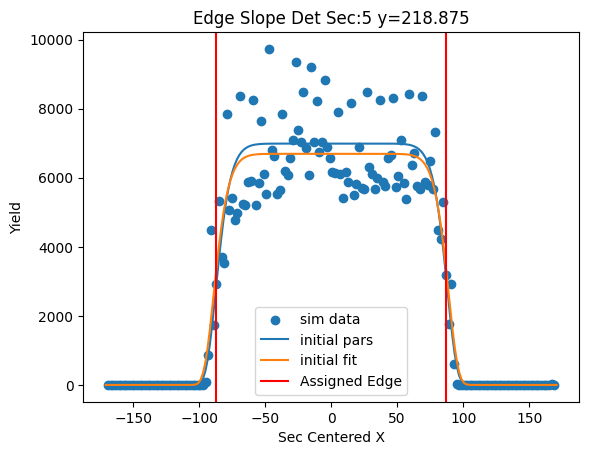

[6.50854512e+03 1.70166020e-01 6.42192937e+01 1.30343379e+01]


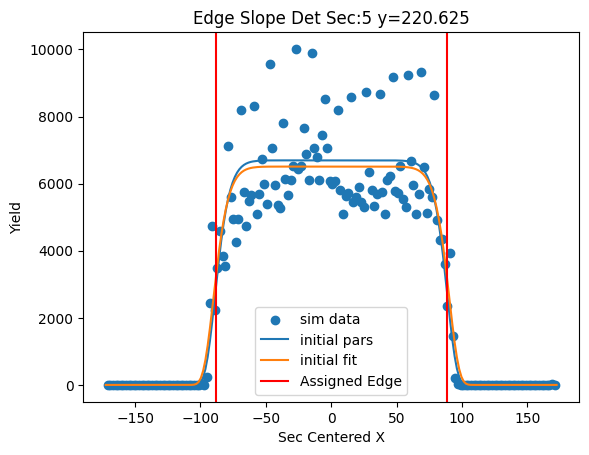

[5.78626815e+03 5.89500861e-03 6.45183403e+01 1.28854554e+01]


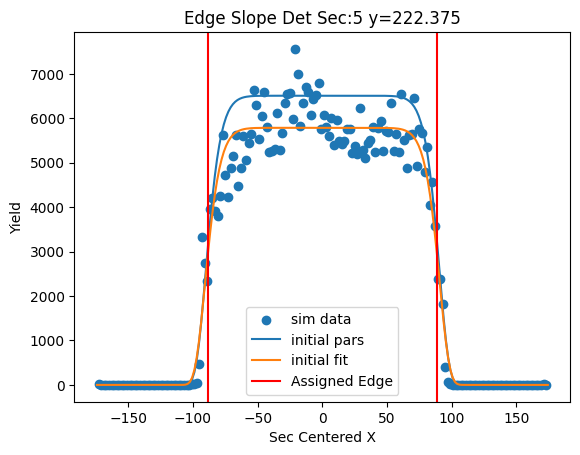

[ 5.99648120e+03 -3.70631316e-01  6.54902289e+01  1.48168058e+01]


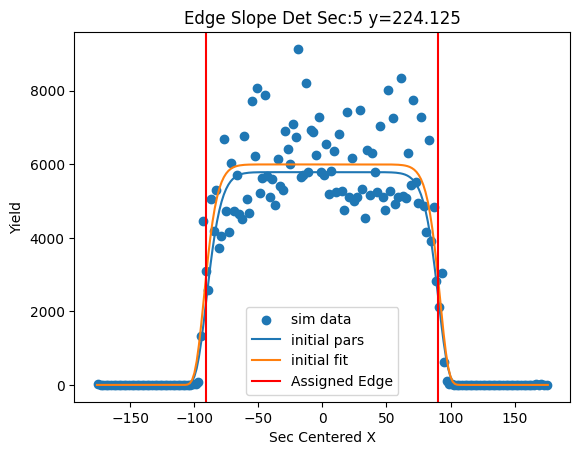

[ 6.20797292e+03 -8.15852233e-01  6.62494099e+01  1.63058450e+01]


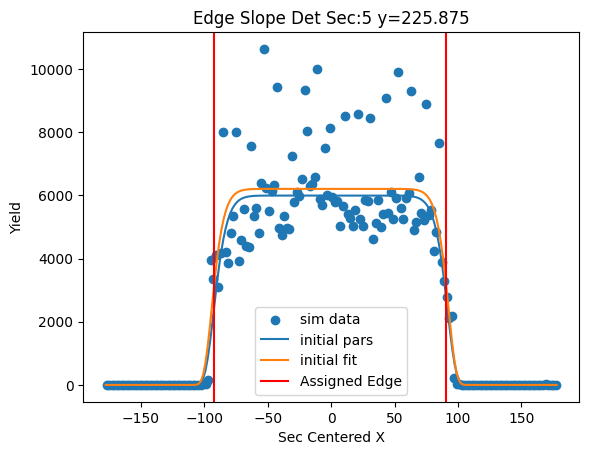

[ 5.57674110e+03 -8.61555924e-01  6.66784454e+01  1.50399647e+01]


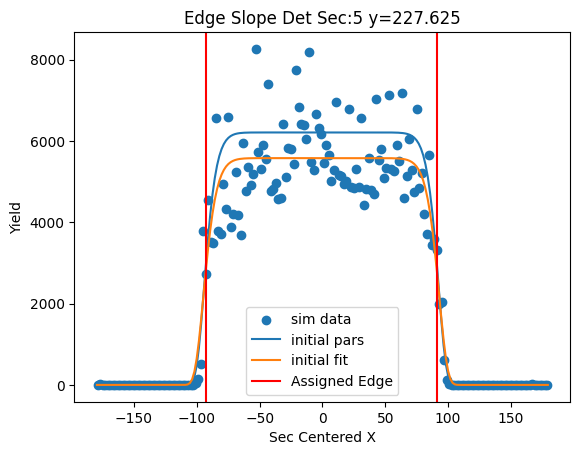

[ 5.08302641e+03 -6.68839578e-01  6.65815937e+01  1.22691798e+01]


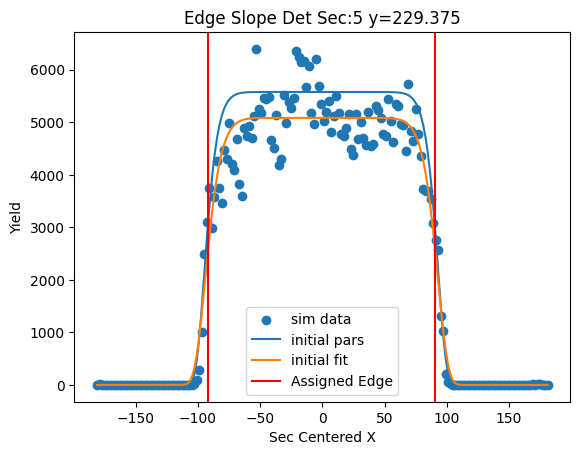

[ 5.66863388e+03 -6.49125995e-01  6.72132180e+01  1.16831804e+01]


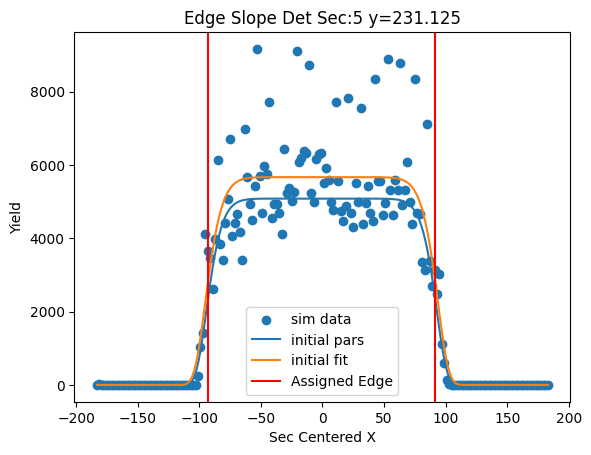

[ 5.55529331e+03 -6.56245773e-01  6.74167775e+01  1.00681234e+01]


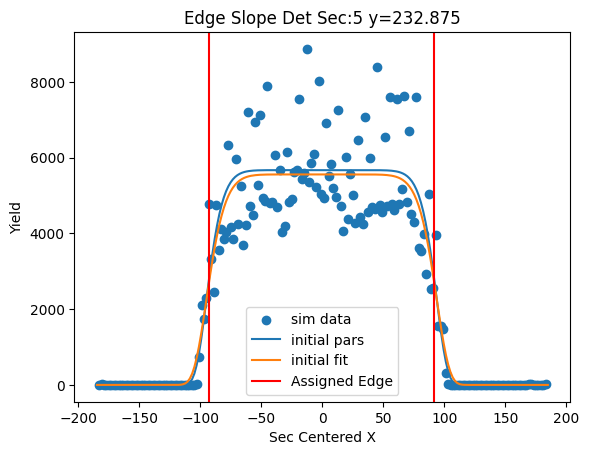

[ 5.36235180e+03 -1.13965540e+00  6.83042433e+01  1.00501825e+01]


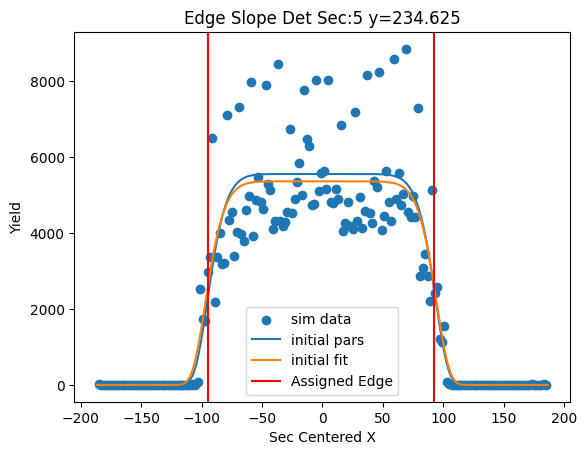

[ 4.56309497e+03 -1.54482747e+00  6.82104899e+01  9.24873777e+00]


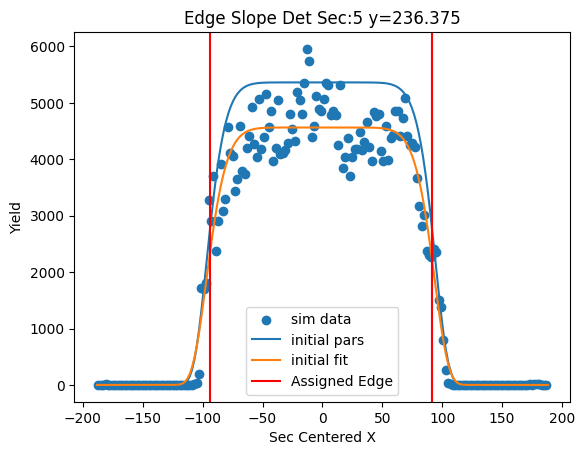

[ 4.82929462e+03 -1.32228631e+00  6.97492961e+01  1.05474198e+01]


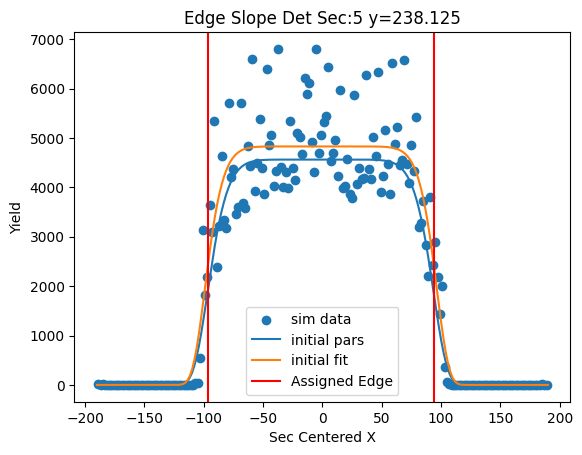

[ 5.01811051e+03 -1.07536198e+00  7.09514096e+01  1.17327944e+01]


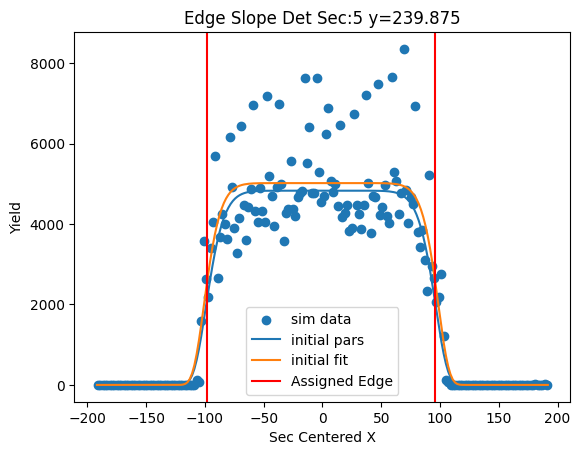

[ 4.48777032e+03 -7.08511404e-01  7.14418840e+01  1.23504314e+01]


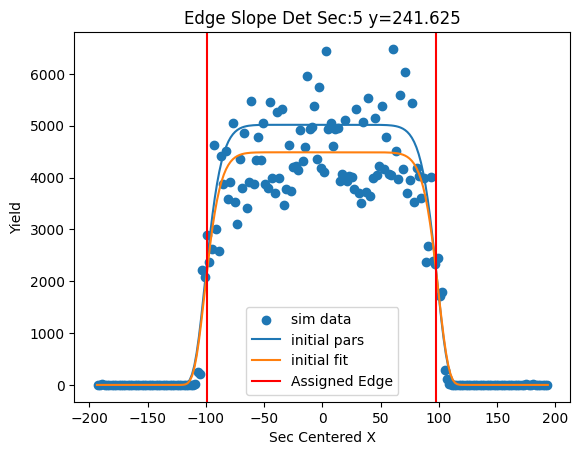

[ 4.12921738e+03 -8.36736223e-01  7.15810261e+01  1.23873040e+01]


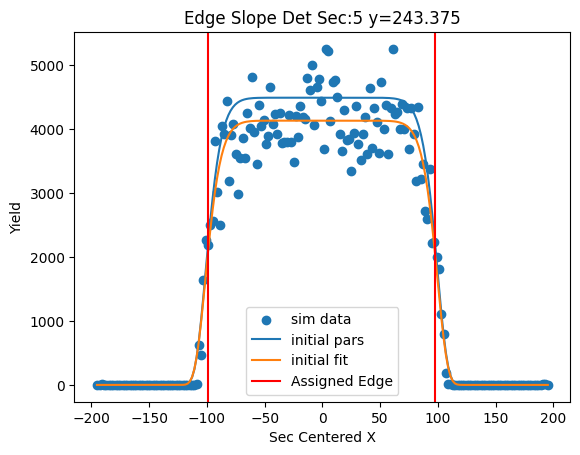

[ 4.40700042e+03 -7.37636262e-01  7.23742077e+01  1.39256396e+01]


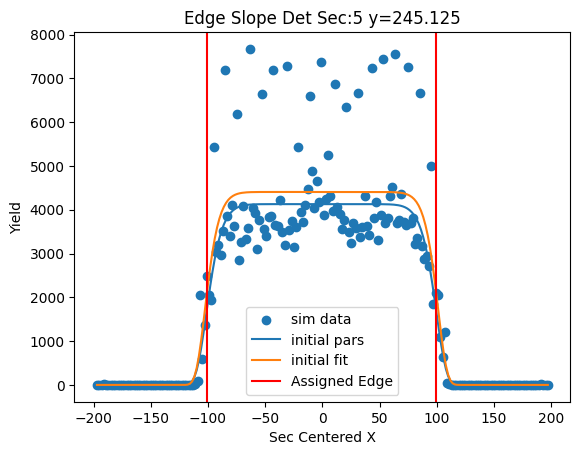

[ 4.03730137e+03 -6.40982013e-01  7.26488375e+01  1.28636057e+01]


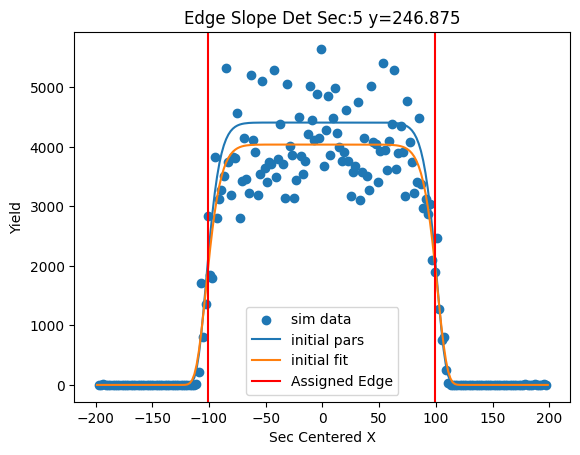

[ 3.91006965e+03 -4.76372938e-01  7.31811474e+01  1.30688726e+01]


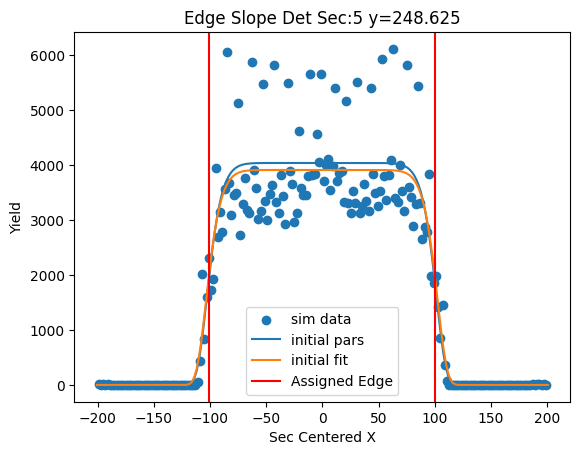

[ 3.40905672e+03 -6.95898258e-02  7.29712016e+01  1.22792340e+01]


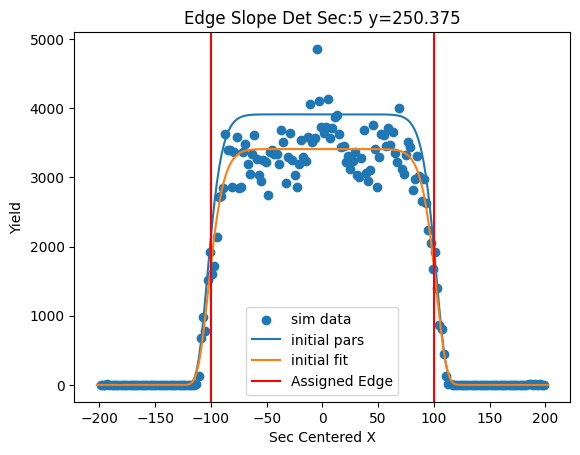

[3.65183477e+03 2.26010878e-01 7.38528121e+01 1.29469843e+01]


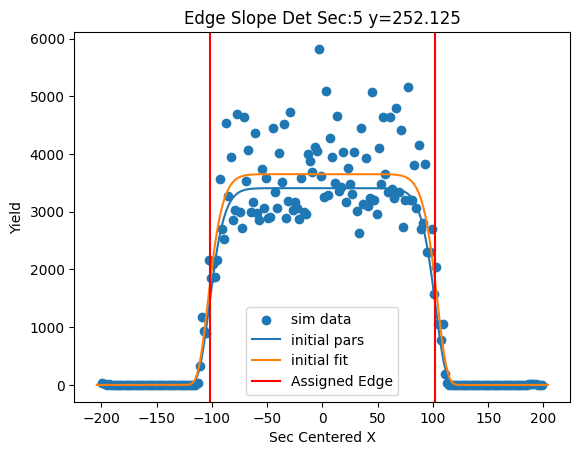

[3.78000513e+03 1.05802700e-01 7.47503254e+01 1.24749344e+01]


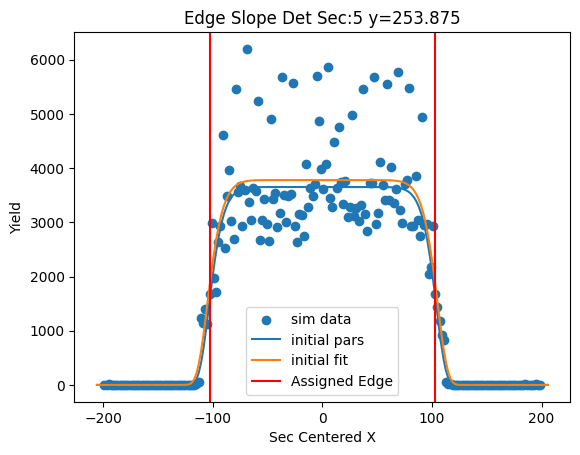

[3.34767391e+03 1.36955395e-01 7.50783135e+01 1.16201567e+01]


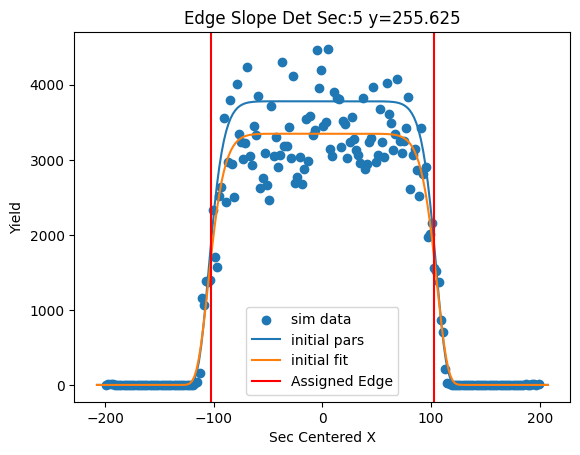

[3.21079821e+03 4.08421814e-01 7.55726871e+01 1.14784461e+01]


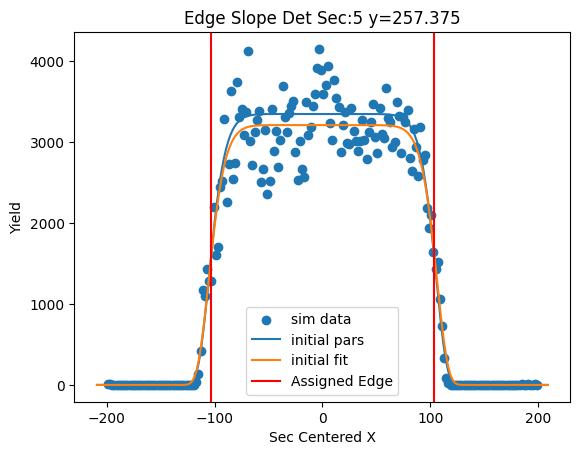

[3.75384201e+03 5.04774694e-01 7.67107061e+01 1.25433395e+01]


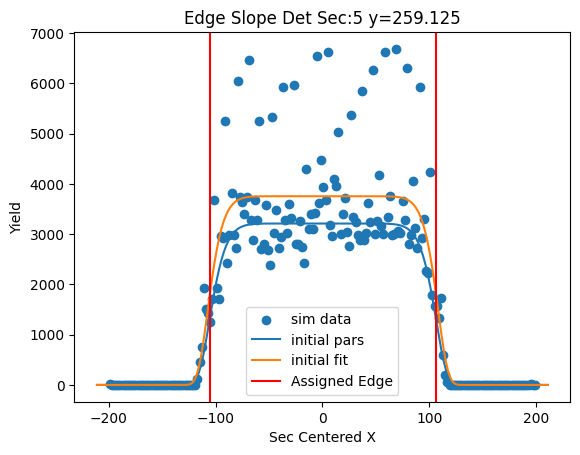

[3.67535546e+03 6.49340807e-01 7.68548625e+01 1.21229820e+01]


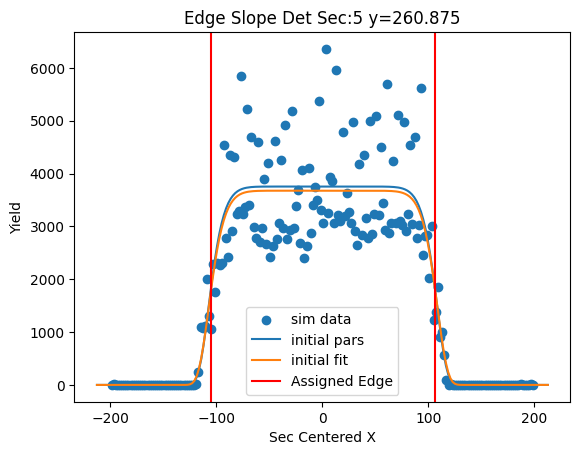

[3.58448473e+03 4.34032930e-02 7.76086093e+01 1.19404739e+01]


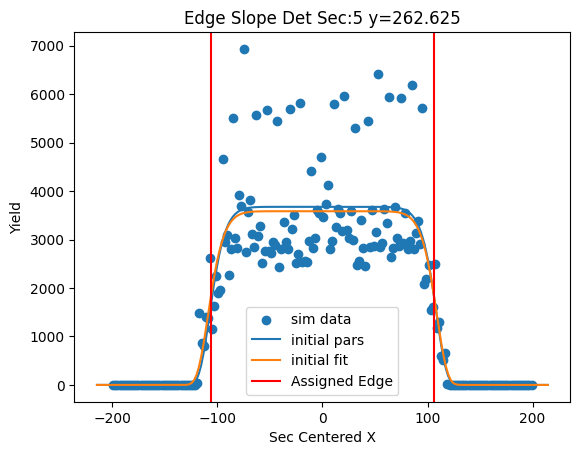

[ 2.88066749e+03 -7.14815889e-02  7.73585987e+01  1.09771031e+01]


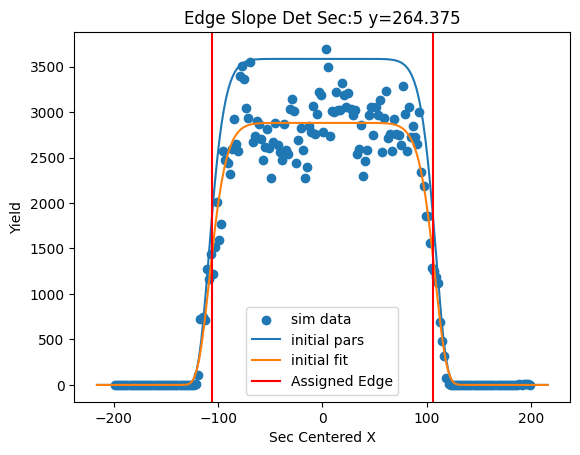

[ 3.15195598e+03 -2.04117670e-01  7.79916658e+01  1.11654505e+01]


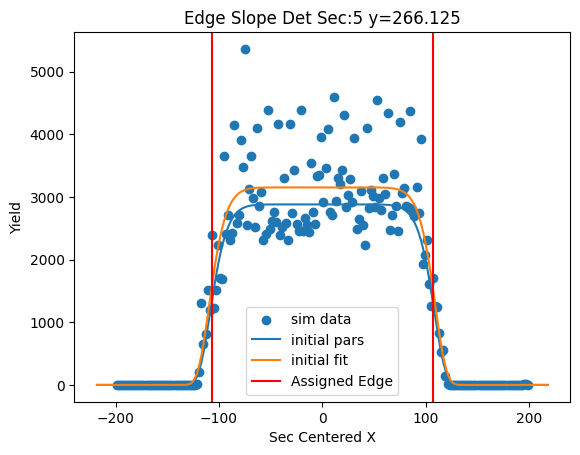

[ 3.25265443e+03 -6.62978254e-02  7.85723434e+01  1.11690148e+01]


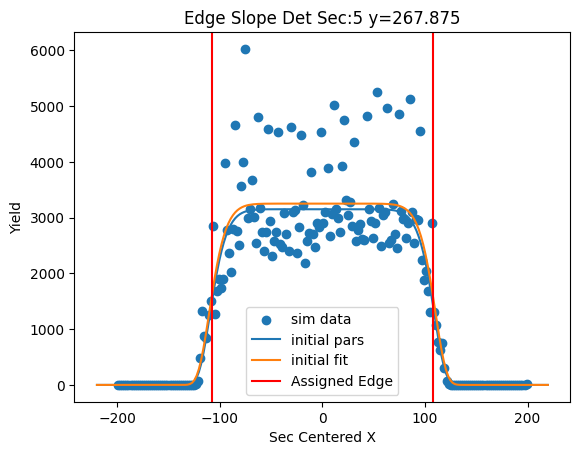

[2.79666179e+03 1.82085744e-01 7.83433659e+01 1.08084111e+01]


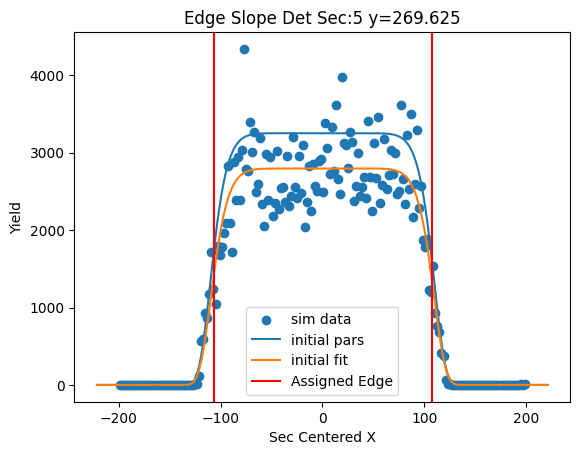

[2.72996167e+03 3.99076890e-01 7.83989541e+01 1.07471642e+01]


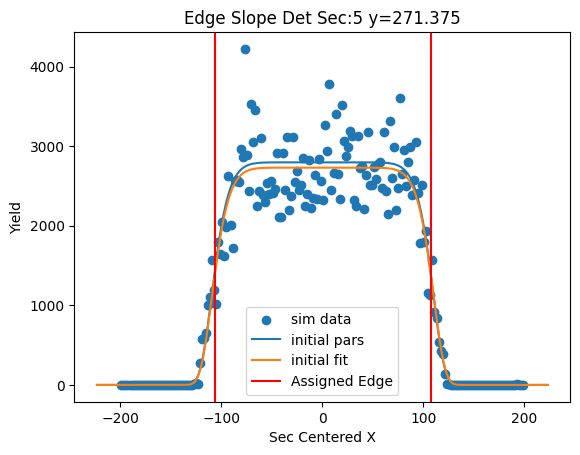

[3.01732220e+03 7.16974550e-02 7.97931635e+01 1.12990733e+01]


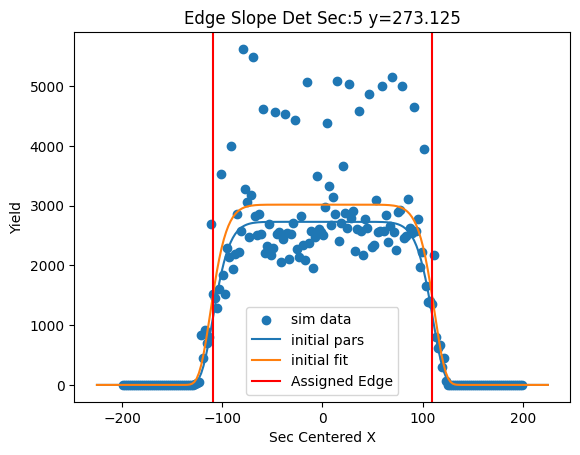

[ 2.75552637e+03 -1.35219575e-01  8.04853511e+01  1.10726262e+01]


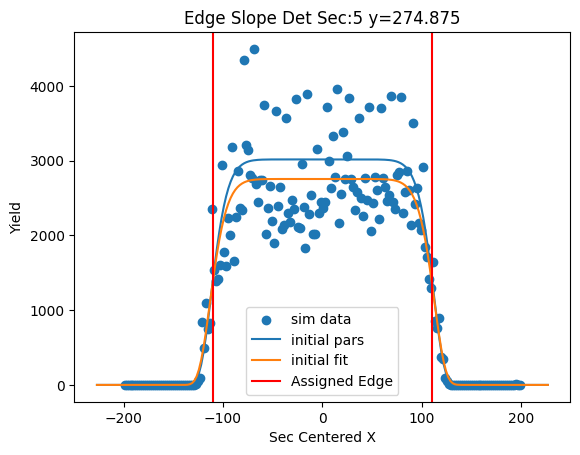

[2.35121678e+03 1.53479508e-01 8.04374657e+01 1.07173145e+01]


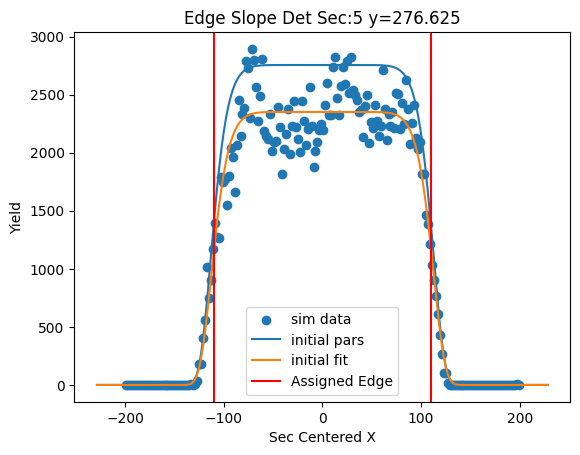

[2.69150055e+03 1.75719578e-01 8.24750617e+01 1.26323755e+01]


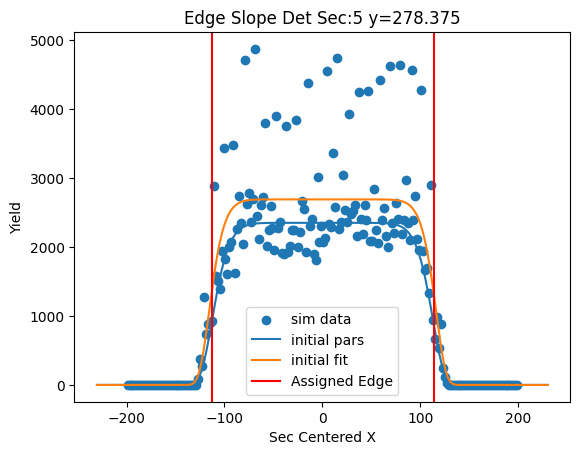

[2.65681350e+03 4.12709742e-01 8.30190689e+01 1.32503007e+01]


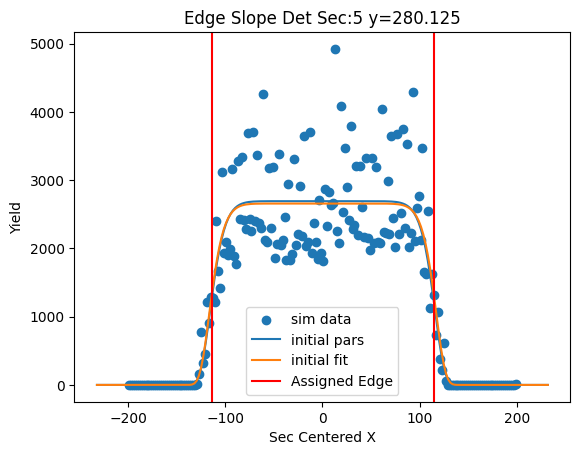

[ 2.65000736e+03 -1.20361655e-01  8.41210931e+01  1.32826536e+01]


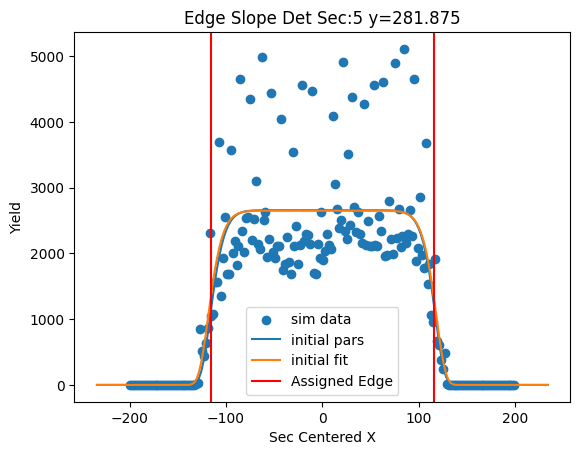

[ 2.14216073e+03 -5.40315655e-01  8.41199844e+01  1.28427648e+01]


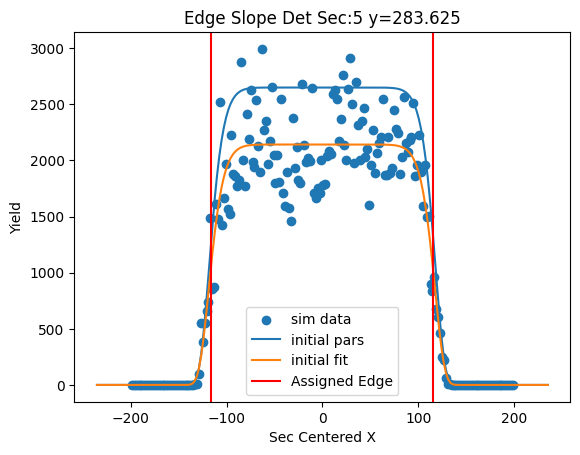

[ 2.10044656e+03 -4.74470580e-01  8.47402032e+01  1.27754468e+01]


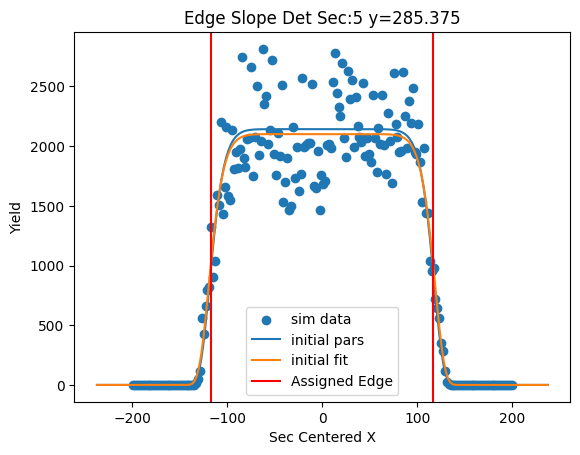

[ 2.39450881e+03 -2.52802402e-01  8.61194370e+01  1.33762046e+01]


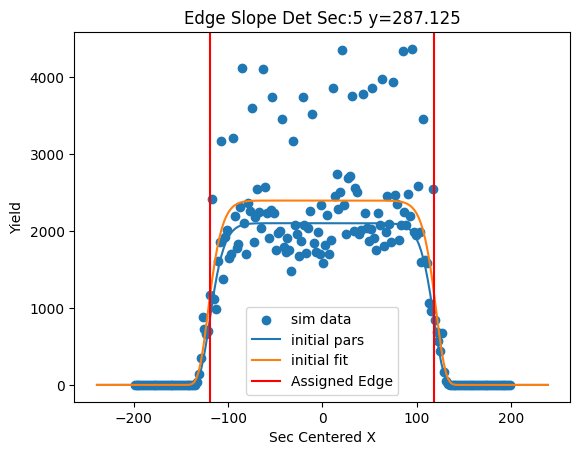

[ 2.17685707e+03 -1.33378517e-02  8.63175532e+01  1.29004997e+01]


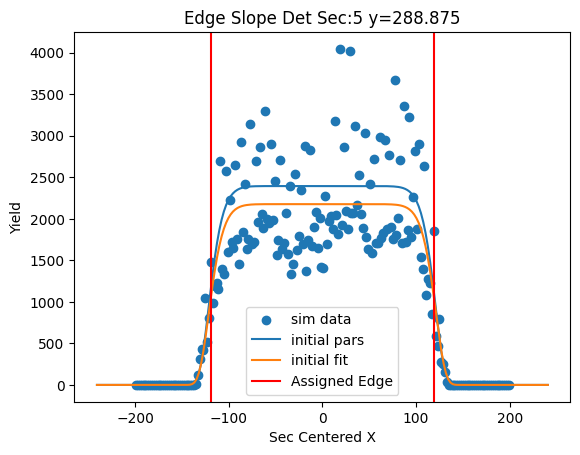

[ 1.77217373e+03 -4.55443295e-01  8.62934918e+01  1.21629198e+01]


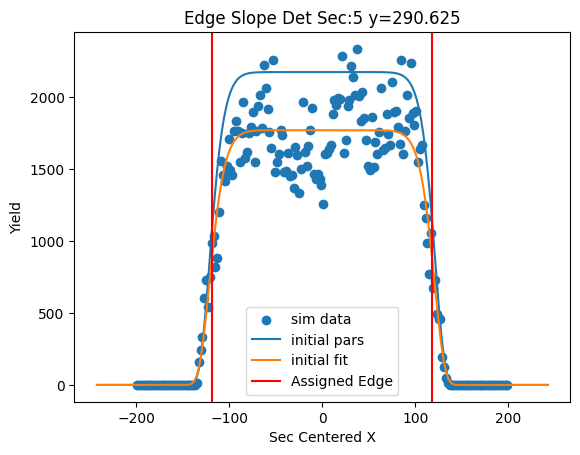

[ 2.00142087e+03 -9.82322570e-01  8.75796209e+01  1.32543388e+01]


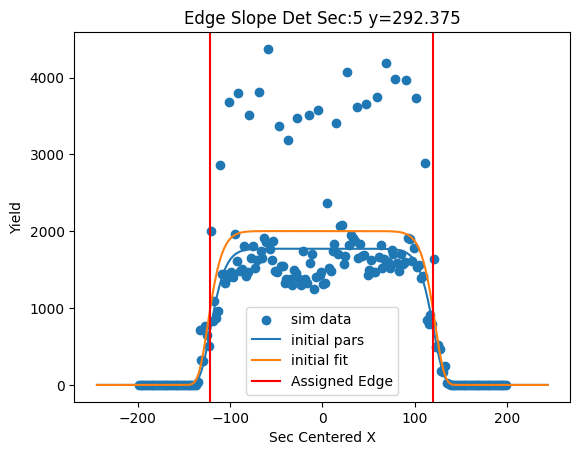

[ 1.82408811e+03 -1.48620628e+00  8.84808343e+01  1.22013974e+01]


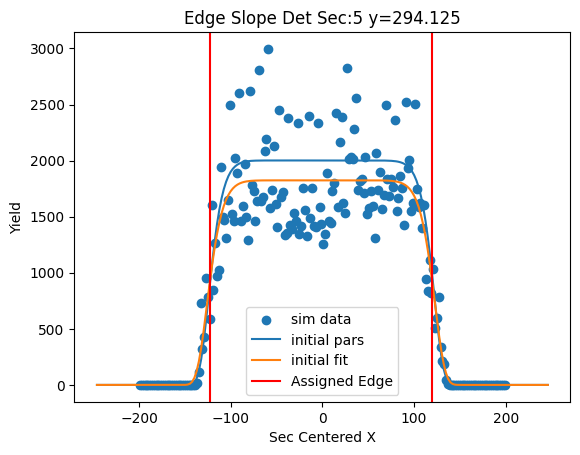

[ 1.82495231e+03 -1.36723502e+00  8.95636127e+01  1.27751611e+01]


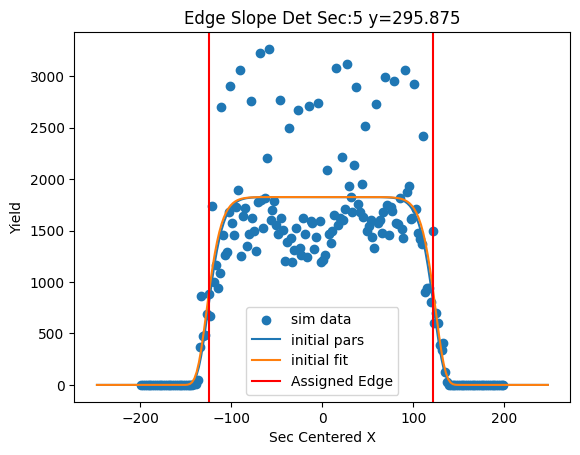

[ 1.50787066e+03 -9.67475024e-01  8.96577237e+01  1.25702532e+01]


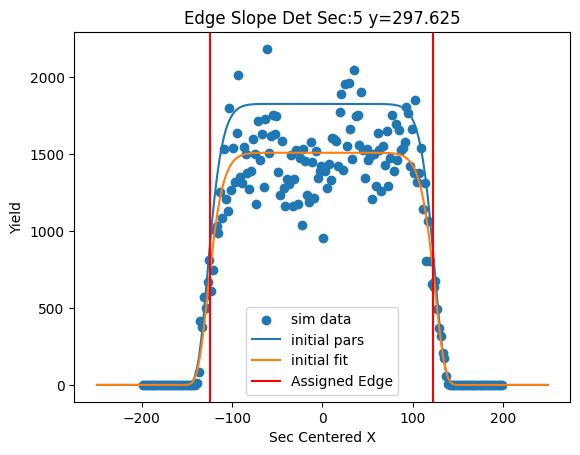

[ 1.57488242e+03 -9.88448860e-01  9.05253073e+01  1.36005169e+01]


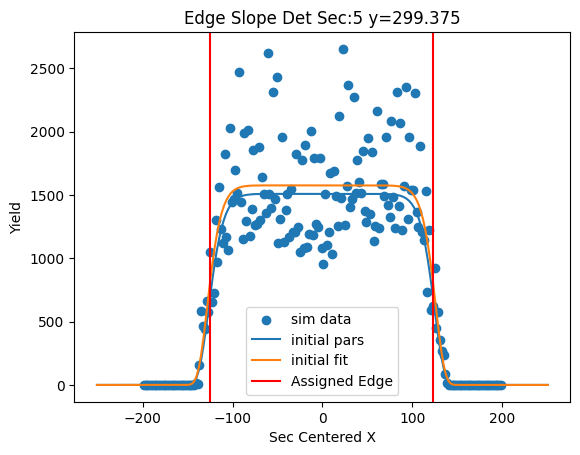

[1692.63533094   -1.91244518   91.31397644   13.64609331]


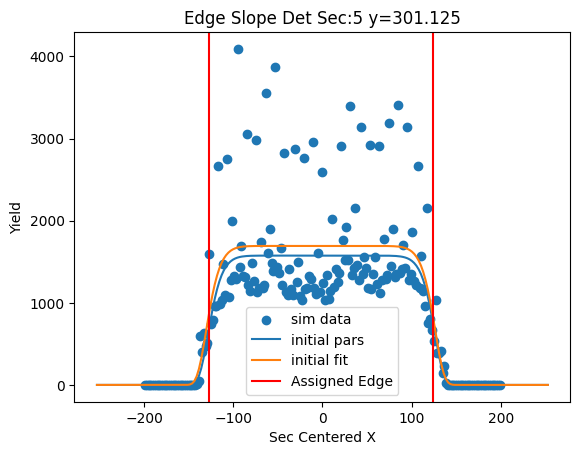

[1366.005281     -1.48256546   91.8388273    13.13961896]


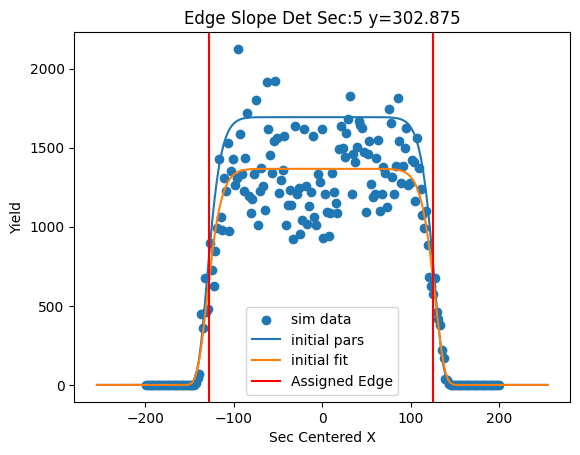

[1149.48167723   -1.27342783   91.85792807   12.72279826]


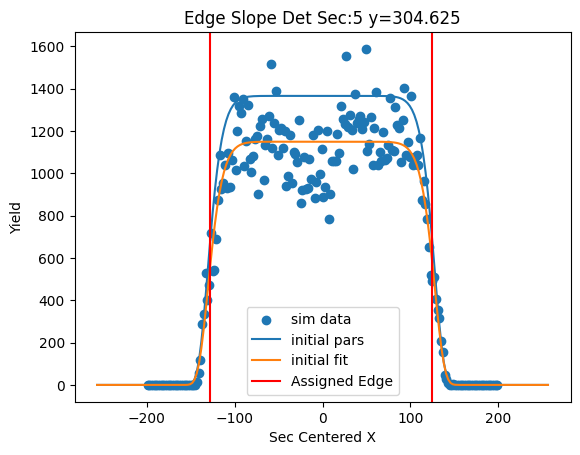

[ 1.36665096e+03 -1.69376501e-01  9.27981685e+01  1.38548126e+01]


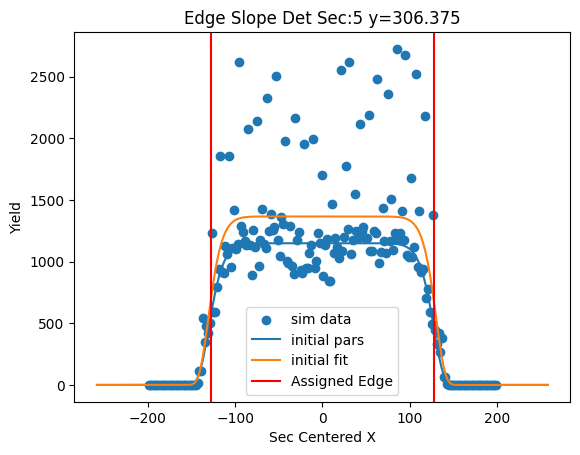

[ 1.35456813e+03 -4.29828717e-01  9.26050855e+01  1.36453557e+01]


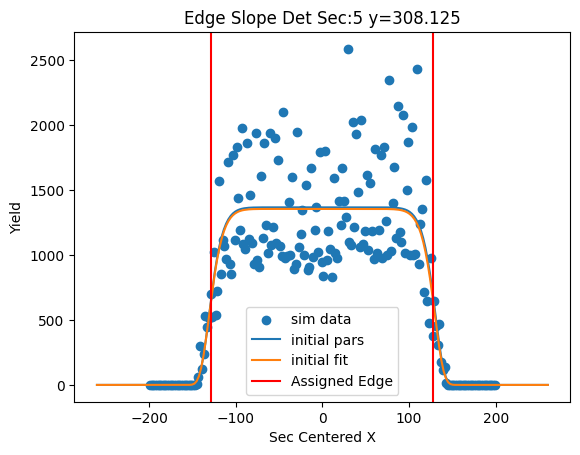

[ 1.38455299e+03 -3.54367346e-01  9.34435991e+01  1.33785510e+01]


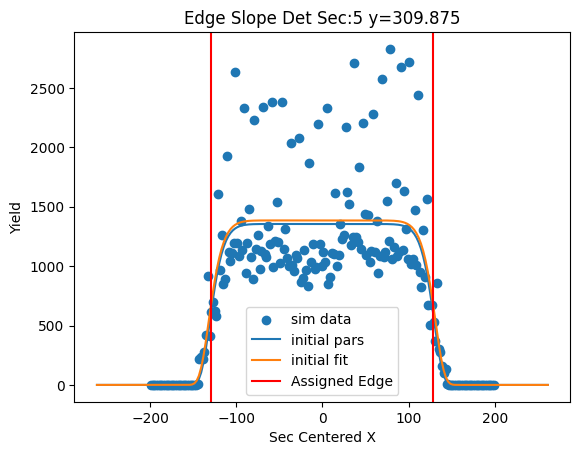

[ 1.12537227e+03 -2.47286877e-01  9.35453529e+01  1.26908165e+01]


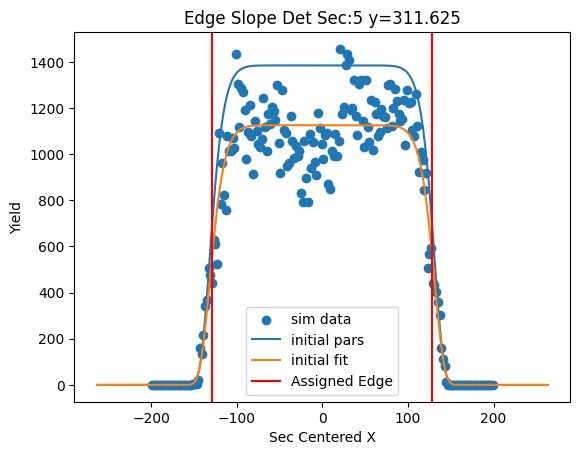

[ 1.23923034e+03 -6.04478920e-01  9.44168395e+01  1.26730059e+01]


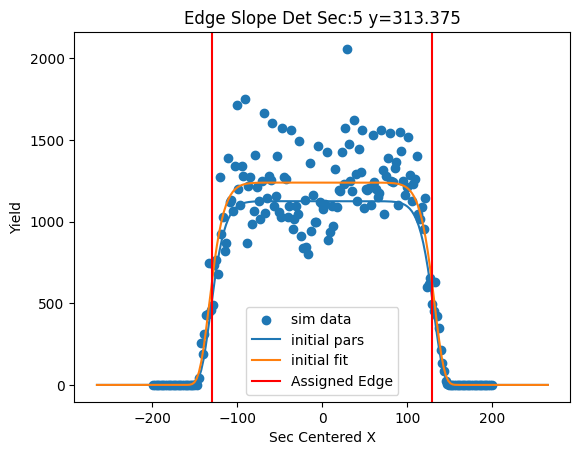

[1.56103292e+03 3.63866078e-02 9.58316962e+01 1.33323975e+01]


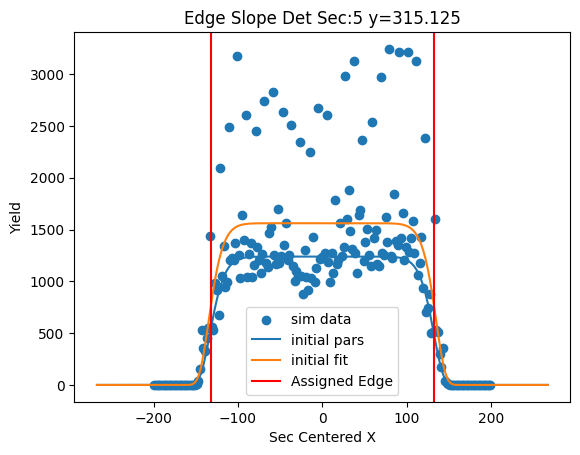

[1.49777465e+03 2.69553976e-01 9.64336968e+01 1.36942518e+01]


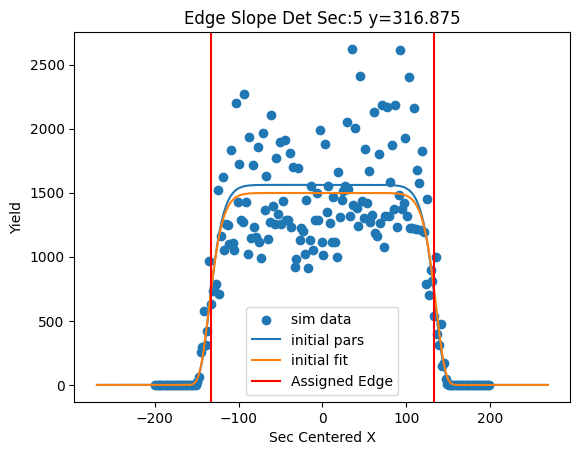

[ 1.32299838e+03 -5.64833753e-01  9.63962454e+01  1.33883708e+01]


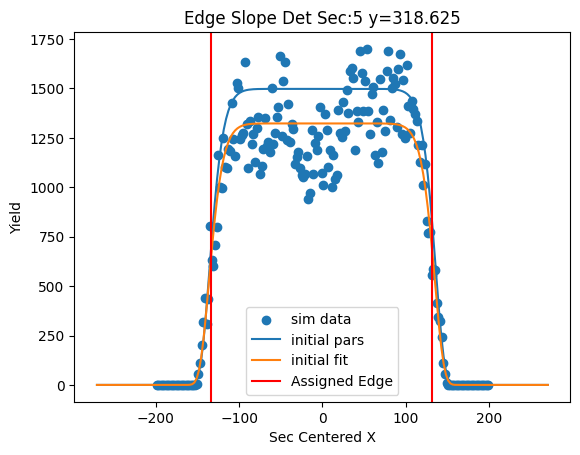

[ 1.52524311e+03 -5.05222889e-01  9.72877326e+01  1.45335979e+01]


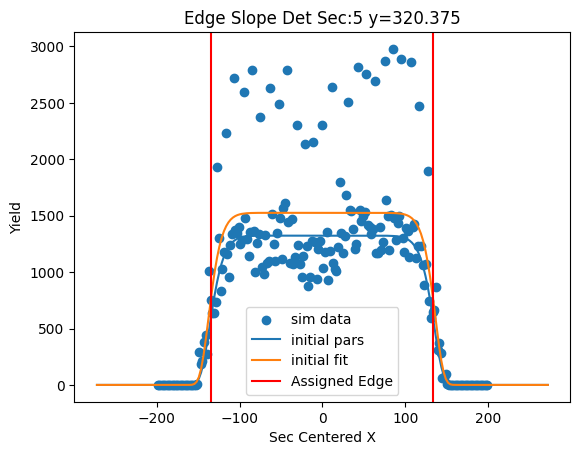

[ 1.48504996e+03 -1.22519673e+00  9.81146391e+01  1.37005308e+01]


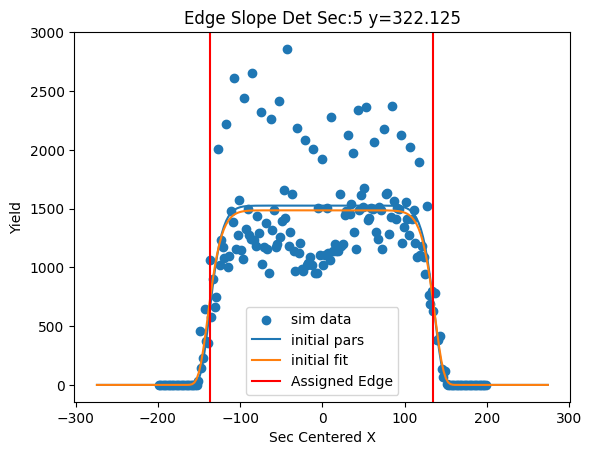

[ 1.47598534e+03 -7.70072243e-01  9.90230249e+01  1.46572613e+01]


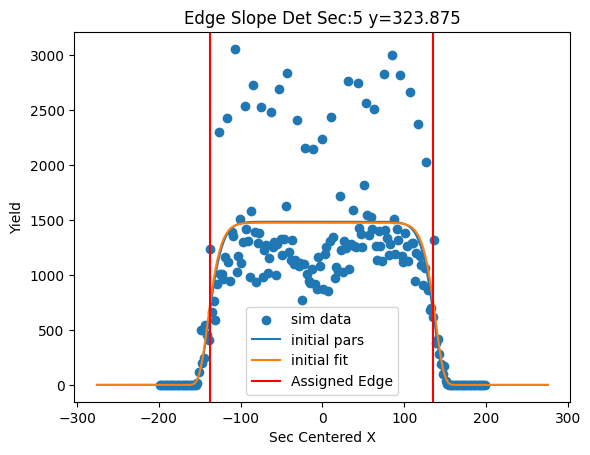

[ 1.18530977e+03 -5.50645605e-01  9.88139921e+01  1.41707161e+01]


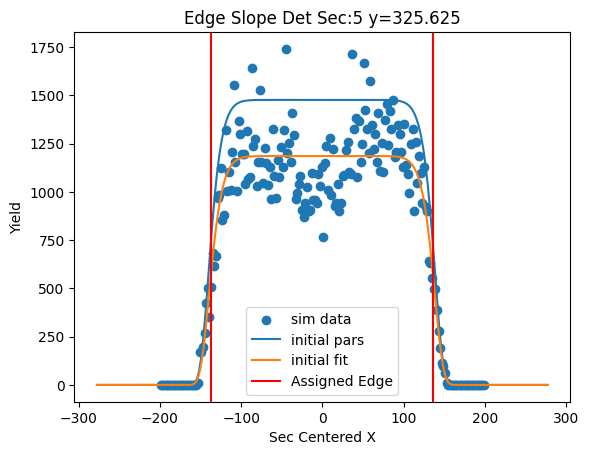

[ 1.33185895e+03 -8.79615563e-01  9.95877019e+01  1.42006001e+01]


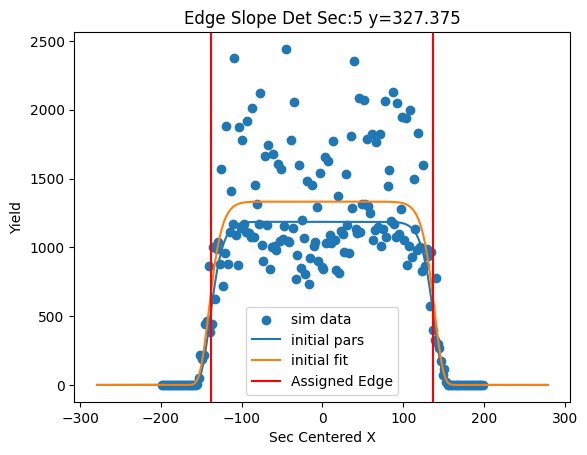

[ 1.45030320e+03 -1.19430970e+00  1.00347636e+02  1.38873568e+01]


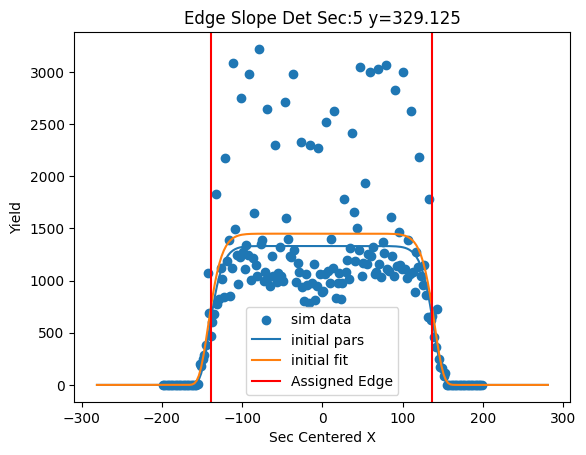

[ 1.28287690e+05 -1.21888515e+00  1.46397797e+01  5.77081234e+00]


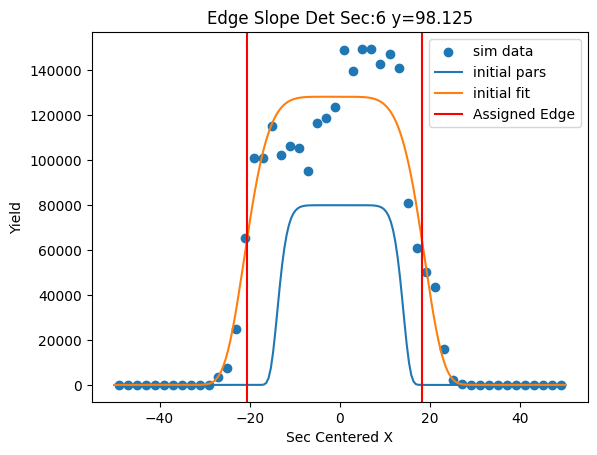

[ 1.28335927e+05 -1.24207860e+00  1.51290108e+01  5.29786699e+00]


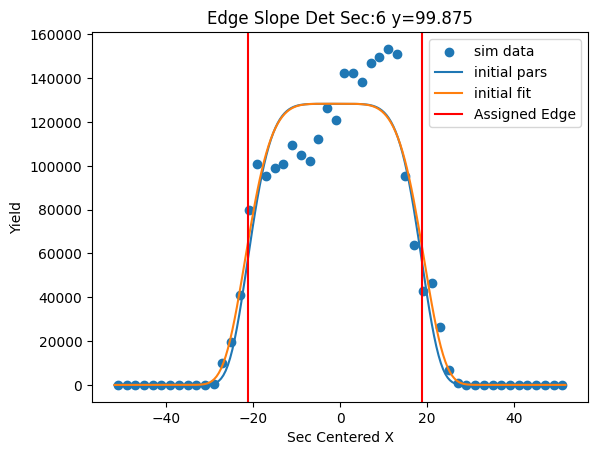

[ 1.27818773e+05 -1.21285856e+00  1.58225734e+01  5.10596560e+00]


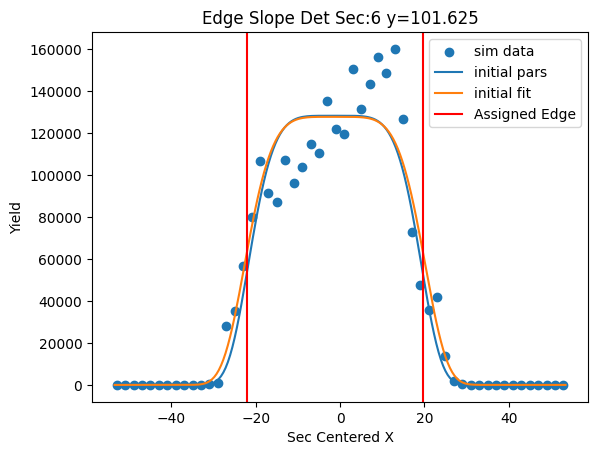

[ 1.21886981e+05 -1.27296696e+00  1.68785707e+01  5.27444413e+00]


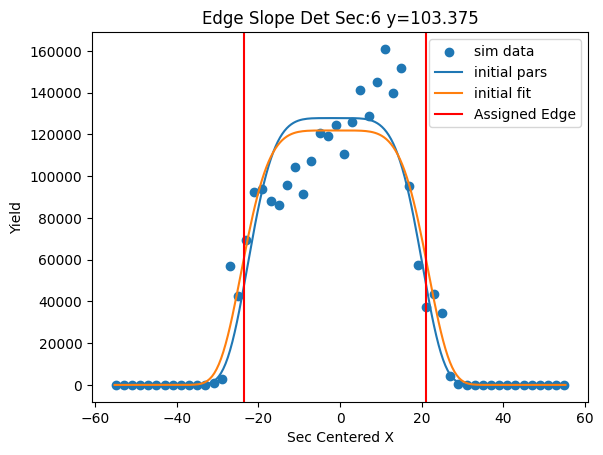

[ 1.11078440e+05 -1.14486370e+00  1.77451116e+01  5.69115977e+00]


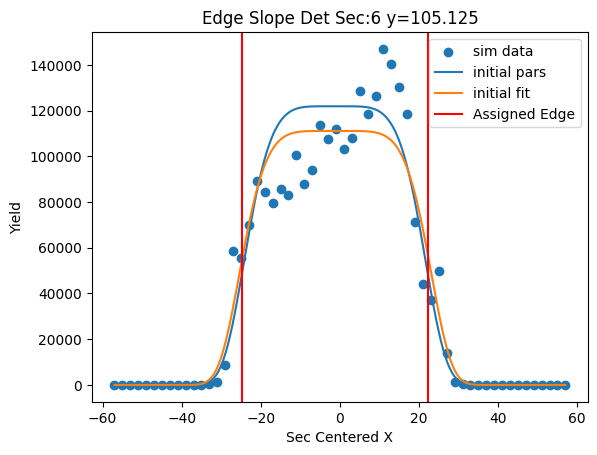

[ 1.03870254e+05 -1.04461424e+00  1.83939685e+01  5.90135702e+00]


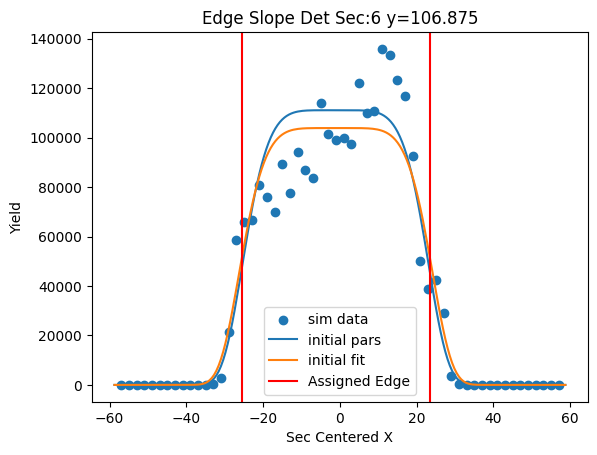

[ 9.86575626e+04 -1.31573221e+00  1.90654913e+01  6.39121123e+00]


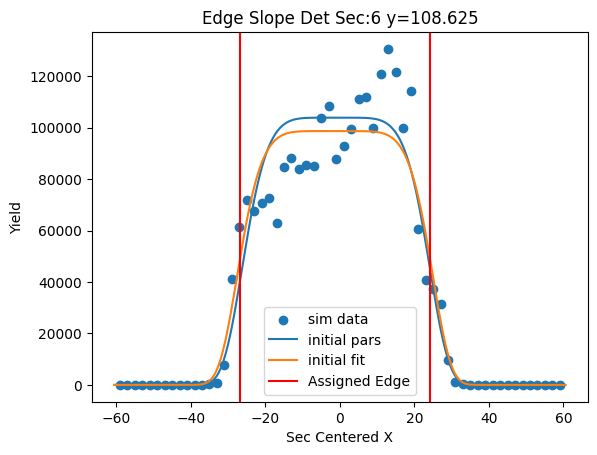

[ 9.20483418e+04 -1.61471363e+00  1.97086089e+01  7.09254736e+00]


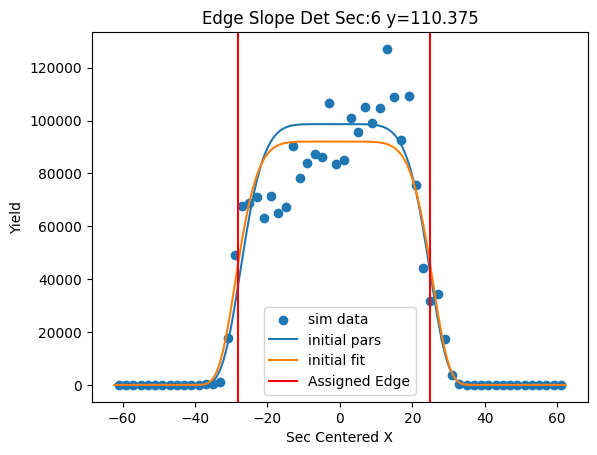

[ 8.39625295e+04 -1.94762830e+00  2.01373583e+01  7.97457917e+00]


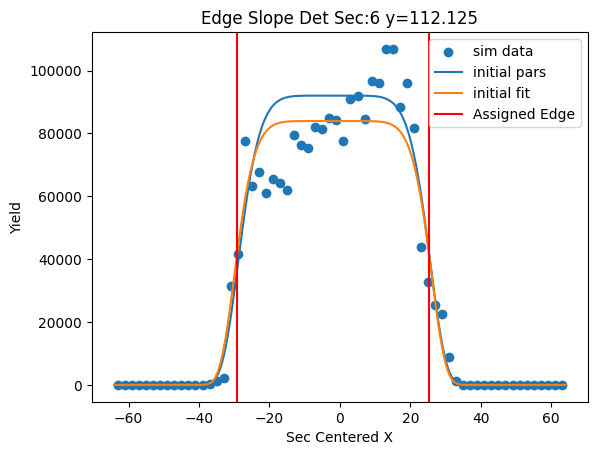

[ 8.01949855e+04 -2.46969157e+00  2.06843991e+01  9.70487633e+00]


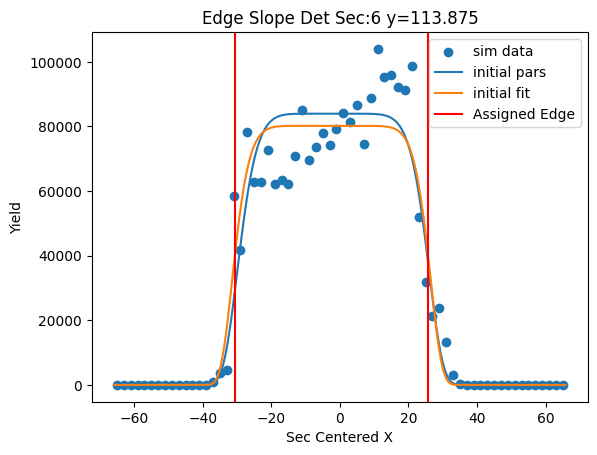

[ 7.73273494e+04 -2.81552454e+00  2.11581722e+01  1.29799189e+01]


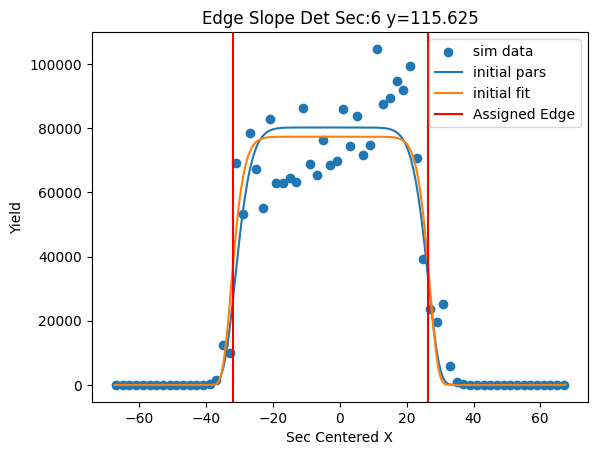

[ 7.35322063e+04 -2.24266007e+00  2.23515092e+01  9.97098977e+00]


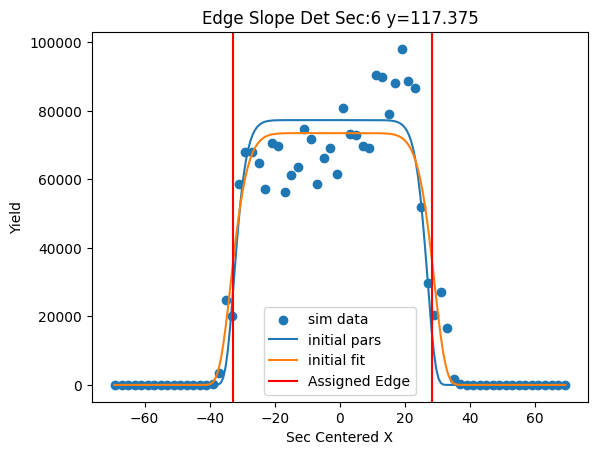

[ 6.82828472e+04 -1.81553134e+00  2.31427222e+01  9.19172015e+00]


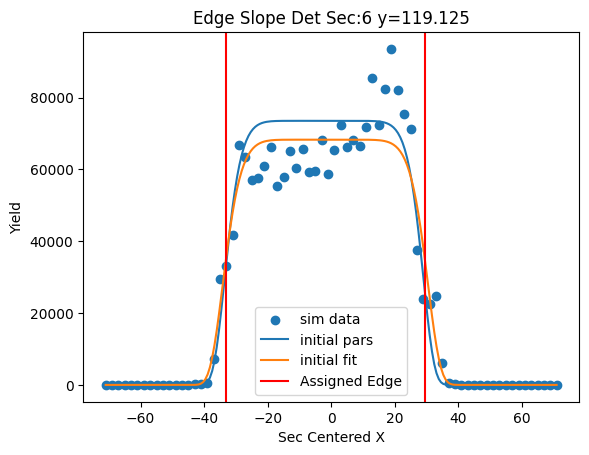

[ 6.61757716e+04 -1.85008456e+00  2.38613310e+01  9.41676178e+00]


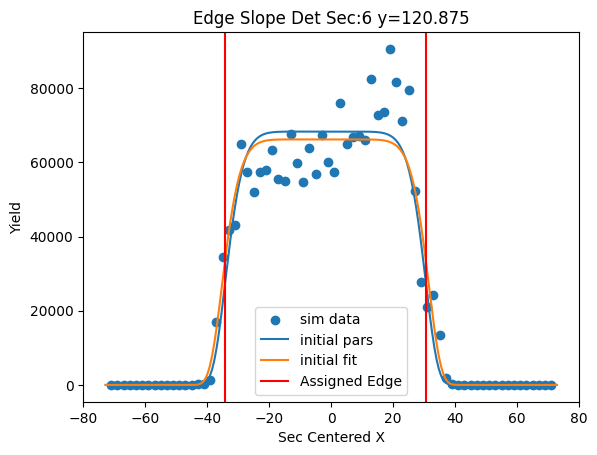

[ 6.32140617e+04 -2.01951715e+00  2.46586448e+01  9.80796215e+00]


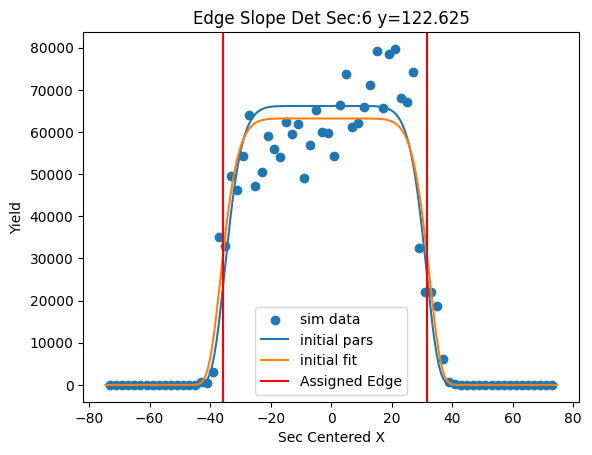

[ 5.66355722e+04 -1.95892908e+00  2.51824255e+01  9.67815553e+00]


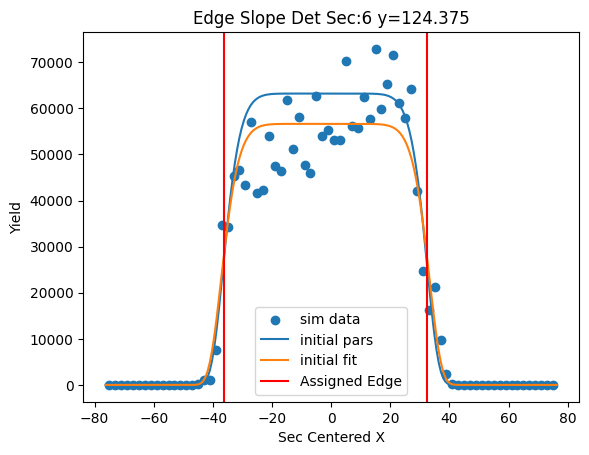

[ 5.12870029e+04 -1.47524264e+00  2.54103687e+01  8.05189405e+00]


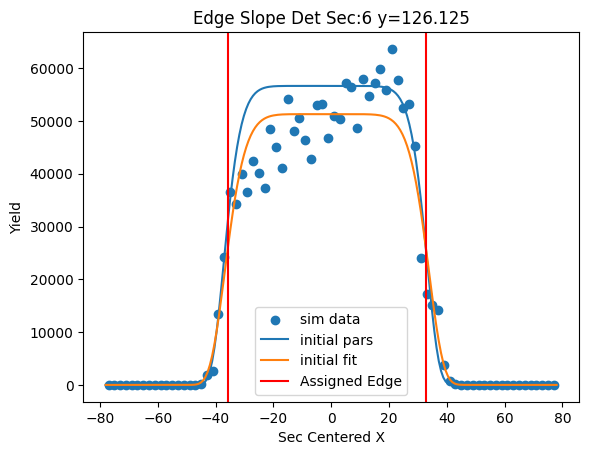

[ 5.15411961e+04 -1.53675748e+00  2.60620999e+01  7.89507160e+00]


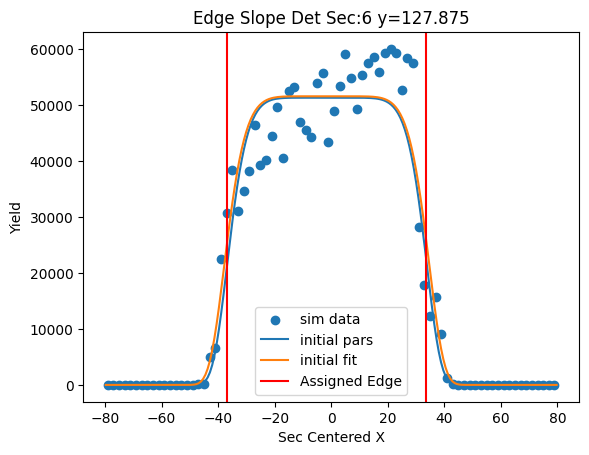

[ 5.04264951e+04 -1.75353652e+00  2.69125103e+01  8.05357432e+00]


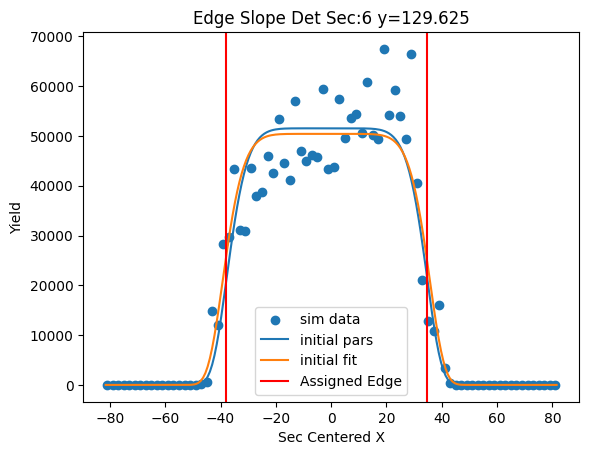

[ 4.67901190e+04 -1.97765630e+00  2.78452696e+01  7.93258235e+00]


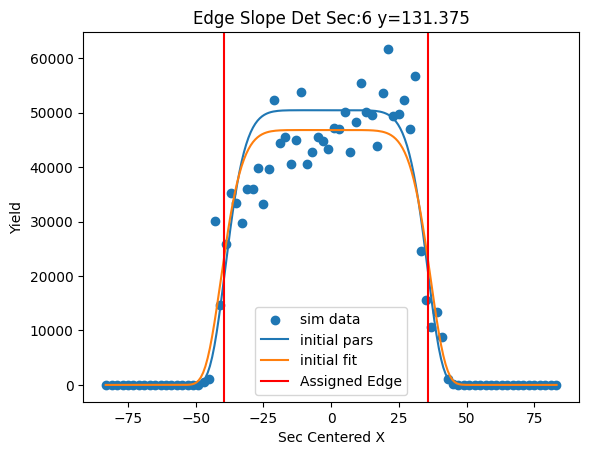

[ 4.20936689e+04 -1.64356120e+00  2.83984975e+01  7.70493719e+00]


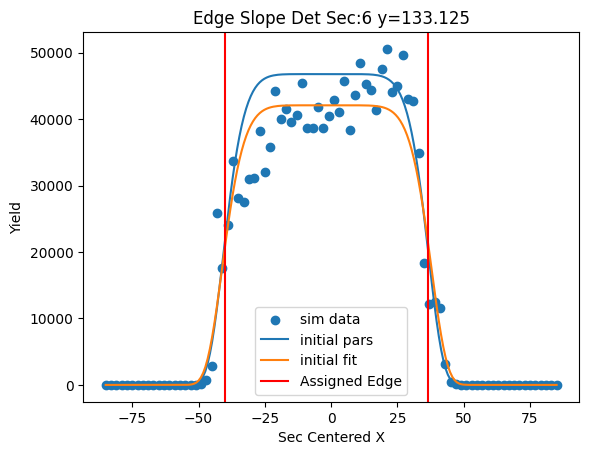

[ 4.18902464e+04 -1.36689579e+00  2.91309714e+01  7.56493963e+00]


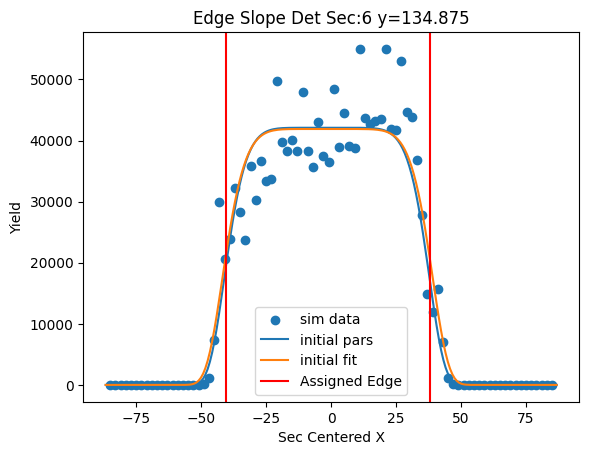

[ 4.14424960e+04 -1.12032473e+00  2.97621478e+01  7.26171332e+00]


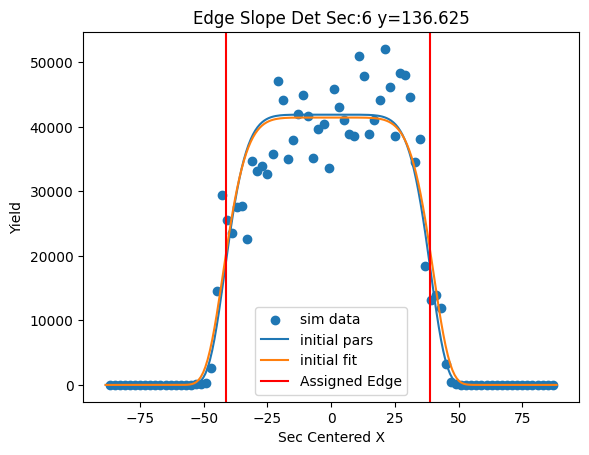

[ 3.88211070e+04 -9.32045966e-01  3.00329160e+01  6.65613019e+00]


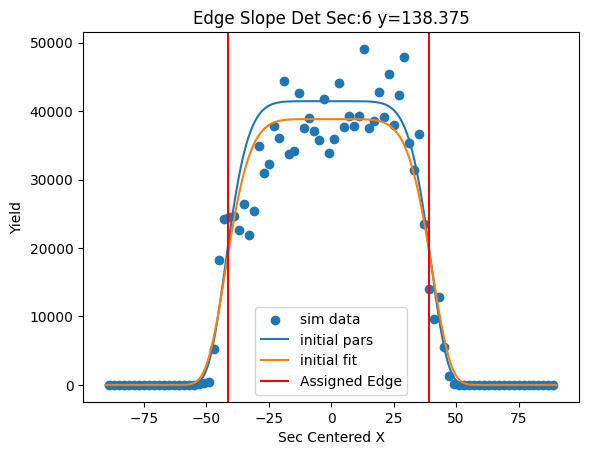

[ 3.61293891e+04 -6.59014056e-01  3.02600773e+01  5.94189420e+00]


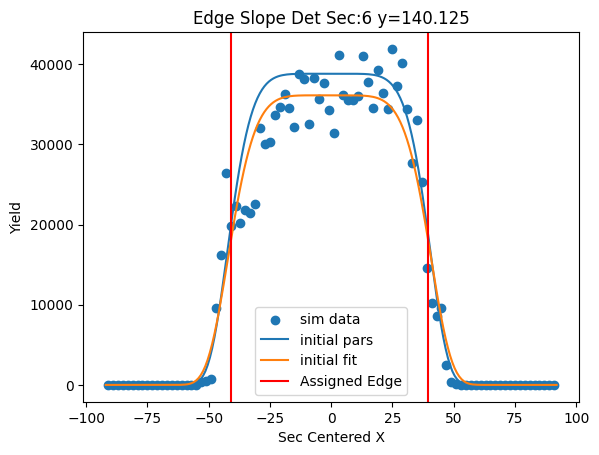

[ 3.56845727e+04 -9.86689533e-01  3.10136260e+01  6.40516015e+00]


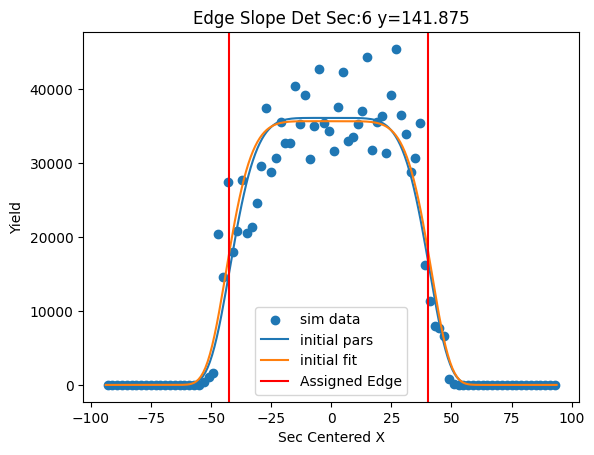

[ 3.40084221e+04 -1.38777043e+00  3.17273639e+01  6.99632132e+00]


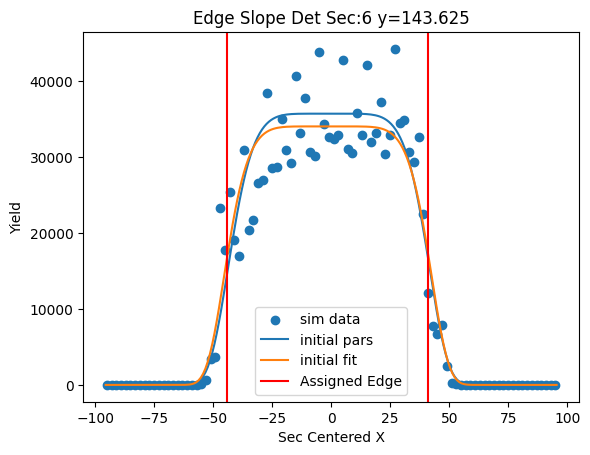

[ 3.20166627e+04 -1.37001878e+00  3.23063059e+01  7.18184661e+00]


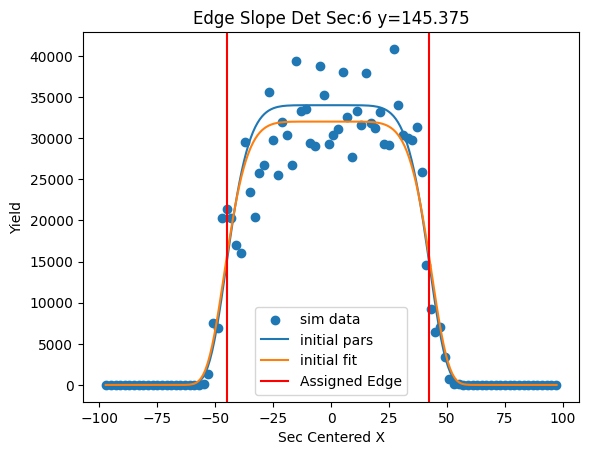

[ 2.97899469e+04 -8.21811214e-01  3.27798532e+01  6.37901888e+00]


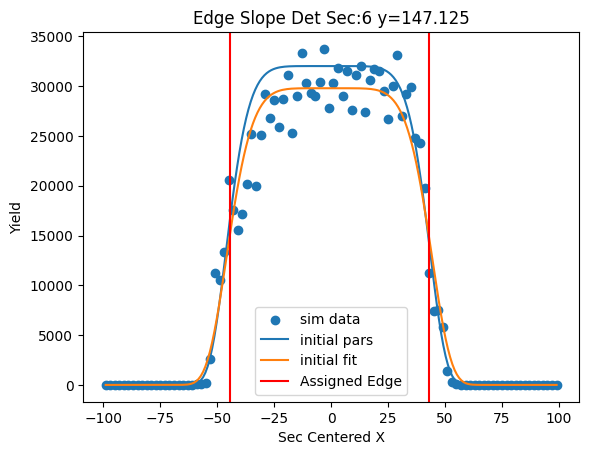

[ 3.02441567e+04 -9.44250754e-01  3.36660228e+01  6.31762927e+00]


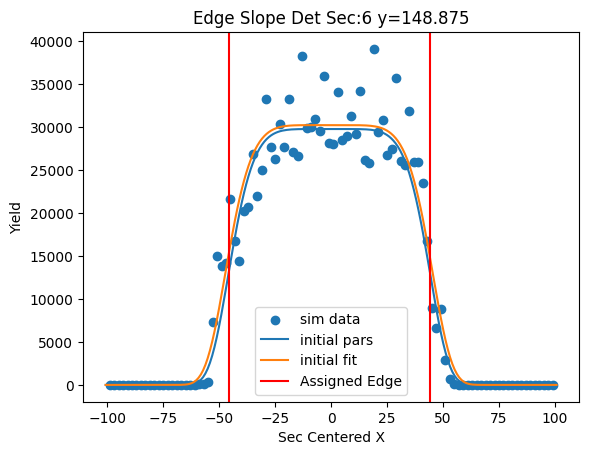

[ 2.94234610e+04 -1.22434009e+00  3.45637080e+01  6.17546350e+00]


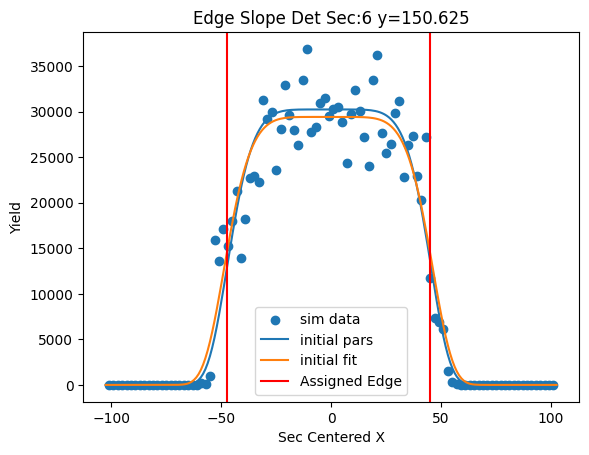

[ 2.67680523e+04 -1.05782217e+00  3.46642776e+01  5.32041311e+00]


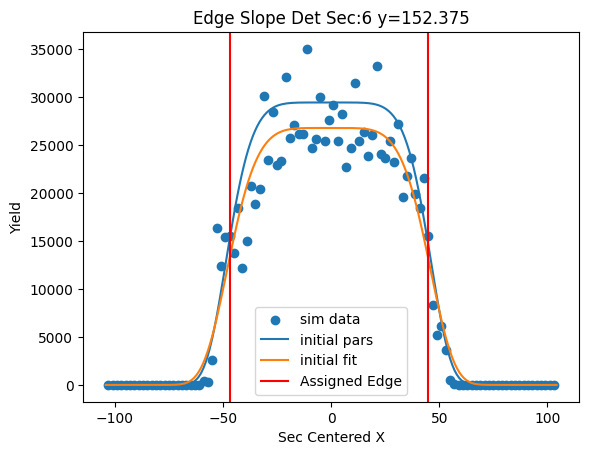

[ 2.55021511e+04 -5.15245205e-01  3.47702752e+01  4.94384353e+00]


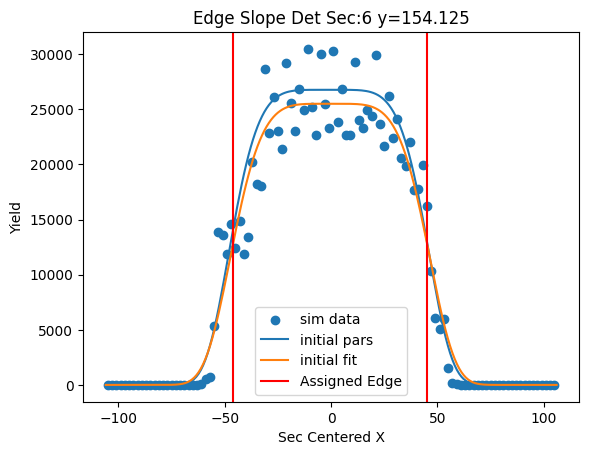

[ 2.67217930e+04 -8.18811392e-01  3.56804033e+01  5.14979231e+00]


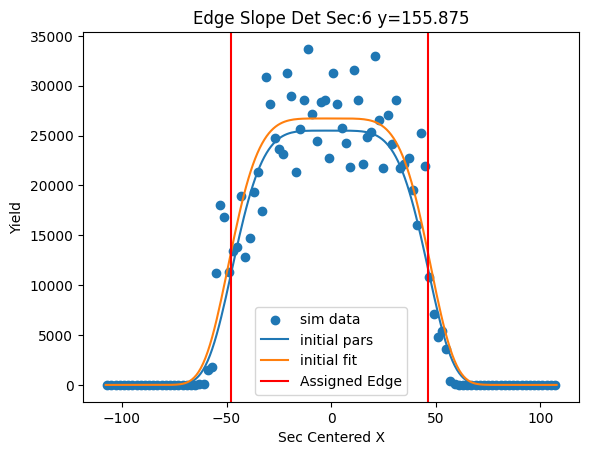

[ 2.55925886e+04 -9.07578238e-01  3.64910289e+01  5.58294298e+00]


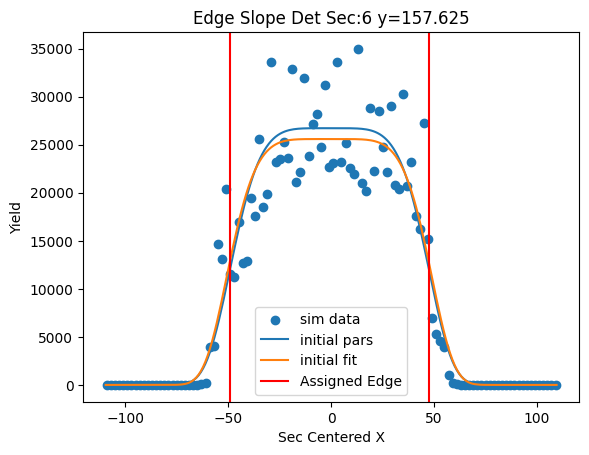

[ 2.37071529e+04 -1.44265212e+00  3.76797702e+01  6.32749832e+00]


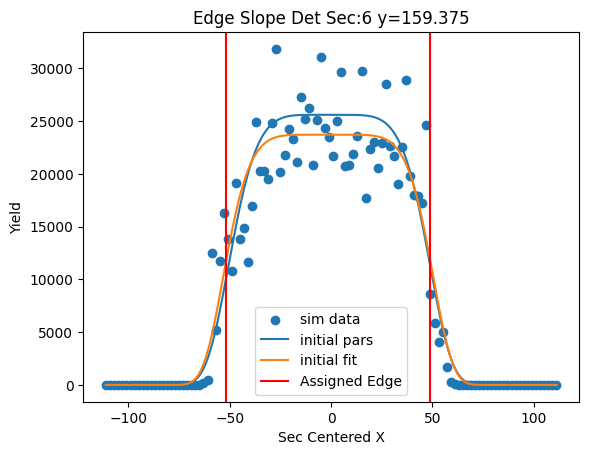

[ 2.12172527e+04 -1.32208035e+00  3.80626681e+01  6.37686545e+00]


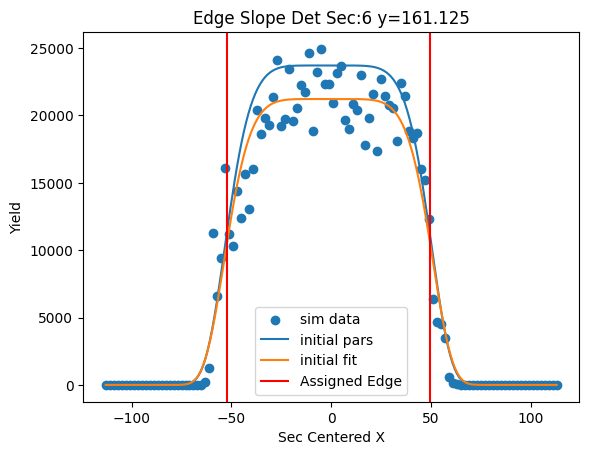

[ 2.19511308e+04 -1.82020112e+00  3.90878199e+01  7.61037678e+00]


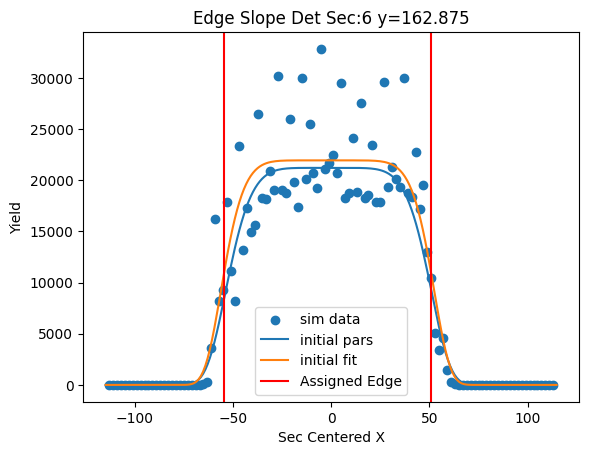

[ 2.10998453e+04 -1.63123952e+00  3.98968732e+01  8.38917583e+00]


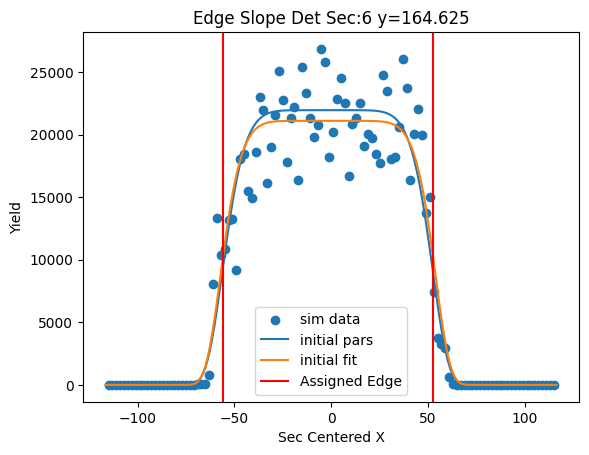

[ 1.88253844e+04 -1.25897569e+00  4.05017867e+01  8.22764831e+00]


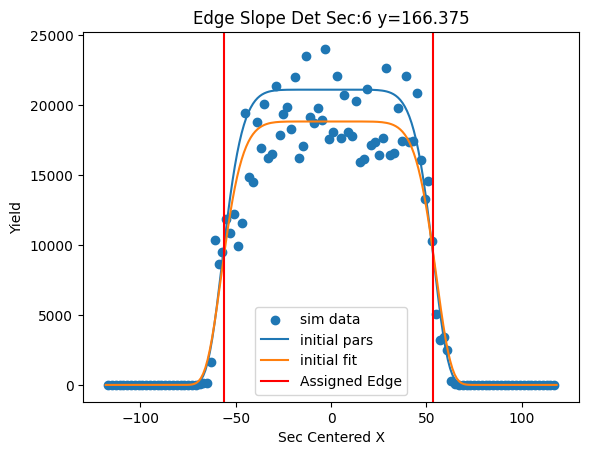

[ 1.77147936e+04 -1.11157846e+00  4.10627058e+01  8.33844638e+00]


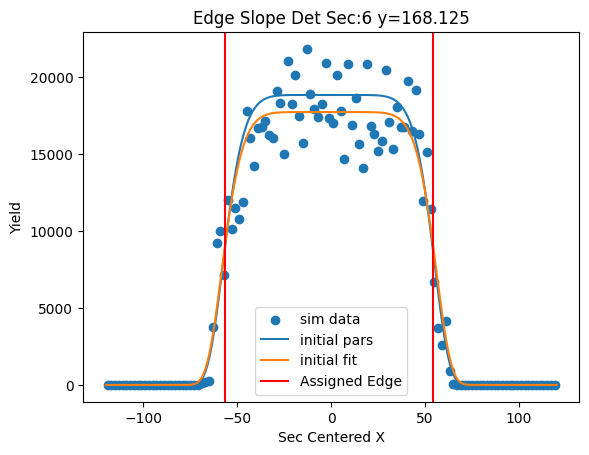

[ 1.76415115e+04 -1.68655978e+00  4.20456479e+01  1.05571913e+01]


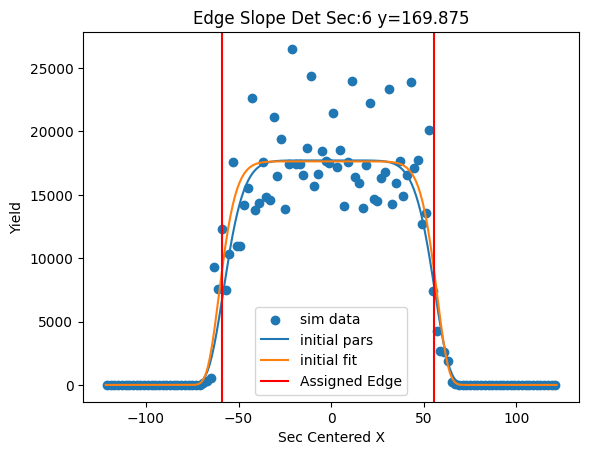

[ 1.64738054e+04 -1.94719790e+00  4.27452231e+01  1.19684759e+01]


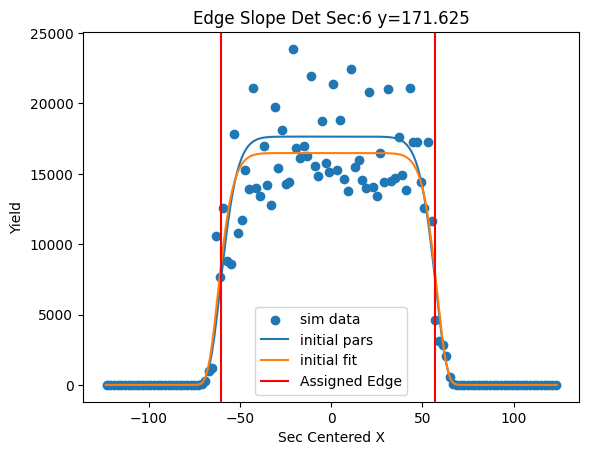

[ 1.55422052e+04 -1.70549186e+00  4.33607359e+01  1.28318569e+01]


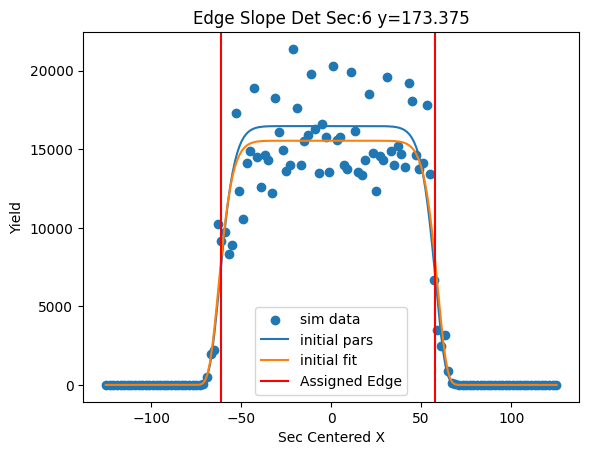

[ 1.43831678e+04 -1.49588479e+00  4.37071153e+01  1.24451715e+01]


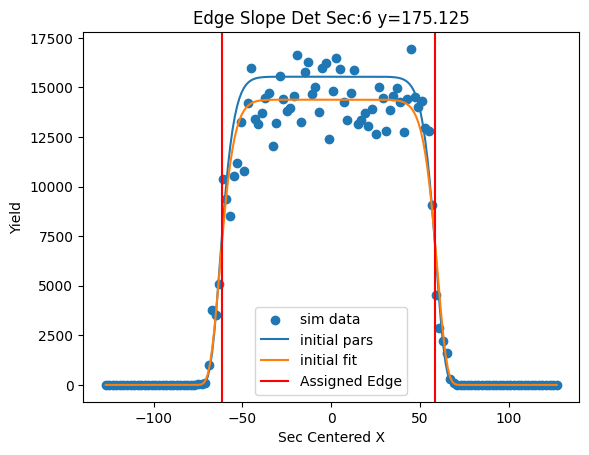

[ 1.51328520e+04 -1.84118614e+00  4.45554589e+01  1.54480394e+01]


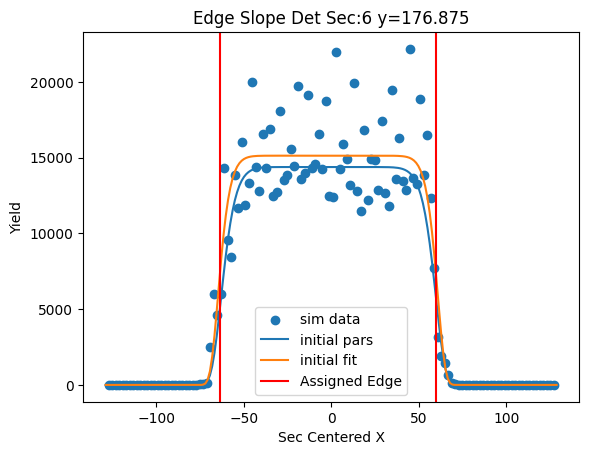

[ 1.47429023e+04 -1.69204155e+00  4.54539505e+01  1.46404635e+01]


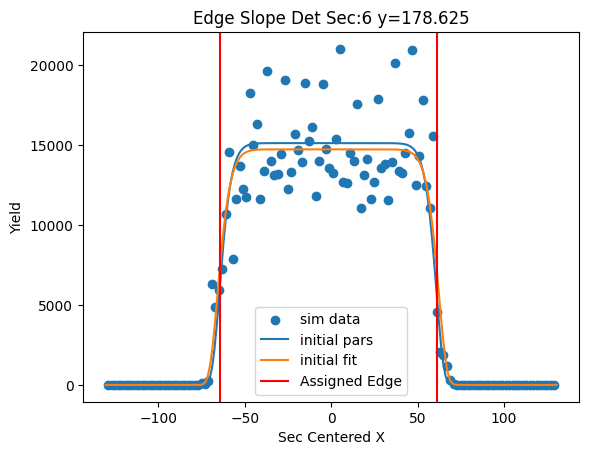

[ 1.28826926e+04 -1.62567318e+00  4.57919229e+01  1.42993792e+01]


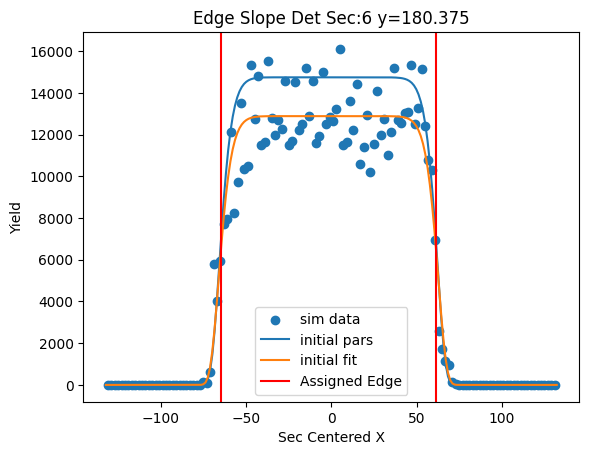

[ 1.25169703e+04 -1.49207986e+00  4.60087237e+01  1.38994444e+01]


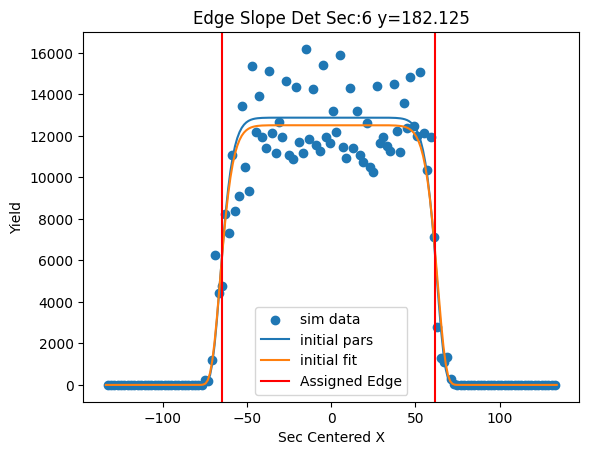

[ 1.32892313e+04 -1.80645342e+00  4.69701645e+01  1.49248697e+01]


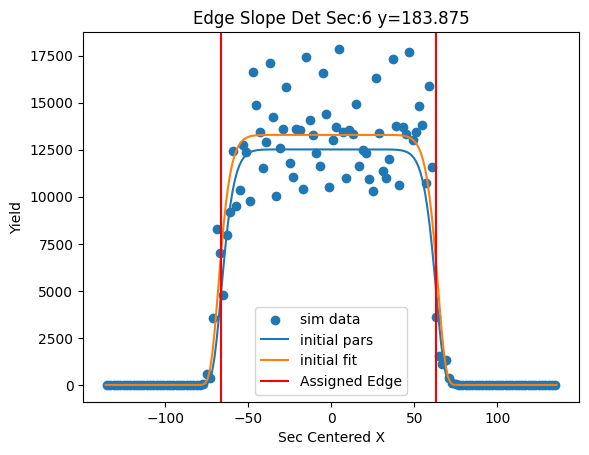

[ 1.25780770e+04 -1.93632625e+00  4.76705719e+01  1.64565299e+01]


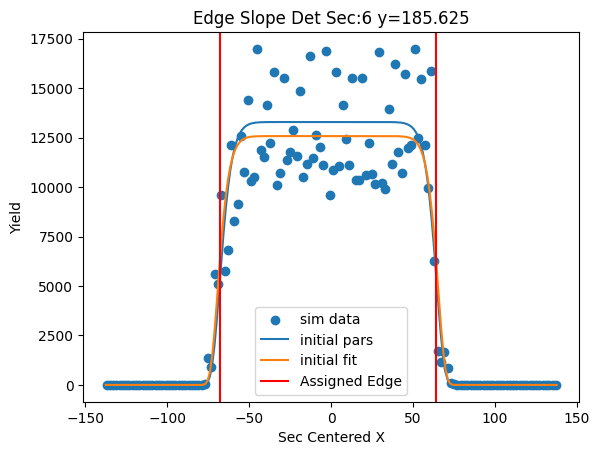

[ 1.09608640e+04 -1.92194844e+00  4.81900081e+01  1.52722636e+01]


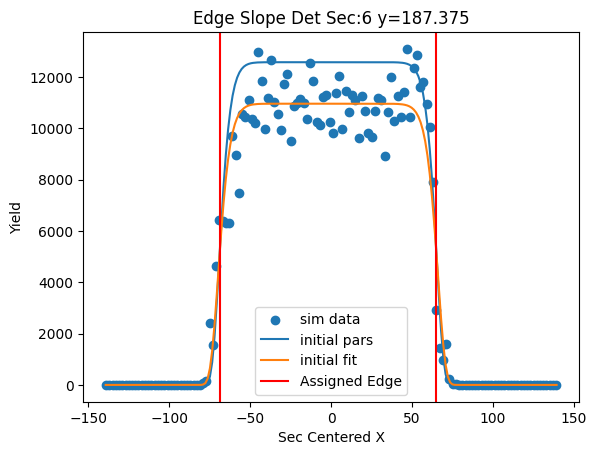

[ 1.13007905e+04 -2.08334705e+00  4.92225701e+01  1.53868317e+01]


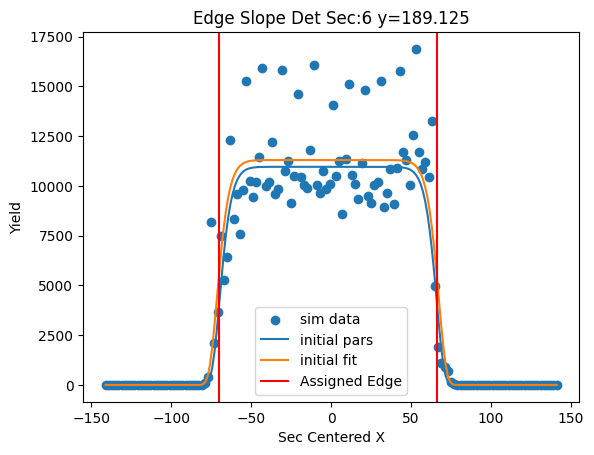

[ 1.12805312e+04 -2.70312163e+00  5.03833921e+01  1.67650594e+01]


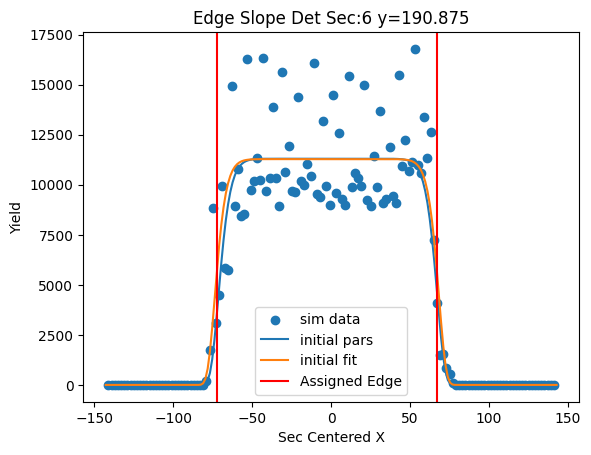

[ 1.10900523e+04 -2.82942326e+00  5.13485562e+01  1.90756097e+01]


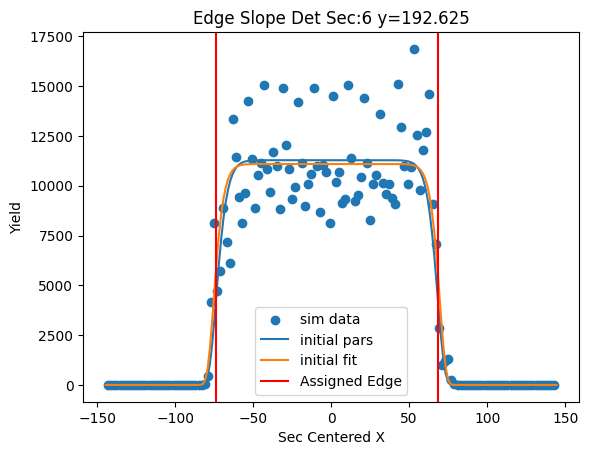

[ 9.78176465e+03 -2.65999943e+00  5.18961818e+01  1.92844052e+01]


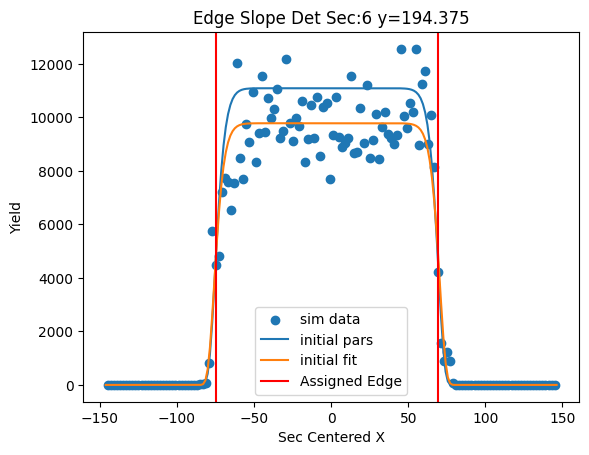

[ 9.77443025e+03 -2.44291418e+00  5.25204265e+01  1.94892064e+01]


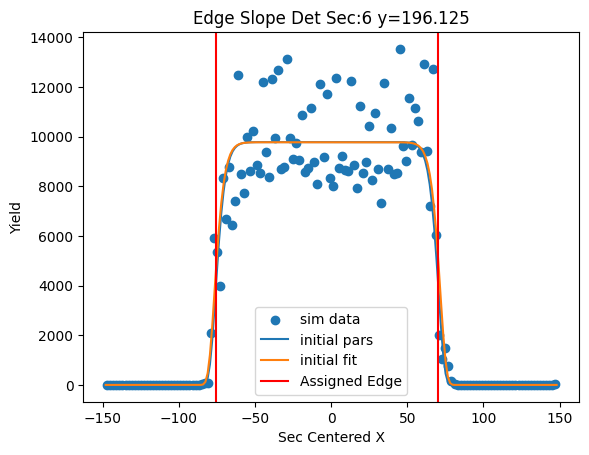

[ 1.01691019e+04 -2.51329451e+00  5.35840866e+01  2.00162092e+01]


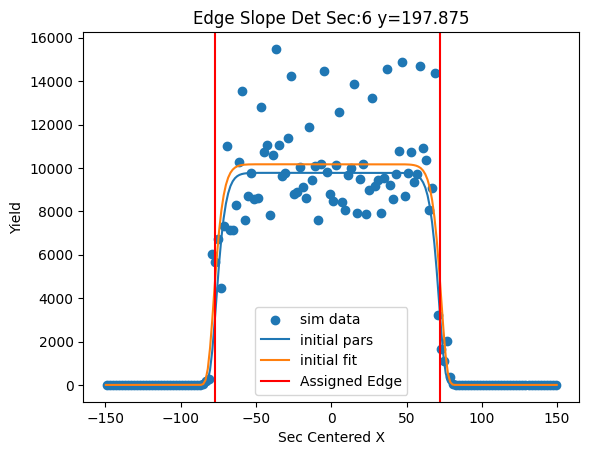

[ 9.28394040e+03 -2.59091970e+00  5.41303078e+01  1.94927299e+01]


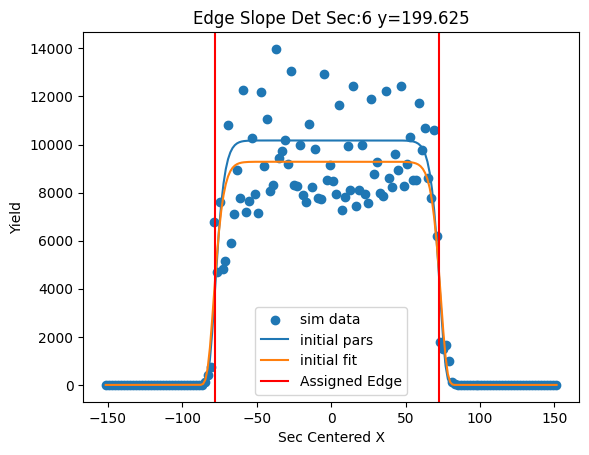

[ 8.14059110e+03 -2.08459525e+00  5.42888963e+01  1.63575348e+01]


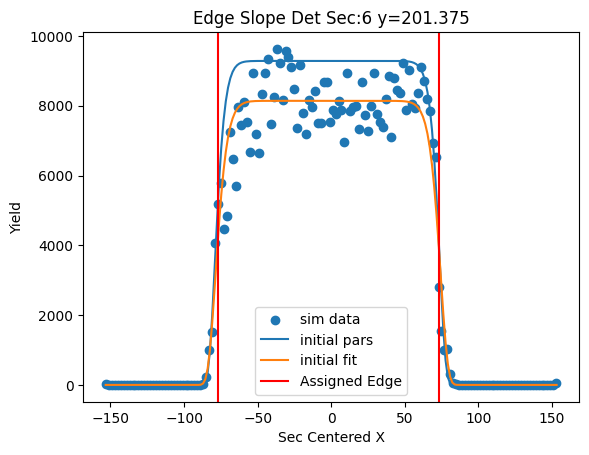

[ 8.85211751e+03 -2.41399473e+00  5.51882481e+01  1.86603870e+01]


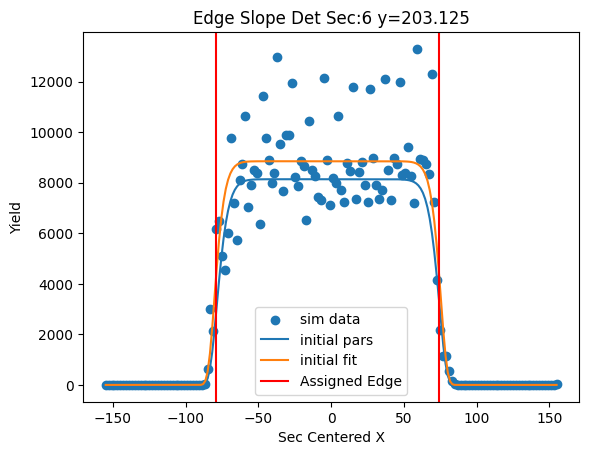

[ 8.77263774e+03 -2.75988757e+00  5.64542351e+01  1.98879461e+01]


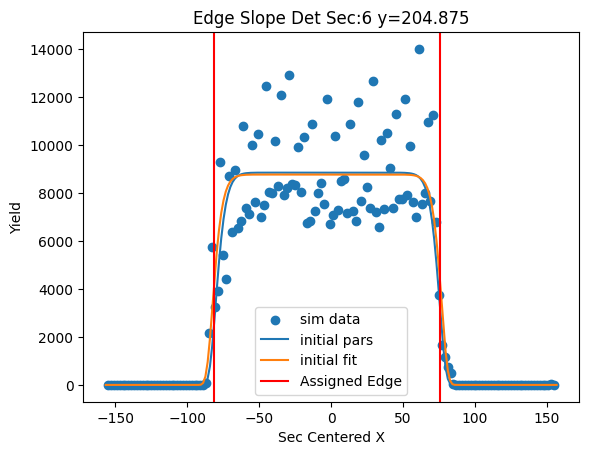

[ 8.30975854e+03 -3.14295359e+00  5.76099015e+01  2.32258144e+01]


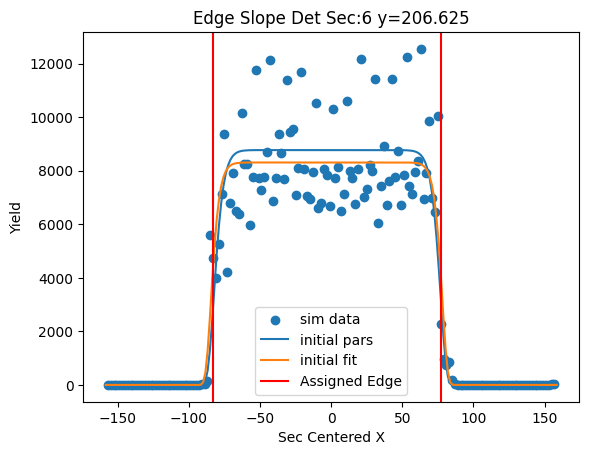

[ 6.99619950e+03 -3.14156906e+00  5.79138581e+01  2.39166920e+01]


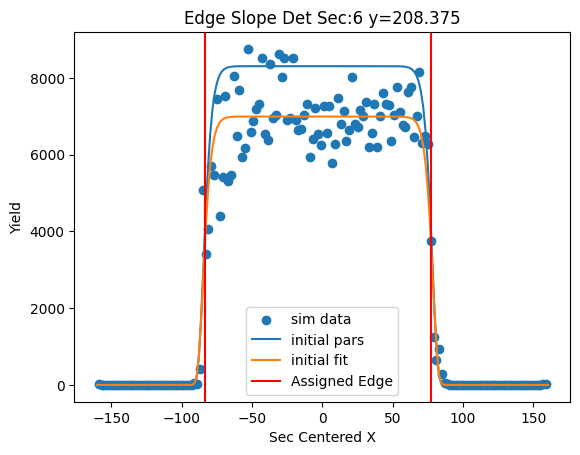

[ 7.23970840e+03 -3.62989118e+00  5.84324932e+01  3.69418440e+01]


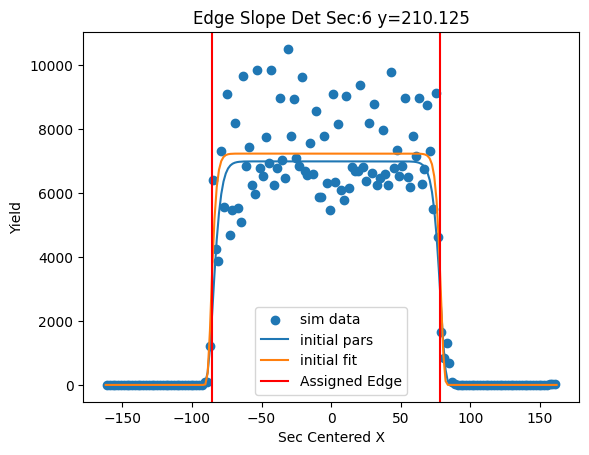

[ 7.81259229e+03 -4.05779543e+00  5.87583952e+01  1.00000000e+02]


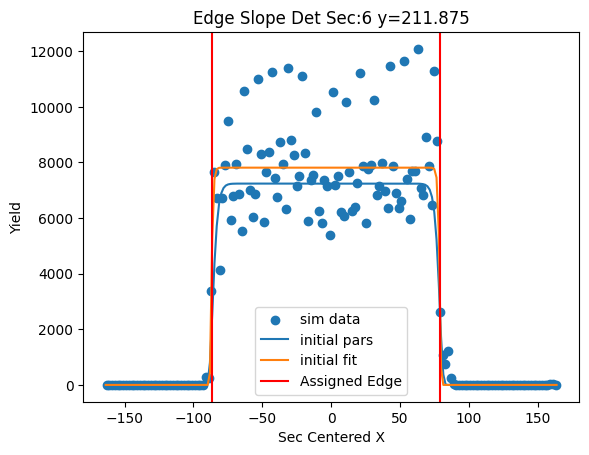

[ 7.17406103e+03 -3.77403844e+00  5.95232342e+01  7.97159448e+01]


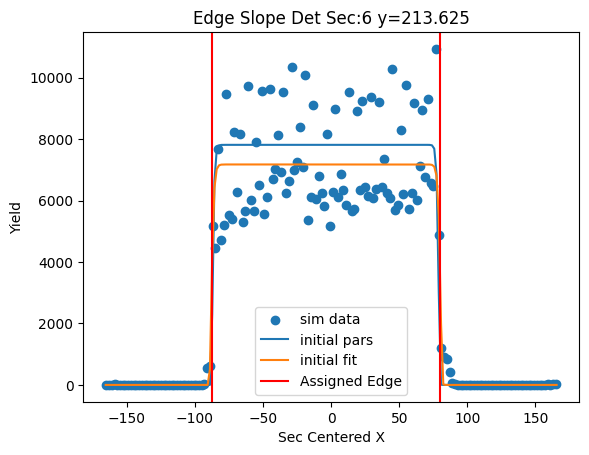

[ 6.20654885e+03 -3.59274443e+00  5.98216367e+01  7.97938193e+01]


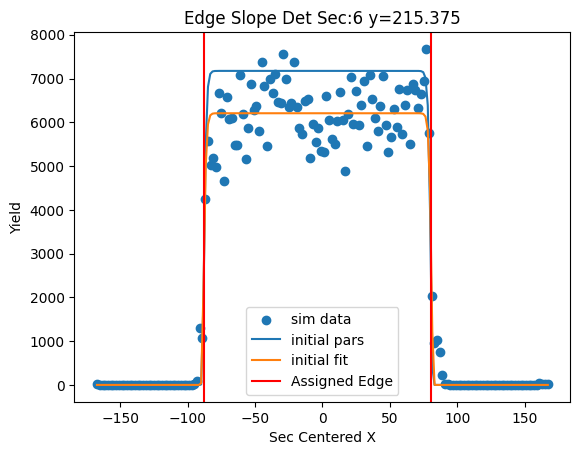

[ 6.76978290e+03 -3.12109534e+00  6.13247402e+01  3.05085276e+01]


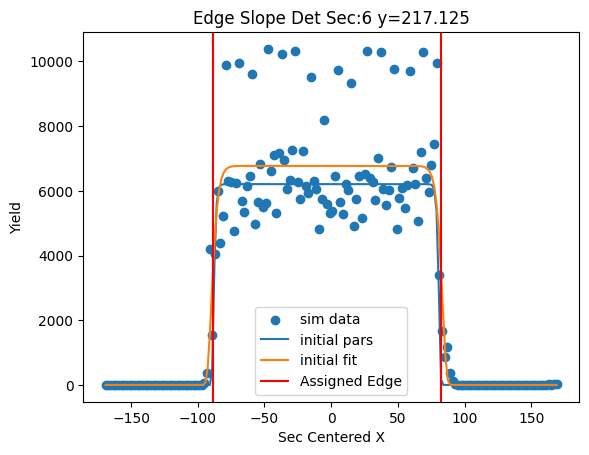

[ 6.69645916e+03 -3.66514618e+00  6.23248329e+01  3.03539308e+01]


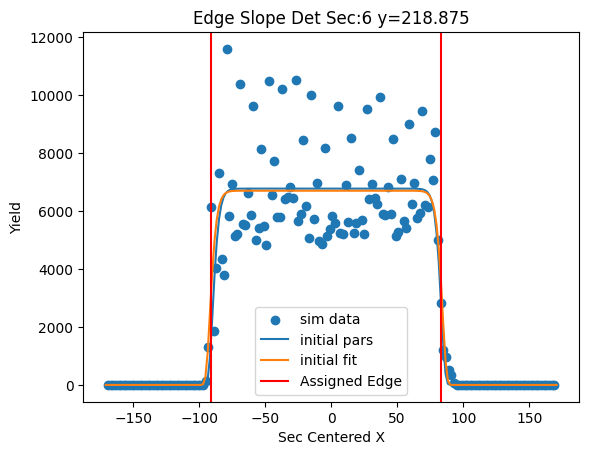

[ 6.44644291e+03 -3.71207173e+00  6.29584229e+01  3.38173914e+01]


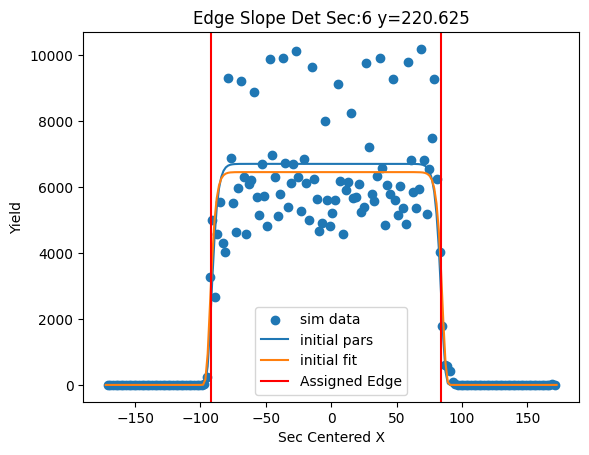

[ 5.53167488e+03 -3.52829738e+00  6.36162520e+01  3.04363486e+01]


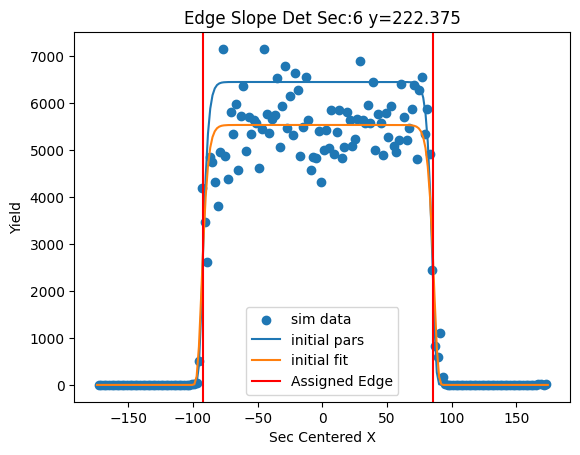

[ 5.91791547e+03 -4.18129066e+00  6.40950566e+01  9.08007387e+01]


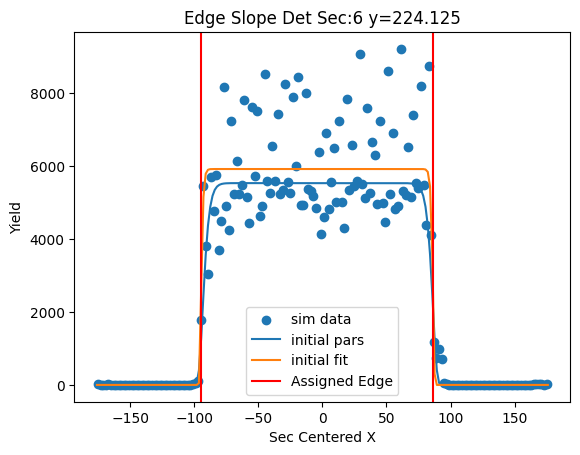

[ 6.19538531e+03 -4.45984024e+00  6.48134318e+01  1.00000000e+02]


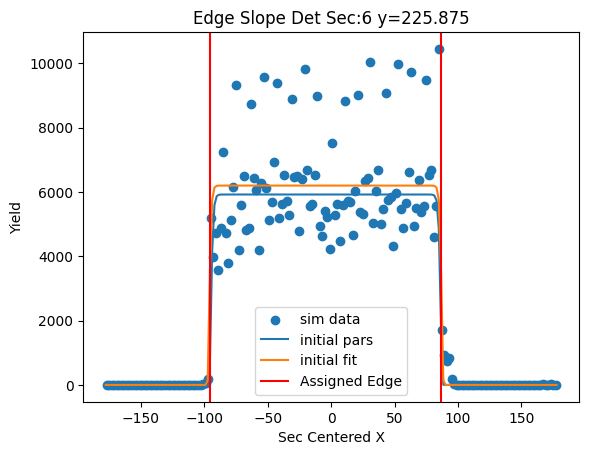

[ 5.43584186e+03 -3.99558748e+00  6.53258950e+01  8.82971341e+01]


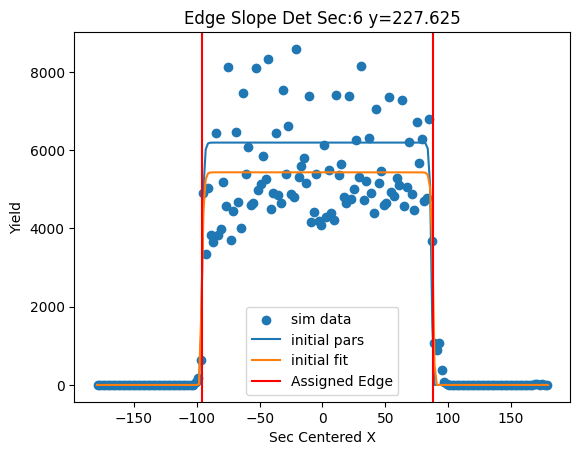

[ 4.85000705e+03 -2.72585006e+00  6.60361690e+01  2.55576729e+01]


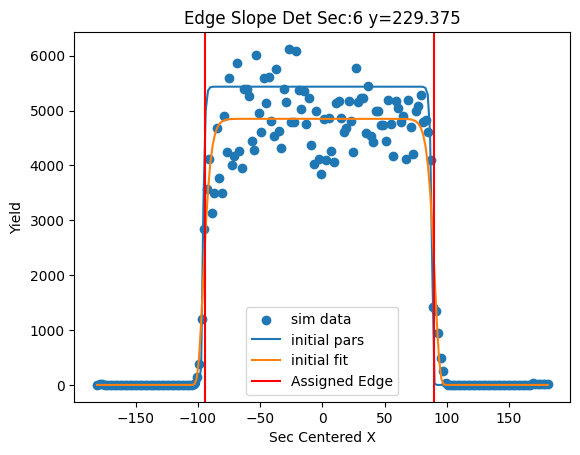

[ 5.57517262e+03 -2.99848487e+00  6.65498050e+01  2.76720583e+01]


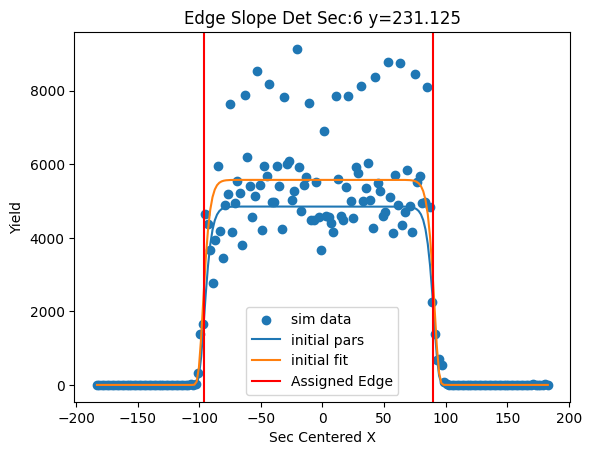

[ 5.43822215e+03 -2.73005467e+00  6.73253082e+01  2.28258171e+01]


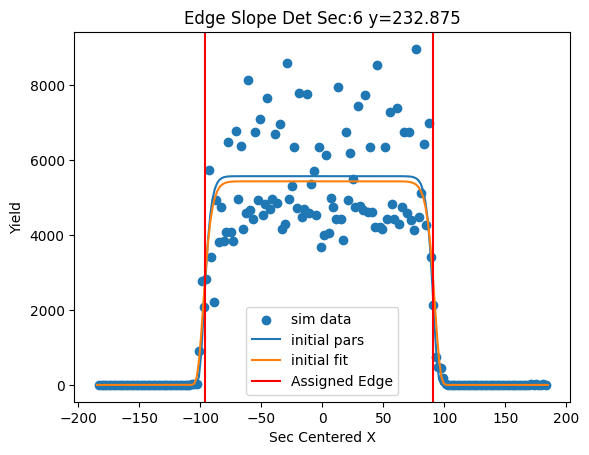

[ 5.14795796e+03 -2.94811630e+00  6.84989341e+01  1.95423529e+01]


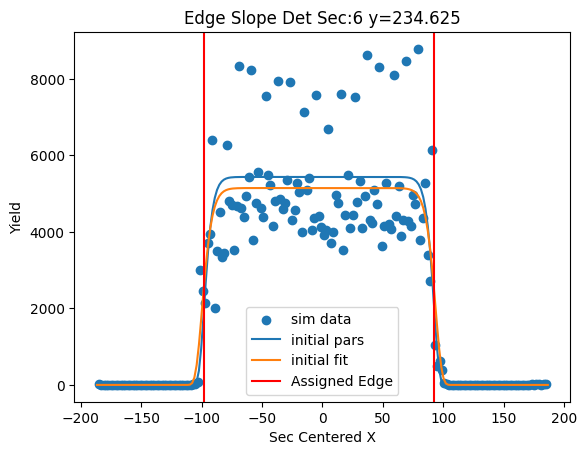

[ 4.16725607e+03 -3.20616424e+00  6.85852031e+01  1.80451870e+01]


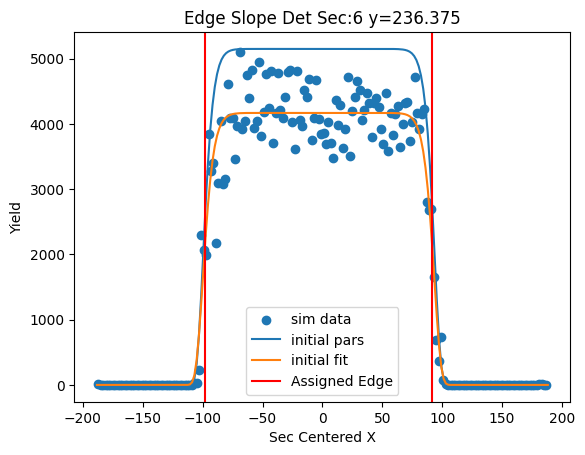

[ 4.52024554e+03 -3.66165191e+00  6.94524384e+01  2.18506776e+01]


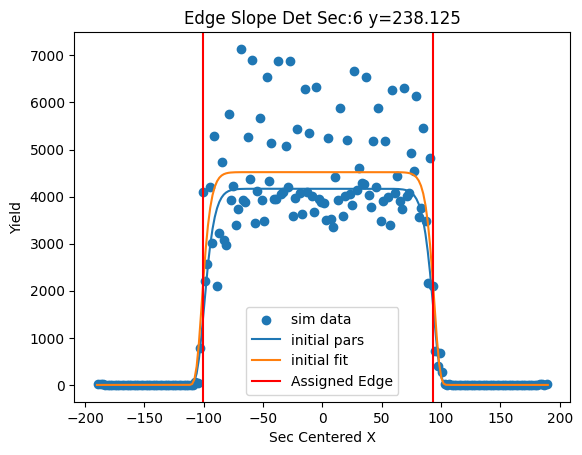

[ 4.67536673e+03 -4.22501267e+00  6.99722904e+01  1.00000000e+02]


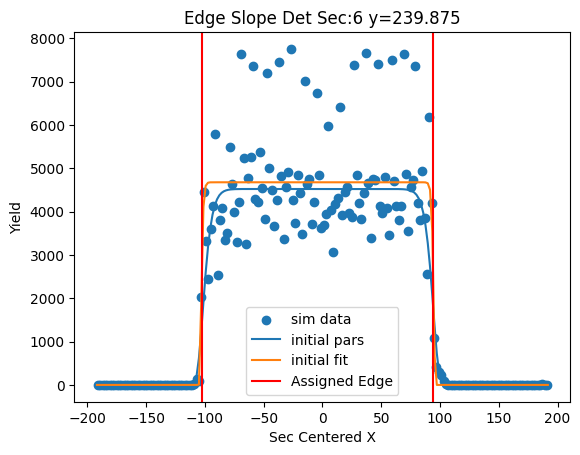

[ 4.15743645e+03 -3.61229800e+00  7.08102405e+01  3.54877620e+01]


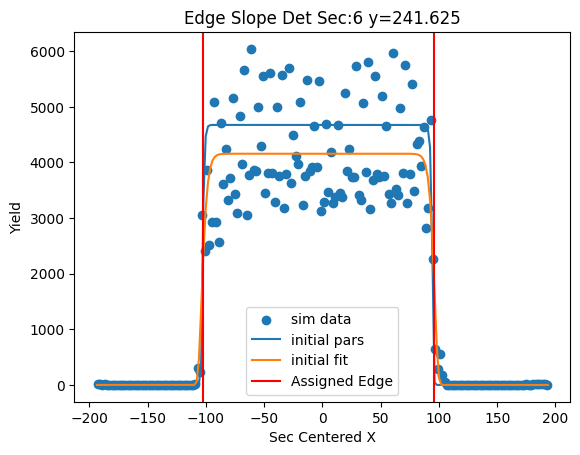

[ 3.73325312e+03 -3.53798382e+00  7.11254636e+01  2.69429228e+01]


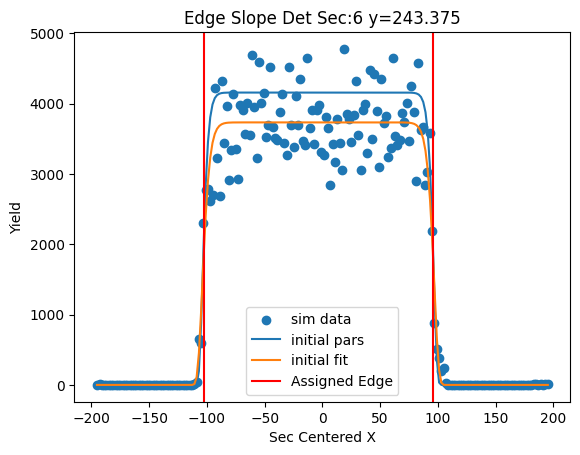

[ 4.22148858e+03 -3.23010445e+00  7.17741852e+01  2.19395529e+01]


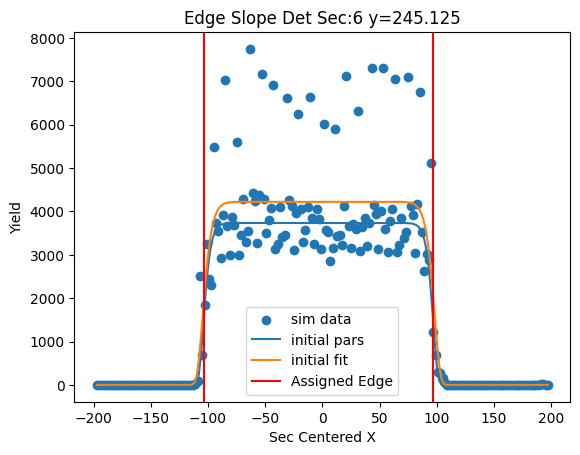

[ 3.97859513e+03 -3.57713384e+00  7.23244550e+01  2.29911833e+01]


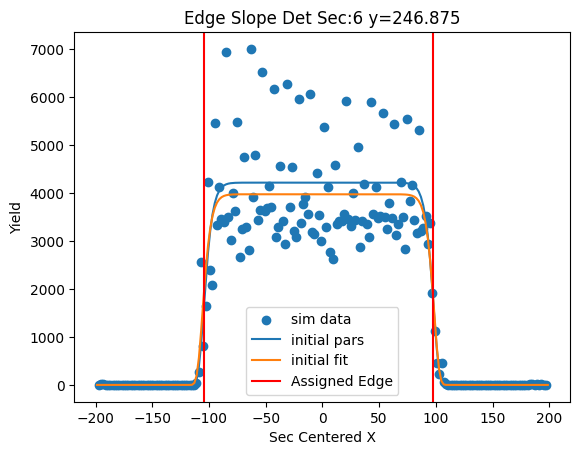

[ 3.81948268e+03 -2.92557850e+00  7.26393826e+01  1.92909686e+01]


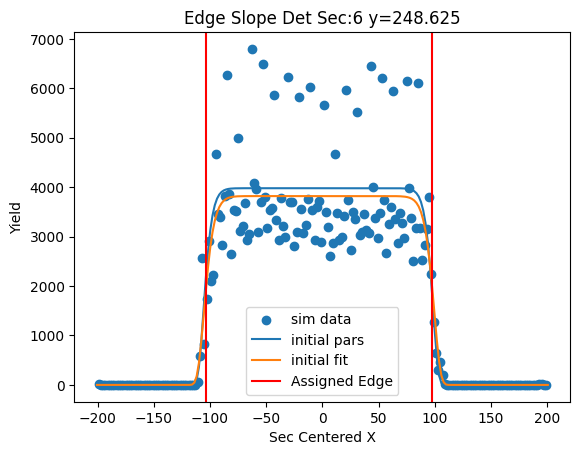

[ 3.14958357e+03 -2.73578058e+00  7.29607660e+01  1.91532294e+01]


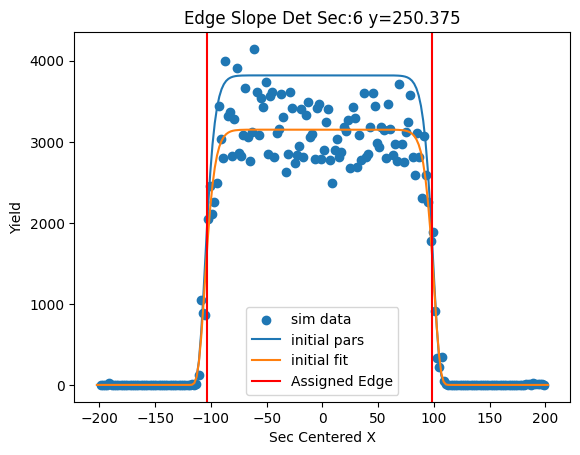

[ 3.59920146e+03 -2.75288058e+00  7.35617267e+01  1.86081800e+01]


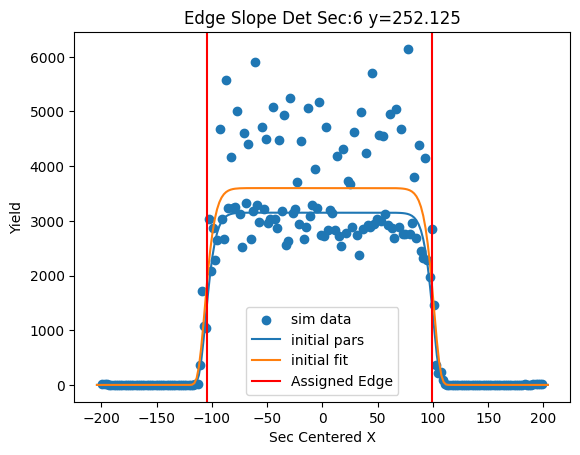

[ 3.73104754e+03 -2.89215081e+00  7.46471968e+01  1.74987496e+01]


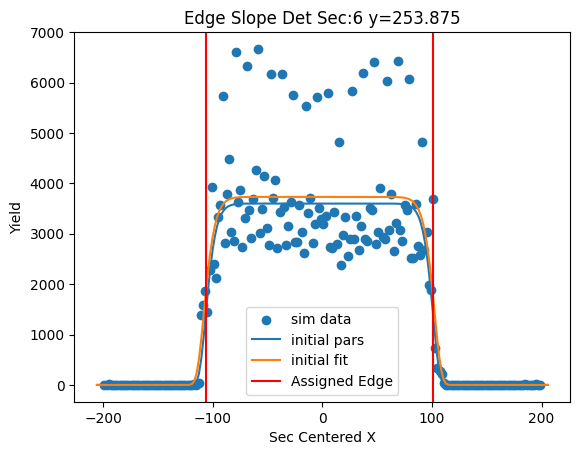

[3044.42624902   -3.21598033   75.26178528   16.55801243]


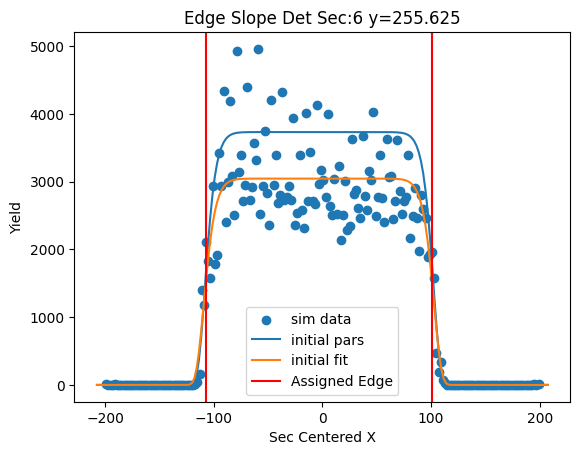

[2790.89824517   -3.30113208   75.15314531   15.44809069]


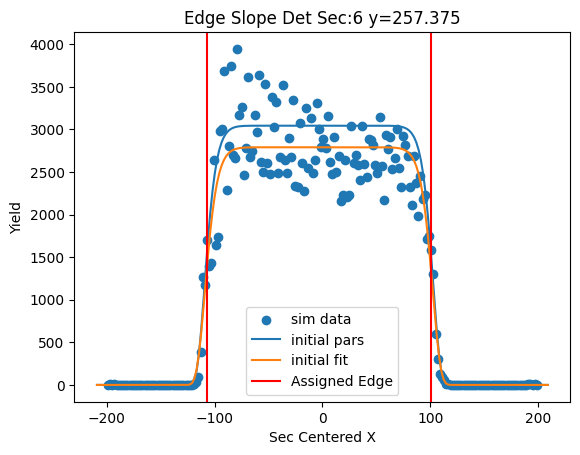

[ 3.42628248e+03 -2.88512070e+00  7.57680151e+01  1.51021373e+01]


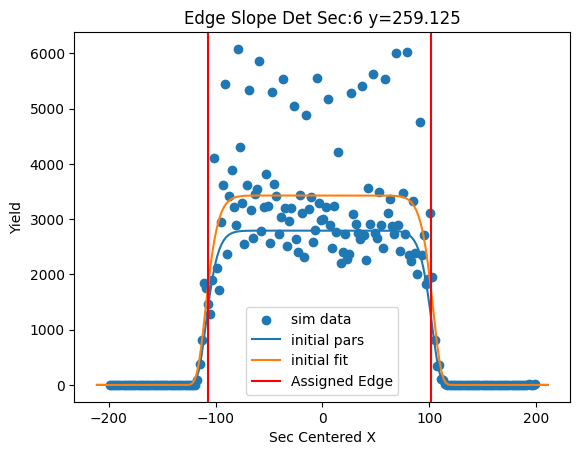

[ 3.26504607e+03 -2.35878130e+00  7.62194729e+01  1.39516325e+01]


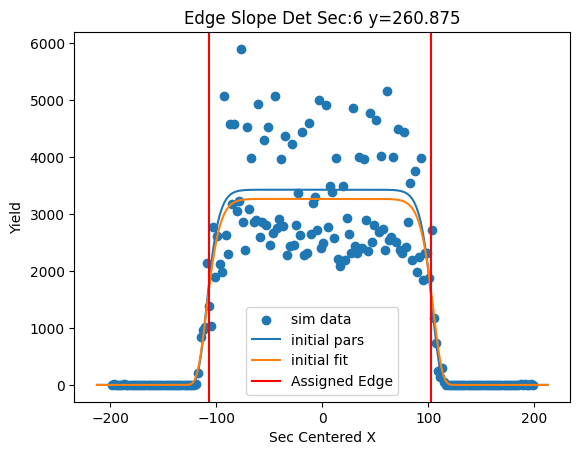

[ 3.05484141e+03 -2.09940839e+00  7.68485132e+01  1.34684603e+01]


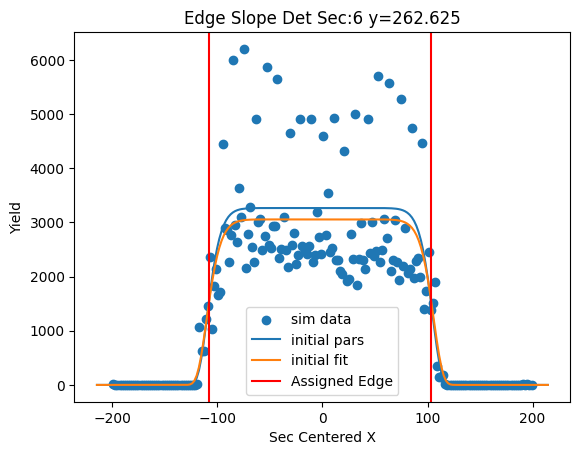

[2402.0286038    -2.58470686   76.70690732   11.9001579 ]


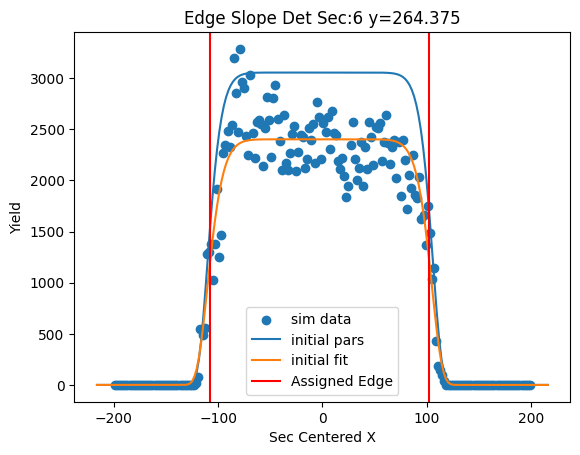

[ 2.78868860e+03 -2.25788155e+00  7.72999752e+01  1.26816932e+01]


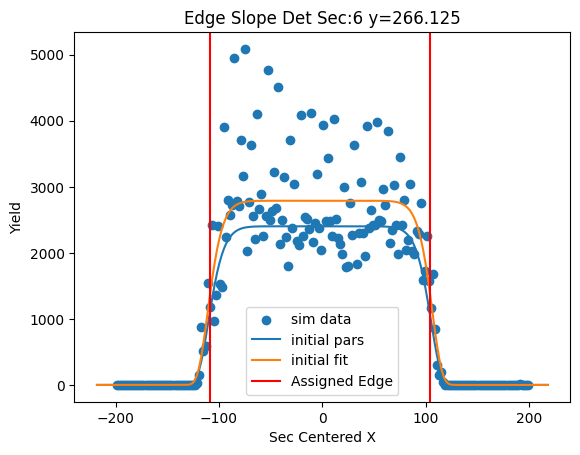

[ 2.94413104e+03 -1.28385257e+00  7.79864153e+01  1.26380538e+01]


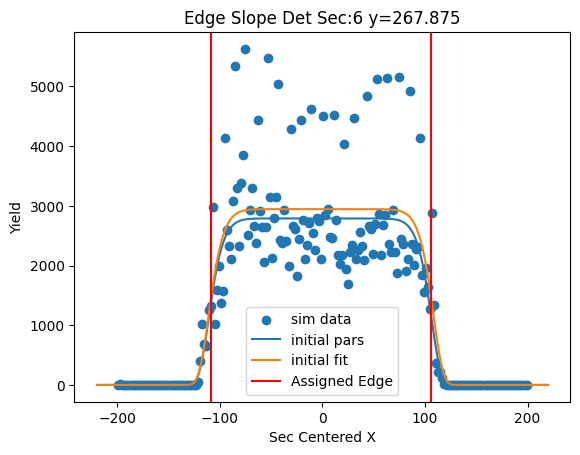

[ 2.43815410e+03 -9.74022476e-01  7.75180008e+01  1.17273447e+01]


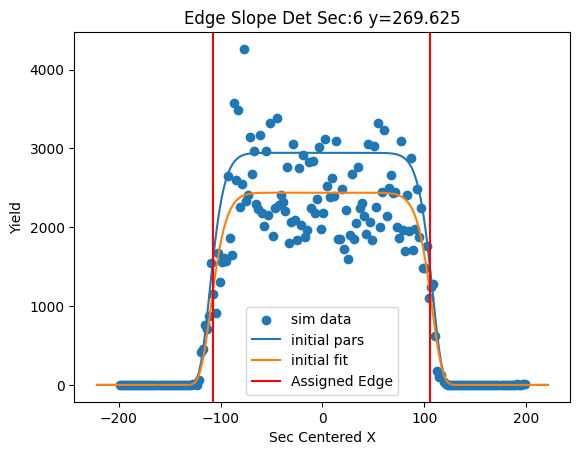

[ 2.35313227e+03 -1.00118226e+00  7.75155758e+01  1.08804758e+01]


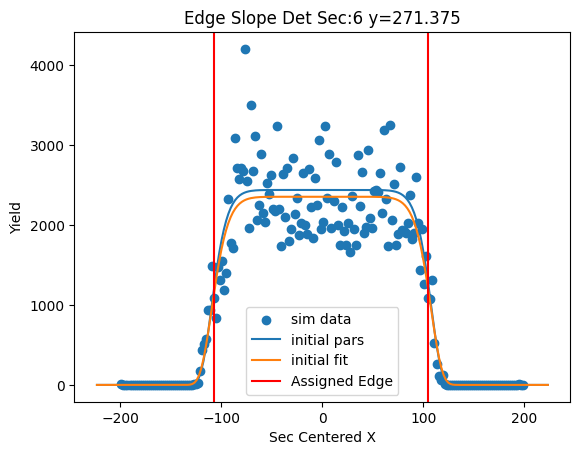

[ 2.70516221e+03 -1.33051071e+00  7.86494789e+01  1.10712894e+01]


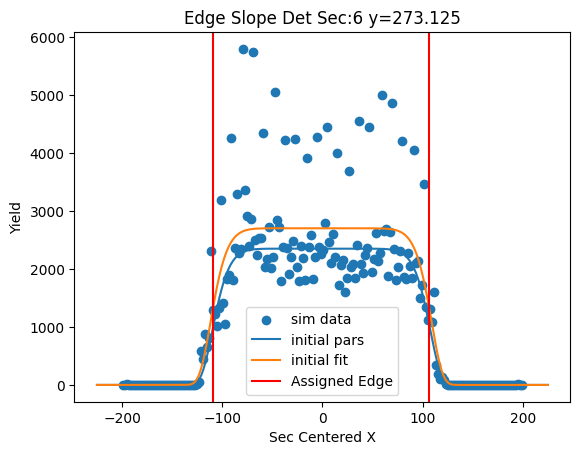

[ 2.39587595e+03 -1.65631060e+00  7.91742427e+01  1.08765511e+01]


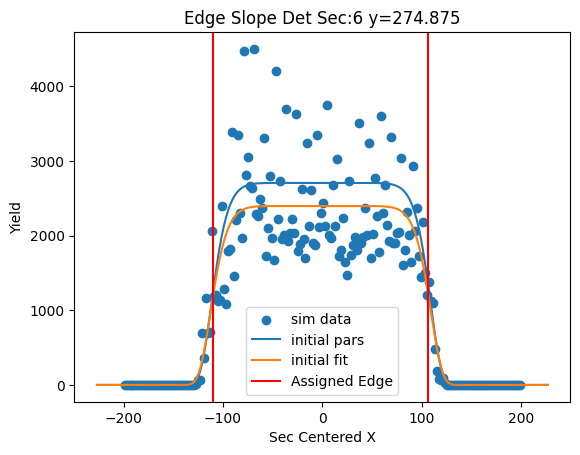

[ 1.91320689e+03 -1.39848243e+00  7.92942536e+01  1.05636370e+01]


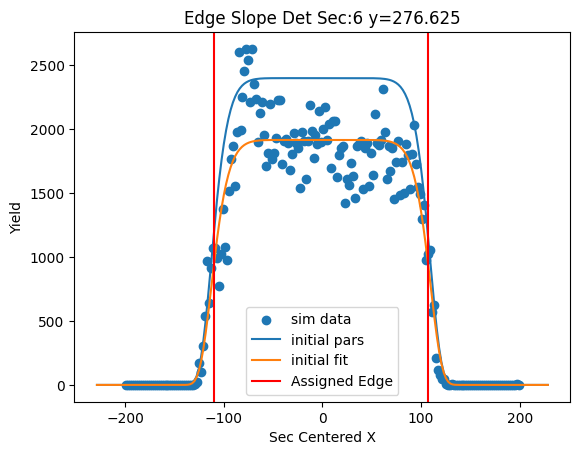

[ 2.26804993e+03 -1.37885996e+00  8.07612135e+01  1.21052887e+01]


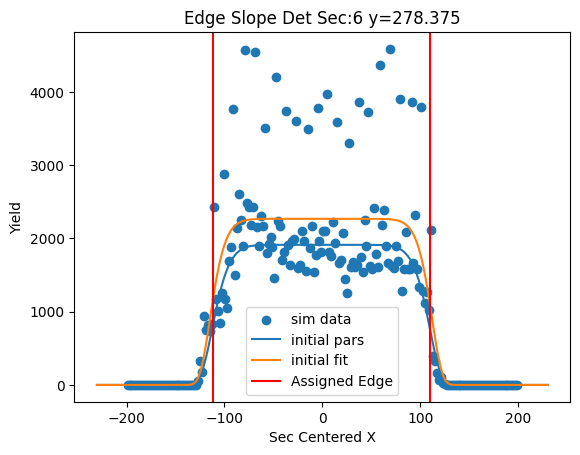

[ 2.25337952e+03 -1.03761307e+00  8.11427969e+01  1.26955167e+01]


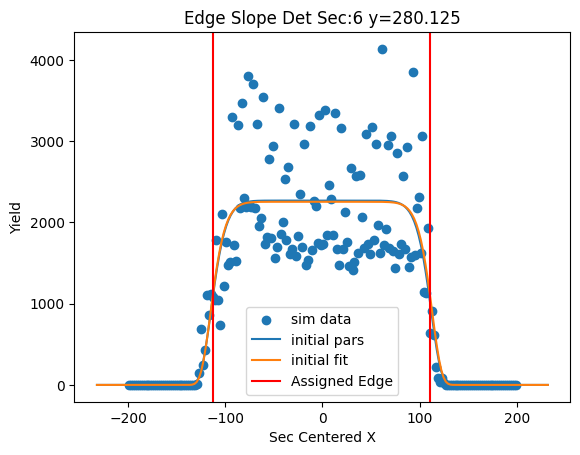

[ 2.25572466e+03 -1.82903320e+00  8.20018422e+01  1.21835363e+01]


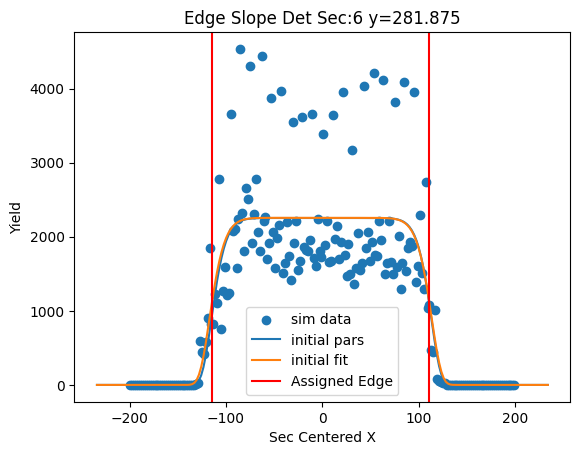

[1675.51020414   -2.51627702   81.85402571   11.76859907]


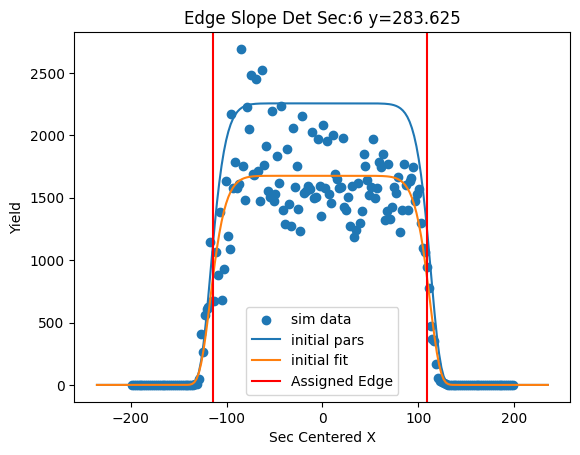

[1656.99342123   -3.02083582   82.61329961   12.57225868]


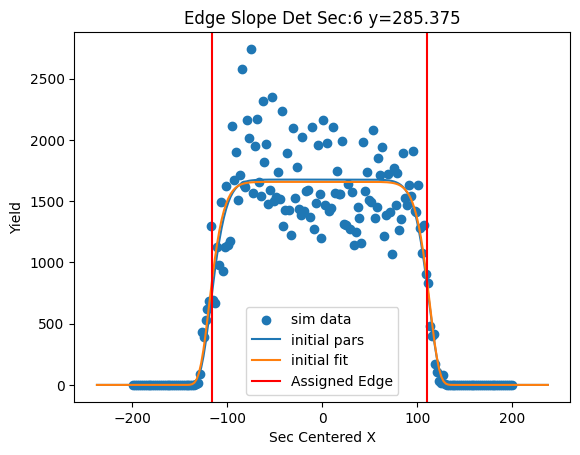

[1985.10868855   -3.37783468   83.73127704   12.44318222]


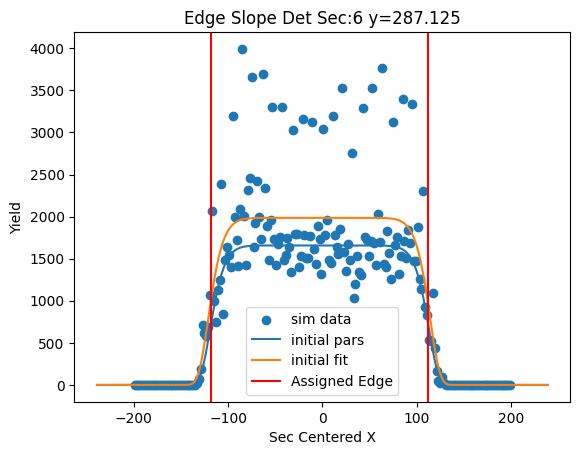

[1764.76675225   -3.05103752   83.76652589   11.49722778]


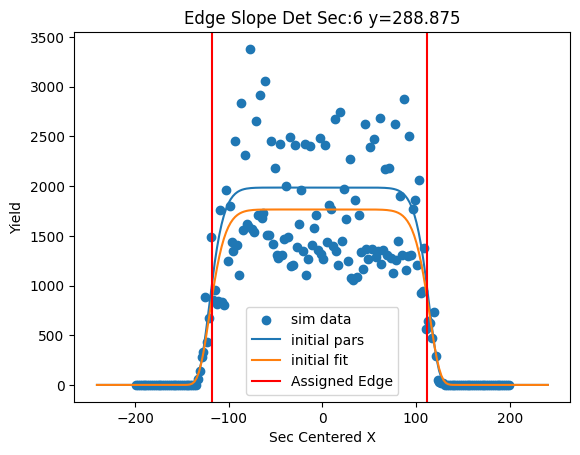

[1359.9067518    -3.08425612   84.10985548   10.88910906]


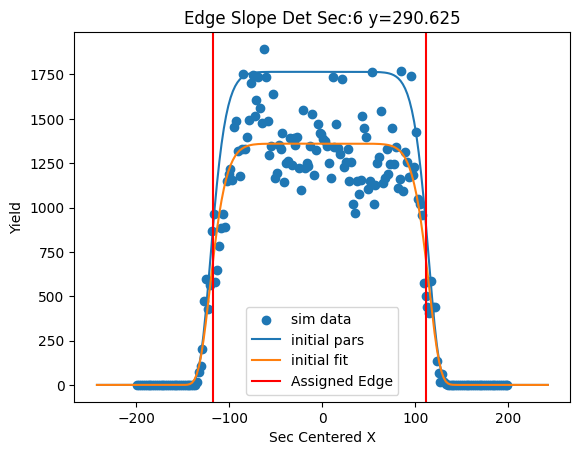

[1635.00549094   -3.82136088   85.18036857   11.12198444]


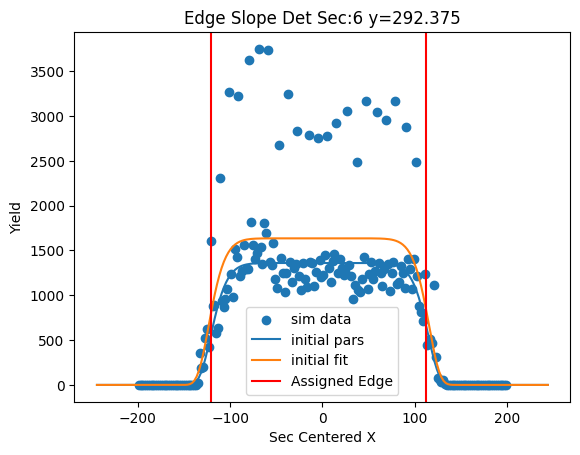

[1526.19782699   -4.82421184   85.9254781    10.66187211]


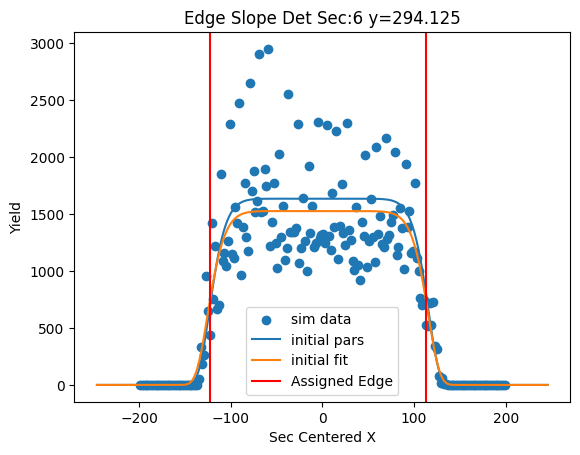

[1590.7161982    -3.4855363    87.71435726   10.90813383]


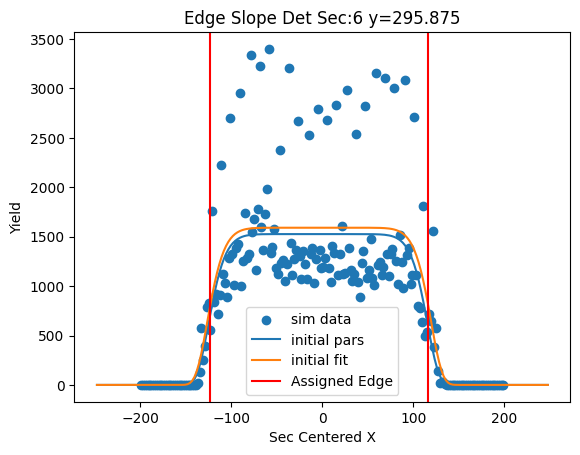

[1264.1399404    -3.01080931   87.96670109   10.63503359]


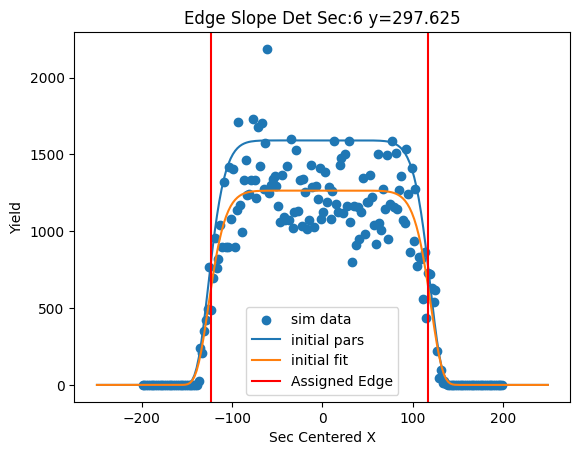

[1361.93510061   -3.00021523   89.05351505   11.70090423]


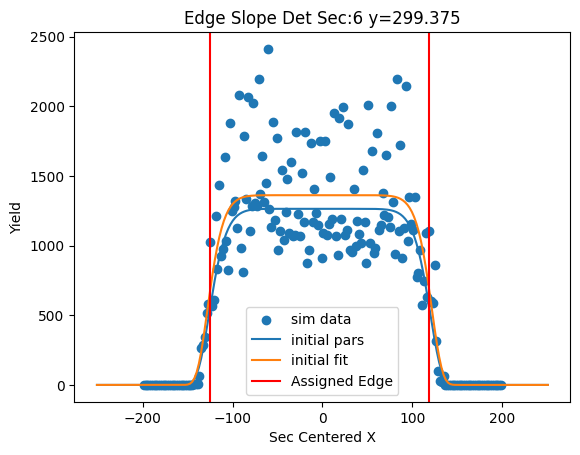

[1538.01024057   -3.72239724   89.9759038    11.98062689]


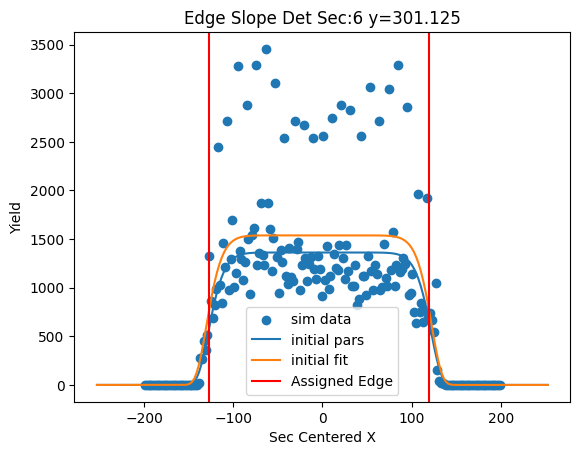

[1301.26232578   -4.31191186   90.66377841   11.45494704]


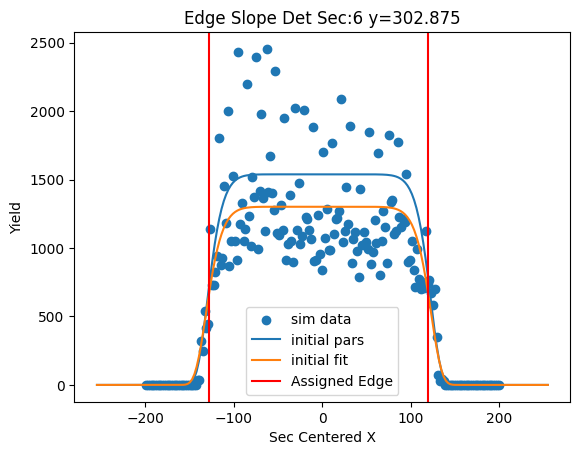

[1018.65007615   -3.57575365   91.23847163   12.0592053 ]


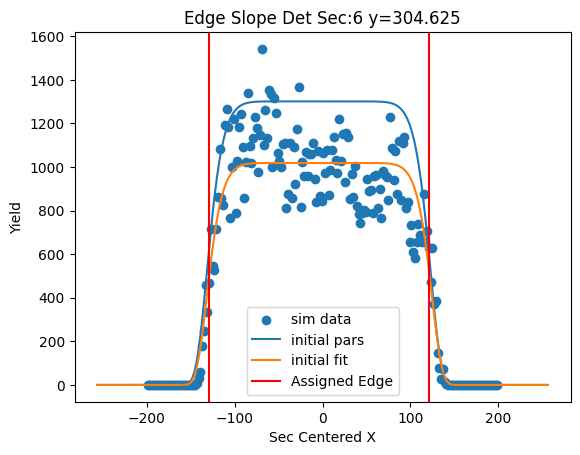

[1372.73439458   -3.34410411   91.45792865   12.18569099]


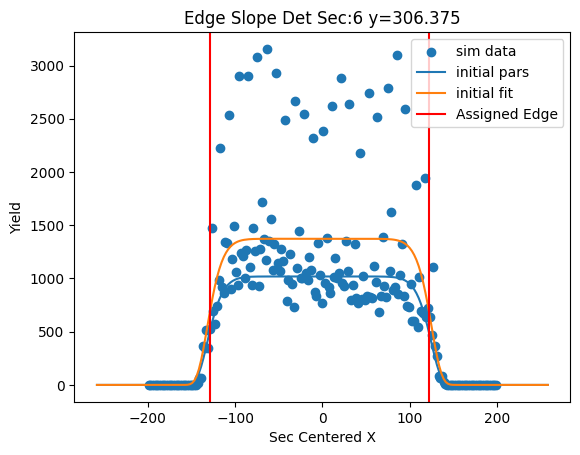

[1370.52847365   -3.34932396   92.04602168   11.92195115]


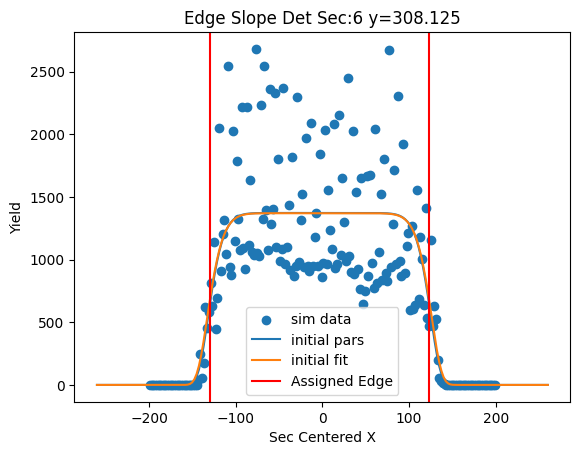

[1403.06281835   -3.09437966   92.70978201   12.85938839]


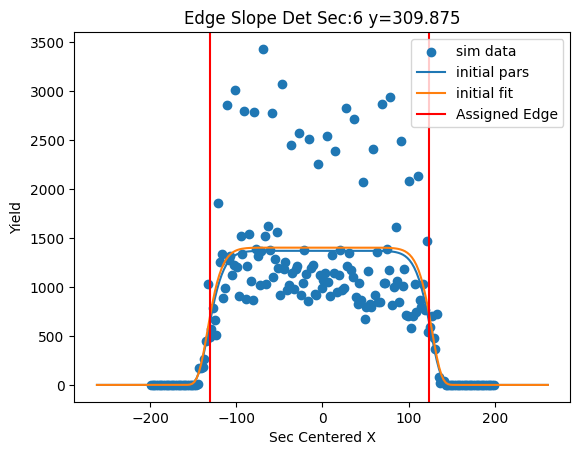

[1018.37590769   -3.73637475   93.47542829   12.6898934 ]


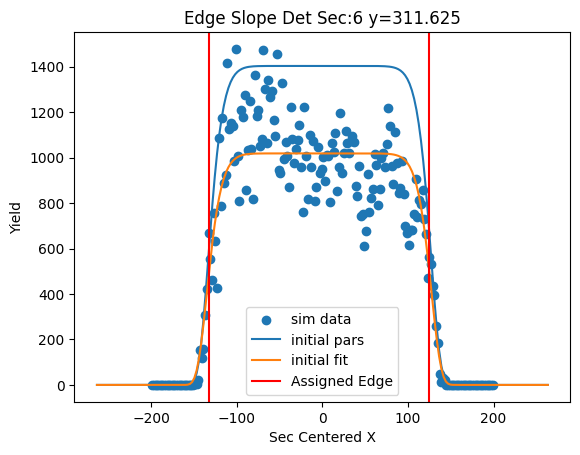

[1154.70503057   -3.33317755   94.46818937   13.4565557 ]


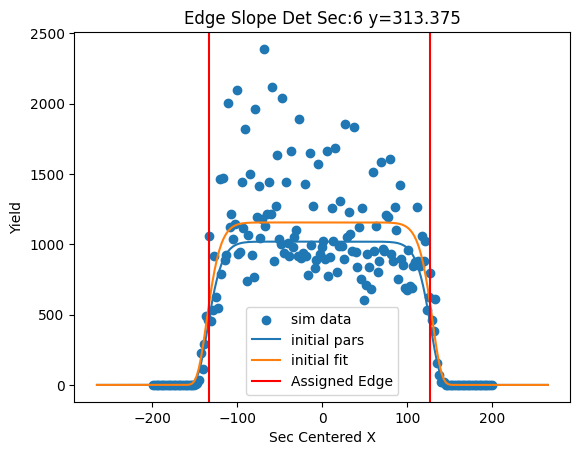

[1423.61524908   -1.80529987   95.59133014   15.80249347]


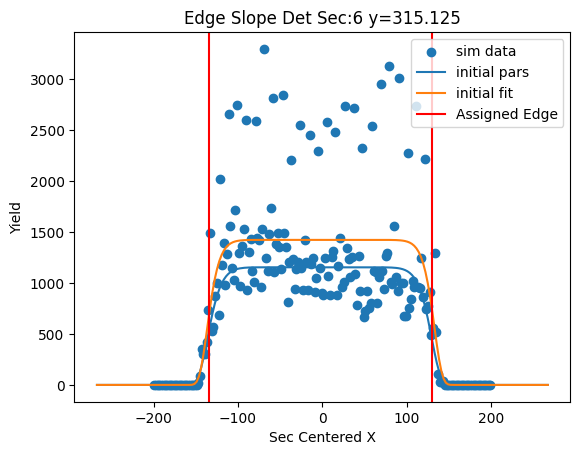

[1247.92327802   -1.35920184   96.46976481   17.93348757]


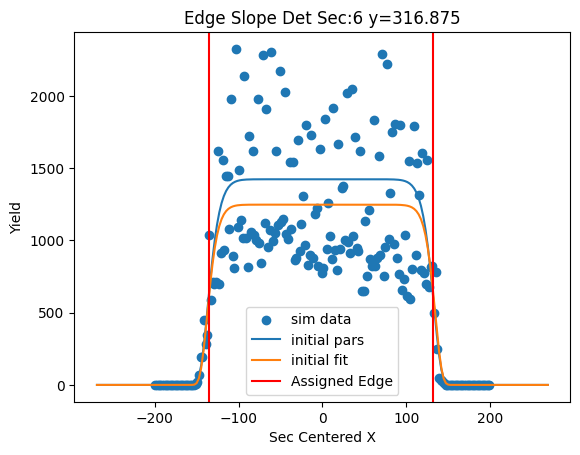

[987.12786299  -1.33618875  96.85321421  19.72677262]


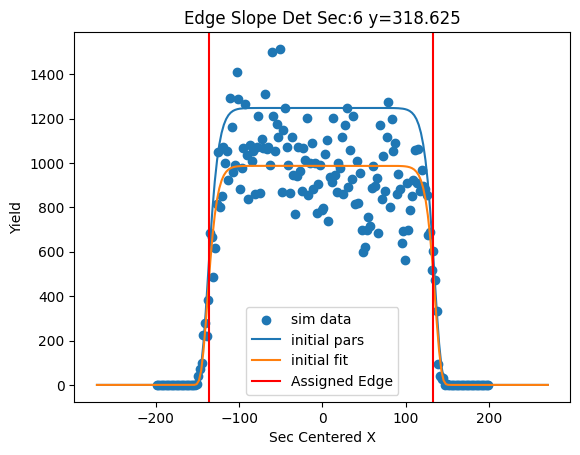

[ 1.28140276e+03 -1.24878386e+00  9.71318637e+01  2.01346967e+01]


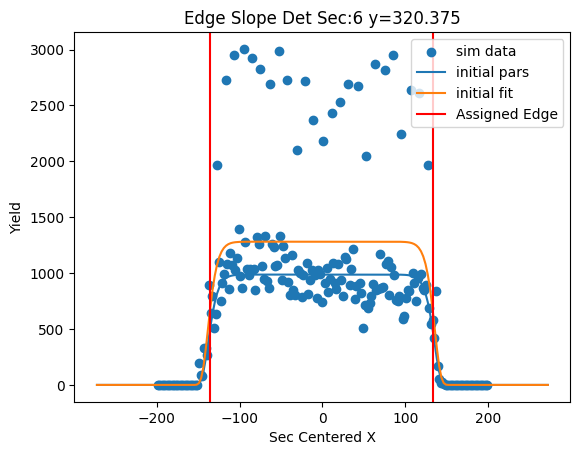

[1186.44944938   -1.89722586   98.2193708    20.35505375]


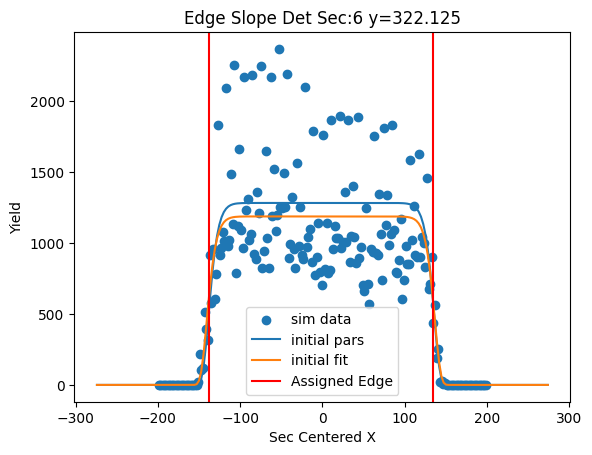

[ 1.21469398e+03 -8.69337717e-01  9.87095068e+01  2.16523896e+01]


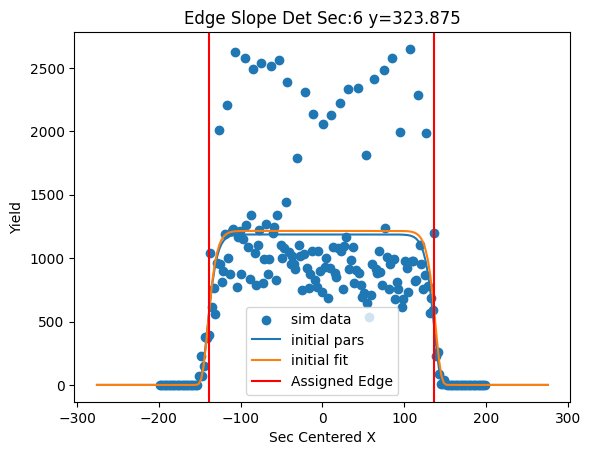

[901.75808584  -1.21656792  98.9781787   21.2940631 ]


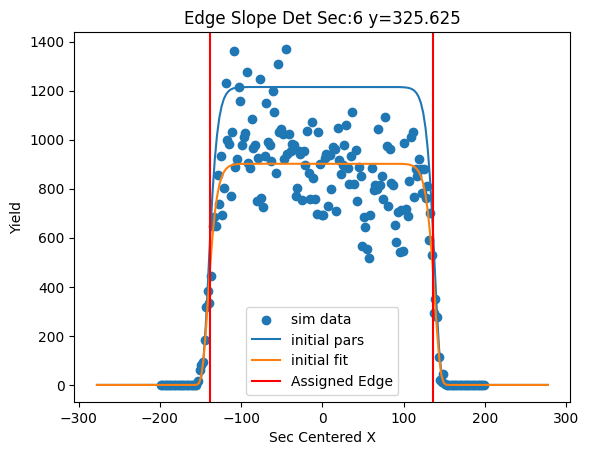

[ 1.07618425e+03 -7.16500666e-01  9.91348417e+01  1.95962126e+01]


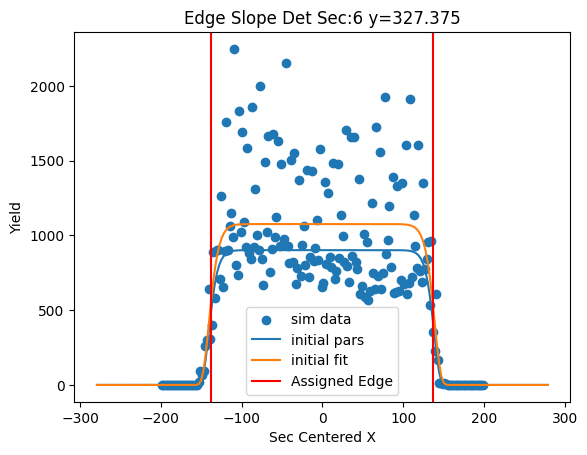

[1226.3817893    -1.24018797   99.8954134    18.93411035]


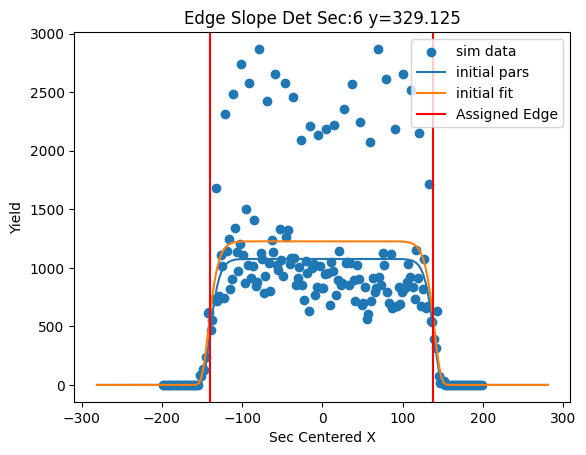

In [17]:

ini_pars = [80000,0.1,10,10.0]

test_pars = np.zeros(4)

x_points = np.zeros((6,2,fit_len))
y_points = [yvals[idx1 + i] for i in range(fit_len)]

par_bou = [[0.0,-np.inf,0.0,0.0],[np.inf,np.inf,np.inf,100]]

for sec in range(6):
    for j in range(4):
        test_pars[j] = ini_pars[j]
    for b in range(fit_len):
        mod_xvals = Bounds_on_Y(xvals,xrange[b][0],xrange[b][1])
        mod_zvals = Bounds_on_X_From_Y(zvals_yx[sec][0][yidx[b]],xvals,xrange[b][0],xrange[b][1])
        plt.scatter(mod_xvals,mod_zvals,label="sim data")
        
        cont_x = np.linspace(xrange[b][0],xrange[b][1],200)
        plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="initial pars")
        try:
            pars, pars_cov = op.curve_fit(Super_Gaus,mod_xvals,mod_zvals,p0=test_pars,maxfev=5000,bounds=par_bou)
            print(pars)
            plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="initial fit")
            x_points[sec][1][b] = super_gaus_cut_bound(0.5,0,*pars)
            x_points[sec][0][b] = super_gaus_cut_bound(0.5,1,*pars)
            plt.axvline(x=x_points[sec][1][b],color='r',label="Assigned Edge")
            plt.axvline(x=x_points[sec][0][b],color='r')
            for i in range(4):
                test_pars[i] = pars[i]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error") 
        
        plt.title("Edge Slope Det Sec:{} y={}".format(sec+1,yvals[yidx[b]]))
        plt.xlabel("Sec Centered X")
        plt.ylabel("Yield")
        plt.legend()
        plt.show()
    #right_rot[sec] =  (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][1]-x_points[sec][0][1])
    #left_rot[sec] = (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][0]-x_points[sec][0][0])
    #print("Right Slope = ",right_rot[sec])
    #print("Left Slope = ",left_rot[sec])

test pars [[55.  2.]
 [55. -2.]]
[54.65724485  2.03189802]
test pars [[55.  2.]
 [55. -2.]]
[56.79888345 -1.94520771]


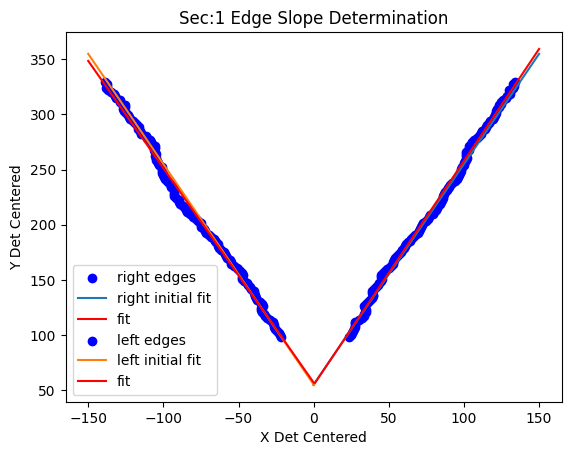

test pars [[55.  2.]
 [55. -2.]]
[61.07561412  1.963214  ]
test pars [[55.  2.]
 [55. -2.]]
[69.31010034 -1.86210183]


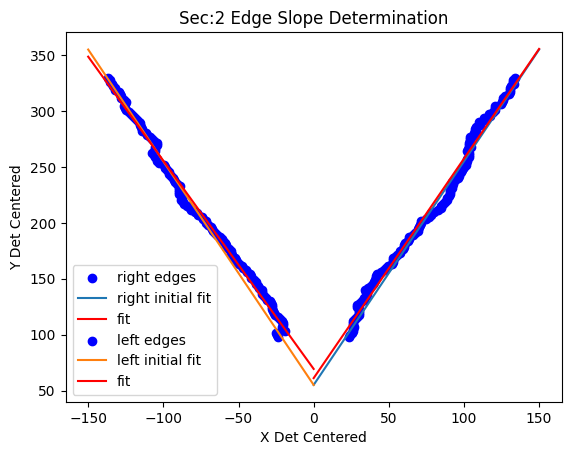

test pars [[55.  2.]
 [55. -2.]]
[51.09320247  2.0055129 ]
test pars [[55.  2.]
 [55. -2.]]
[58.30908664 -1.95485415]


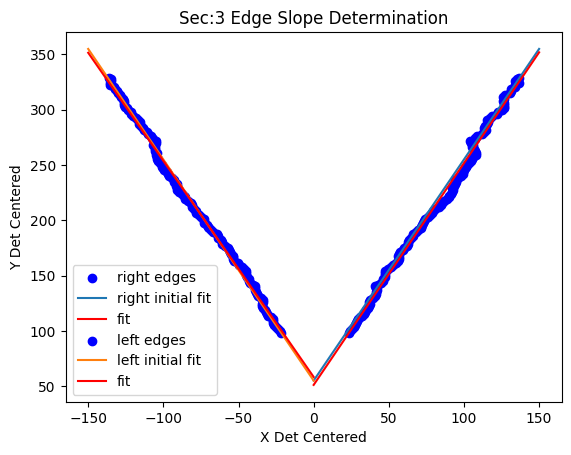

test pars [[55.  2.]
 [55. -2.]]
[52.3562099   2.05182502]
test pars [[55.  2.]
 [55. -2.]]
[56.93374827 -1.9852023 ]


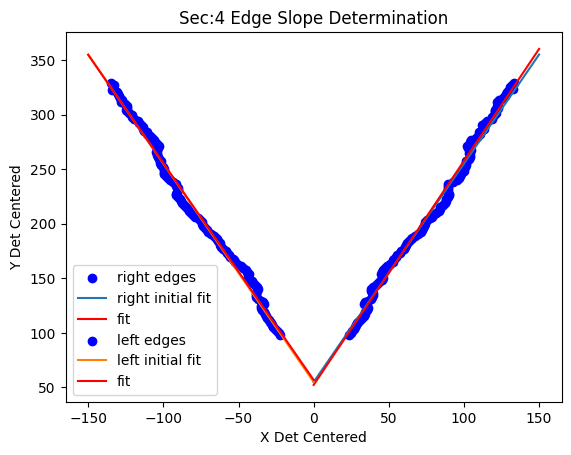

test pars [[55.  2.]
 [55. -2.]]
[55.34979733  1.96534884]
test pars [[55.  2.]
 [55. -2.]]
[56.29807587 -1.9407986 ]


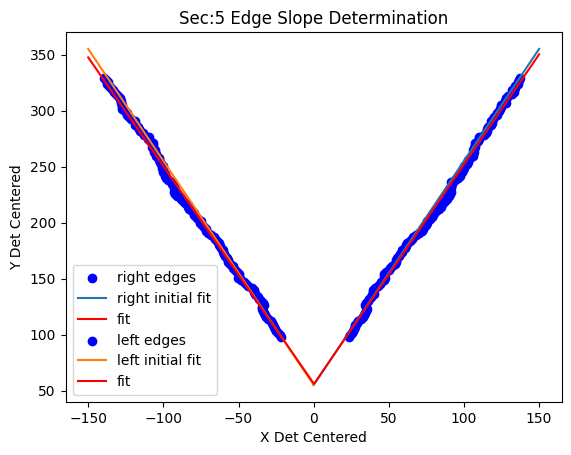

test pars [[55.  2.]
 [55. -2.]]
[60.59891549  1.9660531 ]
test pars [[55.  2.]
 [55. -2.]]
[56.15511965 -1.91153772]


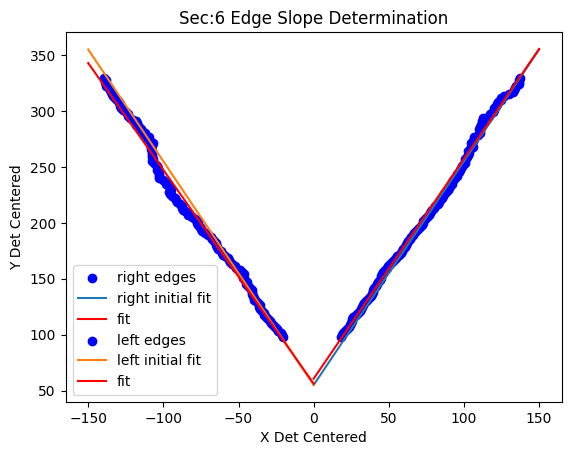

In [18]:
ini_pars = [[55,2.0],[55,-2.0]]

test_pars = np.zeros((2,2))

slope_sides=["right","left"]

for sec in range(6):
    for i in range(2):
        test_pars[0][i] = ini_pars[0][i]
        test_pars[1][i] = ini_pars[1][i]
    for side in range(2):
        plt.scatter(x_points[sec][side],y_points,label="{} edges".format(slope_sides[side]),color='b')
        if side==0:
            m = 0
            x = 150
        else:
            m=-150
            x = 0
        cont_x = np.linspace(m,x,200)
        print("test pars",test_pars)
        plt.plot(cont_x,Poly(cont_x,test_pars[side]),label="{} initial fit".format(slope_sides[side]))
        #plt.plot(cont_x,Lineaer(cont_x,test_pars[side]),label="{} initial fit".format(slope_sides[side]))
        #if sec==1 and side==0:
        #    mod_x = Bounds_on_Y(x_points[sec][side],35.0,70.0)
        #    mod_y = Bounds_on_X_From_Y(y_points,x_points[sec][side],35.0,70.0)
        #    plt.scatter(mod_x,mod_y,label="{} edges".format(slope_sides[side]),color='orange')
        try:
            #if sec==1 and side==0:
            #    pars, pars_cov = op.curve_fit(Linear,mod_x,mod_y,p0=test_pars[side],maxfev=5000)
            #else:
            pars, pars_cov = op.curve_fit(Linear,x_points[sec][side],y_points,p0=test_pars[side],maxfev=5000)
            print(pars)
            plt.plot(cont_x,Poly(cont_x,pars),label="fit",color='r')
            if side == 0:
                right_rot[sec] = pars[1]
            elif side == 1:
                left_rot[sec] = pars[1]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error")
    plt.title("Sec:{} Edge Slope Determination".format(sec+1))
    plt.xlabel("X Det Centered")
    plt.ylabel("Y Det Centered")
    plt.legend()
    plt.show()

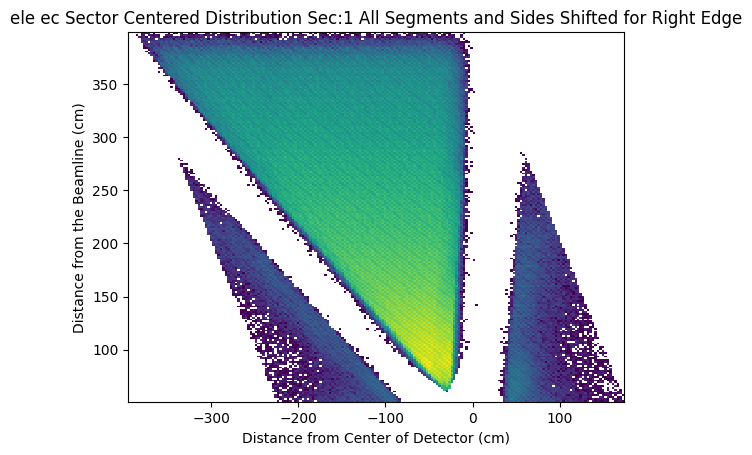

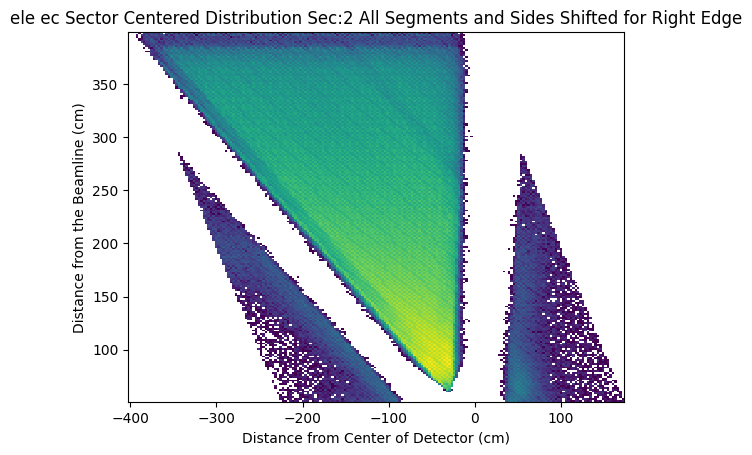

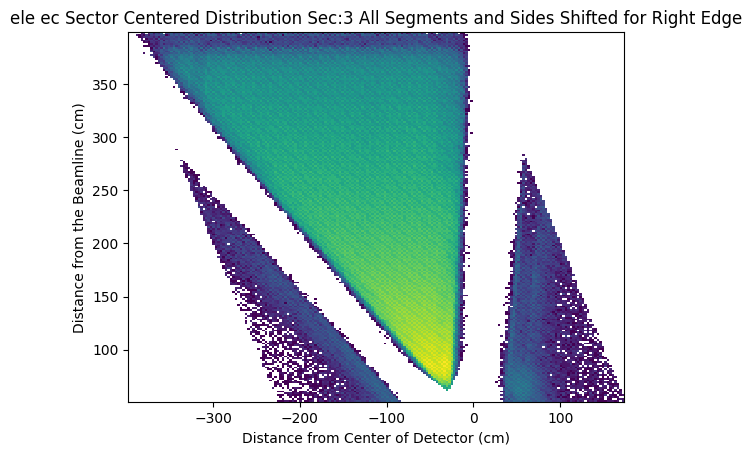

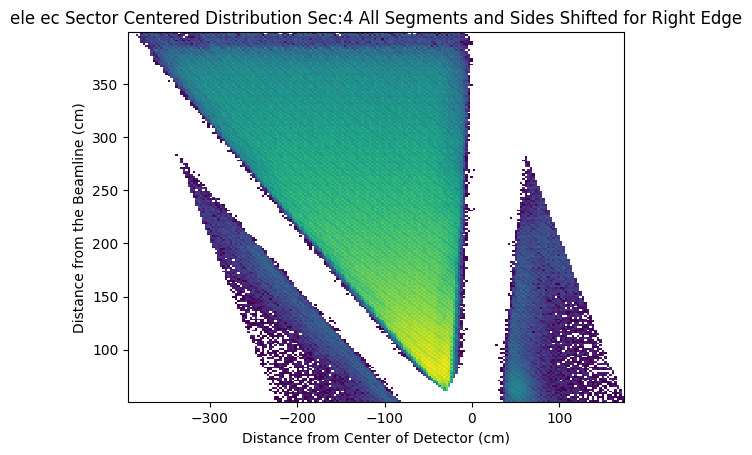

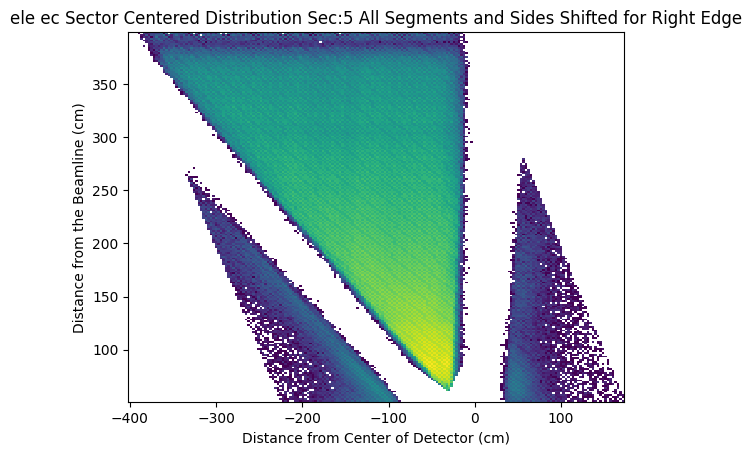

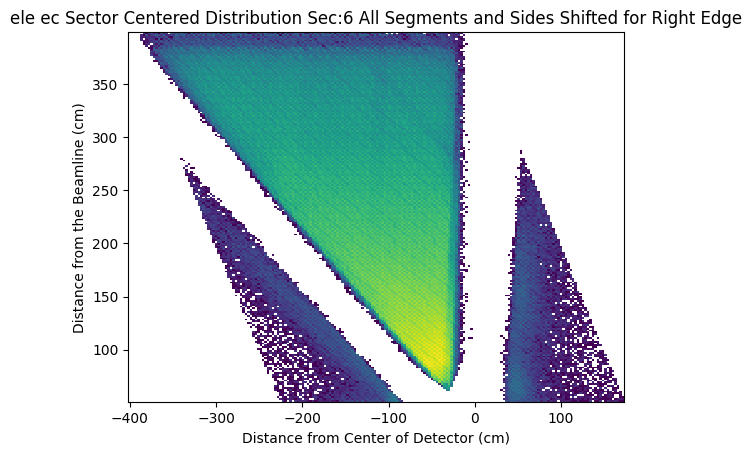

In [19]:
#Shifting for Right Edge
dumb1_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sr = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sr = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sr[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/(right_rot[sec])
                dumb1_y_sr[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sr[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sr[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sr[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/(right_rot[sec])
                dense2_sr[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x_sr[sec][cut_hist_len-1], dumb1_y_sr[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sr[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [20]:
#Shifting for Left Edge
dumb1_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sl = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sl = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sl[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/(left_rot[sec])
                dumb1_y_sl[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sl[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sl[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sl[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/(left_rot[sec])
                dense2_sl[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]


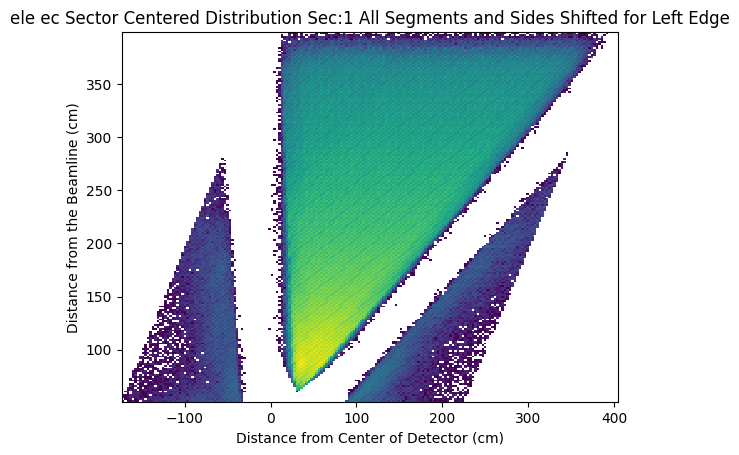

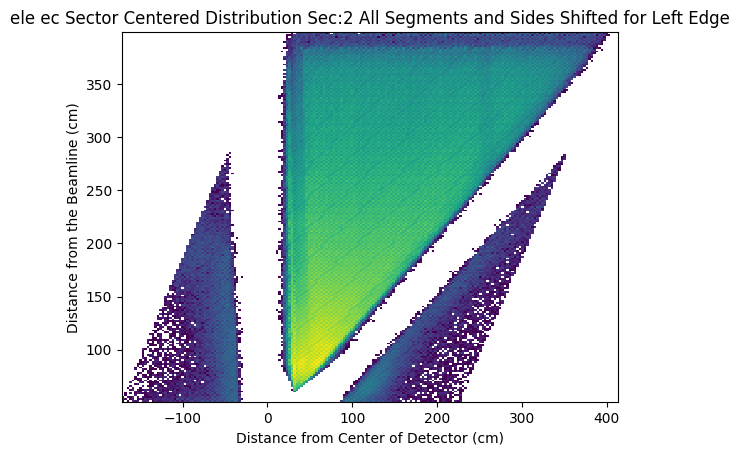

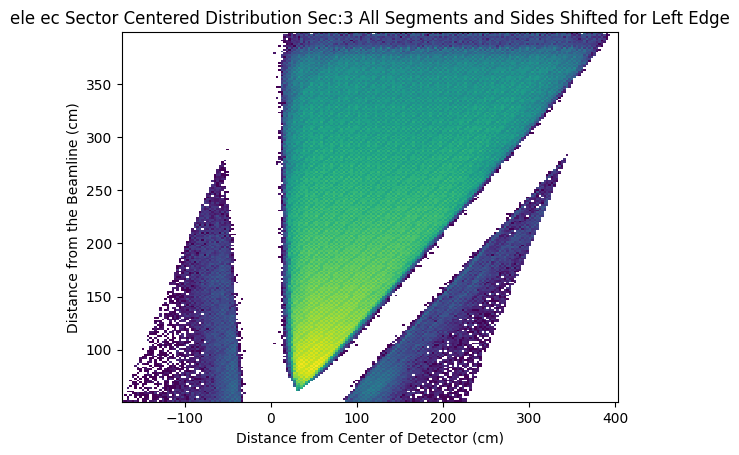

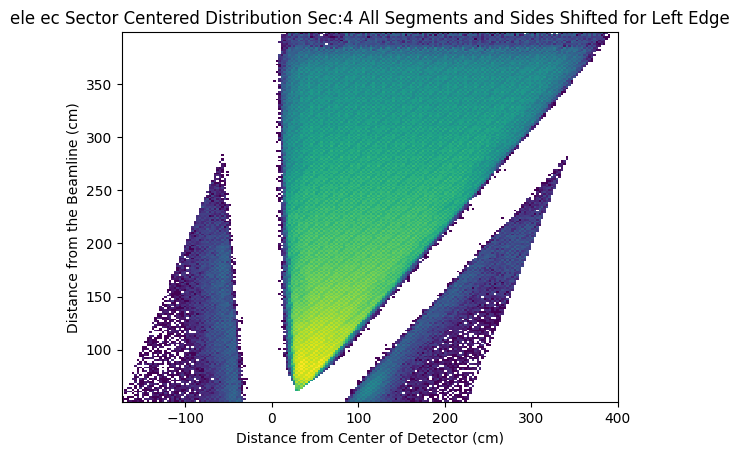

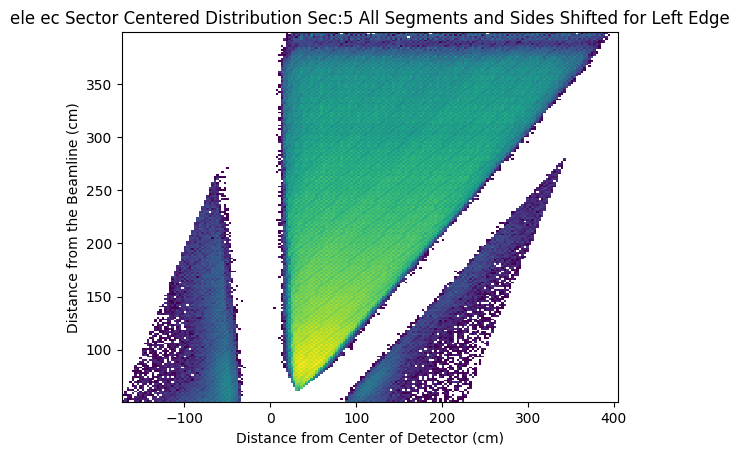

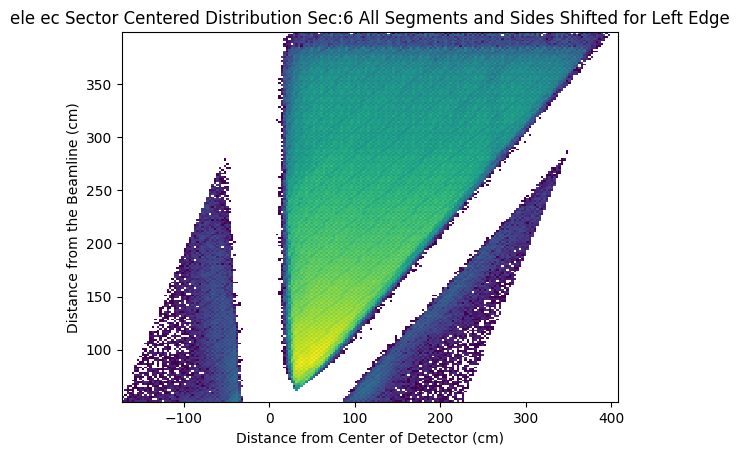

In [21]:
for sec in range(6):
    plt.hist2d(dumb1_x_sl[sec][cut_hist_len-1], dumb1_y_sl[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sl[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Left Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [22]:
proj_y = np.zeros((7,cut_hist_len,ydim))
proj_xr = np.zeros((7,cut_hist_len,xdim))
proj_xl = np.zeros((7,cut_hist_len,xdim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for hist_idx in range(cut_hist_len):
                proj_y[sec][hist_idx][i] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/right_rot[sec]) > 0:
                    proj_xr[sec][hist_idx][j-shift_idx(yvals[i]/right_rot[sec])] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/left_rot[sec]) < xdim-1:
                    proj_xl[sec][hist_idx][j-shift_idx(yvals[i]/left_rot[sec])] += zvals_xy[sec][hist_idx][j][i]

[-1.83996568e+01 -2.47524456e+01  4.83419079e+01  2.49561911e+08]


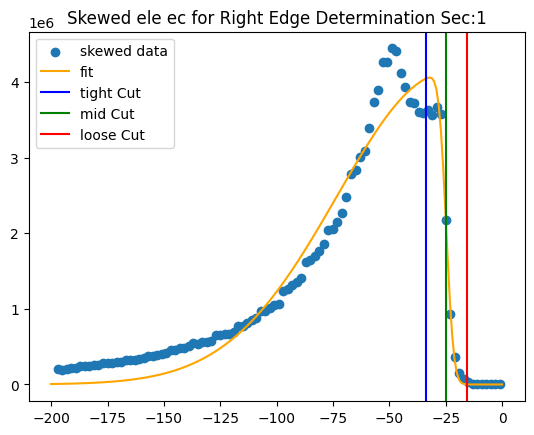

[-2.09243312e+01 -2.65639551e+01  4.82424548e+01  2.73146337e+08]


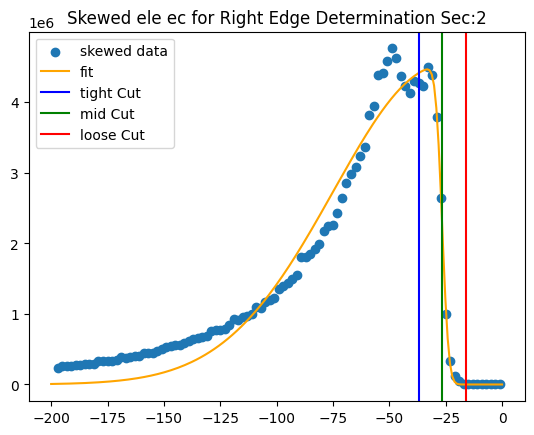

[-1.83743357e+01 -2.53252276e+01  4.56815888e+01  2.53750221e+08]


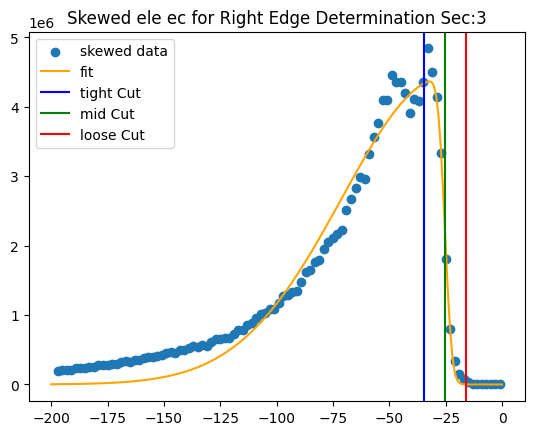

[-1.74266802e+01 -2.42289450e+01  4.58426024e+01  2.22924982e+08]


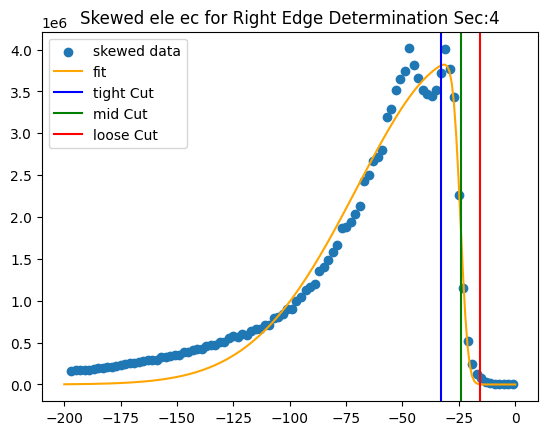

[-1.82504912e+01 -2.66321200e+01  4.78878166e+01  2.60998543e+08]


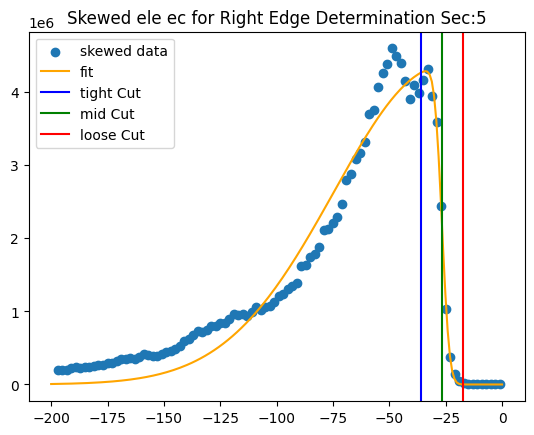

[-9.73771669e+00 -3.18158650e+01  4.12631188e+01  2.44995920e+08]


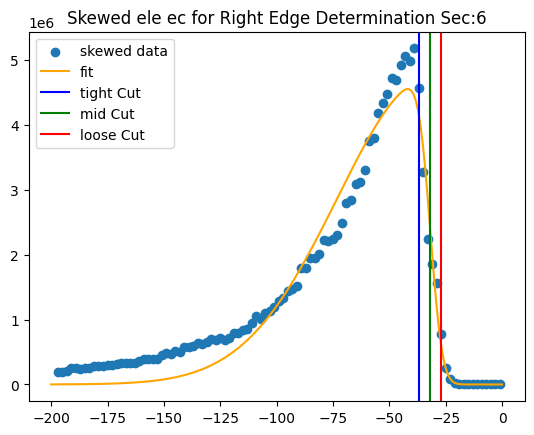

[-2.11819101e+01 -3.34982792e+01  5.03864879e+01  1.51011857e+09]


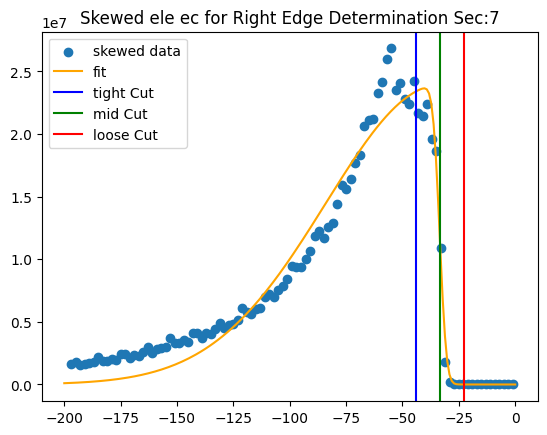

In [23]:
right_edge = np.zeros((7,3))

ini_par = [-6.23,-41,72,120000000]


color_order = ['b','g','r']
rv_color_order = ['r','g','b']
cut_name = ['tight','mid','loose']
rv_cut_name = ['loose','mid','tight']

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,-198,0.0)
    mod_zvals = Bounds_on_X_From_Y(proj_xr[sec][0],xvals,-198,0.0)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(-200,0,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        right_edge[sec][2] = pars[1]-0.5*pars[0]
        right_edge[sec][1] = pars[1]+0*pars[0]
        right_edge[sec][0] = pars[1]+0.5*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=right_edge[sec][cut],label="{} Cut".format(cut_name[cut]),color=color_order[cut])
    plt.title("Skewed "+species+" "+detector+" for Right Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[1.37264325e+01 2.82272430e+01 4.74836590e+01 2.48818354e+08]


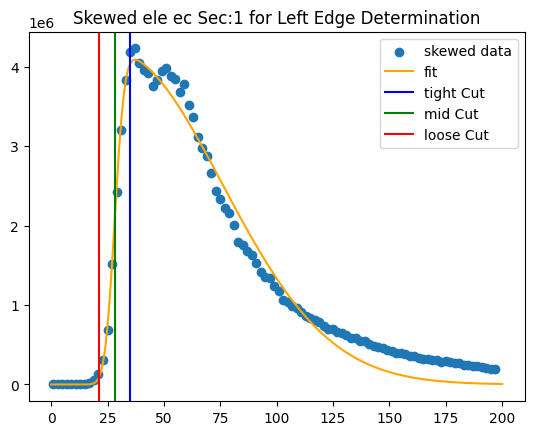

[5.44367020e+00 3.13369139e+01 4.79630916e+01 2.77341337e+08]


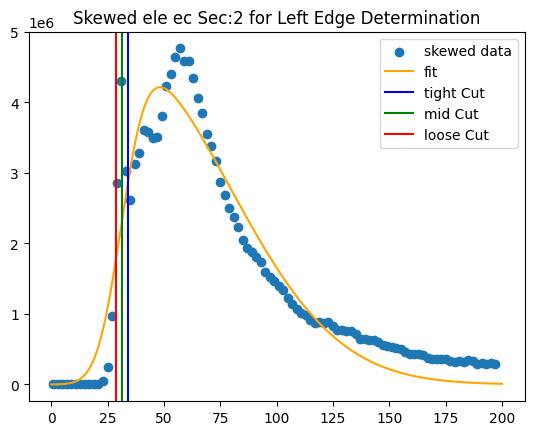

[1.24239315e+01 2.83113130e+01 4.75805946e+01 2.55512019e+08]


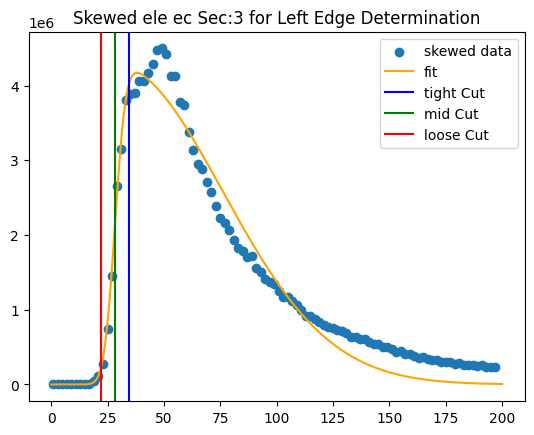

[1.48121463e+01 2.67594021e+01 4.56929444e+01 2.21747305e+08]


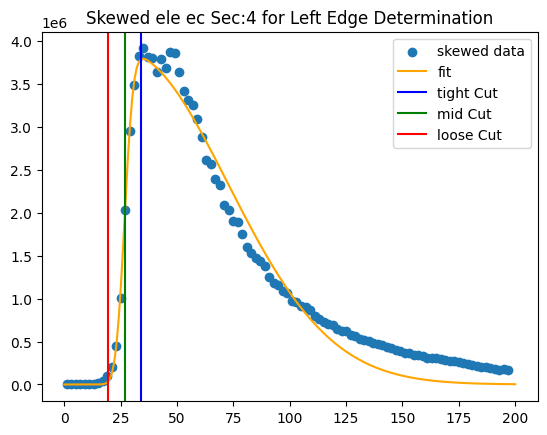

[1.47587501e+01 2.80229030e+01 4.73698194e+01 2.60943316e+08]


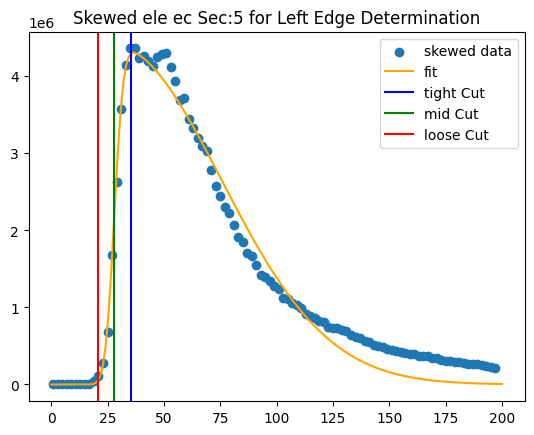

[1.61528966e+01 2.85992698e+01 4.91437076e+01 2.56998825e+08]


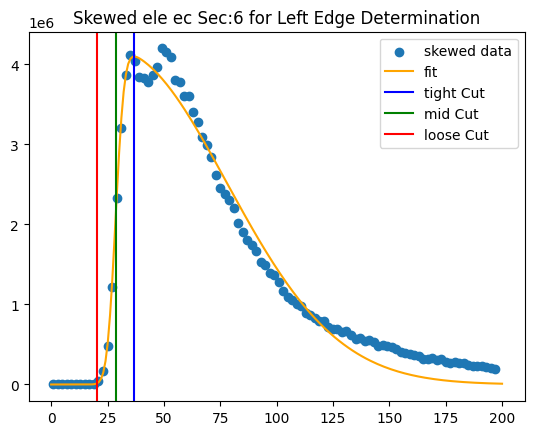

[3.39992260e-01 3.61595415e+02 1.20050256e+02 1.70800550e+09]


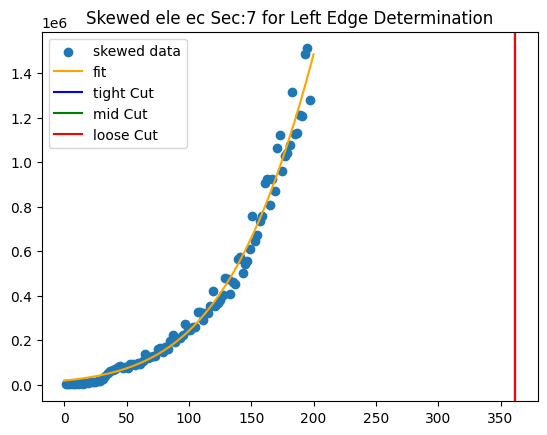

In [26]:
left_edge = np.zeros((7,3))

ini_par = [6.23,41,54,120000000]


for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,0.0,198)
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][0],xvals,0.0,198)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(0.0,200,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        left_edge[sec][2] = pars[1]-0.5*pars[0]
        left_edge[sec][1] = pars[1]+0*pars[0]
        left_edge[sec][0] = pars[1]+0.5*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=left_edge[sec][cut],label="{} Cut".format(cut_name[cut]),color=color_order[cut])
    plt.title("Skewed "+species+" "+detector+" Sec:{} for Left Edge Determination".format(sec+1))
    plt.legend()
    plt.show()

In [27]:
def exp_off(x_, a_, mu_,d_):
    return a_*np.exp(-(x_-mu_)/d_)

def exp_off_edge(comp_,frac_, a_, mu_, d_):
    return -d_*(math.log(frac_)-((comp_-mu_)/d_)-(mu_/d_))

[9317.73302736  394.96173401   14.40834783]


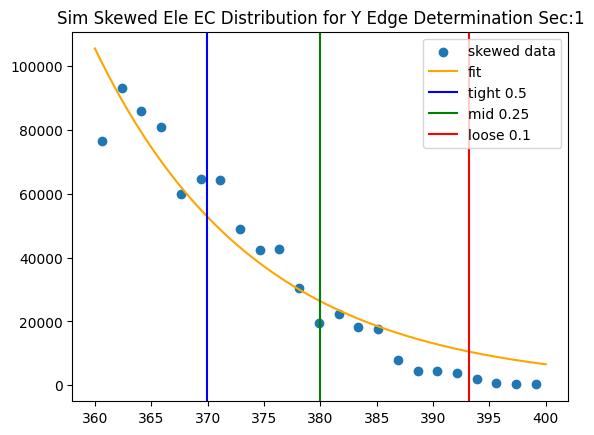

[7039.31732542  404.21092644   14.72323308]


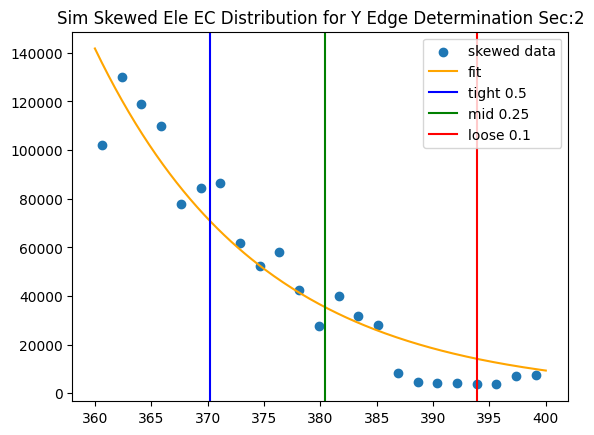

[1.77746142e+04 3.87347495e+02 1.44794785e+01]


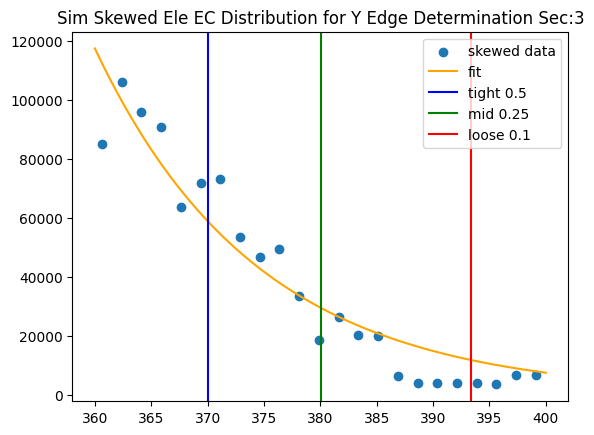

[6979.17049632  399.56975341   15.45295722]


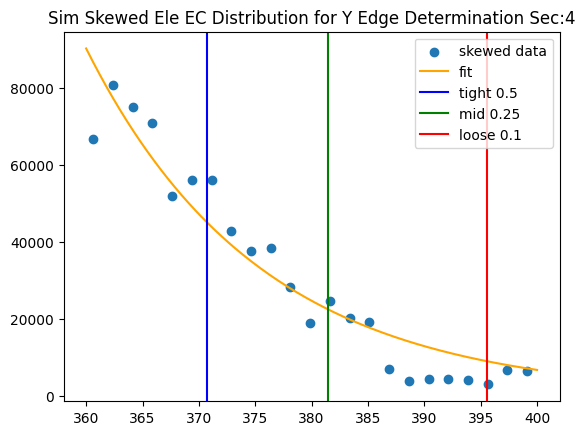

[5536.07002604  397.87848744   12.21333073]


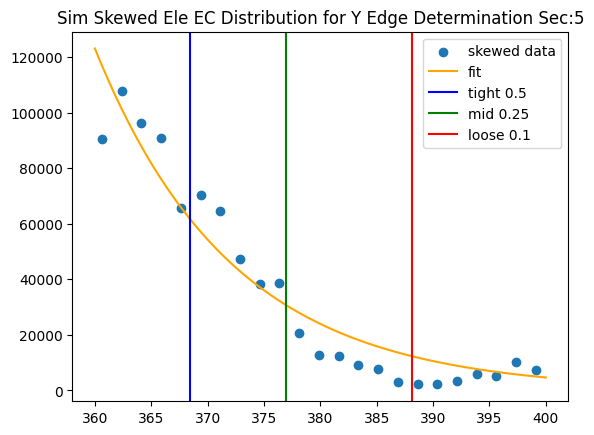

[5448.30085126  406.21900626   15.64003994]


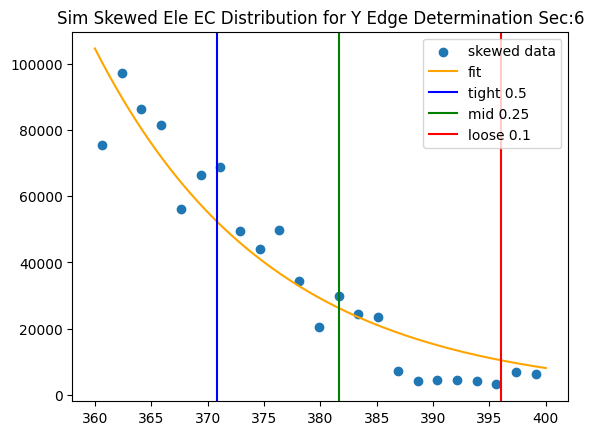

[1.50849208e+04 4.14910162e+02 1.44081864e+01]


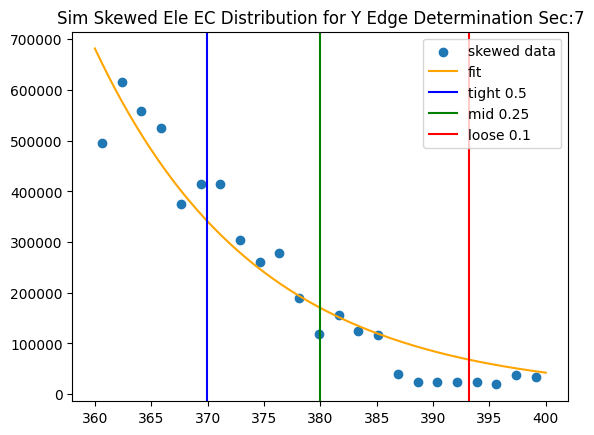

In [29]:
y_edge = np.zeros((7,3))

ini_par = [1359.29693959,  184.29431595,   43.19563841]

bou_y = [360.0,400.0]

comp_x = 360.0

frac_y = [0.5,0.25,0.1]

for sec in range(7):
    mod_xvals = Bounds_on_Y(yvals,bou_y[0],bou_y[1])
    mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou_y[0],bou_y[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou_y[0],bou_y[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(exp_off,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,exp_off(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for cut in range(3):
            y_edge[sec][cut] = exp_off_edge(comp_x,frac_y[cut],*pars)
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=y_edge[sec][cut],label="{} {}".format(cut_name[cut],frac_y[cut]),color=color_order[cut])
    plt.title("Sim Skewed Ele EC Distribution for Y Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[[[68.98755847861825, 2.0318980249196072], [50.29444534630468, 2.0318980249196072], [31.601332213991096, 2.0318980249196072]], [[72.69019844085844, 1.9632139981544672], [52.150728446116624, 1.9632139981544672], [31.611258451374816, 1.9632139981544672]], [[69.2150544079254, 2.0055129018674376], [50.79007073837868, 2.0055129018674376], [32.36508706883197, 2.0055129018674376]], [[67.59180479851676, 2.051825021438792], [49.71355554872476, 2.051825021438792], [31.83530629893276, 2.051825021438792]], [[70.27569710370312, 1.9653488392417815], [52.341406218300506, 1.9653488392417815], [34.40711533289788, 1.9653488392417815]], [[72.12411403756852, 1.966053100322459], [62.55167999722042, 1.966053100322459], [52.97924595687232, 1.966053100322459]], [[76.36479380921153, 1.7320508075688772], [58.02072152031996, 1.7320508075688772], [39.67664923142838, 1.7320508075688772]]]
[[68.98755847861825, 2.0318980249196072], [50.29444534630468, 2.0318980249196072], [31.601332213991096, 2.0318980249196072]]


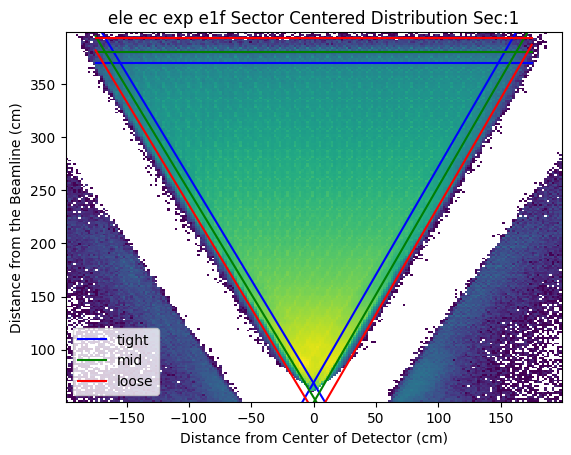

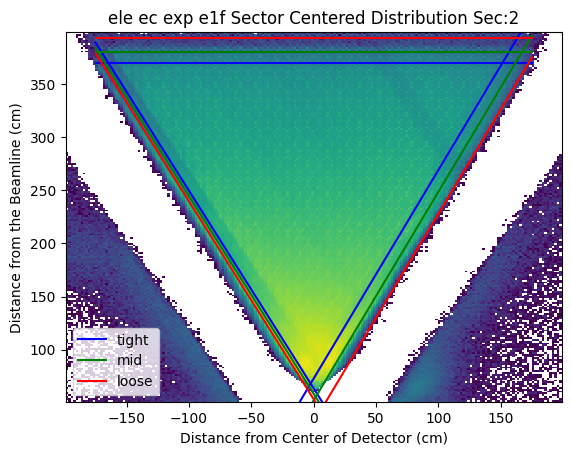

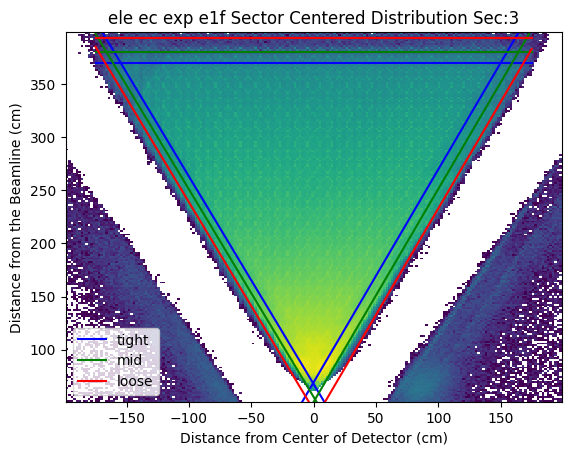

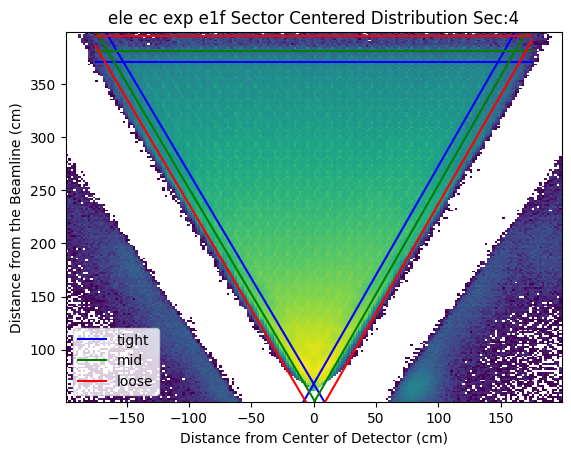

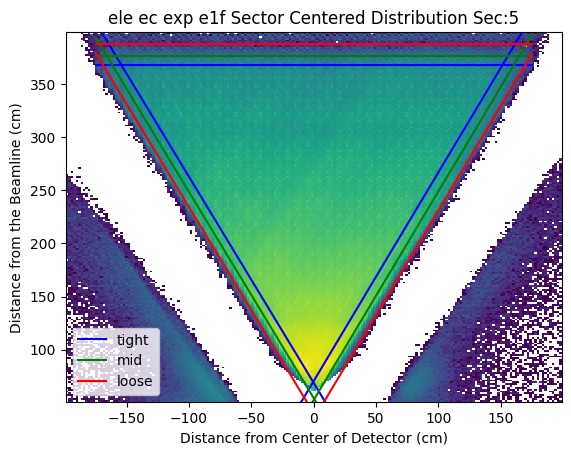

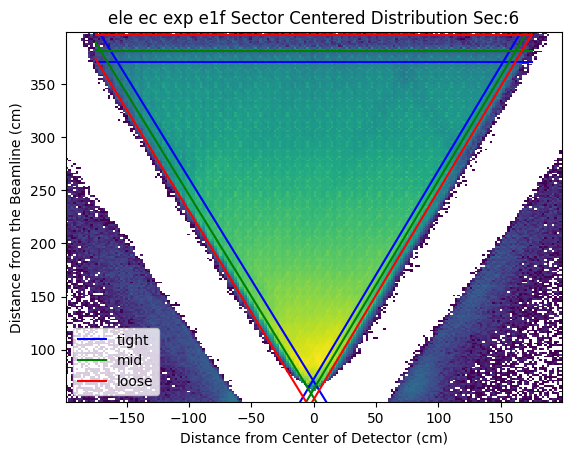

In [37]:
right_cut_pars = [[[-right_edge[i][cut]*right_rot[i],right_rot[i]] for cut in range(3)] for i in range(7)]
left_cut_pars = [[[left_edge[i][cut]*(-1*left_rot[i]),left_rot[i]] for cut in range(3)] for i in range(7)]

print(right_cut_pars)
print(right_cut_pars[0])

cont_x_r = np.linspace(-20.0,175.,200)
cont_x_l = np.linspace(-175.0,20.,200)
cont_x_l2 = np.linspace(-100.0,50.,200)

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    for cut in range(3):
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
        plt.plot([-175,175],[y_edge[sec][cut],y_edge[sec][cut]],color=color_order[cut])
        #if sec5_cut:
        #    if sec == 4:
        #        plt.plot(cont_x_l2,Poly(cont_x_l2,sec_5_cuts[cut][0]),color=color_order[cut])
        #        plt.plot(cont_x_l2,Poly(cont_x_l2,sec_5_cuts[cut][1]),color=color_order[cut])
    plt.title(species+" "+detector+" {} {} Sector Centered Distribution Sec:{}".format(sim,run,sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.legend()
    plt.show()

In [33]:
one_line = True
print("Cut Parameters for "+species+" "+detector+" Geometric Cut")
print("side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                if one_line:
                    print("{{{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
                else:
                    print("{\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
            else:
                if one_line:
                    print("{{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
                else:
                    print("\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        elif cut==2:
            if sec == 5:
                if one_line:
                    print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}}}}")
                else:
                    print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}}}")
            else:
                if one_line:
                    print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}}},")
                else:
                    print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}},")
        else:
            if one_line:
                print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
            else:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")

        
        

Cut Parameters for ele ec Geometric Cut
side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]
{{{{ 68.98755847861825 , 2.0318980249196072 },{ 68.25823175427587 , -1.9452077069454181}},{{ 50.29444534630468 , 2.0318980249196072 },{ 54.90785056228724 , -1.9452077069454181}},{{ 31.601332213991096 , 2.0318980249196072 },{ 41.557469370298605 , -1.9452077069454181}}},{{{ 72.69019844085844 , 1.9632139981544672 },{ 63.4208588117301 , -1.8621018269238216}},{{ 52.150728446116624 , 1.9632139981544672 },{ 58.352524701870465 , -1.8621018269238216}},{{ 31.611258451374816 , 1.9632139981544672 },{ 53.28419059201083 , -1.8621018269238216}}},{{{ 69.2150544079254 , 2.0055129018674376 },{ 67.48797453151337 , -1.9548541466522247}},{{ 50.79007073837868 , 2.0055129018674376 },{ 55.34448754195232 , -1.9548541466522247}},{{ 32.36508706883197 , 2.0055129018674376 },{ 43.20100055239128 , -1.9548541466522247}}},{{{ 67.59180479851676 , 2.051825021438792 },{ 67.82537983897902 , -1.9852022963569294}},{{ 4

In [31]:
# print("Sector 5 efficiency cut")
# print("[tight,mid,loose][bot,top][intercept,slope]")
# for cut in range(3):
#     if cut==0:
#         print("{\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}},")

#     elif cut==2:
#         print("\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}}}")
#     else:
#         print("\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}},")
    
    

In [34]:
print("Top EC Geo cut")
print("[sec][tight,mid,loose]")
for sec in range(6):
    if sec == 0:
        if one_line:
            print("{{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],end="},")
        else:
            print("{\t{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],"},")
    elif sec==5:
        if one_line:
            print("{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],end="}}")
        else:
            print("\t{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],"}}")
    else:
        if one_line:
            print("{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],end="},")
        else:
            print("\t{",y_edge[sec][0],",",y_edge[sec][1],",",y_edge[sec][2],"},")
    
                                                                                  

Top EC Geo cut
[sec][tight,mid,loose]
{{ 369.98710567174743 , 379.97421134349486 , 393.17644691758676},{ 370.20536750077486 , 380.4107350015496 , 393.9014970194742},{ 370.0364097255893 , 380.07281945117853 , 393.3402314392358},{ 370.7111737289099 , 381.4223474578198 , 395.58174893928526},{ 368.4656357577362 , 376.9312715154725 , 388.122233264707},{ 370.8408495909823 , 381.68169918196463 , 396.0125228287324}}